<div style="display: flex; background-color: skyblue;" >
<h1 style="margin: auto; padding: 30px; "> P11 -NB2- Produisez une étude de marché avec R ou Python-  
Analyse Multivariée et Clustering</h1></div>

In [1]:
!where python

D:\Programmes2\Anaconda3\python.exe
C:\Users\matth\AppData\Local\Programs\Python\Python310\python.exe
C:\Users\matth\AppData\Local\Microsoft\WindowsApps\python.exe


<u>**Remarque :**</u>  
Pour des raisons de lisibilité des parties ont été masquées.
Elles peuvent être démasquées directement sur le Notebook .ipynb

**CHOIX DE L'ANNEE d'ETUDE : 2022**  
C'est l'année la plus récente pour laquelle la plupart des donnnées son connues.  
Dans l'étude, nous chercherons à avoir des données cohérentes au niveau de l'année,  
surtout lorsqu'elle doivent être combinées, comme par exemple la population et le PIB par exemple etc...  

Cependant pour certains informations indépendantes, 
comme par exemple la stabilité du pays, nosu prendrons les données les plus récentes possible.

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 1 - Import des librairies et chargement des fichiers</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.1 - Désactivation des Warnings déjà lus si nécessaire</h3>
</div>

##### <u>*DESACTIVATIONS DE WARNINGS déjà lu pour LISISBILITE :*</u>

Source :
https://saturncloud.io/blog/how-to-disable-warnings-in-jupyter-notebook/

https://docs.python.org/fr/3/library/warnings.html

default => Show all warnings (even those ignored by default)
ignore => Ignore all warnings
error => Convert all warnings to errors
error::ResourceWarning => Treat ResourceWarning messages as errors
default::DeprecationWarnig => Show DeprecationWarning messages
ignore,default:::mymodule => Only report warnings triggered by "mymodule"
error:::mymodule => Convert warnings to errors in "mymodule"

In [2]:
# import warnings

In [3]:
# Suppress all warnings

#warnings.filterwarnings('ignore')

In [4]:
# Restore the warning behaviour to default : Show all warnings (even those ignored by default)

#warnings.filterwarnings('ignore')

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.2 - Import des librairies</h3>
</div>

In [5]:
#permet de résoudre un pb connu sous windows avec KMeans :
#KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.

import os
os.environ["OMP_NUM_THREADS"] = "1"

In [6]:
#Import de la librairie expression régulières
import re

In [7]:
#Import de la librairie Numpy
import numpy as np

In [8]:
#Import de la librairie Pandas
import pandas as pd

In [9]:
#Import de scipy.stats
import scipy.stats as st

In [10]:
#Test outil EDA #Ne marche pas,nécessite probabelement un téléchargement, voir si vraiment besoin avant
#from ydata_profiling import ProfileReport

##### **Utilitaire pour le nettoyage:**

In [11]:
import gc

##### **Fonction utile pour itérer avec 2 entrées :**  
utile pour le merge de 10 fichiers

In [12]:
#Fonction utile pour itérer une fonction prenant 2 variables sur une liste (ex suite de fibonacci) :
from functools import reduce

##### **Pour les Graphiques :**

In [13]:
#Import de la librairie matplotlib.pyplot
import matplotlib.pyplot as plt

In [14]:
from mpl_toolkits.mplot3d import Axes3D  

In [15]:
#Import de seaborn 
import seaborn as sns

In [16]:
#Import de plotly.express
import plotly.express as px

In [17]:
#IMPORT matplotlib.dates (gestion des dates) si nécessaire
#import matplotlib.dates as mdates

In [429]:
#PARAMETRAGE GENERAL de SEABORN

sns.set_theme(style='dark', palette='muted')
#plt.rcParams.update({'font.size' : 14,'axes.labelcolor':'firebrick','axes.titlecolor':'firebrick','figure.titlesize':16})
plt.rcParams.update({'font.size' : 12,'axes.labelsize':14,'figure.titlesize':16,'axes.labelcolor':'saddlebrown','axes.titlecolor':'saddlebrown'})

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.3 - Import de Fonctions personnelles </h3>
</div>

##### FONCTION PERSONNELLE D'ANALYSE DE FICHIERS :

In [19]:
# FONCTION PERSONNELLE D'ANALYSE DE FICHIERS :

#import pandas as pd
#import numpy as np
#import re

def Description_Fichier_Tableau_avc_ValBlanches(Data):
    """
    fonction permettant d'analyser un Dataframe DF.
    Elle prend en entrée le dataframe DF.
    Elle nécessite d'avoir chargé la librairie des expressions regulières : import re
    Et renvoie en sortie un dataframe DF2 avec pour chacune des colonnes de DF, les informations suivantes :
    'Type': type de la colonne
    'Nb lignes' : nbre de lignes total de la colonne
    'Valeurs non-vides' : nbre de valeurs non-vides dans la colonne au sens de la fonction pandas.Series.notna()
    'Valeurs vides' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.isna()
    'Valeurs distinctes' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.unique()
    'Valeurs blanches' : nbre de valeurs blanches dans la colonne au sens de le regular expression r"\A[\s]*$"
    c'est à dire au sens de uniquement une nombres quelconque de caractères blancs y compris aucun ''

    """

    
    re2 = r"\A[\s]*$"
    FICHIER = pd.DataFrame(Data)
    #création d'un DataFrame qui va contenir les colonnes du Fichier en Index, 
    #et la description des lignes dans les colonnes
    Tab_Descriptif = pd.DataFrame(index = FICHIER.columns, 
                                  columns=['Type','Nb lignes',
                                           'Valeurs non-vides','Valeurs vides',
                                           'Valeurs distinctes','Valeurs blanches'])

    #remplissage des lignes
    for elt in FICHIER.columns :
        col_string = (FICHIER[elt]).astype('string')
        Tab_Descriptif.loc[elt,:] = [FICHIER[elt].dtypes, len(FICHIER[elt]) , 
                                     FICHIER[elt].notna().sum() ,FICHIER[elt].isna().sum(),
                                     len(FICHIER[elt].unique()),col_string.str.match(re2).sum() ]

    #print(Tab_Descriptif)
    return Tab_Descriptif
    

<>:8: SyntaxWarning: invalid escape sequence '\A'
<>:8: SyntaxWarning: invalid escape sequence '\A'
C:\Users\matth\AppData\Local\Temp\ipykernel_16896\511367401.py:8: SyntaxWarning: invalid escape sequence '\A'
  """


L'alerte ne vaut que pour le texte de la description de fonction!

##### FONCTION PERSONNELLE D'ANALYSE DE FICHIERS -TENTATIVE AMELIORATION EFFICACITE:

In [20]:
# FONCTION PERSONNELLE D'ANALYSE DE FICHIERS-TENTATIVE MAELIORATION :

#import pandas as pd
#import numpy as np
#import re

def Description_Fichier_Tableau_avc_ValBlanches_V2_1(data):
    """
    fonction permettant d'analyser un Dataframe DF.
    Elle prend en entrée le dataframe DF.
    Elle nécessite d'avoir chargé la librairie des expressions regulières : import re
    Et renvoie en sortie un dataframe DF2 avec pour chacune des colonnes de DF, les informations suivantes :
    'Type': type de la colonne
    'Nb lignes' : nbre de lignes total de la colonne
    'Valeurs non-vides' : nbre de valeurs non-vides dans la colonne au sens de la fonction pandas.Series.notna()
    'Valeurs vides' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.isna()
    'Valeurs distinctes' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.unique()
    'Valeurs blanches' : nbre de valeurs blanches dans la colonne au sens de le regular expression r"\A[\s]*$"
    c'est à dire au sens de uniquement une nombres quelconque de caractères blancs y compris aucun ''

    """
    # Normalisation d'entrée : Series -> DataFrame, ndarray -> DataFrame
    if isinstance(data, pd.Series):
        df = data.to_frame(name=data.name if data.name else "col_0")
    elif isinstance(data, np.ndarray):
        if data.ndim == 1:
            df = pd.DataFrame(data, columns=["col_0"])
        else:
            df = pd.DataFrame(data)
    elif isinstance(data, pd.DataFrame):
        df = data
    else:
        raise ValueError("Type de donnée non supporté. Utilisez un DataFrame, Series ou ndarray.")

    regex_blanc = re.compile(r"\A[\s]*$")
    results = []

    for col in df.columns:
        serie = df[col]
        col_type = serie.dtype
        nb_total = len(serie)
        nb_notna = serie.notna().sum()
        nb_na = serie.isna().sum()
        nb_unique = serie.nunique(dropna=True)
        
        # Vérification uniquement sur les chaînes de caractères
        if pd.api.types.is_string_dtype(serie) or pd.api.types.is_object_dtype(serie):
            nb_blancs = serie.apply(lambda x: bool(regex_blanc.match(str(x)))).sum()
        else:
            nb_blancs = np.nan

        results.append([
            col_type, nb_total, nb_notna, nb_na, nb_unique, nb_blancs
        ])

    Tab_Descriptif = pd.DataFrame(
        results,
        index=df.columns,
        columns=[
            "Type",
            "Nb lignes",
            "Valeurs non-vides",
            "Valeurs vides",
            "Valeurs distinctes",
            "Valeurs blanches"
        ]
    )

    return Tab_Descriptif


<>:8: SyntaxWarning: invalid escape sequence '\A'
<>:8: SyntaxWarning: invalid escape sequence '\A'
C:\Users\matth\AppData\Local\Temp\ipykernel_16896\28862795.py:8: SyntaxWarning: invalid escape sequence '\A'
  """


In [21]:
# FONCTION PERSONNELLE DE PREMIERE ANALYSE :

#import pandas as pd
#import numpy as np

def Premieres_Analyses(df_etude):
    """
    fonction regroupant les premières analyses.
    Elle prend en entrée le dataframe DF,
    et applique les instances et méthode intégrées : .shape  .info() .describe()
    et ma méthode personnelle Description_Fichier_Tableau_avc_ValBlanches_V2_1
    Il n'y a pas de sortie, que de l'affichage

    """
    print("\n----","SHAPE","----")
    display(df_etude.shape)
    print("\n----","INFO","----")
    df_etude.info()
    print("\n----","DESCRIBE","----")
    display(df_etude.describe())
    print("\n----","DESCRIPTION","----")
    display(Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_etude))

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.4 - Lexique des principales Variables </h3>
</div>

##### <font color='green'><u>**LEXIQUE DES PRINCIPAUX DATAFRAMES et AUTRE VARIABLES:**<u></font>

##### <font color='blue'><u>**DATAFRAME  :**</u></font>  

<u>**customers**</u>  
**FICHIERS ORIGINAUX**  
`df_Etude_Marche_original` : **DF**, Fichier original issu du NB1  
`` : **DF**, une copie de `df_Etude_Marche_original` pour étude sans modifier le Fichier original `df_Etude_Marche_original` 
Les colonnes y sont renommées pour faciliter la lecture et puisque les unités ne seront pas toujours conservées notamment lors des diverses transforamtion (standardisation de données).  

**ETAPE 2.2**  
`quant_vars` : **list**, la liste des noms de colonnes contenant les variables quantitatives que nous allons analyser   
`df_base_quant` : **DF**, restriction de `df_Etude_Marche_analyse_1_1` aux colonnes quantitatives avec la clo iso3 en Index  
**ETAPE 2.2.4**  
`X_base` : **np.array** récupère les valeurs de `df_base_quant` dans un np.array,  
=les données quantitatives originales  
`names_base` : **Index**, contenant l'index de df_base_quant, cad l'Index contenant l'ensemble des codes iso3 des pays  
names_base = df_base_quant.index  
`features_base` : **Index**, contenant les colonnes de df_base_quant, cad l'Index contenant l'ensemble des variables quantitatives  
features_base = df_base_quant.columns

**ETAPE 2.3.1 Scalling**  
`scaler_base` : **Standardscaler** adapté sur `X_base`  
`X_base_scaled` = **np.array** données centrées-réduites par scaler_base de `X_base`  
X_base_scaled = scaler_base.transform(X_base)  

**ETAPE 2.3.1 PCA**  
`nb_components_base` : nb de composantes choisie pour la PCA  
`pca_base` : **pca** PCA pour `nb_components_base` pour les données `X_base_scaled`  
**ETAPE 2.3.4 Components**  
`pcs_base` : np.array transformé en **DF**  
pcs_base = pca_base.components_  
- contenant sur chaque colonnes les variables d'origines, et leurs coordonnées(projection)  
                en fonction des composantes principales, issue de `pca_base`, et exprimé en fonction des variables originales.  
- contenant sur chaque lignes les `nb_components_base` composantes principales, issue de `pca_base`,   
                et exprimées (coordonnées) dans la base des variables originales.

Remarque : En effet elle correspond à une Matrice P de changement de base orthonormée vers une autre bon.  
La particularité de ces Matrices sont que P^-1 = transposé(P).  
En conséquence on peut la lire en colonne, mais également en lignes.  

**ETAPE 2.3.6 Projection**  
`X_base_proj` : **np.array** données `X_base_scaled` projetées dans les composantes principales par `pca_base`   
X_base_proj = pca_base.transform(X_base_scaled)  

**ETAPE 2.4**  
`df_X_base_proj` : **DF** version Dataframe de `X_base_proj`
`nb_components_base_selec` : **int** nombre des premiers x composantes Princiaple selection pour leur pertinence et quantité de variance.  
`df_X_base_proj_selec_PCA` : **DF** une copie de `df_X_base_proj` réduite aux `nb_components_base_selec` premières composantes principales  
            (et avec l'intégralité des lignes


**ETAPE 2bis**  
**Nous retrouvons les mêmes variables qu'à l'étape 2 mais avec un `bis` à la place de `base`,  
les données sont les mêmes mais sans la CHN et l'IND.**

`df_X_bis_proj_selec_PCA` : **DF** une copie de `df_X_bis_proj` réduite aux `nb_components_base_selec` premières composantes principales pertinentes (ici F1 à F4), avec **l'ensemble des pays à l'exception de CHN et IND.**

`df_X_bis_scaled`: **DF** , version df mappé de `X_bis_scaled` avec pays et variables

**ETAPE 3**  
`df_X_bis_proj_ACH` : **df** issue de `df_X_bis_proj_selec_PCA` (qui contient les données projetées sur les 4 composantes principales de l'ensemble des pays hors CHN et IND), et compléter pour l'étude de l'ACH par les clusters.



**FICHIERS**  
`` :   

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.5 - Chargement du DF d'Etude</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 1.5.1 - Import du Fichier </h4>
</div>

##### <font color='blue'><u>**a. PREMIERS CHARGEMENTS**</u></font>

In [22]:
#CHARGEMENT de FAOSTAT_OA_Pop_2021_2022_2023.xls

df_Etude_Marche_original = pd.read_csv(r"D:\BDD\OCR\P11\Selection_Sources\Sorties\Donnees_Etude_Marche_final_pr_Etude.csv",
                         sep = ',')

df_Etude_Marche_original.head(5)

,iso3,pays,continent,dist_Commerciale_Fra (km),Population_2022,Bal_Imp-Exp_Poulet(kg/pers),PIB-Valeur par habitant(USD),Part de Volaille dans Alimentation(%),Part d'accès à Alimentation saine(%),Export Poulet Fr (kg/pers),Score Qualité Transport 2023 (1 à 5),Score Stabilité Politique 2023 (1 à 100)
0,AGO,Angola,Africa,-6363.600,35635029,8.646319,3183.699796,1.627105,27.8,0.006970,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.900,26200984,-1.910985,67866.792484,5.347738,96.8,0.000000,4.1,79.620850


In [23]:
Premieres_Analyses( df_Etude_Marche_original )


---- SHAPE ----


(112, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   iso3                                      112 non-null    object 
 1   pays                                      112 non-null    object 
 2   continent                                 112 non-null    object 
 3   dist_Commerciale_Fra (km)                 112 non-null    float64
 4   Population_2022                           112 non-null    int64  
 5   Bal_Imp-Exp_Poulet(kg/pers)               112 non-null    float64
 6   PIB-Valeur par habitant(USD)              112 non-null    float64
 7   Part de Volaille dans Alimentation(%)     112 non-null    float64
 8   Part d'accès à Alimentation saine(%)      112 non-null    float64
 9   Export Poulet Fr (kg/pers)                112 non-null    float64
 10  Score Qualité Transpor

,dist_Commerciale_Fra (km),Population_2022,Bal_Imp-Exp_Poulet(kg/pers),PIB-Valeur par habitant(USD),Part de Volaille dans Alimentation(%),Part d'accès à Alimentation saine(%),Export Poulet Fr (kg/pers),Score Qualité Transport 2023 (1 à 5),Score Stabilité Politique 2023 (1 à 100)
count,112.000000,1.120000e+02,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000
mean,-5199.345708,5.881105e+07,3.675429,19961.664406,2.815570,72.293750,0.118939,2.957143,46.830569
std,3615.619949,1.936817e+08,11.188264,26129.499370,1.916530,25.377607,0.396219,0.700671,25.577827
min,-16780.160000,1.169130e+05,-26.357484,429.395861,0.121814,6.400000,0.000000,1.800000,0.473934
25%,-8201.534750,3.389688e+06,0.032974,3413.182233,1.397660,52.275000,0.000000,2.400000,24.526067
50%,-4628.294500,1.041478e+07,1.718604,8082.376833,2.425665,81.150000,0.000408,2.800000,48.341232
75%,-1760.763250,3.849462e+07,6.499356,25053.010392,4.005687,94.475000,0.066655,3.600000,69.431280
max,-378.680800,1.425423e+09,57.456143,125897.199853,7.655395,100.000000,2.576017,4.400000,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,object,112,112,0,112,0.0
pays,object,112,112,0,112,0.0
continent,object,112,112,0,5,0.0
dist_Commerciale_Fra (km),float64,112,112,0,112,NaN
Population_2022,int64,112,112,0,112,NaN
Bal_Imp-Exp_Poulet(kg/pers),float64,112,112,0,112,NaN
PIB-Valeur par habitant(USD),float64,112,112,0,112,NaN
Part de Volaille dans Alimentation(%),float64,112,112,0,112,NaN
Part d'accès à Alimentation saine(%),float64,112,112,0,105,NaN
Export Poulet Fr (kg/pers),float64,112,112,0,65,NaN


In [24]:
df_Etude_Marche_original.columns

Index(['iso3', 'pays', 'continent', 'dist_Commerciale_Fra (km)',
       'Population_2022', 'Bal_Imp-Exp_Poulet(kg/pers)',
       'PIB-Valeur par habitant(USD)', 'Part de Volaille dans Alimentation(%)',
       'Part d'accès à Alimentation saine(%)', 'Export Poulet Fr (kg/pers)',
       'Score Qualité Transport 2023 (1 à 5)',
       'Score Stabilité Politique 2023 (1 à 100)'],
      dtype='object')

##### <font color='blue'><u>**b.FAISONS UNE PREMIERE SELECTION DE COLONNES ET de TYPAGE au chargement :**</u></font>

In [25]:
#SUPPRIMONS LES FICHIERS ET RECHARGEONS LES
#import gc

del df_Etude_Marche_original  # supprime la référence à l'ancien DataFrame

gc.collect()  # force le nettoyage de la mémoire

0

In [26]:
#CHARGEMENT de FAOSTAT_OA_Pop_2021_2022_2023.xls

#liste_col_temp = []

df_Etude_Marche_original = pd.read_csv(r"D:\BDD\OCR\P11\Selection_Sources\Sorties\Donnees_Etude_Marche_final_pr_Etude.csv",
                                     sep = ',',
                                     #usecols=liste_col_temp,
                                     dtype={'iso3' : "string",
                                            'pays' : "string", 
                                            'continent' : "string", 
                                            'dist_Commerciale_Fra (km)' : "Float64",
                                            'Population_2022' : "Int64",
                                            'Bal_Imp-Exp_Poulet(kg/pers)' : "Float64",
                                            'PIB-Valeur par habitant(USD)' : "Float64",
                                            'Part de Volaille dans Alimentation(%)' : "Float64",
                                            "Part d'accès à Alimentation saine(%)" : "Float64", 
                                            'Export Poulet Fr (kg/pers)' : "Float64",
                                            'Score Qualité Transport 2023 (1 à 5)' : "Float64",
                                            'Score Stabilité Politique 2023 (1 à 100)' : "Float64"
                                            }
                                     )

df_Etude_Marche_original.head(5)

,iso3,pays,continent,dist_Commerciale_Fra (km),Population_2022,Bal_Imp-Exp_Poulet(kg/pers),PIB-Valeur par habitant(USD),Part de Volaille dans Alimentation(%),Part d'accès à Alimentation saine(%),Export Poulet Fr (kg/pers),Score Qualité Transport 2023 (1 à 5),Score Stabilité Politique 2023 (1 à 100)
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [27]:
Premieres_Analyses( df_Etude_Marche_original )


---- SHAPE ----


(112, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   iso3                                      112 non-null    string 
 1   pays                                      112 non-null    string 
 2   continent                                 112 non-null    string 
 3   dist_Commerciale_Fra (km)                 112 non-null    Float64
 4   Population_2022                           112 non-null    Int64  
 5   Bal_Imp-Exp_Poulet(kg/pers)               112 non-null    Float64
 6   PIB-Valeur par habitant(USD)              112 non-null    Float64
 7   Part de Volaille dans Alimentation(%)     112 non-null    Float64
 8   Part d'accès à Alimentation saine(%)      112 non-null    Float64
 9   Export Poulet Fr (kg/pers)                112 non-null    Float64
 10  Score Qualité Transpor

,dist_Commerciale_Fra (km),Population_2022,Bal_Imp-Exp_Poulet(kg/pers),PIB-Valeur par habitant(USD),Part de Volaille dans Alimentation(%),Part d'accès à Alimentation saine(%),Export Poulet Fr (kg/pers),Score Qualité Transport 2023 (1 à 5),Score Stabilité Politique 2023 (1 à 100)
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],112,112,0,112,0.0
pays,string[python],112,112,0,112,0.0
continent,string[python],112,112,0,5,0.0
dist_Commerciale_Fra (km),Float64,112,112,0,112,NaN
Population_2022,Int64,112,112,0,112,NaN
Bal_Imp-Exp_Poulet(kg/pers),Float64,112,112,0,112,NaN
PIB-Valeur par habitant(USD),Float64,112,112,0,112,NaN
Part de Volaille dans Alimentation(%),Float64,112,112,0,112,NaN
Part d'accès à Alimentation saine(%),Float64,112,112,0,105,NaN
Export Poulet Fr (kg/pers),Float64,112,112,0,65,NaN


In [28]:
df_Etude_Marche_original.columns

Index(['iso3', 'pays', 'continent', 'dist_Commerciale_Fra (km)',
       'Population_2022', 'Bal_Imp-Exp_Poulet(kg/pers)',
       'PIB-Valeur par habitant(USD)', 'Part de Volaille dans Alimentation(%)',
       'Part d'accès à Alimentation saine(%)', 'Export Poulet Fr (kg/pers)',
       'Score Qualité Transport 2023 (1 à 5)',
       'Score Stabilité Politique 2023 (1 à 100)'],
      dtype='object')

##### <font color='blue'><u>**c. CREONS UN DF de travail**</u></font>

In [29]:
df_Etude_Marche_analyse_1_1 = df_Etude_Marche_original.copy(deep=True)

In [30]:
df_Etude_Marche_analyse_1_1.columns

Index(['iso3', 'pays', 'continent', 'dist_Commerciale_Fra (km)',
       'Population_2022', 'Bal_Imp-Exp_Poulet(kg/pers)',
       'PIB-Valeur par habitant(USD)', 'Part de Volaille dans Alimentation(%)',
       'Part d'accès à Alimentation saine(%)', 'Export Poulet Fr (kg/pers)',
       'Score Qualité Transport 2023 (1 à 5)',
       'Score Stabilité Politique 2023 (1 à 100)'],
      dtype='object')

In [31]:
#Afin de Faciliter la lisibilié renommons quelques colonnes et supprimons les unités qui seront modifiées :
df_Etude_Marche_analyse_1_1.rename(columns={'dist_Commerciale_Fra (km)' : "Prox Geo Commerc. Fra",
                                            'Population_2022' : "Population",
                                            'Bal_Imp-Exp_Poulet(kg/pers)' : "Bal Imp-Exp Poulet/pers",
                                            'PIB-Valeur par habitant(USD)' : "PIB/hab",
                                            'Part de Volaille dans Alimentation(%)' : "Part Volaille Alim",
                                            "Part d'accès à Alimentation saine(%)" : "Part Acces Alim Saine", 
                                            'Export Poulet Fr (kg/pers)' : "Imp Poulet Fr/pers",
                                            'Score Qualité Transport 2023 (1 à 5)' : "Transport",
                                            'Score Stabilité Politique 2023 (1 à 100)' : "Stab Politique"
                                            },
                                   inplace=True)

In [32]:
df_Etude_Marche_analyse_1_1.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

In [33]:
Premieres_Analyses(df_Etude_Marche_analyse_1_1)


---- SHAPE ----


(112, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     112 non-null    string 
 1   pays                     112 non-null    string 
 2   continent                112 non-null    string 
 3   Prox Geo Commerc. Fra    112 non-null    Float64
 4   Population               112 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  112 non-null    Float64
 6   PIB/hab                  112 non-null    Float64
 7   Part Volaille Alim       112 non-null    Float64
 8   Part Acces Alim Saine    112 non-null    Float64
 9   Imp Poulet Fr/pers       112 non-null    Float64
 10  Transport                112 non-null    Float64
 11  Stab Politique           112 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 11.6 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],112,112,0,112,0.0
pays,string[python],112,112,0,112,0.0
continent,string[python],112,112,0,5,0.0
Prox Geo Commerc. Fra,Float64,112,112,0,112,NaN
Population,Int64,112,112,0,112,NaN
Bal Imp-Exp Poulet/pers,Float64,112,112,0,112,NaN
PIB/hab,Float64,112,112,0,112,NaN
Part Volaille Alim,Float64,112,112,0,112,NaN
Part Acces Alim Saine,Float64,112,112,0,105,NaN
Imp Poulet Fr/pers,Float64,112,112,0,65,NaN


#####

A faire :  
dupliquer mon étude 2 en 2bibi sans CHN et IND : exclusion des outliers inintéressants.  
(Si possible)
et en 2teter sans tous les outliers : exclusion de tous les outliers et étude à part des outliers intéressant.

Ensuite je ferai un clustering sur mon étude avec PCA.  
Ensuite je ferai un clustering sur mon étude sur données orignales centrées réduites.  
Avec tosu les pays,
avec tous les pays sauf la CHN et l'inde
avec tous les pays sauf les outliers, étude des outliers intéressants à part.

1. Dupliquer mon étude 2 en 2 bibi PCA sans CHN et IND
2. Faire un clustering propre sur ma PCA 2bibi (repartir de Etape 3)
3. Faire un clustering sur mes données originelles (repartir de Etape 3 origin)
(le relancer sur les données originelles centrées réduites, sans CHN IND, sans autres outliers).

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2base- Réduction de dimension par ACP (Analyse en Composantes Principales </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.1 - Préparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.1.1 - Imports : </h4>
</div>

Nous allons importer nos librairies : 

In [34]:
#IMPORT DES LIBRAIRIES GRAPHIQUES :

#import matplotlib.pyplot as plt #DEJA IMPORTE
from matplotlib.collections import LineCollection
#import seaborn as sns #DEJA IMPORTE
#import plotly.express as px #DEJA IMPORTE


In [35]:
#IMPORT DES LIBRAIRIES TECHNIQUES et STATISTIQUES

#import pandas as pd #DEJA IMPORTE
#import numpy as np #DEJA IMPORTE

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.1.2- option Graphique : </h4>
</div>

On 'charge' `seaborn` : 

In [36]:
# sns.set() #seaborn déjà paramétré

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.1.3- Data : </h4>
</div>

In [37]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.1.4- Fonctions pour ACP: </h4>
</div>

Pour le graphe des correlations : 

In [38]:
def correlation_graph(pca, 
                      x_y, 
                      features) : 
    """Affiche le cercle des correlations projetées sur les 2 composantes choisies,  
    c'est à dire la projection des vecteurs originaux, dans le plan constitué des 2 Axes principaux choisis

    Positional arguments : 
    -----------------------------------
    pca : sklearn.decomposition.PCA : notre objet PCA qui a été fit
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2
    features : list ou tuple : la liste des features (ie des dimensions) à représenter
    """

    # Extrait x et y 
    x,y=x_y

    # Taille de l'image (en inches)
    fig, ax = plt.subplots(figsize=(8, 7))

    # Pour chaque composante : 
    for i in range(0, pca.components_.shape[1]):

        # Les flèches
        ax.arrow(0,0, 
                pca.components_[x, i],  
                pca.components_[y, i],  
                head_width=0.07,
                head_length=0.07, 
                width=0.02, )

        # Les labels
        plt.text(pca.components_[x, i] + 0.05,
                pca.components_[y, i] + 0.05,
                features[i])
        
    # Affichage des lignes horizontales et verticales
    plt.plot([-1, 1], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 1], color='grey', ls='--')

    # Nom des axes, avec le pourcentage d'inertie expliqué
    plt.xlabel('F{} ({}%)'.format(x+1, round(100*pca.explained_variance_ratio_[x],1)))
    plt.ylabel('F{} ({}%)'.format(y+1, round(100*pca.explained_variance_ratio_[y],1)))

    # Titre
    plt.title("Cercle des corrélations (F{} et F{})".format(x+1, y+1))

    # Le cercle 
    an = np.linspace(0, 2 * np.pi, 100)
    plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale

    # Axes et display
    plt.axis('equal')
    plt.show(block=False)

Pour les plans factoriels : 

In [39]:
def display_factorial_planes(   X_projected, 
                                x_y, 
                                pca=None, 
                                labels = None,
                                clusters=None, 
                                alpha=1,
                                figsize=[10,8], 
                                marker="." ):
    """
    Affiche la projection des individus

    Positional arguments : 
    -------------------------------------
    X_projected : np.array, pd.DataFrame, list of list : la matrice des points projetés
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2

    Optional arguments : 
    -------------------------------------
    pca : sklearn.decomposition.PCA : un objet PCA qui a été fit, cela nous permettra d'afficher la variance de chaque composante, default = None
    labels : list ou tuple : les labels des individus à projeter, default = None
    clusters : list ou tuple : la liste des clusters auquel appartient chaque individu, default = None
    alpha : float in [0,1] : paramètre de transparence, 0=100% transparent, 1=0% transparent, default = 1
    figsize : list ou tuple : couple width, height qui définit la taille de la figure en inches, default = [10,8] 
    marker : str : le type de marker utilisé pour représenter les individus, points croix etc etc, default = "."
    """

    # Transforme X_projected en np.array
    X_ = np.array(X_projected)

    # On définit la forme de la figure si elle n'a pas été donnée
    if not figsize: 
        figsize = (7,6)

    # On gère les labels
    if  labels is None : 
        labels = []
    try : 
        len(labels)
    except Exception as e : 
        raise e

    # On vérifie la variable axis 
    if not len(x_y) ==2 : 
        raise AttributeError("2 axes sont demandées")   
    if max(x_y )>= X_.shape[1] : 
        raise AttributeError("la variable axis n'est pas bonne")   

    # on définit x et y 
    x, y = x_y

    # Initialisation de la figure       
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    # On vérifie s'il y a des clusters ou non / sera utilisé poru faire un hue couleur sur le graphique
    c = None if clusters is None else clusters
 
    # Les points    
    # plt.scatter(   X_[:, x], X_[:, y], alpha=alpha, 
    #                     c=c, cmap="Set1", marker=marker)
    sns.scatterplot(data=None, x=X_[:, x], y=X_[:, y], hue=c)

    # Si la variable pca a été fournie, on peut calculer le % de variance de chaque axe 
    if pca : 
        v1 = " ("+ str(round(100*pca.explained_variance_ratio_[x]))  + " %)"
        v2 = " ("+ str(round(100*pca.explained_variance_ratio_[y]))  + " %)"
    else : 
        v1=v2= ''

    # Nom des axes, avec le pourcentage d'inertie expliqué
    ax.set_xlabel(f'F{x+1} {v1}')
    ax.set_ylabel(f'F{y+1} {v2}')

    # Valeur x max et y max
    x_max = np.abs(X_[:, x]).max() *1.1
    y_max = np.abs(X_[:, y]).max() *1.1

    # On borne x et y 
    ax.set_xlim(left=-x_max, right=x_max)
    ax.set_ylim(bottom= -y_max, top=y_max)

    # Affichage des lignes horizontales et verticales
    plt.plot([-x_max, x_max], [0, 0], color='grey', alpha=0.8)
    plt.plot([0,0], [-y_max, y_max], color='grey', alpha=0.8)

    # Affichage des labels des points
    if len(labels) : 
        for i,(_x,_y) in enumerate(X_[:,[x,y]]):
            plt.text(_x, _y+0.05, labels[i], fontsize='14', ha='center',va='center') 

    # Titre et display
    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})")
    plt.axis('equal') #oblige les axes à avoir la même dimension
    plt.show()



<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.2 - Data Preparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.2.1 - Quick tour : </h4>
</div>

In [40]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [41]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1 (df_Etude_Marche_analyse_1_1 )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],112,112,0,112,0.0
pays,string[python],112,112,0,112,0.0
continent,string[python],112,112,0,5,0.0
Prox Geo Commerc. Fra,Float64,112,112,0,112,NaN
Population,Int64,112,112,0,112,NaN
Bal Imp-Exp Poulet/pers,Float64,112,112,0,112,NaN
PIB/hab,Float64,112,112,0,112,NaN
Part Volaille Alim,Float64,112,112,0,112,NaN
Part Acces Alim Saine,Float64,112,112,0,105,NaN
Imp Poulet Fr/pers,Float64,112,112,0,65,NaN


In [42]:
Premieres_Analyses(df_Etude_Marche_analyse_1_1)


---- SHAPE ----


(112, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     112 non-null    string 
 1   pays                     112 non-null    string 
 2   continent                112 non-null    string 
 3   Prox Geo Commerc. Fra    112 non-null    Float64
 4   Population               112 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  112 non-null    Float64
 6   PIB/hab                  112 non-null    Float64
 7   Part Volaille Alim       112 non-null    Float64
 8   Part Acces Alim Saine    112 non-null    Float64
 9   Imp Poulet Fr/pers       112 non-null    Float64
 10  Transport                112 non-null    Float64
 11  Stab Politique           112 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 11.6 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],112,112,0,112,0.0
pays,string[python],112,112,0,112,0.0
continent,string[python],112,112,0,5,0.0
Prox Geo Commerc. Fra,Float64,112,112,0,112,NaN
Population,Int64,112,112,0,112,NaN
Bal Imp-Exp Poulet/pers,Float64,112,112,0,112,NaN
PIB/hab,Float64,112,112,0,112,NaN
Part Volaille Alim,Float64,112,112,0,112,NaN
Part Acces Alim Saine,Float64,112,112,0,105,NaN
Imp Poulet Fr/pers,Float64,112,112,0,65,NaN


In [43]:
df_Etude_Marche_analyse_1_1.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

Quel est le % de valeurs manquantes par colonne ? 

In [44]:
df_Etude_Marche_analyse_1_1.isna().mean()

iso3                       0.0
pays                       0.0
continent                  0.0
Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

Y a-t-il des lignes en double ? 

In [45]:
df_Etude_Marche_analyse_1_1.duplicated().sum()

0

Combien y a-t-il de valeurs différentes par colonne ? 

In [46]:
df_Etude_Marche_analyse_1_1.nunique()

iso3                       112
pays                       112
continent                    5
Prox Geo Commerc. Fra      112
Population                 112
Bal Imp-Exp Poulet/pers    112
PIB/hab                    112
Part Volaille Alim         112
Part Acces Alim Saine      105
Imp Poulet Fr/pers          65
Transport                   27
Stab Politique             112
dtype: int64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.2.2 - Data Selection (variables quantitatives) : </h4>
</div>

In [47]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [48]:
df_Etude_Marche_analyse_1_1.shape

(112, 12)

In [49]:
df_Etude_Marche_analyse_1_1.dtypes

iso3                       string[python]
pays                       string[python]
continent                  string[python]
Prox Geo Commerc. Fra             Float64
Population                          Int64
Bal Imp-Exp Poulet/pers           Float64
PIB/hab                           Float64
Part Volaille Alim                Float64
Part Acces Alim Saine             Float64
Imp Poulet Fr/pers                Float64
Transport                         Float64
Stab Politique                    Float64
dtype: object

In [50]:
df_Etude_Marche_analyse_1_1.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

Nous allons sélectionner d'abord que certaines colones : 

In [51]:
# Colonnes à retirer
colonnes_a_exclure = ['iso3', 'pays', 'continent']

# Liste des variables quantitatives
quant_vars = [col for col in df_Etude_Marche_analyse_1_1.columns if col not in colonnes_a_exclure]

# Affichage du résultat
print(quant_vars)

['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport', 'Stab Politique']


In [52]:
df_base_quant = (df_Etude_Marche_analyse_1_1.set_index(keys=['iso3'])[quant_vars] ).copy(deep=True)
df_base_quant.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
ALB,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
ARM,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
AUS,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


Notre dataframe a maintenant une dimension de : 

In [53]:
df_base_quant.shape

(112, 9)

In [54]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_base_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,112,112,0,112,NaN
Population,Int64,112,112,0,112,NaN
Bal Imp-Exp Poulet/pers,Float64,112,112,0,112,NaN
PIB/hab,Float64,112,112,0,112,NaN
Part Volaille Alim,Float64,112,112,0,112,NaN
Part Acces Alim Saine,Float64,112,112,0,105,NaN
Imp Poulet Fr/pers,Float64,112,112,0,65,NaN
Transport,Float64,112,112,0,27,NaN
Stab Politique,Float64,112,112,0,112,NaN


In [55]:
Premieres_Analyses(df_base_quant)


---- SHAPE ----


(112, 9)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 112 entries, AGO to ZAF
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Prox Geo Commerc. Fra    112 non-null    Float64
 1   Population               112 non-null    Int64  
 2   Bal Imp-Exp Poulet/pers  112 non-null    Float64
 3   PIB/hab                  112 non-null    Float64
 4   Part Volaille Alim       112 non-null    Float64
 5   Part Acces Alim Saine    112 non-null    Float64
 6   Imp Poulet Fr/pers       112 non-null    Float64
 7   Transport                112 non-null    Float64
 8   Stab Politique           112 non-null    Float64
dtypes: Float64(8), Int64(1)
memory usage: 9.7 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,112,112,0,112,NaN
Population,Int64,112,112,0,112,NaN
Bal Imp-Exp Poulet/pers,Float64,112,112,0,112,NaN
PIB/hab,Float64,112,112,0,112,NaN
Part Volaille Alim,Float64,112,112,0,112,NaN
Part Acces Alim Saine,Float64,112,112,0,105,NaN
Imp Poulet Fr/pers,Float64,112,112,0,65,NaN
Transport,Float64,112,112,0,27,NaN
Stab Politique,Float64,112,112,0,112,NaN


In [56]:
df_base_quant.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.35,58811047.71,3.68,19961.66,2.82,72.29,0.12,2.96,46.83
std,3615.62,193681701.82,11.19,26129.5,1.92,25.38,0.4,0.7,25.58
min,-16780.16,116913.0,-26.36,429.4,0.12,6.4,0.0,1.8,0.47
25%,-8201.53,3389688.5,0.03,3413.18,1.4,52.28,0.0,2.4,24.53
50%,-4628.29,10414776.5,1.72,8082.38,2.43,81.15,0.0,2.8,48.34
75%,-1760.76,38494619.0,6.5,25053.01,4.01,94.48,0.07,3.6,69.43
max,-378.68,1425423212.0,57.46,125897.2,7.66,100.0,2.58,4.4,95.26


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.2.3 - Cleaning non nécessaire : données déjà propres </h4>
</div>

##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

Traitons les valeurs manquantes. On rappelle que : 

In [57]:
df_base_quant.isna().mean()

Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.2.4 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X` la matrice des données : 

In [58]:
#X_base récupère les valeurs de df_base_quant dans un np.array
X_base = df_base_quant.values
#X_base[:5]
pd.DataFrame(X_base).head()

,0,1,2,3,4,5,6,7,8
0,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [59]:
X_base.shape

(112, 9)

Nous enregistrons les noms de nos pays-iso3 dans une variable `names_base` : 

In [60]:
names_base = df_base_quant.index
names_base

Index(['AGO', 'ALB', 'ARE', 'ARM', 'AUS', 'AUT', 'BEL', 'BEN', 'BFA', 'BGD',
       ...
       'TGO', 'THA', 'TJK', 'TTO', 'TUR', 'URY', 'USA', 'UZB', 'VNM', 'ZAF'],
      dtype='string', name='iso3', length=112)

In [61]:
names_base.shape

(112,)

et nos colonnes, nos features_base, dans une variable `features_base` : 

In [62]:
features_base = df_base_quant.columns
features_base

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [63]:
features_base.shape

(9,)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.3 - PCA </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.3.1 - Scaling : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données X_base :

In [64]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_base = StandardScaler()
scaler_base

StandardScaler()

In [65]:
#préparation de la fonction pour s'adapter au format de nos données X_base (Fitage) :
scaler_base.fit(X_base)

StandardScaler()

In [66]:
#Centrage -réduction de X_base dans le np.array X_base_scaled :
X_base_scaled = scaler_base.transform(X_base)
pd.DataFrame(X_base_scaled).head(5) #visualisation de X_base_scaled

,0,1,2,3,4,5,6,7,8
0,-0.323454,-0.120198,0.446292,-0.644994,-0.622900,-1.761148,-0.283865,-1.228816,-0.573493
1,1.038501,-0.290348,1.039287,-0.511537,-0.151173,0.613767,0.138959,-0.368645,0.189613
2,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
3,0.502311,-0.290072,0.835645,-0.497588,-0.355005,-1.076381,0.039320,-0.512007,-1.169089
4,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742


##### VISUALISATION de `X_base_scaled` :

In [67]:
type(X_base_scaled)

numpy.ndarray

In [68]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_base_scaled).describe().round(2)

,0,1,2,3,4,5,6,7,8
count,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.30,-2.70,-0.75,-1.41,-2.61,-0.30,-1.66,-1.82
25%,-0.83,-0.29,-0.33,-0.64,-0.74,-0.79,-0.30,-0.80,-0.88
50%,0.16,-0.25,-0.18,-0.46,-0.20,0.35,-0.30,-0.23,0.06
75%,0.96,-0.11,0.25,0.20,0.62,0.88,-0.13,0.92,0.89
max,1.34,7.09,4.83,4.07,2.54,1.10,6.23,2.07,1.90


In [69]:
#Visualisation de X_base_scaled les données centrées réduites
df_X_base_scaled = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_X_base_scaled.columns = features_base
df_X_base_scaled.index = names_base
df_X_base_scaled.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.323454,-0.120198,0.446292,-0.644994,-0.622900,-1.761148,-0.283865,-1.228816,-0.573493
ALB,1.038501,-0.290348,1.039287,-0.511537,-0.151173,0.613767,0.138959,-0.368645,0.189613
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
ARM,0.502311,-0.290072,0.835645,-0.497588,-0.355005,-1.076381,0.039320,-0.512007,-1.169089
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742


In [70]:
#(Attention pour std ddf=1 dans describe
df_X_base_scaled.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.30,-2.70,-0.75,-1.41,-2.61,-0.30,-1.66,-1.82
25%,-0.83,-0.29,-0.33,-0.64,-0.74,-0.79,-0.30,-0.80,-0.88
50%,0.16,-0.25,-0.18,-0.46,-0.20,0.35,-0.30,-0.23,0.06
75%,0.96,-0.11,0.25,0.20,0.62,0.88,-0.13,0.92,0.89
max,1.34,7.09,4.83,4.07,2.54,1.10,6.23,2.07,1.90


In [71]:
df_X_base_scaled.std(ddof=1).round(2)

Prox Geo Commerc. Fra      1.0
Population                 1.0
Bal Imp-Exp Poulet/pers    1.0
PIB/hab                    1.0
Part Volaille Alim         1.0
Part Acces Alim Saine      1.0
Imp Poulet Fr/pers         1.0
Transport                  1.0
Stab Politique             1.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.2 - PCA : </h4>
</div>

Dans un premier temps,  
Nous allons travailler sur 9 composantes principales (pour récupérer toutes les informations des 9 variables initiales) 

In [72]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_base = 9

On instancie notre ACP : 

In [73]:
#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_base = PCA(n_components=nb_components_base)

On "l'entraine" sur les données scalées : 

In [74]:
#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_base.fit(X_base_scaled)

PCA(n_components=9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.3 - Explication de la variance et du scree plot : </h4>
</div>

Intéressons nous maintenant à la variance *captée* par chaque nouvelle composante. Grace à `scikit-learn` on peut utiliser l'attribut `explained_variance_ratio_` : 

In [75]:
pca_base.explained_variance_ratio_

array([0.35479674, 0.17292293, 0.13506557, 0.09233018, 0.08334508,
       0.0702908 , 0.04182148, 0.02553994, 0.02388728])

Ici la 1ère composante *capte* 36% de la variance de nos données initiales, la 2ème 17%, la 3ème 14%, la 4ème 9%, etc...  

<u>**Critère de Kaiser :**</u>  
IL est coutume de s'intéresser aux Composantes principales qui récupère plus de 100%/9 = 11% de la variance des données initiales.  
Soit ici les Composantes pricipales F1,F2, et F3.

Enregistrons cela dans une variable : 

In [76]:
scree_base = (pca_base.explained_variance_ratio_*100).round(2)
scree_base

array([35.48, 17.29, 13.51,  9.23,  8.33,  7.03,  4.18,  2.55,  2.39])

Et pour faire une somme cumulée `numpy`dispose de la fonction `cumsum` : 

In [77]:
scree_base_cum = scree_base.cumsum().round(2)
scree_base_cum

array([35.48, 52.77, 66.28, 75.51, 83.84, 90.87, 95.05, 97.6 , 99.99])

Définisions ensuite une variable avec la liste de nos 9 composantes : 

In [78]:
x_list_num_axes_tot = range(1, nb_components_base+1)
list(x_list_num_axes_tot)

[1, 2, 3, 4, 5, 6, 7, 8, 9]

In [79]:
list_Fi_tot = [f"F{i}" for i in x_list_num_axes_tot]

In [80]:
type(x_list_num_axes_tot)

range

In [81]:
type(list(x_list_num_axes_tot))

list

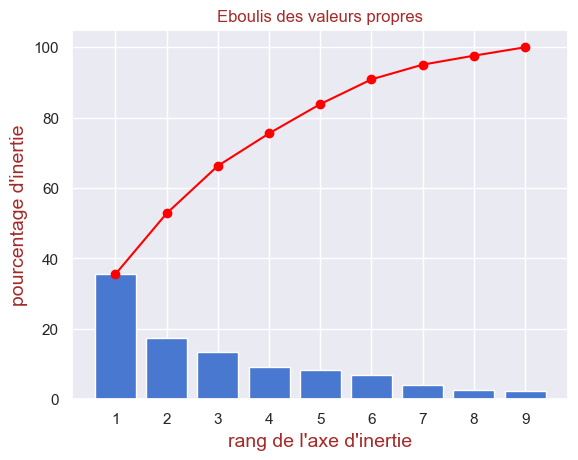

In [82]:
plt.bar(x_list_num_axes_tot, scree_base)
plt.plot(x_list_num_axes_tot, scree_base_cum,c="red",marker='o')
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.ylabel("pourcentage d'inertie")
plt.title("Eboulis des valeurs propres")
plt.grid()
plt.show(block=False)

On a en bleu la variance de chaque nouvelle composante, et en rouge la variance cumulée.

On voit ici que 66% de la variance est prise dans les 3 premières composantes. (76% dans les 4)

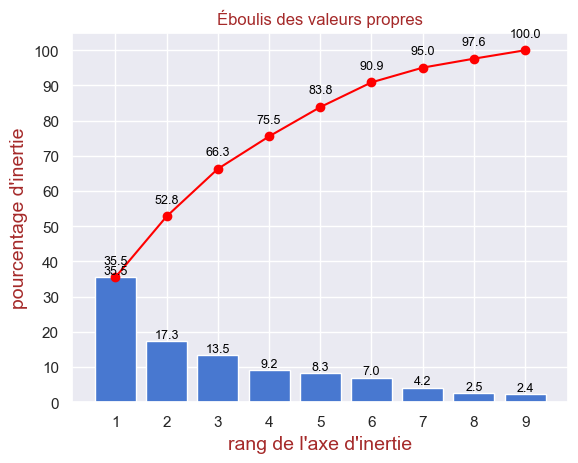

In [83]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(x_list_num_axes_tot, scree_base)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_base):
    plt.text(x_list_num_axes_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(x_list_num_axes_tot, scree_base_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_base_cum):
    plt.text(x_list_num_axes_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.4 - Components : </h4>
</div>

Intéressons nous maintenant à nos fameuses composantes. 
Les Composantes principales nous sont donnée par l'attribut `components_`. Cette variable est généralement nommée `pcs` : 

In [84]:
#les vecteurs Axes principaux enf contion des vecteurs originaux
#sur la première ligne on a ce qui compose l'axe F1, en fonction des variables d'origine
#sur la seconde ligne la décomposition de l'axe F2 en fonction des variables d'origine
#PM j'ai l'impression que ça se lit plutôt colonne par colonne
#PM et qu'on a sur la 1ère colonne la décomposition de la variable d'originie sur les axes principaux
#PM et qu'on a sur la 2ème colonne la décomposition de la variable d'originie sur les axes principaux
pcs_base = pca_base.components_
pcs_base

array([[ 0.23743204, -0.06985492,  0.00964097,  0.49190979,  0.1770513 ,
         0.4485033 ,  0.27027592,  0.46489331,  0.41833109],
       [-0.44899804, -0.14810244,  0.49818433, -0.0234809 ,  0.61525096,
         0.05278628, -0.30955435, -0.0746176 ,  0.2121689 ],
       [-0.38360562,  0.7397135 , -0.34835839,  0.02270088,  0.13730222,
         0.11341087, -0.20293876,  0.32222772, -0.08410114],
       [ 0.07939912,  0.51715074,  0.67268993,  0.12077062, -0.10292993,
        -0.26890444,  0.41496018,  0.00947573, -0.06298969],
       [-0.52101523, -0.19339802, -0.30581933,  0.06258187,  0.18662182,
        -0.26114801,  0.69811342, -0.05668639,  0.00983349],
       [-0.33527605, -0.05006942,  0.04175963,  0.09225303, -0.56906724,
        -0.30375077, -0.21359443,  0.13341404,  0.62873253],
       [ 0.04792767, -0.21180554, -0.01296878,  0.54405443,  0.10623468,
        -0.53292489, -0.27036085,  0.35868027, -0.39954558],
       [ 0.44975675,  0.18491846, -0.24153784, -0.2172032 ,  0

In [85]:
features_base

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [86]:
#CALRIFIONS LE RESULTAT/ TRANSFORMONS pcs_base en DF
pcs_base = pd.DataFrame(pcs_base)
pcs_base.columns = features_base
pcs_base.index = list_Fi_tot
pcs_base.round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
F1,0.24,-0.07,0.01,0.49,0.18,0.45,0.27,0.46,0.42
F2,-0.45,-0.15,0.50,-0.02,0.62,0.05,-0.31,-0.07,0.21
F3,-0.38,0.74,-0.35,0.02,0.14,0.11,-0.20,0.32,-0.08
F4,0.08,0.52,0.67,0.12,-0.10,-0.27,0.41,0.01,-0.06
F5,-0.52,-0.19,-0.31,0.06,0.19,-0.26,0.70,-0.06,0.01
F6,-0.34,-0.05,0.04,0.09,-0.57,-0.30,-0.21,0.13,0.63
F7,0.05,-0.21,-0.01,0.54,0.11,-0.53,-0.27,0.36,-0.40
F8,0.45,0.18,-0.24,-0.22,0.44,-0.51,-0.02,-0.03,0.45
F9,0.01,0.20,-0.16,0.62,0.02,0.05,-0.11,-0.72,0.11


-- **ATTENTION** -- : Nous avons arrondi les résultats pour simplifier l'analyse

**<u>INTERPRETATIONS des Composantes:</u>**

et bien c'est assez simple :

`F1` =
0.49 * PIB/hab  
+0,45 * Acces_Alim_saine  
+0,46 * Score_Transport  
+0.42 Score_stabilite  

**F1 => Niveau de Vie (36% de la variance)** (Axe important pour le poulet bio)

F2 =  
+0,5 * Balance_I/E_Poulet  
+0,62 * Part_Volaille

**F2 => Pays à fort ratio de poulet par habitant (18% de la variance)**
(Axe important pour le poulet)  
Corrélé négativement avec la Prox géo Fra et importateurs de Poulet Fr.  
**Il semble que les importateurs lointain de poulet ne s'orientent pas vers le poulet Français.**

F3 =
0.74 *Population 

**F3 => taille du marché  (13,5% de la variance)** (Axe important mais redondant avec F5)  
(très influencé par Chine et Inde)  

F4 =  
0.52 *Population  
+0.67 * Bal_I/E_Poulet  
+0.41 * Imp_Poulet_Fr

**F4 =>Importateur mondiaux de poulet Internationla+Fra quantitativement (9,23% de la variance)** (Axe négligeable devant F5)  

F5 =  
-0.52 * Distance_Commerciale_Fr  
+0.70 * Exp_Poulet_Fr

**F5 => Importateur de Poulet Francais  (8,33% de la variance)**
(me parait plus pertinent que F4)  
(Corrélation négative avec la Prox Geo commerciale, pas intuitive, qui laisserait penser qu'une part non négligeable des pays importateur de Poulet Français en sont éloignés)


Les axes les plus pertinents semblent être F1, F2, F5 !  
Et même F1 et F5 semblent les plus pertinents pour une étude concernant la France.

pour une représentation plus *visuelle*

<Axes: >

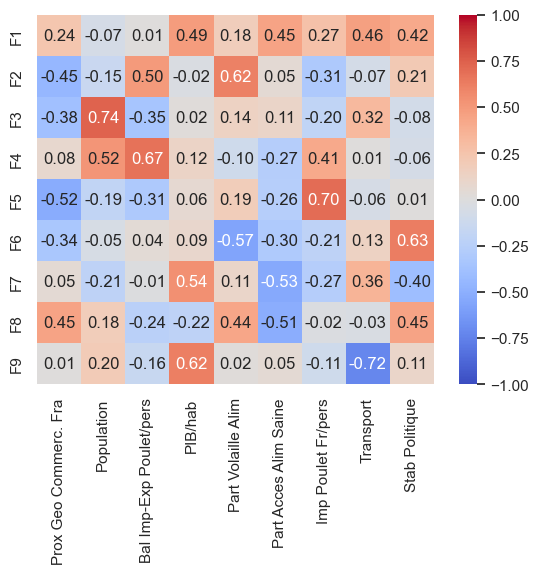

In [87]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_base, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [88]:
#Autre visualisation :
pcs_base.T

,F1,F2,F3,F4,F5,F6,F7,F8,F9
Prox Geo Commerc. Fra,0.237432,-0.448998,-0.383606,0.079399,-0.521015,-0.335276,0.047928,0.449757,0.011144
Population,-0.069855,-0.148102,0.739713,0.517151,-0.193398,-0.050069,-0.211806,0.184918,0.198995
Bal Imp-Exp Poulet/pers,0.009641,0.498184,-0.348358,0.672690,-0.305819,0.041760,-0.012969,-0.241538,-0.155165
PIB/hab,0.491910,-0.023481,0.022701,0.120771,0.062582,0.092253,0.544054,-0.217203,0.621911
Part Volaille Alim,0.177051,0.615251,0.137302,-0.102930,0.186622,-0.569067,0.106235,0.436102,0.023173
Part Acces Alim Saine,0.448503,0.052786,0.113411,-0.268904,-0.261148,-0.303751,-0.532925,-0.513366,0.053574
Imp Poulet Fr/pers,0.270276,-0.309554,-0.202939,0.414960,0.698113,-0.213594,-0.270361,-0.017112,-0.106669
Transport,0.464893,-0.074618,0.322228,0.009476,-0.056686,0.133414,0.358680,-0.033258,-0.723613
Stab Politique,0.418331,0.212169,-0.084101,-0.062990,0.009833,0.628733,-0.399546,0.450420,0.105009


<Axes: >

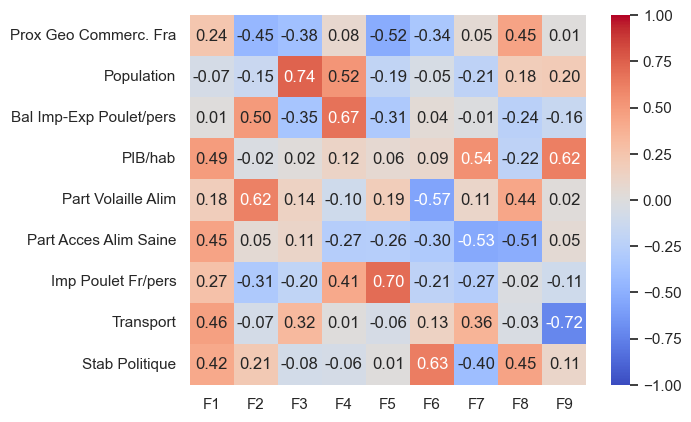

In [89]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_base.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

##### **Pour Rappel : Corrélation des variables d'origines entre elles :**

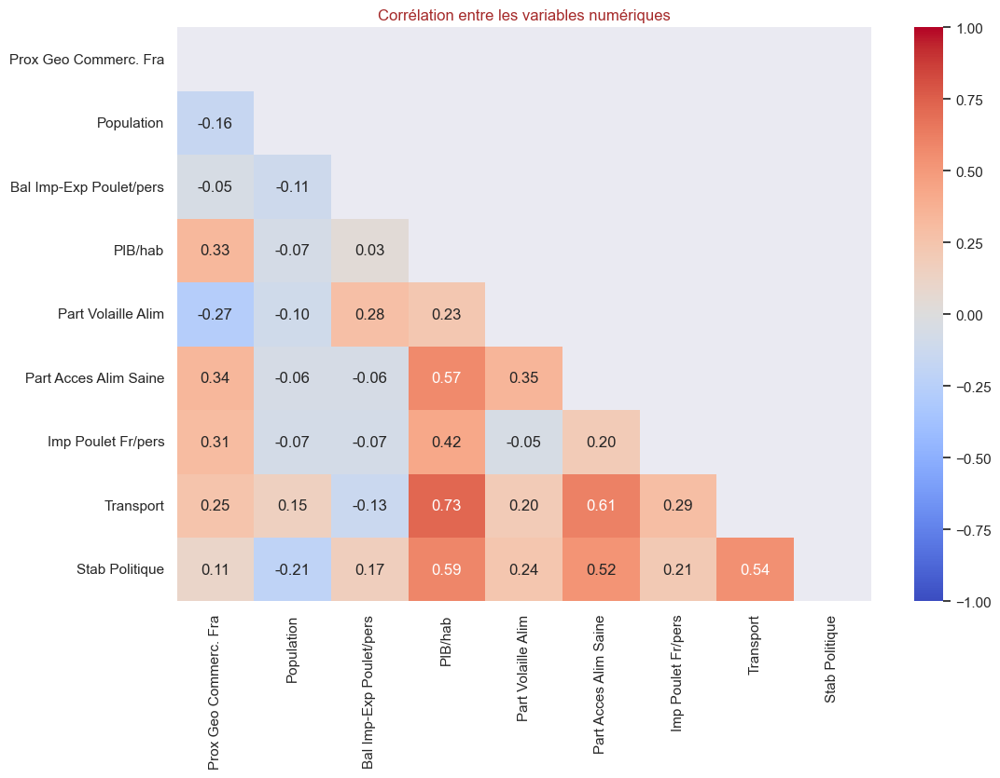

In [90]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_Etude_Marche_analyse_1_1[quant_vars].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_Etude_Marche_analyse_1_1[quant_vars].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

Principale corrélation qui ressort : PIB/hab -AlimSaine - Transport -Stab politique

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.5 - Graphique de Corrélation : </h4>
</div>

Définissons nos axes x et y. Nous allons utiliser les 2 premières composantes. Comme - en code - on commence à compter à partir de 0, cela nous donne : 

In [91]:
#pour F1 et F2
x,y=0,1

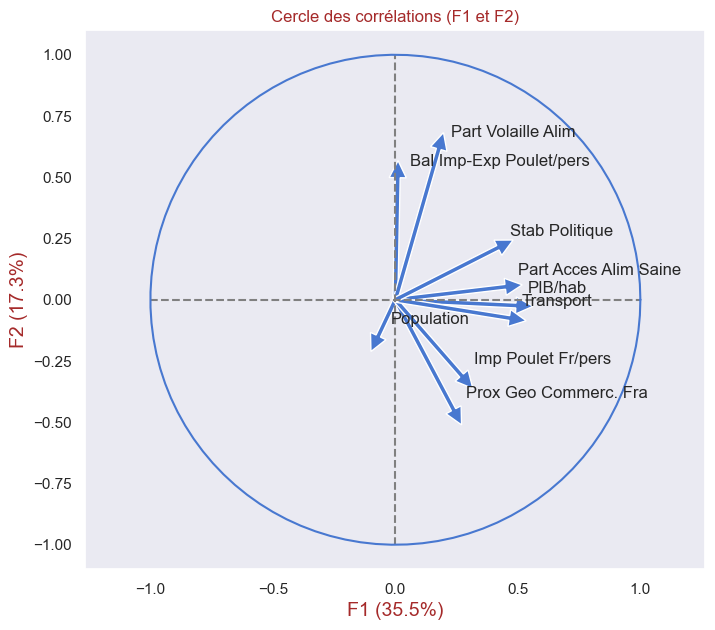

In [92]:
correlation_graph(pca_base, (0,1) , features=df_base_quant.columns)

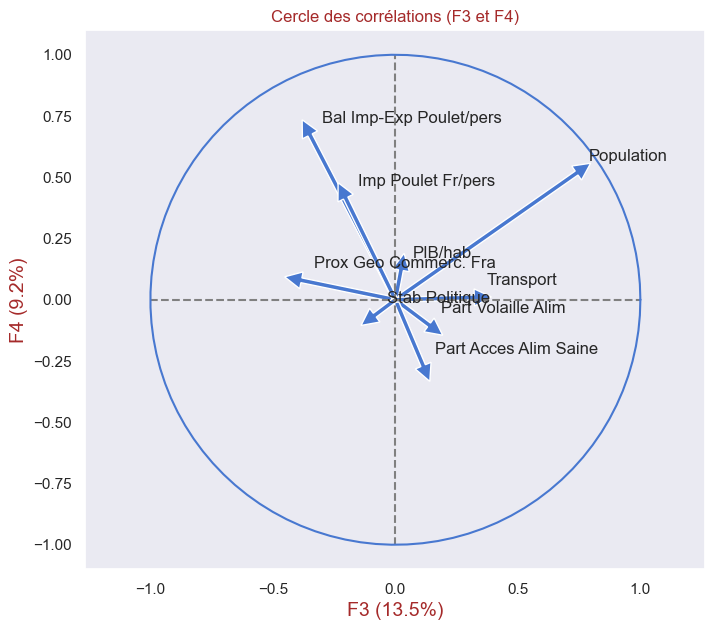

In [93]:
#pour F3 et F4
correlation_graph(pca_base, (2,3) , features=df_base_quant.columns)

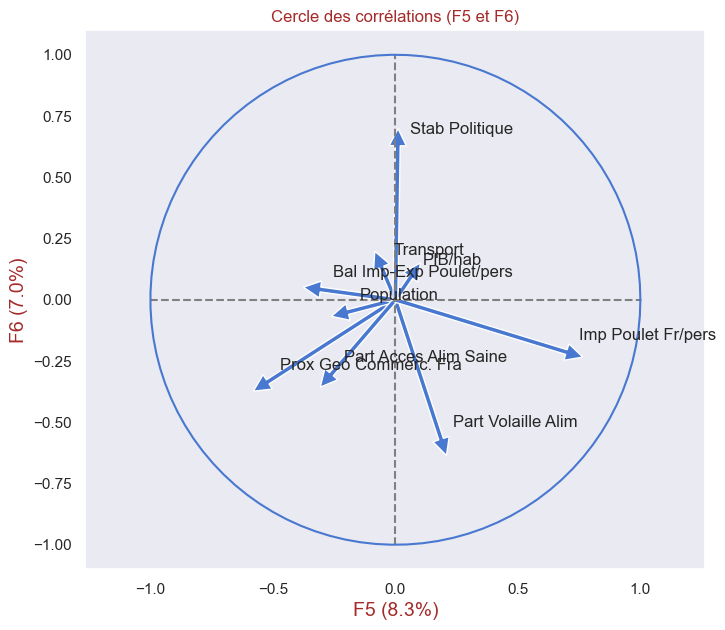

In [94]:
#pour F5 et F6
correlation_graph(pca_base, (4,5) , features=df_base_quant.columns)

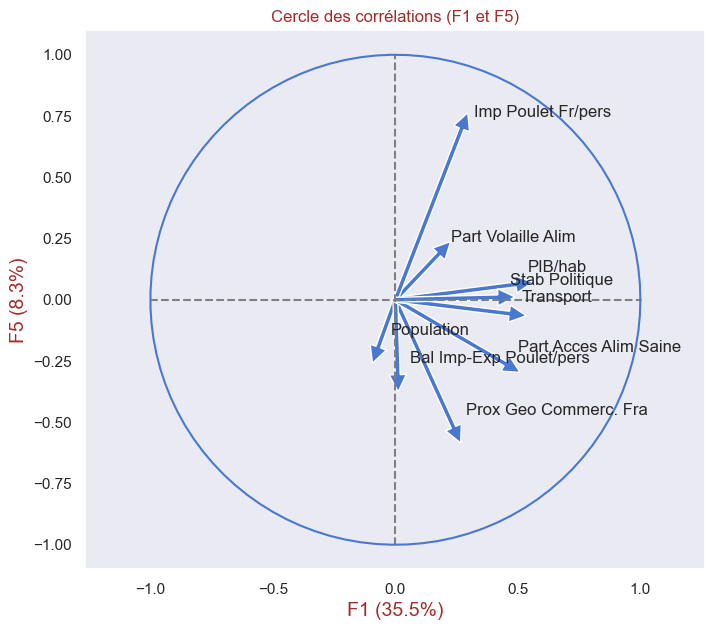

In [95]:
#pour F1 et F5 : les 2 axes qui me paraissent les plus importants
correlation_graph(pca_base, (0,4) , features=df_base_quant.columns)

F1 => Niveau de Vie (36% de la variance) (Axe important pour le poulet bio) 
F5 => Importateur de Poulet Francais  (8,33% de la variance)  
(me parait plus pertinent que F4)  

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.6 - Projection : </h4>
</div>

Travaillons maintenant sur la projection de nos dimensions. Tout d'abord calculons les coordonnées de nos individus dans le nouvel espace : 

In [96]:
#Visualisation de X_base_scaled les données centrées réduites
df_temp = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp.columns = features_base
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.323454,-0.120198,0.446292,-0.644994,-0.622900,-1.761148,-0.283865,-1.228816,-0.573493
ALB,1.038501,-0.290348,1.039287,-0.511537,-0.151173,0.613767,0.138959,-0.368645,0.189613
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
ARM,0.502311,-0.290072,0.835645,-0.497588,-0.355005,-1.076381,0.039320,-0.512007,-1.169089
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742


In [97]:
X_base_scaled.shape

(112, 9)

**Projection de nos données centrées réduites sur les composantes principales**

In [98]:
#maintenant qu'on a fitté notre méthode pca_base avec 9 axes pricnipaux
#on projette nos données centrés réduites X_base_scaled sur nos 9 axes principaux
X_base_proj = pca_base.transform(X_base_scaled)

In [99]:
#Visualisation de X_base_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [100]:
#Visualisation dans un DF de X_base_proj les données centrées réduites projetées sur nos axes principaux
df_X_base_proj = pd.DataFrame(X_base_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_base_proj.columns = list_Fi_tot
df_X_base_proj.index = names_base
df_X_base_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [101]:
df_X_base_proj.describe().round(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
count,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00,112.00
mean,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00
std,1.79,1.25,1.11,0.92,0.87,0.80,0.62,0.48,0.47
min,-3.25,-3.87,-1.92,-2.17,-1.29,-2.06,-1.79,-1.11,-1.11
25%,-1.37,-0.75,-0.60,-0.44,-0.63,-0.43,-0.39,-0.30,-0.33
50%,-0.27,-0.16,-0.18,-0.17,-0.12,0.06,0.02,-0.01,0.01
75%,1.28,0.58,0.31,0.23,0.45,0.44,0.34,0.30,0.27
max,5.48,4.57,6.34,3.68,3.87,2.45,1.91,1.14,1.74


In [102]:
#Création d'une palette pour quant_vars
Ordre_qvars = quant_vars.copy()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_qvars = sns.color_palette("muted", len(Ordre_qvars))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_qvars = dict(zip(Ordre_qvars, couleurs_muted_qvars))

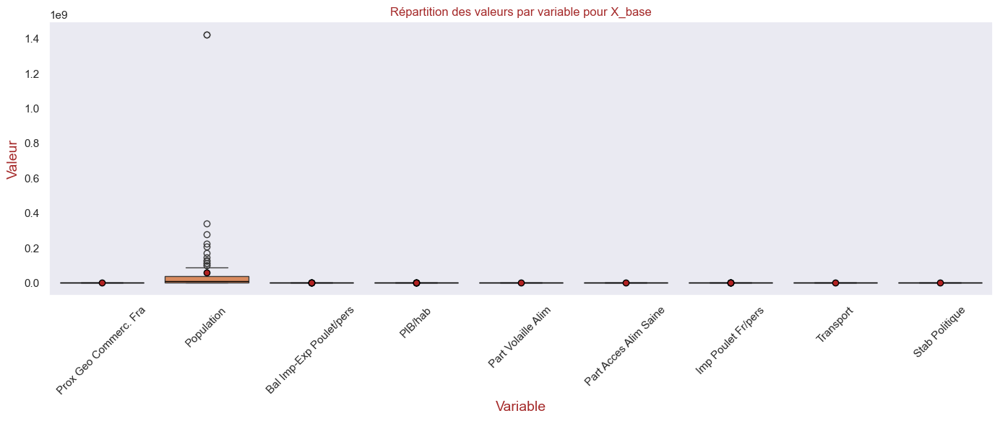

In [103]:
#boxplot de X_base
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base, index=names_base, columns=features_base)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base")
plt.tight_layout()
plt.show()

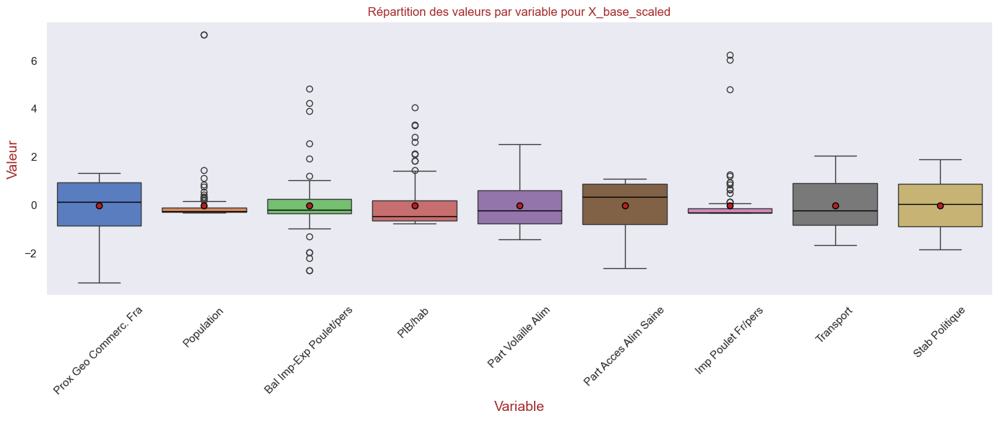

In [104]:
#boxplot de X_base_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base_scaled, index=names_base, columns=features_base)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base_scaled")
plt.tight_layout()
plt.show()


In [105]:
#Création d'une palette pour list_Fi_tot
Ordre_Fi = list_Fi_tot.copy()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_Fi = sns.color_palette("muted", len(Ordre_Fi))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_Fi = dict(zip(Ordre_Fi, couleurs_muted_Fi))

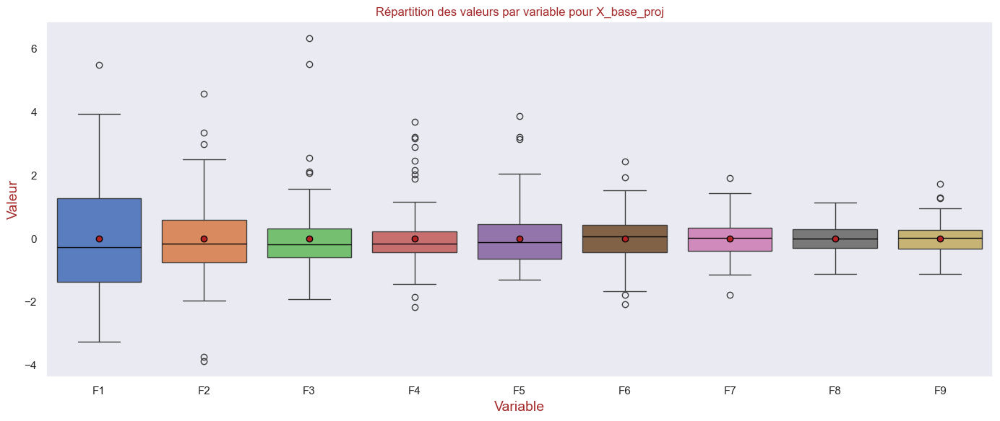

In [106]:
#boxplot de X_base_proj 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base_proj, index=names_base, columns=list_Fi_tot)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_Fi,
            hue_order = Ordre_Fi
           )

#plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base_proj")
plt.tight_layout()
plt.show()


##### <font color='blue'>**PROJECTIONS 2D sur les AXES PRINCIPAUX :**</font>

Essayons avec F1 et F5 : nos axes qui ont le plus de sens  :

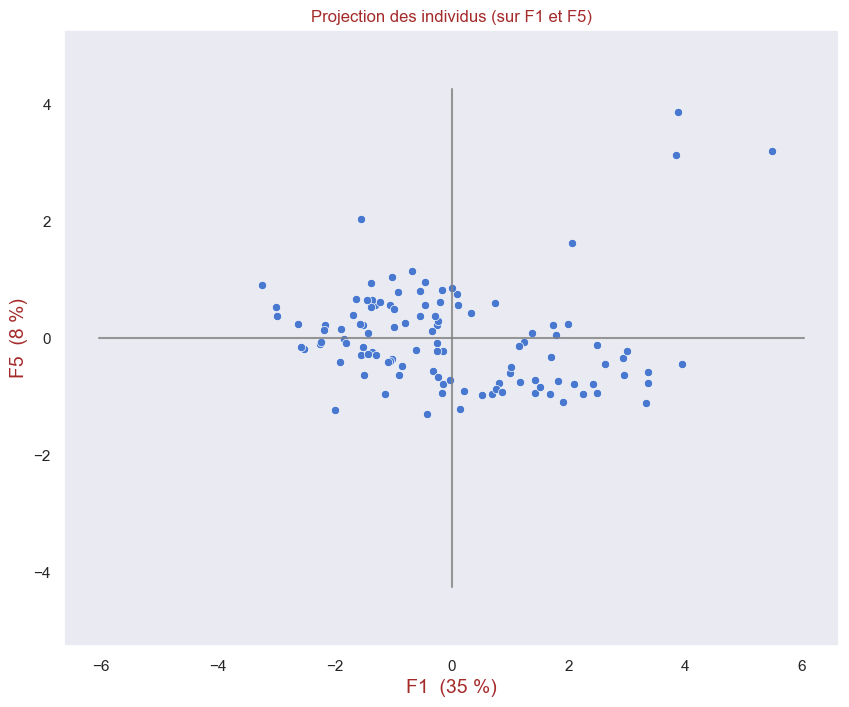

In [107]:
x_y = [0,4] #pour F1 et F5 :
display_factorial_planes(X_base_proj, x_y, pca=pca_base)

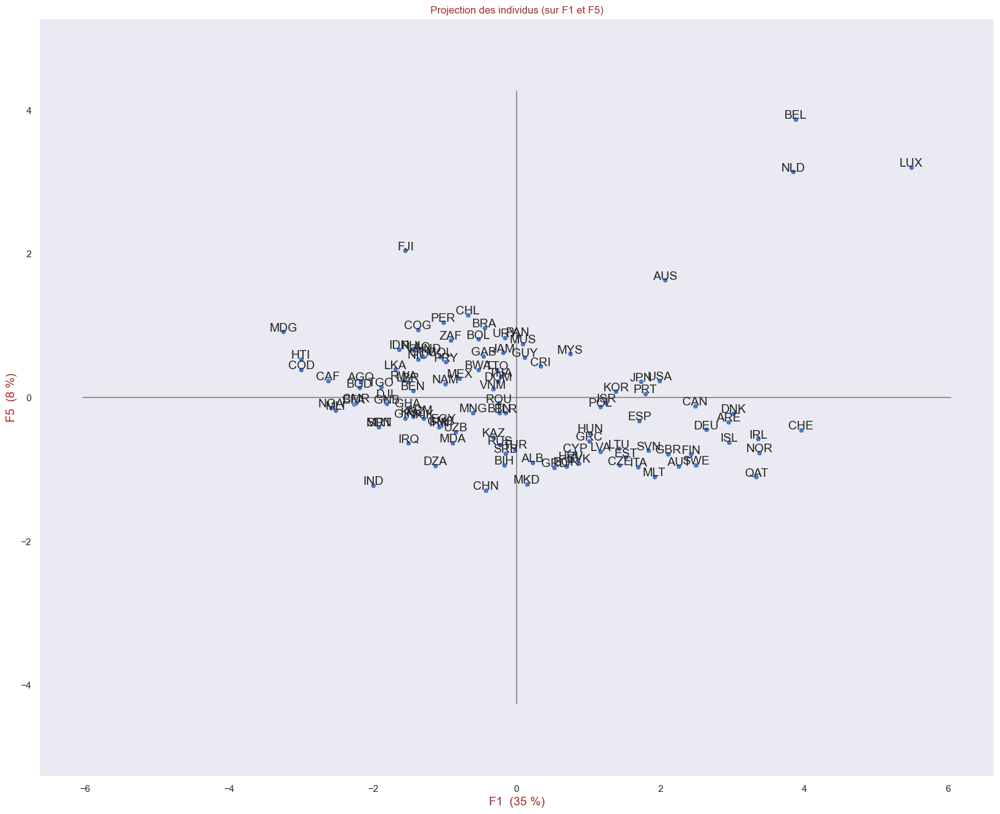

In [108]:
x_y = [0,4] #pour F1 et F5 :
display_factorial_planes(X_base_proj, x_y,labels=names_base,figsize=(20,16), pca=pca_base)

Selon les critères représentés par F1 et F5,  
il y a3 pays qui sortent du lot : BEL, NLD et LUX  
Un peu derrière : AUS, CHE, IRL, NOR, QAT  
Rq : si on additionne les composantes sur F5 et F1, AUS bien mieux placée que CHE, IRL, NOR QAT

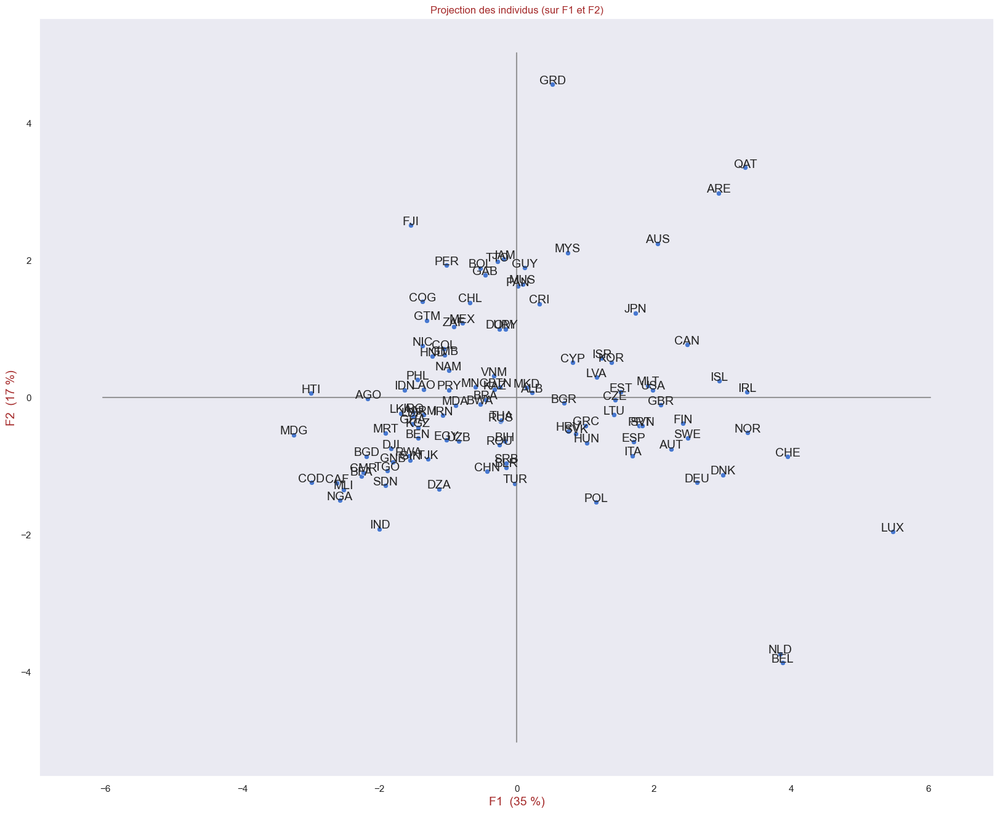

In [109]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_base_proj, x_y,labels=names_base,figsize=(20,16), pca=pca_base)

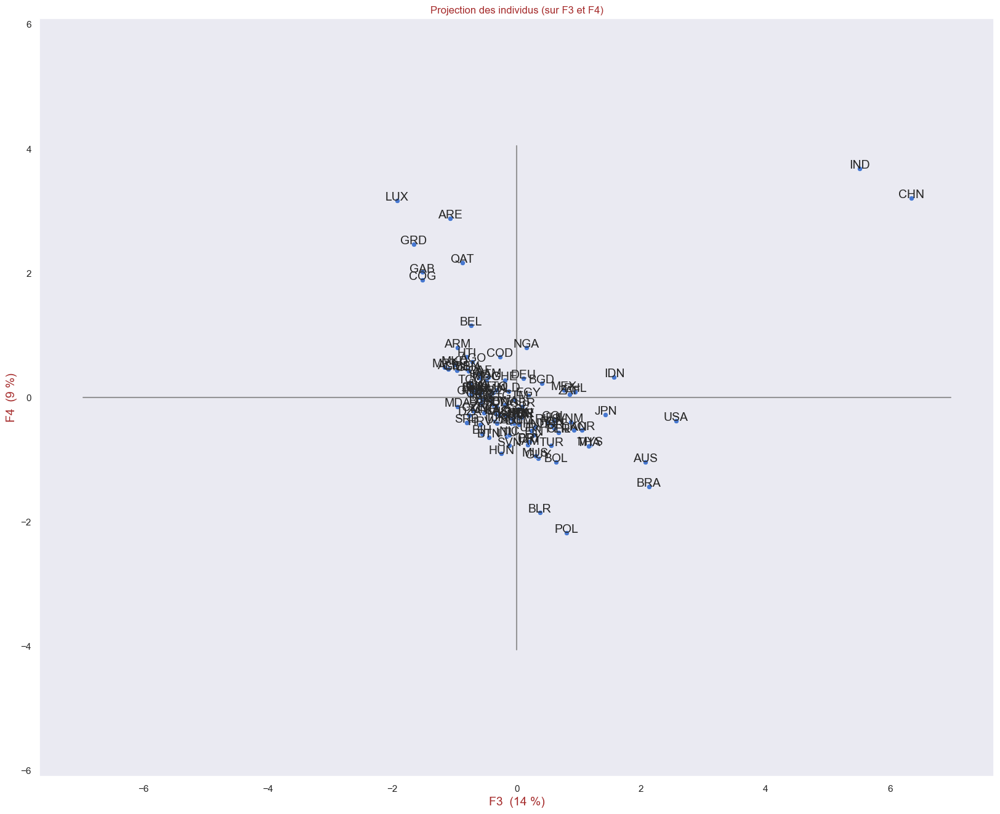

In [110]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_base_proj, x_y,labels=names_base,figsize=(20,16), pca=pca_base)

Les outliers Ind et Chine, mis en avant sur F3 qui porte majoritairement la composante Population

Remarque : visualisation 2D pour F1 -Niveau de vie /F2(conso de Poulet)/F5(Commerce avec la France)

##### <font color='blue'>**PROJECTIONS 3D sur les AXES PRINCIPAUX :**</font>

In [111]:
#Visualisation de X_base_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [112]:
fig = px.scatter_3d(df_temp, x='F1', y='F5', z='F2', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

In [113]:
#Avec la population au lieu des pays consommateurs de poulet
fig = px.scatter_3d(df_temp, x='F1', y='F5', z='F3', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.7 - Les données des pays qui resssortent : </h4>
</div>

<u>**LES OUTLIERS POPULATION : CHN IND**<u>

**Données avec les variables originales :**

In [114]:
#**Données avec les variables originales :**
liste_iso3 = ['CHN', 'IND']
mask_temp = df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3)

df_Etude_Marche_analyse_1_1.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
21,CHN,Chine,Asia,-8716.882,1425179569,0.75184,12597.889086,2.285342,85.4,0.000018,4.0,25.118483
54,IND,Inde,Asia,-7038.913,1425423212,-0.003314,2445.390241,0.510236,44.4,0.0,3.2,21.327015


In [115]:
df_Etude_Marche_analyse_1_1[quant_vars].describe()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666


**Données centrées réduites avec les variables originales :**

In [116]:
#**Données avec les variables Composantes Principales :**
#Attention X_base_proj est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp.columns = features_base
df_temp.index = names_base

liste_iso3 = ['CHN', 'IND']
mask_temp = (df_temp.index).isin(liste_iso3)

df_temp.loc[mask_temp,:]

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
CHN,-0.977245,7.086418,-0.262483,-0.283085,-0.277904,0.518771,-0.301490,1.495059,-0.852679
IND,-0.511070,7.087682,-0.330281,-0.673377,-1.208275,-1.104088,-0.301535,0.348164,-1.001578


In [117]:
df_temp.describe().loc[['mean','50%'],:].round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
mean,-0.00,0.00,0.00,0.00,0.0,-0.00,0.0,0.00,-0.00
50%,0.16,-0.25,-0.18,-0.46,-0.2,0.35,-0.3,-0.23,0.06


**Données avec les variables Composantes Principales :**

In [118]:
#**Données avec les variables Composantes Principales :**
#Attention X_base_proj est un np.Array

#Visualisation dans un DF de X_base_proj les données centrées réduites projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites projetées sur nos axes principaux
df_temp.columns = list_Fi_tot
df_temp.index = names_base

liste_iso3 = ['CHN', 'IND']
mask_temp = (df_temp.index).isin(liste_iso3)

df_temp.loc[mask_temp,:]

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,-0.335922,-1.045935,0.179633,0.146071
IND,-1.998622,-1.915778,5.505174,3.683845,-1.222854,0.244649,-0.821161,0.889142,0.625086


In [119]:
df_temp.describe().loc[['mean','50%'],:].round(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
mean,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00
50%,-0.27,-0.16,-0.18,-0.17,-0.12,0.06,0.02,-0.01,0.01


<u>**LES PAYS EN AVANT : 'LUX','BEL','NLD','AUS'**<u>

**Données avec les variables originales :**

In [120]:
#**Données avec les variables originales :**
liste_iso3 = ['LUX','BEL','NLD','AUS']
mask_temp = df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3)

df_Etude_Marche_analyse_1_1.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085
6,BEL,Belgique,Europe,-378.6808,11641820,-17.998686,49986.832591,1.547455,99.3,2.576017,4.1,58.293839
70,LUX,Luxembourg,Europe,-384.4114,653313,12.971271,125897.199853,2.247201,98.1,2.495129,3.6,87.677727
85,NLD,Pays-Bas,Europe,-556.2308,17904421,-26.287624,57391.6356,1.475962,98.9,2.015567,4.2,68.720383


In [121]:
df_Etude_Marche_analyse_1_1[quant_vars].describe()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0,112.0
mean,-5199.345708,58811047.705357,3.675429,19961.664406,2.81557,72.29375,0.118939,2.957143,46.830569
std,3615.619949,193681701.815743,11.188264,26129.49937,1.91653,25.377607,0.396219,0.700671,25.577827
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8201.53475,3389688.5,0.032974,3413.182233,1.39766,52.275,0.0,2.4,24.526067
50%,-4628.2945,10414776.5,1.718604,8082.376833,2.425665,81.15,0.000408,2.8,48.341232
75%,-1760.76325,38494619.0,6.499356,25053.010392,4.005687,94.475,0.066655,3.6,69.43128
max,-378.6808,1425423212.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666


**Données centrées réduites avec les variables originales :**

In [122]:
#**Données avec les variables Composantes Principales :**
#Attention X_base_proj est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp.columns = features_base
df_temp.index = names_base

liste_iso3 = ['LUX','BEL','NLD','AUS']
mask_temp = (df_temp.index).isin(liste_iso3)

df_temp.loc[mask_temp,:]

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658


In [123]:
df_temp.describe().loc[['mean','50%'],:].round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
mean,-0.00,0.00,0.00,0.00,0.0,-0.00,0.0,0.00,-0.00
50%,0.16,-0.25,-0.18,-0.46,-0.2,0.35,-0.3,-0.23,0.06


**Données avec les variables Composantes Principales :**

In [124]:
#**Données avec les variables Composantes Principales :**
#Attention X_base_proj est un np.Array

#Visualisation dans un DF de X_base_proj les données centrées réduites projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites projetées sur nos axes principaux
df_temp.columns = list_Fi_tot
df_temp.index = names_base

liste_iso3 = ['LUX','BEL','NLD','AUS']
mask_temp = (df_temp.index).isin(liste_iso3)

df_temp.loc[mask_temp,:]

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,-1.186911,-1.147396,-0.020513,-0.774875
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,-0.318770,-0.182242,-0.605771,1.264898
NLD,3.838536,-3.737115,-0.132901,0.103951,3.139845,-0.570621,-0.715697,0.276995,-0.387351


In [125]:
df_temp.describe().loc[['mean','50%'],:].round(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
mean,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00
50%,-0.27,-0.16,-0.18,-0.17,-0.12,0.06,0.02,-0.01,0.01


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.4 - Réduction de l'Etude aux 5 premières composantes F1, F2, F3, F4, F5 (84% de la variance)</h3>
</div>

In [126]:
df_X_base_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [127]:
df_X_base_proj.shape

(112, 9)

<u>**SELECTIONS DE COMPONENTS :**</u>  
Pour la suite ne gardons que F1, F2, F3 et F4 et F5 qui sont interprétables

In [128]:
nb_components_base_selec =5

In [129]:
x_list_num_axes_tot

range(1, 10)

In [130]:
x_list_num_axes_base_selec = range(1,nb_components_base_selec+1)
print(x_list_num_axes_base_selec)

range(1, 6)


In [131]:
for i in x_list_num_axes_base_selec :
    print(i)

1
2
3
4
5


In [132]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'F9']

In [133]:
list_Fi_base_selec = list_Fi_tot[:nb_components_base_selec]
list_Fi_base_selec

['F1', 'F2', 'F3', 'F4', 'F5']

In [134]:
df_X_base_proj_selec_PCA = df_X_base_proj.loc[:,list_Fi_base_selec].copy(deep=True)
df_X_base_proj_selec_PCA

,F1,F2,F3,F4,F5
iso3,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666
...,...,...,...,...,...
URY,-0.165232,1.000201,0.240838,-0.536109,0.833952
USA,1.986476,0.112036,2.560515,-0.375946,0.236084
UZB,-0.847913,-0.635939,-0.317804,-0.416652,-0.475715


In [135]:
df_X_base_proj_selec_PCA.shape

(112, 5)

In [136]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_X_base_proj_selec_PCA)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,112,112,0,112,NaN
F2,float64,112,112,0,112,NaN
F3,float64,112,112,0,112,NaN
F4,float64,112,112,0,112,NaN
F5,float64,112,112,0,112,NaN


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.5 - Etude des outliers</h3>
</div>

##### **Recherches des Outliers :**  
On peut rechercher les outliers sur les données d'origine centrées réduites  
ou sur les données projetées Fa à F5( à partir du moment ou les axes sélectionnées représente,t une ceraines quantité de variance.)  
Nos 5 axes portent 84 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.  

**Travaillons sur une copie temporaire de `df_X_base_proj_selec_PCA`**

In [137]:
df_temp_etude = df_X_base_proj_selec_PCA.copy()

##### **LES DISTANCES :**

**La `distance euclidienne`** : la distance classique dans un espace vectoriel orthonormé.  

**La `distance de Mahalanobis`** :  
La distance de Mahalanobis mesure la distance entre un point et un groupe (ou une distribution) en tenant compte de la corrélation entre les variables.    
Avantage par rapport à la distance euclidienne :  
Elle corrige les effets d’échelle et de corrélation entre les variables.  
Ainsi, un point qui semble proche selon la distance euclidienne peut être un vrai outlier selon Mahalanobis s’il dévie dans une direction atypique

<u>Quand appliquer la `distance de Mahalanobis` dans un processus de PCA ?</u>  
<u>1. Option 1 : appliquer sur les données brutes (après centrage-réduction)</u>  
✅ Avantage : permet de détecter des outliers avant la réduction de dimension (avec toute l'information).  
⚠️ Inconvénient : les données peuvent être bruitées ou difficiles à interpréter dans un grand espace.  

<u>2. Option 2 : appliquer sur les données projetées sur les premières composantes principales</u>  
✅ Avantage : Travailler dans un espace plus compact, avec les dimensions les plus informatives.  
Cela peut réduire le bruit et faciliter la détection des observations aberrantes.  
⚠️ Inconvénient : Perte de l'information des composantes écartées.  
Mais si 95% de la variance a été conservé, ce risque est limité.  

**=>Nos 5 axes portent 84 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.5.1 - Outliers : Etude sur les 5 Composantes Principales : : </h4>
</div>

##### <font color ='blue'> **a.CALCUL DES DISTANCES :**</font>

La distance euclidienne

La distance de Mahalanobis

In [138]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude.mean().values
cov = np.cov(df_temp_etude.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude["mahalanobis"] = df_temp_etude.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,F5,mahalanobis
iso3,,,,,,
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,6.929081
IND,-1.998622,-1.915778,5.505174,3.683845,-1.222854,6.815229
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,6.351042
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,6.007191
NLD,3.838536,-3.737115,-0.132901,0.103951,3.139845,5.149734
GRD,0.521679,4.569259,-1.653704,2.468860,-0.972024,4.911973
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,4.397331
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,4.300577
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,3.582841


In [139]:
df_temp_etude[['mahalanobis']].describe()

,mahalanobis
count,112.000000
mean,1.880474
std,1.196645
min,0.583457
25%,1.243134
50%,1.529420
75%,1.958133
max,6.929081


<u>Calcul du Seuil  pour êter un outlier selon Mahalanobis :</u>  
La distance de Mahalanobis suit une loi du χ² (chi carré) avec p degrés de liberté, 
où p est le nombre de dimensions

In [140]:
from scipy.stats import chi2
import numpy as np

In [141]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_base_selec

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=5 : 3.58


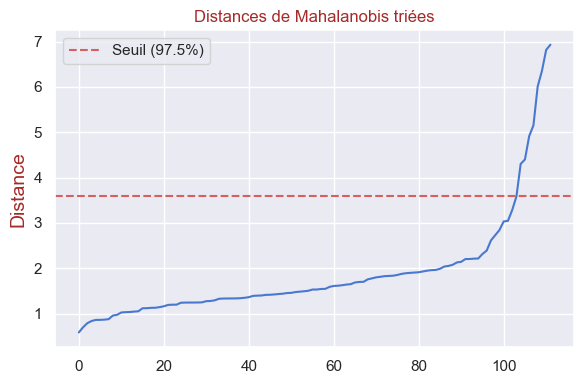

In [142]:
plt.figure(figsize=(6, 4))
plt.plot(df_temp_etude["mahalanobis"].sort_values().values)
plt.axhline(y=threshold, color='r', linestyle='--', label='Seuil (97.5%)')
plt.title("Distances de Mahalanobis triées")
plt.ylabel("Distance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

PM : si je comprends bien, LA distance est calculée sur les données , en connaissant le nombre de dimensions, de telle sorte que les données soient étalées selon une loi deu chi2, ce qui permet de prévoir à partir de quelle distance on a X% d'individus au delà.  
Il faut donc les étudier car il ya aura toujours X% au delà du seuil fourni, ce qui ne veut pas dire que toutes les valeurs sont des outliers ou qu'il n'y en a pas plus.

In [143]:
df_outliers_base = df_temp_etude[df_temp_etude["mahalanobis"] > threshold]

In [144]:
display(df_outliers_base.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,F5,mahalanobis
iso3,,,,,,
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,6.929081
IND,-1.998622,-1.915778,5.505174,3.683845,-1.222854,6.815229
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,6.351042
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,6.007191
NLD,3.838536,-3.737115,-0.132901,0.103951,3.139845,5.149734
GRD,0.521679,4.569259,-1.653704,2.468860,-0.972024,4.911973
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,4.397331
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,4.300577
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,3.582841


La `CHN` et `IND` n'ont des valeurs favorables que pour F3 et F4 qui portent une forte part de variance liée à la population.

##### Recherche classique de seuil

##### Fin Recherche classique de seuil

In [145]:
liste_iso3_outliers_base = list(df_outliers_base.index)
liste_iso3_outliers_base

['ARE', 'AUS', 'BEL', 'CHN', 'GRD', 'IND', 'LUX', 'NLD', 'QAT']

##### **Données des outliers avec les variables originales :**

In [146]:
#**Données avec les variables originales :**
#liste_iso3_outliers_base = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_outliers_base)

df_Etude_Marche_analyse_1_1.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085
6,BEL,Belgique,Europe,-378.6808,11641820,-17.998686,49986.832591,1.547455,99.3,2.576017,4.1,58.293839
21,CHN,Chine,Asia,-8716.882,1425179569,0.75184,12597.889086,2.285342,85.4,0.000018,4.0,25.118483
46,GRD,Grenade,America,-7112.1,116913,57.456143,9509.250006,7.114045,78.9,0.0,2.5,86.25592
54,IND,Inde,Asia,-7038.913,1425423212,-0.003314,2445.390241,0.510236,44.4,0.0,3.2,21.327015
70,LUX,Luxembourg,Europe,-384.4114,653313,12.971271,125897.199853,2.247201,98.1,2.495129,3.6,87.677727
85,NLD,Pays-Bas,Europe,-556.2308,17904421,-26.287624,57391.6356,1.475962,98.9,2.015567,4.2,68.720383
93,QAT,Qatar,Asia,-4863.478,2892455,47.121445,87974.166043,6.392373,100.0,0.067244,3.8,84.360191


##### **Données des outliers centrées réduites avec les variables originales :**

In [147]:
#**Données centrées réduites avec les variables originales :**
#Attention X_base_scaled est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp_sc.columns = features_base
df_temp_sc.index = names_base

#liste_iso3_outliers_base = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_base)

df_comp_Outliers_base = df_temp_sc.loc[mask_temp,:]
display(df_comp_Outliers_base)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186
CHN,-0.977245,7.086418,-0.262483,-0.283085,-0.277904,0.518771,-0.301490,1.495059,-0.852679
GRD,-0.531403,-0.304406,4.828490,-0.401821,2.252923,0.261488,-0.301535,-0.655368,1.548315
IND,-0.511070,7.087682,-0.330281,-0.673377,-1.208275,-1.104088,-0.301535,0.348164,-1.001578
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658
QAT,0.093311,-0.290011,3.900630,2.614600,1.874679,1.096667,-0.131058,1.208335,1.473866


**OBSERVATIONS sur la Comparaison CHN IND et notre première sélection sur les données centrées réduites :**  
<u>IND :</u>  
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1 et un peu sur les transports faiblement 0.3  
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1  
<u>CHN :</u>   
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1, les transports faiblement 1.5, et un peu sur l'Alimentation saine (0.5)   
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1 et un peu les transports 1.5.  

In [148]:
(df_comp_Outliers_base > 1.0).sum(axis=1)

iso3
ARE    6
AUS    4
BEL    5
CHN    2
GRD    3
IND    1
LUX    5
NLD    5
QAT    6
dtype: int64

In [149]:
df_temp_2 = df_comp_Outliers_base.copy(deep=True)

In [150]:
# Nombres de scores supérieurs à 1
valeur_selec = 1.0

df_temp_2[f"Nb Score >{valeur_selec}"] = (df_temp_2[quant_vars] > valeur_selec).sum(axis=1) 

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0
iso3,,,,,,,,,,
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495,6
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742,4
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186,5
CHN,-0.977245,7.086418,-0.262483,-0.283085,-0.277904,0.518771,-0.301490,1.495059,-0.852679,2
GRD,-0.531403,-0.304406,4.828490,-0.401821,2.252923,0.261488,-0.301535,-0.655368,1.548315,3
IND,-0.511070,7.087682,-0.330281,-0.673377,-1.208275,-1.104088,-0.301535,0.348164,-1.001578,1
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153,5
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658,5
QAT,0.093311,-0.290011,3.900630,2.614600,1.874679,1.096667,-0.131058,1.208335,1.473866,6


(Pourquoi 1, parce que cela correspondà l'écart type,  
je considdère que le pays a plutôt un socre un peu supérieur en étant un peu au dessus de l'écart type pa rrapport à zéro( la moyenne) )    
Et qu'il présente donc un critère en sa faveur


Je vais choisir un seuil arbitrairement 4.0 ,  
qui représente donc des données éloigné de plus de 4 écart type par rappor tà la moyenne.  
pour décider des outliers hors norme.

In [151]:
# Nombres de scores supérieurs à 4
#valeur_selec = round(seuil2,2)
valeur_selec = 4

df_temp_2[f"Nb Score >{valeur_selec} ou <-{valeur_selec}"] = ((df_temp_2[quant_vars] > valeur_selec).sum(axis=1) +
                                          (df_temp_2[quant_vars] < (-1* valeur_selec)).sum(axis=1) )

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Nb Score >4 ou <-4
iso3,,,,,,,,,,,
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495,6,1
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742,4,0
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186,5,1
CHN,-0.977245,7.086418,-0.262483,-0.283085,-0.277904,0.518771,-0.301490,1.495059,-0.852679,2,1
GRD,-0.531403,-0.304406,4.828490,-0.401821,2.252923,0.261488,-0.301535,-0.655368,1.548315,3,1
IND,-0.511070,7.087682,-0.330281,-0.673377,-1.208275,-1.104088,-0.301535,0.348164,-1.001578,1,1
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153,5,2
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658,5,1
QAT,0.093311,-0.290011,3.900630,2.614600,1.874679,1.096667,-0.131058,1.208335,1.473866,6,0


**OBSERVATIONS :**  
Sachant que notre sélection de variables a été soigneusement choisie pour être équilibrée sur les thèmes avec peu de corrélation entre elles.  
On peut accorder un intérêt à nos valeurs originales (centrées réduites).  

La `Chine` et l'`Inde` ne semblent **pas pertinentes** pour notre choix (peu de score favorable >1.0), hormis par leur population.  
Et possède de très gros outliers (les seuls supérieurs à 7).  

`GRD` est dans une position intermédiaire avec quelques résultats pertinents (>1.0) et son outier favorable, sur une variable intéressante( Bal Imp-Exp Poulet/pers	) mais avec une population modeste et éloignée).  

Les autres pays ont des scores >1.0 sur 4 à 6 variables sur 9.  (et moins de 1 très gors outliers, sauf LUX (2))
Ils pourraient donc être des candidats intéressants dans notre étude.    
Il faut vori si nous les écartons pour les étudier séparément, ou si les garder ne perturbe pas trop.  

Note : la légère corrélation sur PIB, Alimentation saine, Transport, Politique, renforce le score de ARE, QAT.  
A noter que CHN et IND ont leurs gros outliers(>4.0) sur la Population.  
Les autres pays ont ont leurs gros outliers liés à la consommation de Poulet : Bal Imp-Exp Poulet/pers	ou Imp Poulet Fr/pers   
(+PIB pour LUX)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.5.2 - Outliers : Etude sur les 9 Composantes Principales : : </h4>
</div>

##### <font color='blue'>**Données sur les 9 Composantes Principales :**</font>

In [152]:
#Visualisation dans un DF de X_bis_proj les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9 = pd.DataFrame(X_base_proj).copy() #les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9.columns = list_Fi_tot
df_temp_etude_9.index = names_base
df_temp_etude_9.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [153]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude_9.mean().values
cov = np.cov(df_temp_etude_9.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude_9["mahalanobis"] = df_temp_etude_9.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
IND,-1.998622,-1.915778,5.505174,3.683845,-1.222854,0.244649,-0.821161,0.889142,0.625086,7.316183
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,-0.335922,-1.045935,0.179633,0.146071,7.162888
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,-0.318770,-0.182242,-0.605771,1.264898,7.038488
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,-1.186911,-1.147396,-0.020513,-0.774875,6.673049
NLD,3.838536,-3.737115,-0.132901,0.103951,3.139845,-0.570621,-0.715697,0.276995,-0.387351,5.422277
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638,5.202692
GRD,0.521679,4.569259,-1.653704,2.468860,-0.972024,-0.053070,-0.914408,0.198334,-0.330404,5.196765
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,0.103267,0.932474,-0.641238,0.360714,4.813922
IRL,3.358454,0.079128,-0.044953,-0.413019,-0.573238,0.082031,1.281206,0.183678,1.735242,4.743734


In [154]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_base

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=9 : 4.36


In [155]:
df_outliers_base_9 = df_temp_etude_9[df_temp_etude_9["mahalanobis"] > threshold]

In [156]:
display(df_outliers_base_9.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
IND,-1.998622,-1.915778,5.505174,3.683845,-1.222854,0.244649,-0.821161,0.889142,0.625086,7.316183
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,-0.335922,-1.045935,0.179633,0.146071,7.162888
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,-0.318770,-0.182242,-0.605771,1.264898,7.038488
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,-1.186911,-1.147396,-0.020513,-0.774875,6.673049
NLD,3.838536,-3.737115,-0.132901,0.103951,3.139845,-0.570621,-0.715697,0.276995,-0.387351,5.422277
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638,5.202692
GRD,0.521679,4.569259,-1.653704,2.468860,-0.972024,-0.053070,-0.914408,0.198334,-0.330404,5.196765
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,0.103267,0.932474,-0.641238,0.360714,4.813922
IRL,3.358454,0.079128,-0.044953,-0.413019,-0.573238,0.082031,1.281206,0.183678,1.735242,4.743734


Le seul nouveau pays est l'irlande, on n'avait bien identifié.

In [157]:
liste_iso3_outliers_base_9 = list(df_outliers_base_9.index)
liste_iso3_outliers_base_9

['ARE', 'AUS', 'BEL', 'CHN', 'GRD', 'IND', 'IRL', 'LUX', 'NLD', 'NOR', 'QAT']

In [158]:
liste_iso3_outliers_suppl= [iso for iso in liste_iso3_outliers_base_9 if iso not in liste_iso3_outliers_base]
liste_iso3_outliers_suppl

['IRL', 'NOR']

**Données avec les variables originales :**

In [159]:
#**Données avec les variables originales :**

mask_temp = df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_outliers_suppl)

df_Etude_Marche_analyse_1_1.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
55,IRL,Irlande,Europe,-948.9664,5110016,-0.132407,105993.272773,4.308361,99.0,0.027671,3.5,78.672989
86,NOR,Norvège,Europe,-1544.384,5456801,0.163508,106622.826063,2.309558,98.5,0.0,3.9,77.725121


**Données centrées réduites avec les variables originales :**

In [160]:
#**Données centrées réduites avec les variables originales :**
#Attention X_base_scaled est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp_sc.columns = features_base
df_temp_sc.index = names_base

#liste_iso3_outliers_suppl = list((df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_suppl)

df_comp_CHN_IND = df_temp_sc.loc[mask_temp,:]
display(df_comp_CHN_IND)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
IRL,1.180844,-0.278510,-0.341872,3.307307,0.782404,1.057085,-0.231383,0.778250,1.250518
NOR,1.015424,-0.276712,-0.315304,3.331509,-0.265212,1.037294,-0.301535,1.351697,1.213293


`IRL` et `NOR` ne correspondent pas à de gros outliers

**BILAN :**  
['ARE', 'AUS', 'BEL', 'CHN', 'GRD', 'IND', 'LUX', 'NLD', 'QAT']  
On a bien la CHN et l'IND qui ont peu de facteur positifs, et qui ont des outliers.  

Pour les autres pays la question se pose de les retirer pour les étudier à part.  
Mai ils sont intéressants pour notre projet.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2base.6 - Classement données</h3>
</div>

In [161]:
##### Une fonction qui prend un dataframe et retourne un dataframe avec des colonnes complémentaires et trié

def Classement (DF, val=1.0 ) :
    """
    Prend le dataframe en entrée et calcul le nombre de valeur supérieur à val (default=1.0), et le score total, et renvoie une copie du DF complété
    """
    #
    df=DF.copy()
    list_col = df.columns
    
    df[f"Nb Score >{val}"] = ((df[list_col] > val).sum(axis=1))
    df["Score total"] = (df[list_col]).sum(axis=1)
    df.sort_values(by=[f"Nb Score >{val}","Score total"],ascending=False,inplace=True)
    return df


In [162]:
df_X_base_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.323454,-0.120198,0.446292,-0.644994,-0.622900,-1.761148,-0.283865,-1.228816,-0.573493
ALB,1.038501,-0.290348,1.039287,-0.511537,-0.151173,0.613767,0.138959,-0.368645,0.189613
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
ARM,0.502311,-0.290072,0.835645,-0.497588,-0.355005,-1.076381,0.039320,-0.512007,-1.169089
AUS,-3.129805,-0.169126,-0.501554,1.841613,1.327164,0.970004,-0.301535,1.638421,1.287742


In [163]:
df_X_base_scaled_Classement = Classement(df_X_base_scaled,1.0)
df_X_base_scaled_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495,6,11.874650
QAT,0.093311,-0.290011,3.900630,2.614600,1.874679,1.096667,-0.131058,1.208335,1.473866,6,11.841019
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153,5,15.216578
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186,5,9.025086
CHE,1.331693,-0.259414,0.002485,2.832273,-0.442636,1.049168,0.681730,2.068506,1.641377,5,8.905182
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658,5,7.627386
NOR,1.015424,-0.276712,-0.315304,3.331509,-0.265212,1.037294,-0.301535,1.351697,1.213293,5,6.790454
DNK,1.124764,-0.274398,-0.645649,1.847868,-0.458100,1.061043,0.637313,1.638421,1.176068,5,6.107329
IRL,1.180844,-0.278510,-0.341872,3.307307,0.782404,1.057085,-0.231383,0.778250,1.250518,4,7.504642


In [164]:
df_X_base_scaled.sort_values(by='Imp Poulet Fr/pers',ascending=False).head(15)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
BEL,1.339281,-0.244634,-1.945925,1.154255,-0.664647,1.068959,6.229189,1.638421,0.450186
LUX,1.337689,-0.301624,0.834591,4.072472,-0.297895,1.021461,6.024120,0.921612,1.604153
NLD,1.289954,-0.212155,-2.690115,1.438918,-0.702118,1.053126,4.808335,1.781783,0.859658
GAB,-0.010570,-0.292406,2.553542,-0.443422,1.462830,-0.379739,1.278850,-1.085454,-0.517656
ARE,0.007863,-0.251894,4.240910,1.297307,1.813276,1.005628,1.207643,1.638421,0.915495
PRT,1.086361,-0.250986,-0.105177,0.186496,0.368132,0.621684,0.954884,0.921612,0.934108
COG,-0.151884,-0.273713,1.941594,-0.668581,1.005922,-2.034263,0.948082,-1.228816,0.003490
DEU,1.254989,0.131085,-0.148319,1.112538,-0.590773,1.017503,0.853852,1.925145,0.766596
CHE,1.331693,-0.259414,0.002485,2.832273,-0.442636,1.049168,0.681730,2.068506,1.641377


In [165]:
df_X_base_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442,0.499138,0.390773,0.284475,0.252558
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494,-0.397489,-0.769218,-0.012263,-0.224372
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638
ARM,-1.359266,-0.251834,-0.955116,0.802998,-0.232488,-0.447675,0.612704,-0.033950,-0.313600
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136


In [166]:
df_X_base_proj_Classement = Classement(df_X_base_proj,1.0)
df_X_base_proj_Classement.head(10)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,1.249521,0.672992,-1.106282,0.219136,5,8.004987
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,-0.318770,-0.182242,-0.605771,1.264898,4,8.137407
JPN,1.730749,1.234422,1.427251,-0.278377,0.221988,1.016101,-0.020676,-0.221046,-0.675918,4,4.434494
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,0.103267,0.932474,-0.641238,0.360714,3,7.638989
USA,1.986476,0.112036,2.560515,-0.375946,0.236084,-0.429012,1.050948,-0.121222,0.960895,3,5.980773
IRL,3.358454,0.079128,-0.044953,-0.413019,-0.573238,0.082031,1.281206,0.183678,1.735242,3,5.688528
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,-0.494337,0.256632,-0.737445,-1.023638,3,5.403026
NOR,3.368915,-0.508761,0.067191,-0.312608,-0.766197,0.811005,1.424497,-0.383407,1.307969,3,5.008605
FJI,-1.547264,2.513978,0.591268,-0.385285,2.046329,1.399925,-0.345726,0.185749,0.422897,3,4.881870


**ATTENTION :**  
Les Composantes principales ne sont plus toutes forcément des valeurs positives, puisque elles peuvent être composées de composantes négatives sur certains axes.  
L'interpretation est donc un peu délicat il faut regarder ce que les axes contiennent pour savroi si un score élevé est favorable ou non.
Ce sera plus pertinent de regarder ce classement sur les Axes principaux dont on comprend la signifcation,  
et surtout beaucoup plus sur les données centrées réduites car là on sait (par construction des variables qu'un score positif est un score favorable)

In [167]:
df_X_base_proj_selec_PCA.head(2)

,F1,F2,F3,F4,F5
iso3,,,,,
AGO,-2.169444,-0.017806,-0.710324,0.578860,0.224442
ALB,0.219255,0.070595,-1.100889,0.462383,-0.903494


In [168]:
df_X_base_proj_selec_PCA_Classement = Classement(df_X_base_proj_selec_PCA,1.0)
df_X_base_proj_selec_PCA_Classement.head(10)

,F1,F2,F3,F4,F5,Nb Score >1.0,Score total
iso3,,,,,,,
AUS,2.058693,2.249262,2.065102,-1.039103,1.635666,4,6.969620
LUX,5.483094,-1.958364,-1.920075,3.166927,3.207711,3,7.979292
ARE,2.941646,2.982925,-1.068363,2.881775,-0.336168,3,7.401815
QAT,3.332829,3.357297,-0.876010,2.173479,-1.103823,3,6.883772
JPN,1.730749,1.234422,1.427251,-0.278377,0.221988,3,4.336033
BEL,3.879479,-3.869146,-0.734719,1.163218,3.873900,3,4.312732
CHN,-0.428511,-1.077592,6.337130,3.208271,-1.289731,2,6.749568
GRD,0.521679,4.569259,-1.653704,2.468860,-0.972024,2,4.934071
USA,1.986476,0.112036,2.560515,-0.375946,0.236084,2,4.519164


In [169]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

31286

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2bis-Hors CHN IND- Réduction de dimension par ACP (Analyse en Composantes Principales </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.1 - Préparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.1.1 - Imports :(Déjà fait) </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.1.2- option Graphique : (déjà fait)</h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.1.3- Data : </h4>
</div>

In [170]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [171]:
df_Etude_Marche_analyse_1_1.shape

(112, 12)

In [172]:
#CREATION d'un DF sans les outliers CHN et IND : (pour une nouvelle étude)
liste_iso3_temp = ['CHN','IND']
mask_temp = ~(df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_temp))

df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND = df_Etude_Marche_analyse_1_1.loc[mask_temp,:]
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [173]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.shape

(110, 12)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.1.4- Fonctions pour ACP: </h4>
</div>

Déjà faite

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.2 - Data Preparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.2.1 - Quick tour : </h4>
</div>

In [174]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [175]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1 (df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],110,110,0,110,0.0
pays,string[python],110,110,0,110,0.0
continent,string[python],110,110,0,5,0.0
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN


In [176]:
Premieres_Analyses(df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND)


---- SHAPE ----


(110, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 110 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     110 non-null    string 
 1   pays                     110 non-null    string 
 2   continent                110 non-null    string 
 3   Prox Geo Commerc. Fra    110 non-null    Float64
 4   Population               110 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  110 non-null    Float64
 6   PIB/hab                  110 non-null    Float64
 7   Part Volaille Alim       110 non-null    Float64
 8   Part Acces Alim Saine    110 non-null    Float64
 9   Imp Poulet Fr/pers       110 non-null    Float64
 10  Transport                110 non-null    Float64
 11  Stab Politique           110 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 12.1 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0
mean,-5150.644766,33965768.745455,3.735451,20187.846674,2.841348,72.428182,0.121102,2.945455,47.259802
std,3628.445949,57581642.758081,11.281307,26304.26403,1.92054,25.438309,0.399507,0.699493,25.607641
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8079.743,3387239.5,0.04186,3491.884738,1.407101,53.2,0.0,2.4,24.881517
50%,-4536.2785,10327283.0,1.949559,8082.376833,2.442977,81.15,0.000626,2.75,49.526068
75%,-1743.15775,35461010.5,6.600689,25533.223319,4.025661,94.625,0.067048,3.6,69.905214
max,-378.6808,341534045.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],110,110,0,110,0.0
pays,string[python],110,110,0,110,0.0
continent,string[python],110,110,0,5,0.0
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN


In [177]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

Quel est le % de valeurs manquantes par colonne ? 

In [178]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.isna().mean()

iso3                       0.0
pays                       0.0
continent                  0.0
Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

Y a-t-il des lignes en double ? 

In [179]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.duplicated().sum()

0

Combien y a-t-il de valeurs différentes par colonne ? 

In [180]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.nunique()

iso3                       110
pays                       110
continent                    5
Prox Geo Commerc. Fra      110
Population                 110
Bal Imp-Exp Poulet/pers    110
PIB/hab                    110
Part Volaille Alim         110
Part Acces Alim Saine      103
Imp Poulet Fr/pers          64
Transport                   26
Stab Politique             110
dtype: int64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.2.2 - Data Selection (variables quantitatives) : </h4>
</div>

In [181]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [182]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.shape

(110, 12)

In [183]:
df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.dtypes

iso3                       string[python]
pays                       string[python]
continent                  string[python]
Prox Geo Commerc. Fra             Float64
Population                          Int64
Bal Imp-Exp Poulet/pers           Float64
PIB/hab                           Float64
Part Volaille Alim                Float64
Part Acces Alim Saine             Float64
Imp Poulet Fr/pers                Float64
Transport                         Float64
Stab Politique                    Float64
dtype: object

Nous allons sélectionner d'abord que certaines colones : 

In [184]:
#Rappel :
# Liste des variables quantitatives
print(quant_vars) 

['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport', 'Stab Politique']


In [185]:
df_bis_quant = (df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.set_index(keys=['iso3'])[quant_vars] ).copy(deep=True)
df_bis_quant.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
ALB,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
ARM,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
AUS,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


Notre dataframe a maintenant une dimension de : 

In [186]:
df_bis_quant.shape

(110, 9)

In [187]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_bis_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN
Transport,Float64,110,110,0,26,NaN
Stab Politique,Float64,110,110,0,110,NaN


In [188]:
Premieres_Analyses(df_bis_quant)


---- SHAPE ----


(110, 9)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 110 entries, AGO to ZAF
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Prox Geo Commerc. Fra    110 non-null    Float64
 1   Population               110 non-null    Int64  
 2   Bal Imp-Exp Poulet/pers  110 non-null    Float64
 3   PIB/hab                  110 non-null    Float64
 4   Part Volaille Alim       110 non-null    Float64
 5   Part Acces Alim Saine    110 non-null    Float64
 6   Imp Poulet Fr/pers       110 non-null    Float64
 7   Transport                110 non-null    Float64
 8   Stab Politique           110 non-null    Float64
dtypes: Float64(8), Int64(1)
memory usage: 9.6 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0
mean,-5150.644766,33965768.745455,3.735451,20187.846674,2.841348,72.428182,0.121102,2.945455,47.259802
std,3628.445949,57581642.758081,11.281307,26304.26403,1.92054,25.438309,0.399507,0.699493,25.607641
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8079.743,3387239.5,0.04186,3491.884738,1.407101,53.2,0.0,2.4,24.881517
50%,-4536.2785,10327283.0,1.949559,8082.376833,2.442977,81.15,0.000626,2.75,49.526068
75%,-1743.15775,35461010.5,6.600689,25533.223319,4.025661,94.625,0.067048,3.6,69.905214
max,-378.6808,341534045.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN
Transport,Float64,110,110,0,26,NaN
Stab Politique,Float64,110,110,0,110,NaN


In [189]:
df_bis_quant.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0
mean,-5150.64,33965768.75,3.74,20187.85,2.84,72.43,0.12,2.95,47.26
std,3628.45,57581642.76,11.28,26304.26,1.92,25.44,0.4,0.7,25.61
min,-16780.16,116913.0,-26.36,429.4,0.12,6.4,0.0,1.8,0.47
25%,-8079.74,3387239.5,0.04,3491.88,1.41,53.2,0.0,2.4,24.88
50%,-4536.28,10327283.0,1.95,8082.38,2.44,81.15,0.0,2.75,49.53
75%,-1743.16,35461010.5,6.6,25533.22,4.03,94.62,0.07,3.6,69.91
max,-378.68,341534045.0,57.46,125897.2,7.66,100.0,2.58,4.4,95.26


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.2.3 - Cleaning non nécessaire : données déjà propres </h4>
</div>

##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

Traitons les valeurs manquantes. On rappelle que : 

In [190]:
df_bis_quant.isna().mean()

Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.2.4 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_bis` la matrice des données : 

In [191]:
#X_bis récupère les valeurs de df_bis_quant dans un np.array
X_bis = df_bis_quant.values
#X_bis[:5]
pd.DataFrame(X_bis).head()

,0,1,2,3,4,5,6,7,8
0,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [192]:
X_bis.shape

(110, 9)

Nous enregistrons les noms de nos pays-iso3 dans une variable `names_bis` : 

In [193]:
names_bis = df_bis_quant.index
names_bis

Index(['AGO', 'ALB', 'ARE', 'ARM', 'AUS', 'AUT', 'BEL', 'BEN', 'BFA', 'BGD',
       ...
       'TGO', 'THA', 'TJK', 'TTO', 'TUR', 'URY', 'USA', 'UZB', 'VNM', 'ZAF'],
      dtype='string', name='iso3', length=110)

In [194]:
names_bis.shape

(110,)

et nos colonnes, nos features_bis, dans une variable `features_bis` : 

In [195]:
features_bis = df_bis_quant.columns
features_bis

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [196]:
features_bis.shape

(9,)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.3 - PCA </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.1 - Scaling : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données X_bis :

In [197]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_bis = StandardScaler()
scaler_bis

StandardScaler()

In [198]:
#préparation de la fonction pour s'adapter au format de nos données X_bis (Fitage) :
scaler_bis.fit(X_bis)

StandardScaler()

In [199]:
#Centrage -réduction de X_bis dans le np.array X_bis_scaled :
X_bis_scaled = scaler_bis.transform(X_bis)
pd.DataFrame(X_bis_scaled).head(5) #visualisation de X_bis_scaled

,0,1,2,3,4,5,6,7,8
0,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
1,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
2,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
3,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
4,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


##### VISUALISATION de `X_bis_scaled` :

In [200]:
type(X_bis_scaled)

numpy.ndarray

In [201]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_bis_scaled).describe().round(2)

,0,1,2,3,4,5,6,7,8
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.59,-2.68,-0.75,-1.42,-2.61,-0.30,-1.65,-1.84
25%,-0.81,-0.53,-0.33,-0.64,-0.75,-0.76,-0.30,-0.78,-0.88
50%,0.17,-0.41,-0.16,-0.46,-0.21,0.34,-0.30,-0.28,0.09
75%,0.94,0.03,0.26,0.20,0.62,0.88,-0.14,0.94,0.89
max,1.32,5.37,4.78,4.04,2.52,1.09,6.17,2.09,1.88


In [202]:
#Visualisation de X_bis_scaled les données centrées réduites
df_X_bis_scaled = pd.DataFrame(X_bis_scaled) #les données centrées réduites
df_X_bis_scaled.columns = features_bis
df_X_bis_scaled.index = names_bis
df_X_bis_scaled.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [203]:
#Attention pour std ddf=1 dans describe
df_X_bis_scaled.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.59,-2.68,-0.75,-1.42,-2.61,-0.30,-1.65,-1.84
25%,-0.81,-0.53,-0.33,-0.64,-0.75,-0.76,-0.30,-0.78,-0.88
50%,0.17,-0.41,-0.16,-0.46,-0.21,0.34,-0.30,-0.28,0.09
75%,0.94,0.03,0.26,0.20,0.62,0.88,-0.14,0.94,0.89
max,1.32,5.37,4.78,4.04,2.52,1.09,6.17,2.09,1.88


In [204]:
df_X_bis_scaled.std(ddof=1).round(2)

Prox Geo Commerc. Fra      1.0
Population                 1.0
Bal Imp-Exp Poulet/pers    1.0
PIB/hab                    1.0
Part Volaille Alim         1.0
Part Acces Alim Saine      1.0
Imp Poulet Fr/pers         1.0
Transport                  1.0
Stab Politique             1.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.2 - PCA : </h4>
</div>

Dans un premier temps,  
Nous allons travailler sur 9 composantes principales (pour récupérer toutes les informations des 9 variables initiales) 

In [205]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_bis = 9

On instancie notre ACP : 

In [206]:
#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_bis = PCA(n_components=nb_components_bis)

On "l'entraine" sur les données scalées : 

In [207]:
#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_bis.fit(X_bis_scaled)

PCA(n_components=9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.3 - Explication de la variance et du scree plot : </h4>
</div>

Intéressons nous maintenant à la variance *captée* par chaque nouvelle composante. Grace à `scikit-learn` on peut utiliser l'attribut `explained_variance_ratio_` : 

In [208]:
pca_bis.explained_variance_ratio_

array([0.35797136, 0.1739182 , 0.15027129, 0.08684377, 0.07793593,
       0.06812901, 0.03713754, 0.02463971, 0.02315319])

Ici la 1ère composante *capte* 36% de la variance de nos données initiales, la 2ème 17%, la 3ème 15%, la 4ème 8.6%, etc...  

<u>**Critère de Kaiser :**</u>  
IL est coutume de s'intéresser aux Composantes principales qui récupère plus de 100%/9 = 11% de la variance des données initiales.  
Soit ici les Composantes pricipales F1,F2, et F3.

Enregistrons cela dans une variable : 

In [209]:
scree_bis = (pca_bis.explained_variance_ratio_*100).round(2)
scree_bis

array([35.8 , 17.39, 15.03,  8.68,  7.79,  6.81,  3.71,  2.46,  2.32])

Et pour faire une somme cumulée `numpy`dispose de la fonction `cumsum` : 

In [210]:
scree_bis_cum = scree_bis.cumsum().round(2)
scree_bis_cum

array([35.8 , 53.19, 68.22, 76.9 , 84.69, 91.5 , 95.21, 97.67, 99.99])

Définisions ensuite une variable avec la liste de nos 9 composantes : 

In [211]:
x_list_num_axes_tot = range(1, nb_components_bis+1)
list(x_list_num_axes_tot)

[1, 2, 3, 4, 5, 6, 7, 8, 9]

In [212]:
list_Fi_tot = [f"F{i}" for i in x_list_num_axes_tot]

In [213]:
type(x_list_num_axes_tot)

range

In [214]:
type(list(x_list_num_axes_tot))

list

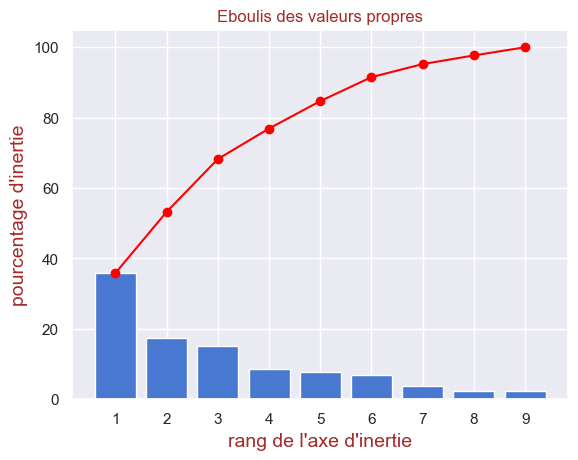

In [215]:
plt.bar(x_list_num_axes_tot, scree_bis)
plt.plot(x_list_num_axes_tot, scree_bis_cum,c="red",marker='o')
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.ylabel("pourcentage d'inertie")
plt.title("Eboulis des valeurs propres")
plt.grid()
plt.show(block=False)

On a en bleu la variance de chaque nouvelle composante, et en rouge la variance cumulée.

On voit ici que 68% de la variance est prise dans les 3 premières composantes. (77% dans les 4)

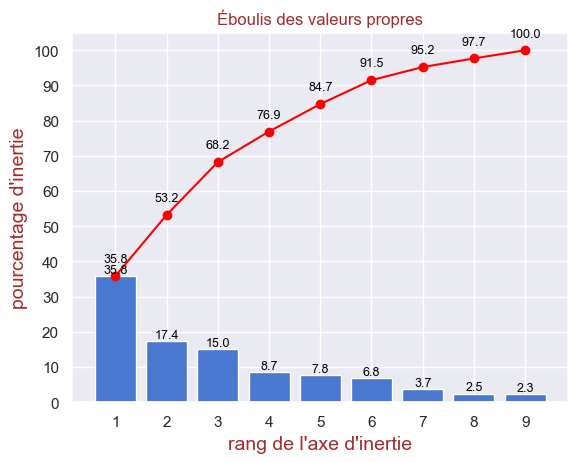

In [216]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(x_list_num_axes_tot, scree_bis)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_bis):
    plt.text(x_list_num_axes_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(x_list_num_axes_tot, scree_bis_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_bis_cum):
    plt.text(x_list_num_axes_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.4 - Components : </h4>
</div>

Intéressons nous maintenant à nos fameuses composantes. 
Les Composantes principales nous sont donnée par l'attribut `components_`. Cette variable est généralement nommée `pcs` : 

In [217]:
#les vecteurs Axes principaux enf contion des vecteurs originaux
#sur la première ligne on a ce qui compose l'axe F1, en fonction des variables d'origine
#sur la seconde ligne la décomposition de l'axe F2 en fonction des variables d'origine
#PM j'ai l'impression que ça se lit plutôt colonne par colonne
#PM et qu'on a sur la 1ère colonne la décomposition de la variable d'originie sur les axes principaux
#PM et qu'on a sur la 2ème colonne la décomposition de la variable d'originie sur les axes principaux
pcs_bis = pca_bis.components_
pcs_bis

array([[ 0.23948259, -0.09355729,  0.01362407,  0.48707796,  0.1683208 ,
         0.44468878,  0.26949323,  0.46983617,  0.42072787],
       [-0.43296389, -0.18028585,  0.53290128, -0.03309376,  0.58935728,
         0.03959249, -0.29676569, -0.07856986,  0.22761291],
       [-0.37977388,  0.70879602, -0.38055096,  0.07252726,  0.25890112,
         0.13359761, -0.19194192,  0.26242698, -0.11275209],
       [-0.24811229,  0.22193799,  0.26661032,  0.16275234,  0.12643197,
        -0.35185148,  0.79319881, -0.04415578, -0.14392998],
       [-0.55992803, -0.3908875 , -0.52887801, -0.06876098, -0.13155705,
        -0.14705167,  0.16003703,  0.00386802,  0.4297549 ],
       [ 0.1360452 , -0.28006533, -0.37458915, -0.2186421 ,  0.57017188,
         0.3433652 ,  0.27119864, -0.23182163, -0.38032633],
       [ 0.11762433, -0.29635003, -0.18985349,  0.45519449,  0.26326696,
        -0.58586994, -0.25096736,  0.29295125, -0.30616445],
       [-0.15829016,  0.01574979, -0.0652208 ,  0.68451321, -0

In [218]:
features_bis

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [219]:
#CALRIFIONS LE RESULTAT/ TRANSFORMONS pcs_bis en DF
pcs_bis = pd.DataFrame(pcs_bis)
pcs_bis.columns = features_bis
pcs_bis.index = list_Fi_tot
pcs_bis.round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
F1,0.24,-0.09,0.01,0.49,0.17,0.44,0.27,0.47,0.42
F2,-0.43,-0.18,0.53,-0.03,0.59,0.04,-0.30,-0.08,0.23
F3,-0.38,0.71,-0.38,0.07,0.26,0.13,-0.19,0.26,-0.11
F4,-0.25,0.22,0.27,0.16,0.13,-0.35,0.79,-0.04,-0.14
F5,-0.56,-0.39,-0.53,-0.07,-0.13,-0.15,0.16,0.00,0.43
F6,0.14,-0.28,-0.37,-0.22,0.57,0.34,0.27,-0.23,-0.38
F7,0.12,-0.30,-0.19,0.46,0.26,-0.59,-0.25,0.29,-0.31
F8,-0.16,0.02,-0.07,0.68,-0.14,0.22,-0.11,-0.65,-0.08
F9,-0.42,-0.30,0.20,0.04,-0.33,0.36,0.01,0.38,-0.55


-- **ATTENTION** -- : Nous avons arrondi les résultats pour simplifier l'analyse

**<u>INTERPRETATIONS des Composantes:</u>**

`F1` =
0.49 * PIB/hab  
+0,44 * Acces_Alim_saine  
+0,47 * Score_Transport  
+0.42 Score_stabilite  

**F1 => Niveau de Vie (36% de la variance) (Axe important pour le poulet bio)**

F2 =  
-0,43 *dist_France  
+0,53 * Balance_I/E_Poulet    
+0,59 * Part_Volaille  

**F2 => Pays consommateur de poulet (18% de la variance)** 
(Axe important pour le poulet)  

F3 =
0.71 *Population 

**F3 => taille du marché  (13,5% de la variance)**  
(plus influencé par Chine et Inde dans cette version)  

F4 =  
+0.79 * Exp_Poulet_Fr
(inclut une petite partie d'exportateur mondiaux et de Part de consommation de poulet  
**F4 => Importateur de Poulet Francais (8,6% de la variance)**  
ATTENTION F4 a changé et n'est plus : Importateur mondiaux de poulet 

**F5 => commence à être moins interprétable**  


Les axes les plus pertinents semblent être F1, F2, F3, et F4 !  
F2 et F4 peuvent apparaitre redondant et F4 est plus pertinent pour notre étude.  
Donc si je devais engarder 3 je garderai F1, F3 et F4.

pour une représentation plus *visuelle*

<Axes: >

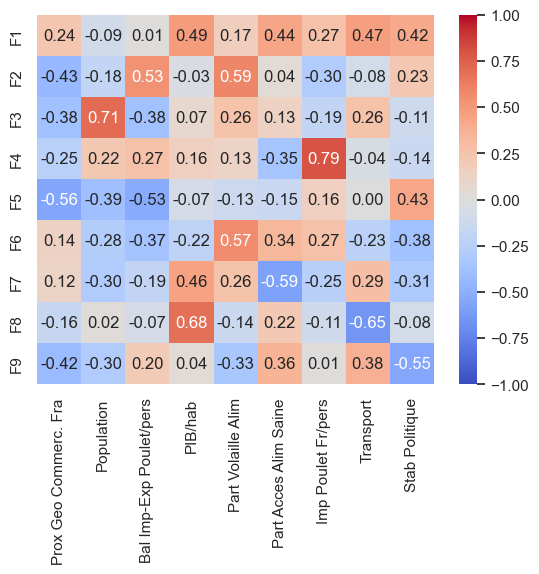

In [220]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_bis, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [221]:
#Autre visualisation :
pcs_bis.T

,F1,F2,F3,F4,F5,F6,F7,F8,F9
Prox Geo Commerc. Fra,0.239483,-0.432964,-0.379774,-0.248112,-0.559928,0.136045,0.117624,-0.158290,-0.422473
Population,-0.093557,-0.180286,0.708796,0.221938,-0.390887,-0.280065,-0.296350,0.015750,-0.296302
Bal Imp-Exp Poulet/pers,0.013624,0.532901,-0.380551,0.266610,-0.528878,-0.374589,-0.189853,-0.065221,0.199006
PIB/hab,0.487078,-0.033094,0.072527,0.162752,-0.068761,-0.218642,0.455194,0.684513,0.040231
Part Volaille Alim,0.168321,0.589357,0.258901,0.126432,-0.131557,0.570172,0.263267,-0.135330,-0.333593
Part Acces Alim Saine,0.444689,0.039592,0.133598,-0.351851,-0.147052,0.343365,-0.585870,0.218418,0.358557
Imp Poulet Fr/pers,0.269493,-0.296766,-0.191942,0.793199,0.160037,0.271199,-0.250967,-0.105270,0.008401
Transport,0.469836,-0.078570,0.262427,-0.044156,0.003868,-0.231822,0.292951,-0.646275,0.380808
Stab Politique,0.420728,0.227613,-0.112752,-0.143930,0.429755,-0.380326,-0.306164,-0.084324,-0.554587


<Axes: >

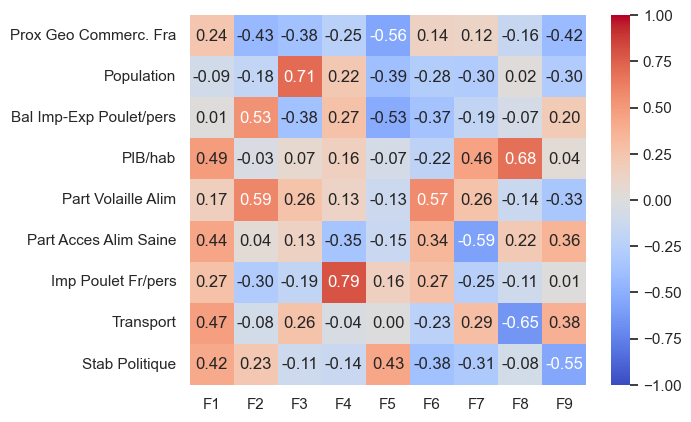

In [222]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_bis.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

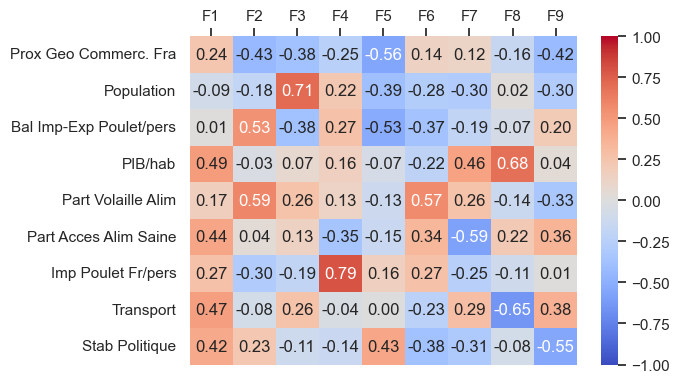

In [223]:
#modif visuel libellés x au dessu

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 4))

# Heatmap
sns.heatmap(pcs_bis.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f", ax=ax)

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('top')    # Place les ticks en haut
ax.xaxis.set_label_position('top')    # Place le label (si présent) en haut

plt.tight_layout()
plt.show()

##### **Pour Rappel : Corrélation des variables d'origines entre elles :**

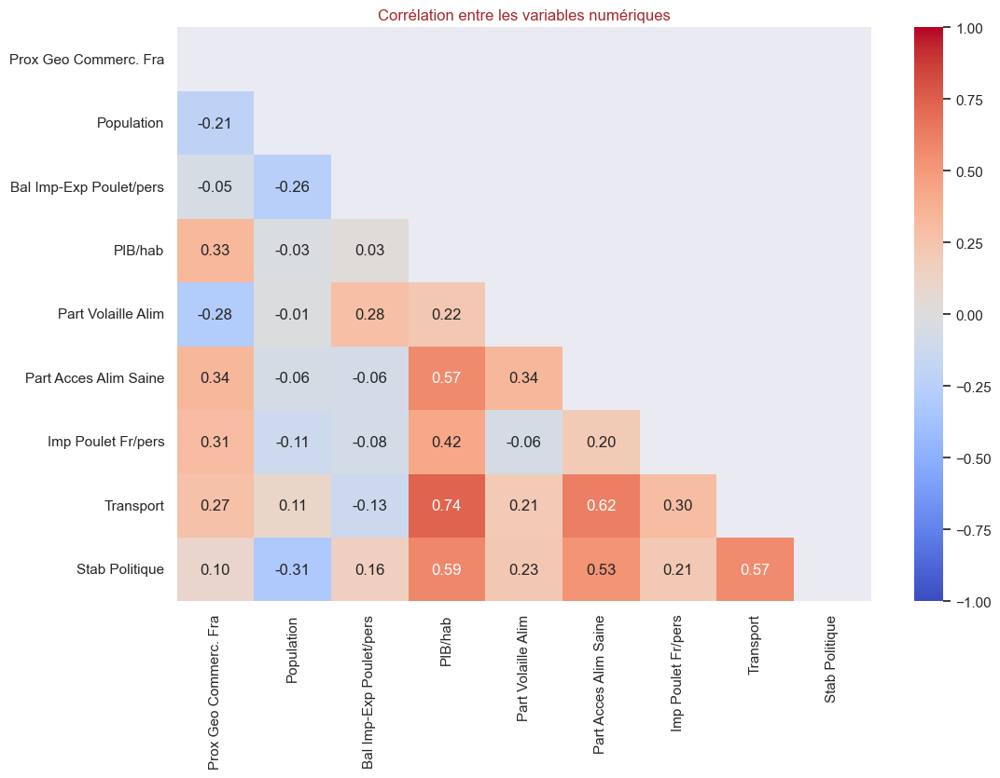

In [224]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND[quant_vars].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND[quant_vars].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

Principale corrélation qui ressort : PIB/hab -AlimSaine - Transport -Stab politique

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.5 - Graphique de Corrélation : </h4>
</div>

Définissons nos axes x et y. Nous allons utiliser les 2 premières composantes. Comme - en code - on commence à compter à partir de 0, cela nous donne : 

In [225]:
#pour F1 et F2
x,y=0,1

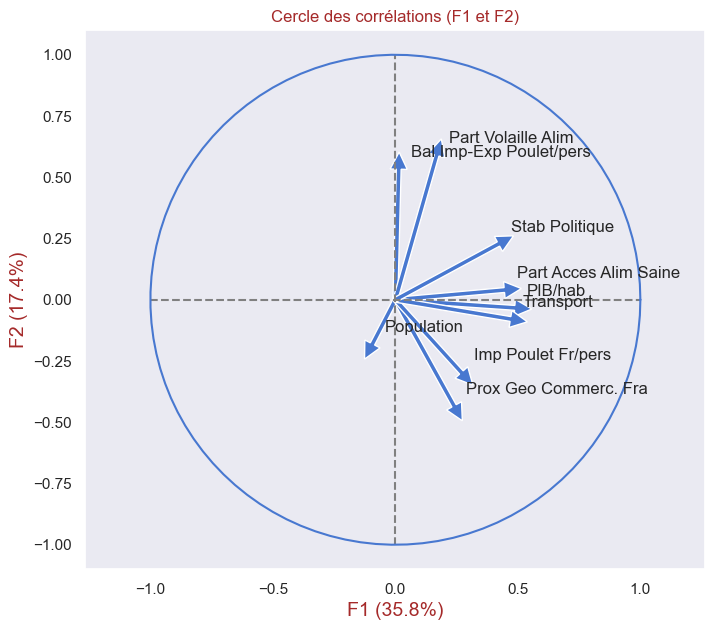

In [226]:
correlation_graph(pca_bis, (0,1) , features=df_bis_quant.columns)

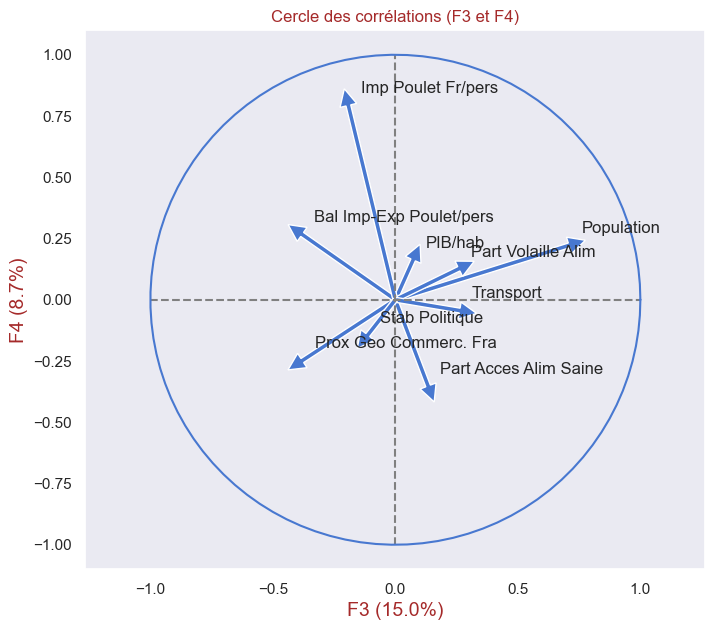

In [227]:
#pour F3 et F4
correlation_graph(pca_bis, (2,3) , features=df_bis_quant.columns)

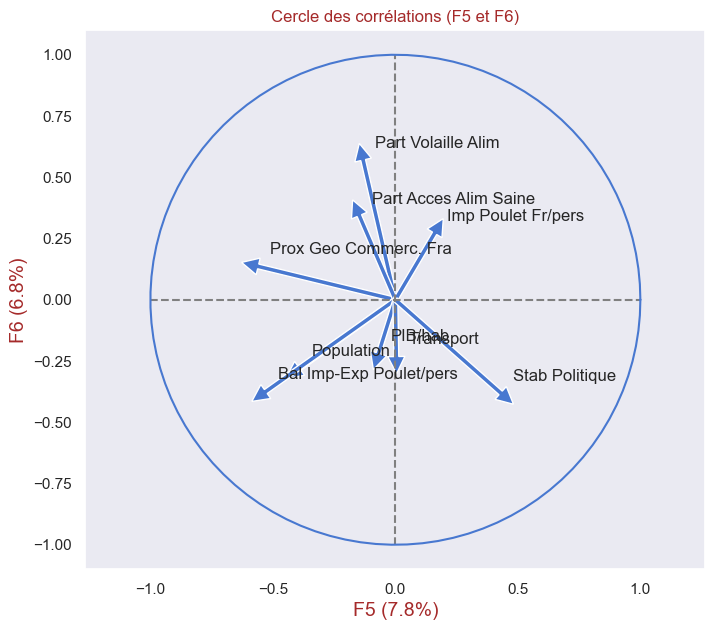

In [228]:
#pour F5 et F6
correlation_graph(pca_bis, (4,5) , features=df_bis_quant.columns)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.3.6 - Projection : </h4>
</div>

Travaillons maintenant sur la projection de nos dimensions. Tout d'abord calculons les coordonnées de nos individus dans le nouvel espace : 

In [229]:
#Visualisation de X_bis_scaled les données centrées réduites
df_temp = pd.DataFrame(X_bis_scaled) #les données centrées réduites
df_temp.columns = features_bis
df_temp.index = names_bis
df_temp.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [230]:
X_bis_scaled.shape

(110, 9)

**Projection de nos données centrées réduites sur les composantes principales**

In [231]:
#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_bis_proj = pca_bis.transform(X_bis_scaled)

In [232]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_bis_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_bis
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [233]:
#Visualisation dans un DF de X_bis_proj les données centrées réduites projetées sur nos axes principaux
df_X_bis_proj = pd.DataFrame(X_bis_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_bis_proj.columns = list_Fi_tot
df_X_bis_proj.index = names_bis
df_X_bis_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


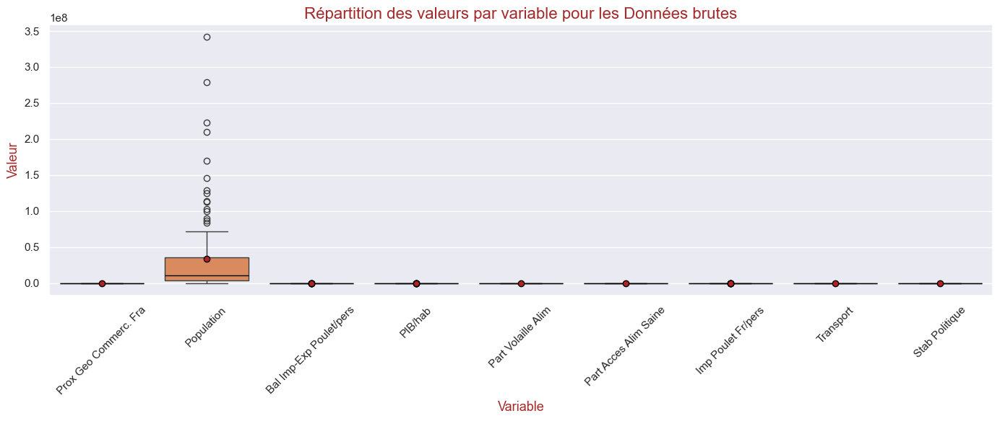

In [234]:
#boxplot de X_bis
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_bis en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_bis, index=names_bis, columns=features_bis)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour les Données brutes", fontsize=16)
plt.grid(axis='y')
plt.xlabel("Variable", fontsize=13)
plt.ylabel("Valeur", fontsize=13)
plt.tight_layout()
plt.show()

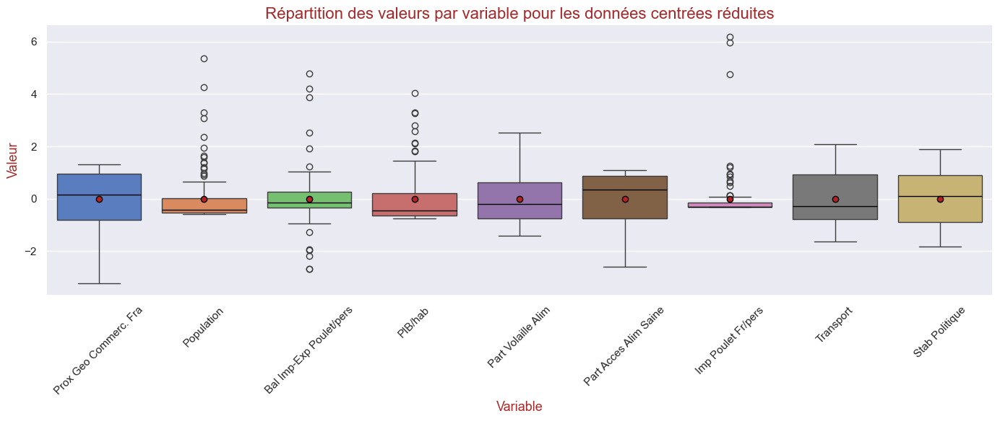

In [235]:
#boxplot de X_bis_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_bis en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_bis_scaled, index=names_bis, columns=features_bis)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour les données centrées réduites", fontsize=16)
plt.grid(axis='y')
plt.xlabel("Variable", fontsize=13)
plt.ylabel("Valeur", fontsize=13)
plt.tight_layout()
plt.show()


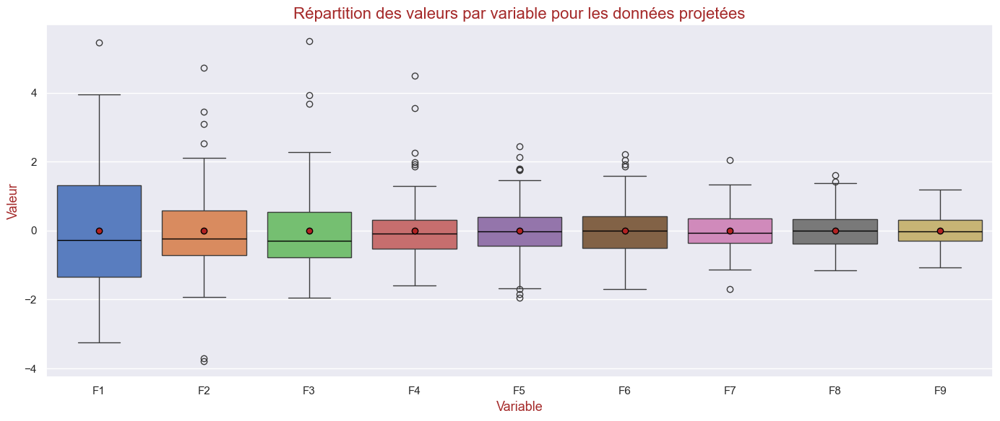

In [236]:
#boxplot de X_bis_proj 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_bis en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_bis_proj, index=names_bis, columns=list_Fi_tot)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_Fi,
            hue_order = Ordre_Fi
           )

#plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour les données projetées", fontsize=16)
plt.grid(axis='y')
plt.xlabel("Variable", fontsize=13)
plt.ylabel("Valeur", fontsize=13)
plt.tight_layout()
plt.show()


##### <font color='blue'>**PROJECTIONS 2D sur les AXES PRINCIPAUX :**</font>

Essayons avec F1 et F4 : nos axes qui ont le plus de sens  :

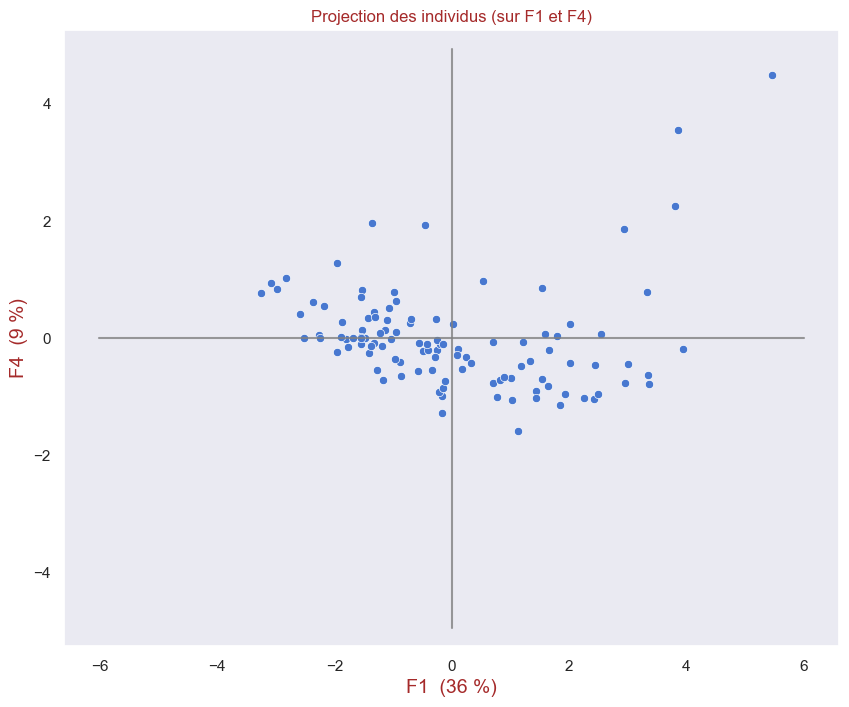

In [237]:
x_y = [0,3] #pour F1 et F4 :
display_factorial_planes(X_bis_proj, x_y, pca=pca_bis)

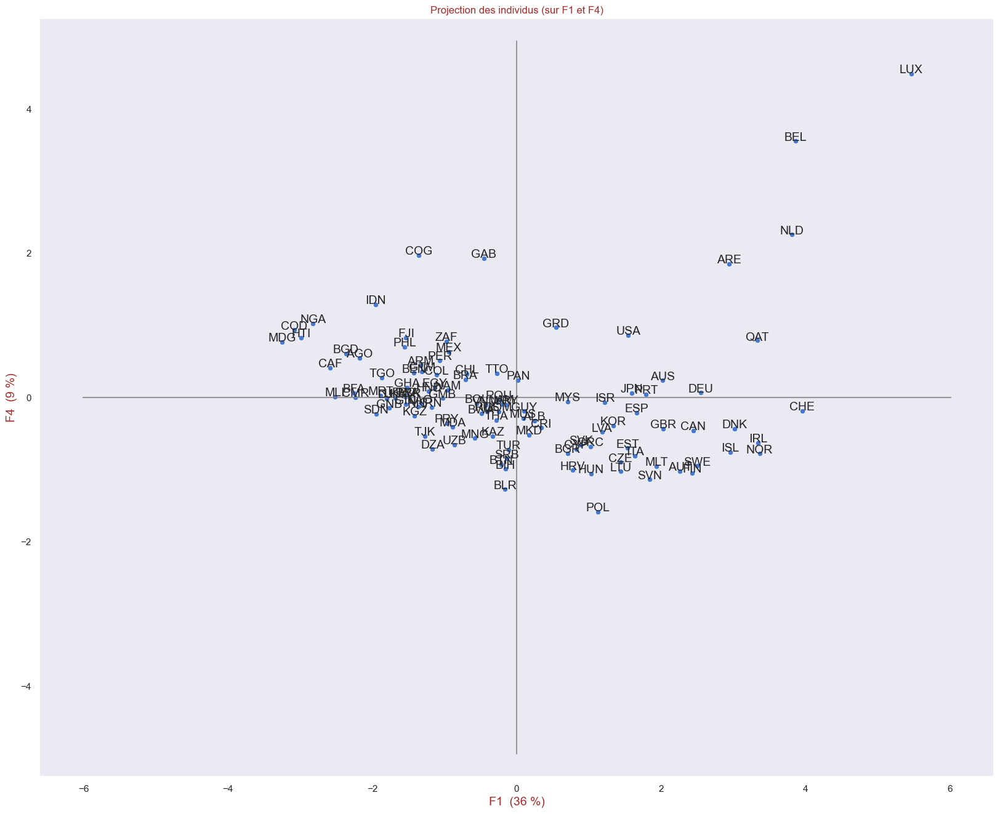

In [238]:
x_y = [0,3] #pour F1 et F4 :
display_factorial_planes(X_bis_proj, x_y,labels=names_bis,figsize=(20,16), pca=pca_bis)

Les pays qui ressortent favorablement pour F3+F4 sont : LUX, BEL, NLD, ARE, QAT  
Sur un seul axe:  
F1 : CHE, NOR, IRL  
F4 : COG, GAB   

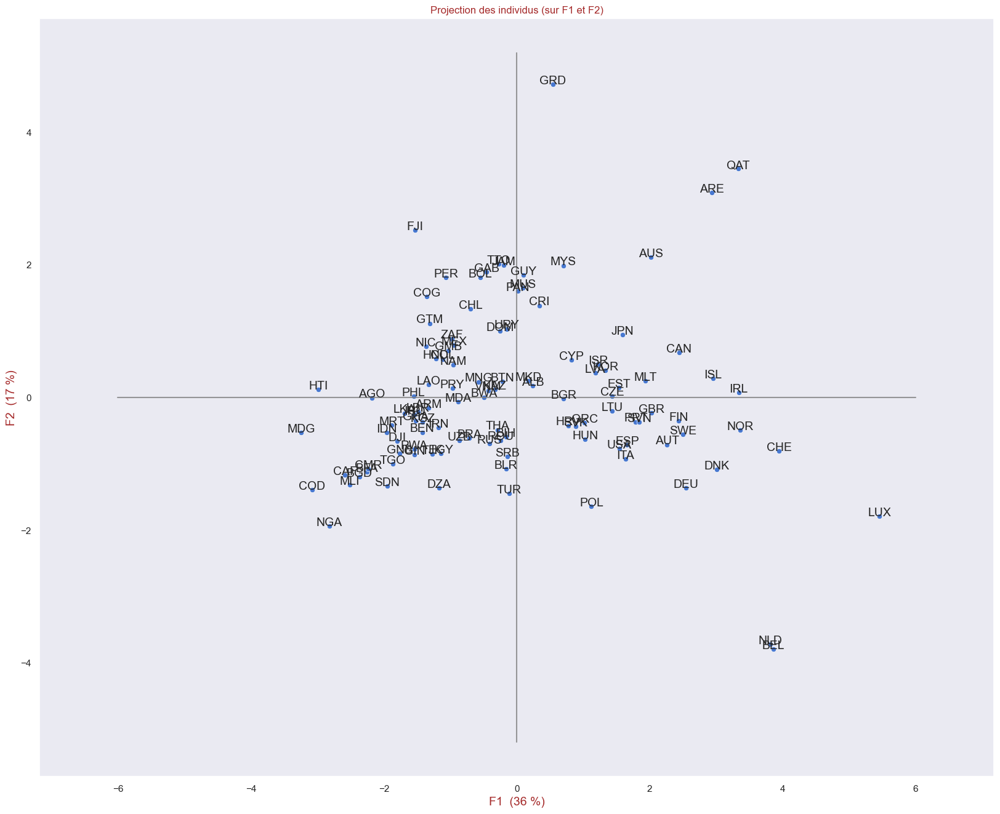

In [239]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_bis_proj, x_y,labels=names_bis,figsize=(20,16), pca=pca_bis)

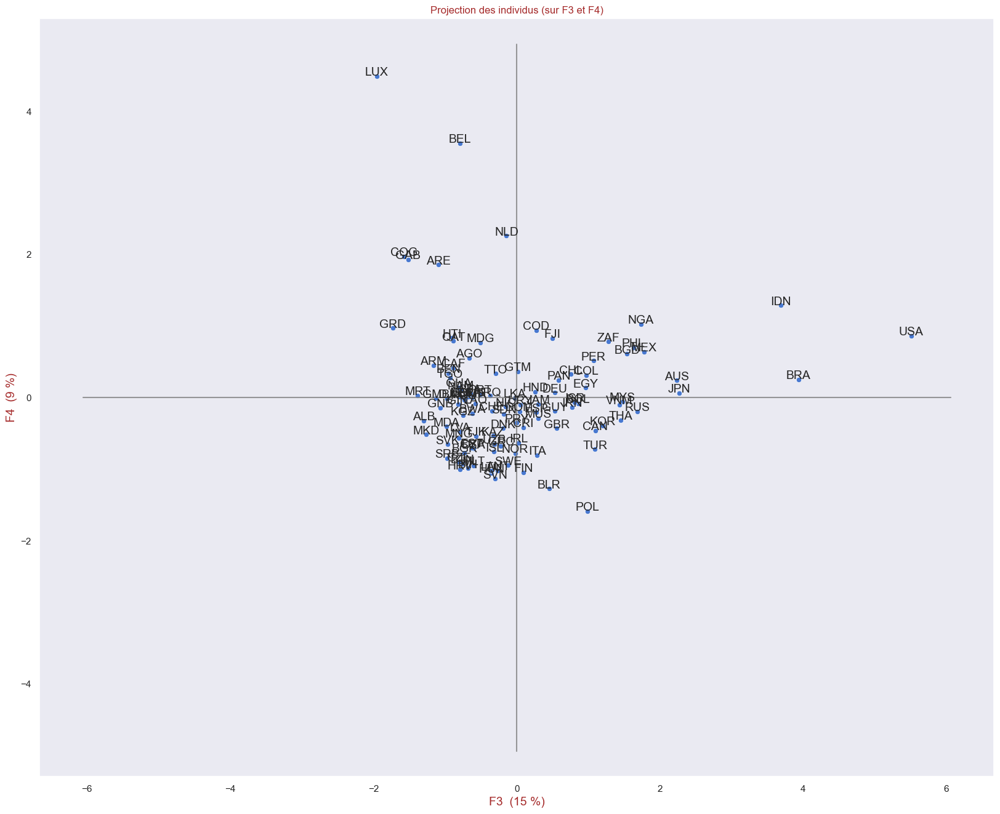

In [240]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_bis_proj, x_y,labels=names_bis,figsize=(20,16), pca=pca_bis)

Les pays qui ressortent favorablement pour F3+F4 sont : USA, IDN, BRA  
Sur un seul axe:  
F3 : AUS, JPN  
F4 : LUX, BEL, NLD   

Remarque : visualisation 2D pour F1 -Niveau de vie /F2(conso de Poulet)/F5(Commerce avec la France)

##### <font color='blue'>**PROJECTIONS 3D sur les AXES PRINCIPAUX :**</font>

In [241]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_bis_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_bis
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [242]:
fig = px.scatter_3d(df_temp, x='F1', y='F3', z='F4', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

Quand on regarde selon 3 critères : F1 (Niveau de Vie), F3(Population), F4(Import de poulet Fr),  
les pays qui ressortent sont : USA, BRA, IDN, LUX, BEL.  
Cependant le BRA et l'IDN ne sont élevés que par le critère de population F3.

In [243]:
#Avec pays consommateurs de poulet international au lieu de  la population 
fig = px.scatter_3d(df_temp, x='F1', y='F2', z='F4', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.4 - Réduction de l'Etude aux 4 premières composantes F1, F2, F3, F4 (77% de la variance)</h3>
</div>

In [244]:
df_X_bis_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [245]:
df_X_bis_proj.shape

(110, 9)

<u>**SELECTIONS DE COMPONENTS :**</u>  
Pour la suite ne gardons que F1, F2, F3 et F4 qui sont interprétables

In [246]:
nb_components_bis_selec =4

In [247]:
x_list_num_axes_tot

range(1, 10)

In [248]:
x_list_num_axes_bis_selec = range(1,nb_components_bis_selec+1)
print(x_list_num_axes_bis_selec)

range(1, 5)


In [249]:
for i in x_list_num_axes_bis_selec :
    print(i)

1
2
3
4


In [250]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'F9']

In [251]:
list_Fi_bis_selec = list_Fi_tot[:nb_components_bis_selec]
list_Fi_bis_selec

['F1', 'F2', 'F3', 'F4']

In [252]:
df_X_bis_proj_selec_PCA = df_X_bis_proj.loc[:,list_Fi_bis_selec].copy(deep=True)
df_X_bis_proj_selec_PCA

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079
...,...,...,...,...
URY,-0.147778,1.034746,0.052218,-0.097757
USA,1.544695,-0.769873,5.506464,0.864181
UZB,-0.862694,-0.646368,-0.307510,-0.651443


In [253]:
df_X_bis_proj_selec_PCA.shape

(110, 4)

In [254]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_X_bis_proj_selec_PCA)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,110,110,0,110,NaN
F2,float64,110,110,0,110,NaN
F3,float64,110,110,0,110,NaN
F4,float64,110,110,0,110,NaN


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.5 - Etude des outliers</h3>
</div>

##### **Recherches des Outliers :**  
On peut rechercher les outliers sur les données d'origine centrées réduites  
ou sur les données projetées Fa à F5( à partir du moment ou les axes sélectionnées représente,t une ceraines quantité de variance.)  
Nos 5 axes portent 77 % de la variance,  
ce qui n'est pas parfait mais permet d'étudier sur les données projetées, avec les 3/4 de la variance.

**Travaillons sur une copie temporaire de `df_X_bis_proj_selec_PCA`**

In [255]:
df_temp_etude = df_X_bis_proj_selec_PCA.copy()

##### **LES DISTANCES :**

**La `distance euclidienne`** : la distance classique dans un espace vectoriel orthonormé.  

**La `distance de Mahalanobis`** :  
La distance de Mahalanobis mesure la distance entre un point et un groupe (ou une distribution) en tenant compte de la corrélation entre les variables.    
Avantage par rapport à la distance euclidienne :  
Elle corrige les effets d’échelle et de corrélation entre les variables.  
Ainsi, un point qui semble proche selon la distance euclidienne peut être un vrai outlier selon Mahalanobis s’il dévie dans une direction atypique

<u>Quand appliquer la `distance de Mahalanobis` dans un processus de PCA ?</u>  
<u>1. Option 1 : appliquer sur les données brutes (après centrage-réduction)</u>  
✅ Avantage : permet de détecter des outliers avant la réduction de dimension (avec toute l'information).  
⚠️ Inconvénient : les données peuvent être bruitées ou difficiles à interpréter dans un grand espace.  

<u>2. Option 2 : appliquer sur les données projetées sur les premières composantes principales</u>  
✅ Avantage : Travailler dans un espace plus compact, avec les dimensions les plus informatives.  
Cela peut réduire le bruit et faciliter la détection des observations aberrantes.  
⚠️ Inconvénient : Perte de l'information des composantes écartées.  
Mais si 95% de la variance a été conservé, ce risque est limité.  

**=>Nos 5 axes portent 77 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.5.1 - Outliers : Etude sur les 4 Composantes Principales : : </h4>
</div>

##### <font color ='blue'> **a.CALCUL DES DISTANCES :**</font>

La distance euclidienne

La distance de Mahalanobis

In [256]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude.mean().values
cov = np.cov(df_temp_etude.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude["mahalanobis"] = df_temp_etude.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,mahalanobis
iso3,,,,,
LUX,5.464015,-1.789437,-1.956179,4.489283,6.290022
BEL,3.863493,-3.791377,-0.790733,3.556935,5.494457
USA,1.544695,-0.769873,5.506464,0.864181,4.926627
NLD,3.815641,-3.715115,-0.142946,2.260397,4.439392
GRD,0.542558,4.720451,-1.731512,0.971853,4.194158
ARE,2.942311,3.091661,-1.093631,1.857214,3.736711
IDN,-1.958029,-0.526717,3.684574,1.289296,3.661860
QAT,3.332631,3.449308,-0.886600,0.791965,3.509858
BRA,-0.712576,-0.610339,3.932691,0.252683,3.435789


In [257]:
df_temp_etude[['mahalanobis']].describe()

,mahalanobis
count,110.000000
mean,1.742731
std,0.966967
min,0.646027
25%,1.191210
50%,1.466584
75%,1.879518
max,6.290022


<u>Calcul du Seuil  pour êter un outlier selon Mahalanobis :</u>  
La distance de Mahalanobis suit une loi du χ² (chi carré) avec p degrés de liberté, 
où p est le nombre de dimensions

In [258]:
from scipy.stats import chi2
import numpy as np

In [259]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_bis_selec

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=4 : 3.34


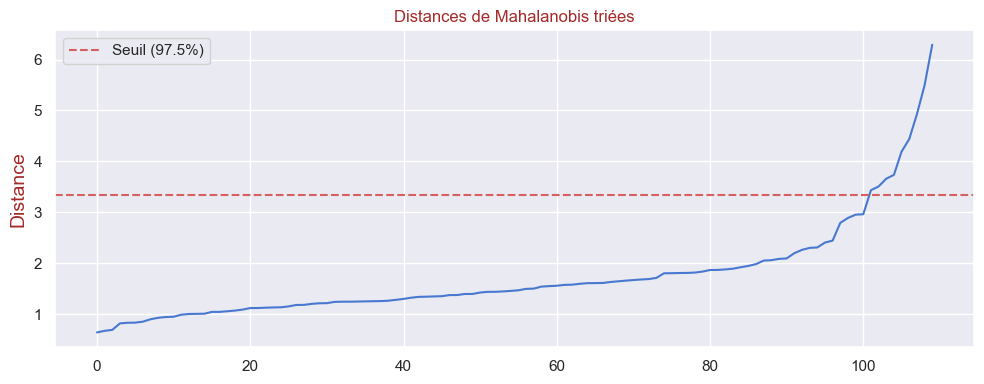

In [260]:
plt.figure(figsize=(10, 4))
plt.plot(df_temp_etude["mahalanobis"].sort_values().values)
plt.axhline(y=threshold, color='r', linestyle='--', label='Seuil (97.5%)')
plt.title("Distances de Mahalanobis triées")
plt.ylabel("Distance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

PM : si je comprends bien, LA distance est calculée sur les données , en connaissant le nombre de dimensions, de telle sorte que les données soient étalées selon une loi deu chi2, ce qui permet de prévoir à partir de quelle distance on a X% d'individus au delà.  
Il faut donc les étudier car il ya aura toujours X% au delà du seuil fourni, ce qui ne veut pas dire que toutes les valeurs sont des outliers ou qu'il n'y en a pas plus.

In [261]:
df_outliers_bis = df_temp_etude[df_temp_etude["mahalanobis"] > threshold]

In [262]:
display(df_outliers_bis.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,mahalanobis
iso3,,,,,
LUX,5.464015,-1.789437,-1.956179,4.489283,6.290022
BEL,3.863493,-3.791377,-0.790733,3.556935,5.494457
USA,1.544695,-0.769873,5.506464,0.864181,4.926627
NLD,3.815641,-3.715115,-0.142946,2.260397,4.439392
GRD,0.542558,4.720451,-1.731512,0.971853,4.194158
ARE,2.942311,3.091661,-1.093631,1.857214,3.736711
IDN,-1.958029,-0.526717,3.684574,1.289296,3.661860
QAT,3.332631,3.449308,-0.886600,0.791965,3.509858
BRA,-0.712576,-0.610339,3.932691,0.252683,3.435789


La `CHN` et l'`IND` ayant été retiré,  
les autres grands pays ressortent maintenant : USA, IDN USA.

##### Recherche classique de seuil

##### Fin Recherche classique de seuil

In [263]:
liste_iso3_outliers_bis = list(df_outliers_bis.index)
liste_iso3_outliers_bis

['ARE', 'BEL', 'BRA', 'GRD', 'IDN', 'LUX', 'NLD', 'QAT', 'USA']

##### **Données des outliers avec les variables originales :**

In [264]:
#**Données avec les variables originales :**
#liste_iso3_outliers_bis = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND['iso3'].isin(liste_iso3_outliers_bis)

df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
6,BEL,Belgique,Europe,-378.6808,11641820,-17.998686,49986.832591,1.547455,99.3,2.576017,4.1,58.293839
14,BRA,Brésil,America,-8584.978,210306415,-20.728003,8917.673509,5.378517,74.7,0.0,3.2,28.43602
46,GRD,Grenade,America,-7112.1,116913,57.456143,9509.250006,7.114045,78.9,0.0,2.5,86.25592
53,IDN,Indonésie,Asia,-11547.48,278830529,-0.001792,4787.999308,1.979152,52.4,0.0,2.9,28.909952
70,LUX,Luxembourg,Europe,-384.4114,653313,12.971271,125897.199853,2.247201,98.1,2.495129,3.6,87.677727
85,NLD,Pays-Bas,Europe,-556.2308,17904421,-26.287624,57391.6356,1.475962,98.9,2.015567,4.2,68.720383
93,QAT,Qatar,Asia,-4863.478,2892455,47.121445,87974.166043,6.392373,100.0,0.067244,3.8,84.360191
108,USA,USA,America,-7227.043,341534045,-10.731474,76100.715015,5.067229,95.3,0.000004,3.9,47.393364


##### **Données des outliers centrées réduites avec les variables originales :**

In [265]:
#**Données centrées réduites avec les variables originales :**
#Attention X_bis_scaled est un np.Array

#Visualisation dans un DF de X_bis_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_bis_scaled) #les données centrées réduites
df_temp_sc.columns = features_bis
df_temp_sc.index = names_bis

#liste_iso3_outliers_bis = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_bis)

df_comp_Outliers_bis = df_temp_sc.loc[mask_temp,:]
display(df_comp_Outliers_bis)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860
BRA,-0.950834,3.076461,-2.178419,-0.430415,1.327117,0.089716,-0.304515,0.365565,-0.738449
GRD,-0.543051,-0.590531,4.783715,-0.407822,2.234919,0.255577,-0.304515,-0.639739,1.529801
IDN,-1.771037,4.271942,-0.332794,-0.588130,-0.450989,-0.790927,-0.304515,-0.065279,-0.719857
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432
USA,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240


**OBSERVATIONS sur la Comparaison CHN IND et notre première sélection sur les données centrées réduites :**  
<u>IND :</u>  
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1 et un peu sur les transports faiblement 0.3  
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1  
<u>CHN :</u>   
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1, les transports faiblement 1.5, et un peu sur l'Alimentation saine (0.5)   
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1 et un peu les transports 1.5.  

In [266]:
(df_comp_Outliers_bis > 1.0).sum(axis=1)

iso3
ARE    5
BEL    5
BRA    2
GRD    3
IDN    1
LUX    5
NLD    5
QAT    6
USA    4
dtype: int64

In [267]:
df_temp_2 = df_comp_Outliers_bis.copy(deep=True)

In [268]:
# Nombres de scores supérieurs à 1
valeur_selec = 1.0

df_temp_2[f"Nb Score >{valeur_selec}"] = (df_temp_2[quant_vars] > valeur_selec).sum(axis=1) 

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0
iso3,,,,,,,,,,
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860,5
BRA,-0.950834,3.076461,-2.178419,-0.430415,1.327117,0.089716,-0.304515,0.365565,-0.738449,2
GRD,-0.543051,-0.590531,4.783715,-0.407822,2.234919,0.255577,-0.304515,-0.639739,1.529801,3
IDN,-1.771037,4.271942,-0.332794,-0.588130,-0.450989,-0.790927,-0.304515,-0.065279,-0.719857,1
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578,5
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889,5
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432,6
USA,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240,4


(Pourquoi 1, parce que cela correspondà l'écart type,  
je considdère que le pays a plutôt un socre un peu supérieur en étant un peu au dessus de l'écart type pa rrapport à zéro( la moyenne) )    
Et qu'il présente donc un critère en sa faveur


Je vais choisir un seuil arbitrairement 4.0 ,  
qui représente donc des données éloigné de plus de 4 écart type par rappor tà la moyenne.  
pour décider des outliers hors norme.

In [269]:
# Nombres de scores supérieurs à 4
#valeur_selec = round(seuil2,2)
valeur_selec = 4

df_temp_2[f"Nb Score >{valeur_selec} ou <-{valeur_selec}"] = ((df_temp_2[quant_vars] > valeur_selec).sum(axis=1) +
                                          (df_temp_2[quant_vars] < (-1* valeur_selec)).sum(axis=1) )

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Nb Score >4 ou <-4
iso3,,,,,,,,,,,
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5,1
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860,5,1
BRA,-0.950834,3.076461,-2.178419,-0.430415,1.327117,0.089716,-0.304515,0.365565,-0.738449,2,0
GRD,-0.543051,-0.590531,4.783715,-0.407822,2.234919,0.255577,-0.304515,-0.639739,1.529801,3,1
IDN,-1.771037,4.271942,-0.332794,-0.588130,-0.450989,-0.790927,-0.304515,-0.065279,-0.719857,1,1
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578,5,2
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889,5,1
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432,6,0
USA,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240,4,1


**OBSERVATIONS :**  
Sachant que notre sélection de variables a été soigneusement choisie pour être équilibrée sur les thèmes avec peu de corrélation entre elles.  
On peut accorder un intérêt à nos valeurs originales (centrées réduites).  

Il n'y a plus de pays avec de très gros outliers (supérieurs à 7).  

Les Nouveaux pays :

`BRA` :  
2 résutlat favorable (>1.0) : faiblement pertinent  
0 outlier important (>4.0) : pas de souci  
  
`IDN`, l'indonésie :    
1 seul résutlat favorable (>1.0) : pas pertinent pour l'étude  
1 outlier important (>4.0) : pour la population mais pas hors norme (4.2)   
  
`USA` :    
3 résultats favorables (>1.0) : candidat pertinent    
1 outlier important (>4.0) : 5.3 pour la population    
  
=>Ca ne devrait pas êter trop perturbant de laisser BRA, et IDN,    
pour les USA, c'est un peu le même principe que pour les autres déjà étudié.  
Il est pertinent donc soit on le garde, soit on l'écarte et l'étudie à part.  
  
<u>RAPPEL :</u>  
`GRD`, Grenade :  
3 résultats favorables (>1.0): intérêt intermédiaire  
1 outlier important (>4.0) : 4.2 (pas hors norme) pour un indicateur intéressant  Bal Imp-Exp Poulet/pers   
position intermédiaire avec quelques résultats pertinents (>1.0) et son outier favorable, sur une variable intéressante( Bal Imp-Exp Poulet/pers	) mais avec une population modeste et éloignée).  

Les autres pays ont des scores >1.0 sur 4 à 6 variables sur 9.  (et moins de 1 très gors outliers, sauf LUX (2))
Ils pourraient donc être des candidats intéressants dans notre étude.    
Il faut vori si nous les écartons pour les étudier séparément, ou si les garder ne perturbe pas trop.  

Note : la légère corrélation sur PIB, Alimentation saine, Transport, Politique, renforce le score de ARE, QAT.  
A noter que CHN et IND ont leurs gros outliers(>4.0) sur la Population.  
Les autres pays ont ont leurs gros outliers liés à la consommation de Poulet : Bal Imp-Exp Poulet/pers	ou Imp Poulet Fr/pers   
(+PIB pour LUX  

<u>BILAN :</u>  
USA pourrait avoir un profil un peu similaire à ['ARE', 'BEL','LUX', 'NLD', 'QAT','USA']  
intéressant mais voir si ils perturbent l'étude ou non  !

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2bis.5.2 - Outliers : Etude sur les 9 Composantes Principales : : </h4>
</div>

##### <font color='blue'>**Données sur les 9 Composantes Principales :**</font>

In [270]:
#Visualisation dans un DF de X_bis_proj les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9 = pd.DataFrame(X_bis_proj).copy() #les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9.columns = list_Fi_tot
df_temp_etude_9.index = names_bis
df_temp_etude_9.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [271]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude_9.mean().values
cov = np.cov(df_temp_etude_9.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude_9["mahalanobis"] = df_temp_etude_9.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
LUX,5.464015,-1.789437,-1.956179,4.489283,0.307946,0.120430,-0.375037,1.385637,-0.063243,6.981200
BEL,3.863493,-3.791377,-0.790733,3.556935,1.471135,1.868543,-0.839610,-0.744576,0.267362,6.617859
USA,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480,6.206205
NLD,3.815641,-3.715115,-0.142946,2.260397,1.784922,1.448117,-0.338977,-0.470699,-0.056937,5.379970
GRD,0.542558,4.720451,-1.731512,0.971853,-1.692429,-0.765311,-1.123429,-0.444624,-0.408518,5.291750
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5.167800
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,4.895521
QAT,3.332631,3.449308,-0.886600,0.791965,-1.849827,-1.292426,0.413929,0.583808,0.429863,4.770982
IRL,3.342262,0.076538,0.024136,-0.629925,-0.257919,-0.207411,1.345283,1.604989,-0.540859,4.730078


In [272]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_bis

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=9 : 4.36


In [273]:
df_outliers_bis_9 = df_temp_etude_9[df_temp_etude_9["mahalanobis"] > threshold]

In [274]:
display(df_outliers_bis_9.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
LUX,5.464015,-1.789437,-1.956179,4.489283,0.307946,0.120430,-0.375037,1.385637,-0.063243,6.981200
BEL,3.863493,-3.791377,-0.790733,3.556935,1.471135,1.868543,-0.839610,-0.744576,0.267362,6.617859
USA,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480,6.206205
NLD,3.815641,-3.715115,-0.142946,2.260397,1.784922,1.448117,-0.338977,-0.470699,-0.056937,5.379970
GRD,0.542558,4.720451,-1.731512,0.971853,-1.692429,-0.765311,-1.123429,-0.444624,-0.408518,5.291750
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5.167800
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,4.895521
QAT,3.332631,3.449308,-0.886600,0.791965,-1.849827,-1.292426,0.413929,0.583808,0.429863,4.770982
IRL,3.342262,0.076538,0.024136,-0.629925,-0.257919,-0.207411,1.345283,1.604989,-0.540859,4.730078


In [275]:
liste_iso3_outliers_bis_9 = list(df_outliers_bis_9.index)
liste_iso3_outliers_bis_9

['ARE',
 'AUS',
 'BEL',
 'GRD',
 'IDN',
 'IRL',
 'ISR',
 'LUX',
 'NLD',
 'NOR',
 'QAT',
 'USA']

In [276]:
liste_iso3_outliers_suppl= [iso for iso in liste_iso3_outliers_bis_9 if iso not in liste_iso3_outliers_bis]
liste_iso3_outliers_suppl

['AUS', 'IRL', 'ISR', 'NOR']

Les nouveaux pays sont 'AUS', `IRL`, `ISR`, `NOR`

**Données avec les variables originales :**

In [277]:
#**Données avec les variables originales :**

mask_temp = df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND['iso3'].isin(liste_iso3_outliers_suppl)

df_Etude_Marche_analyse_1_1_bis_hors_CHN_IND.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085
55,IRL,Irlande,Europe,-948.9664,5110016,-0.132407,105993.272773,4.308361,99.0,0.027671,3.5,78.672989
59,ISR,Israël,Asia,-3151.131,9103151,-0.020705,58086.357487,6.729034,83.5,0.0,3.7,9.952606
86,NOR,Norvège,Europe,-1544.384,5456801,0.163508,106622.826063,2.309558,98.5,0.0,3.9,77.725121


**Données centrées réduites avec les variables originales :**

In [278]:
#**Données centrées réduites avec les variables originales :**
#Attention X_bis_scaled est un np.Array

#Visualisation dans un DF de X_bis_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_bis_scaled) #les données centrées réduites
df_temp_sc.columns = features_bis
df_temp_sc.index = names_bis

#liste_iso3_outliers_suppl = list((df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_suppl)

df_comp_CHN_IND = df_temp_sc.loc[mask_temp,:]
display(df_comp_CHN_IND)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510
IRL,1.163283,-0.503421,-0.344425,3.276964,0.767350,1.049340,-0.234935,0.796410,1.232326
ISR,0.553588,-0.433756,-0.334478,1.447368,2.033531,0.437234,-0.304515,1.083640,-1.463545
NOR,0.998434,-0.497371,-0.318074,3.301007,-0.278163,1.029594,-0.304515,1.370869,1.195141


`IRL`, `ISR`, `NOR`ne correspondent pas à de gros outliers; et l`AUS` est raisonnable Prox très faible)

**BILAN :**  
['ARE', 'BEL','LUX', 'NLD', 'QAT','USA']  
Pour les autres pays la question se pose de les retirer pour les étudier à part.  
Mai ils sont intéressants pour notre projet.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2bis.6 - Classement données</h3>
</div>

In [279]:
df_X_bis_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [280]:
df_X_bis_scaled_Classement = Classement(df_X_bis_scaled,1.0)
df_X_bis_scaled_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432,6,11.483155
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578,5,14.796165
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5,11.603840
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860,5,8.782711
CHE,1.313611,-0.439182,-0.002880,2.805048,-0.455232,1.041442,0.670737,2.088944,1.622762,5,8.645249
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889,5,7.477669
DNK,1.107397,-0.489588,-0.645722,1.827103,-0.470664,1.053289,0.626682,1.658099,1.157957,5,5.824552
USA,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240,4,8.777219
IRL,1.163283,-0.503421,-0.344425,3.276964,0.767350,1.049340,-0.234935,0.796410,1.232326,4,7.202892


In [281]:
df_X_bis_scaled.sort_values(by='Imp Poulet Fr/pers',ascending=False).head(15)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889
GAB,-0.024017,-0.550164,2.527345,-0.449150,1.446411,-0.384173,1.262992,-1.070584,-0.533935
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
PRT,1.069126,-0.410834,-0.109663,0.176634,0.353910,0.614942,0.941666,0.940025,0.916258
COG,-0.164843,-0.487282,1.920394,-0.672832,0.990420,-2.034884,0.934919,-1.214199,-0.013353
DEU,1.237172,0.874408,-0.152452,1.096599,-0.603071,1.009849,0.841456,1.945329,0.748928
CHE,1.313611,-0.439182,-0.002880,2.805048,-0.455232,1.041442,0.670737,2.088944,1.622762


In [282]:
df_X_bis_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [283]:
df_X_bis_proj_Classement = Classement(df_X_bis_proj,1.0)
df_X_bis_proj_Classement.head(10)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,5,10.655404
BEL,3.863493,-3.791377,-0.790733,3.556935,1.471135,1.868543,-0.839610,-0.744576,0.267362,4,4.861173
NLD,3.815641,-3.715115,-0.142946,2.260397,1.784922,1.448117,-0.338977,-0.470699,-0.056937,4,4.584404
LUX,5.464015,-1.789437,-1.956179,4.489283,0.307946,0.120430,-0.375037,1.385637,-0.063243,3,7.583416
ISR,1.221613,0.500268,0.807317,-0.062712,-1.068373,1.538052,2.037157,0.193540,0.586478,3,5.753339
IRL,3.342262,0.076538,0.024136,-0.629925,-0.257919,-0.207411,1.345283,1.604989,-0.540859,3,4.757094
PER,-1.064365,1.808359,1.072527,0.514371,0.171297,1.582955,0.535306,0.049263,-0.039410,3,4.630304
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,3,3.999202
NOR,3.365032,-0.489845,-0.022275,-0.777187,-0.068016,-0.987462,1.263496,1.422296,0.113696,3,3.819733


**ATTENTION :**  
Les Composantes principales ne sont plus toutes forcément des valeurs positives, puisque elles peuvent être composées de composantes négatives sur certains axes.  
L'interpretation est donc un peu délicat il faut regarder ce que les axes contiennent pour savroi si un score élevé est favorable ou non.
Ce sera plus pertinent de regarder ce classement sur les Axes principaux dont on comprend la signifcation,  
et surtout beaucoup plus sur les données centrées réduites car là on sait (par construction des variables qu'un score positif est un score favorable)

In [284]:
df_X_bis_proj_selec_PCA.head(3)

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214


In [285]:
df_X_bis_proj_selec_PCA_Classement = Classement(df_X_bis_proj_selec_PCA,1.0)
df_X_bis_proj_selec_PCA_Classement.head(10)

,F1,F2,F3,F4,Nb Score >1.0,Score total
iso3,,,,,,
ARE,2.942311,3.091661,-1.093631,1.857214,3,6.797556
AUS,2.022319,2.112283,2.235469,0.239079,3,6.609150
USA,1.544695,-0.769873,5.506464,0.864181,2,7.145466
QAT,3.332631,3.449308,-0.886600,0.791965,2,6.687304
LUX,5.464015,-1.789437,-1.956179,4.489283,2,6.207683
JPN,1.591867,0.946357,2.271656,0.064861,2,4.874740
MYS,0.703372,1.990986,1.473654,-0.055933,2,4.112078
CAN,2.444576,0.680974,1.098103,-0.458712,2,3.764941
BEL,3.863493,-3.791377,-0.790733,3.556935,2,2.838318


In [286]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

55199

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2tete-HORS CHN IND BEL NLD LUX- Réduction de dimension par ACP (Analyse en Composantes Principales </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.1 - Préparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.1.1 - Imports :(Déjà fait) </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.1.2- option Graphique : (déjà fait)</h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.1.3- Data : </h4>
</div>

In [287]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [288]:
df_Etude_Marche_analyse_1_1.shape

(112, 12)

In [289]:
#CREATION d'un DF sans les outliers CHN et IND : (pour une nouvelle étude)
liste_iso3_temp = ['CHN','IND','BEL','LUX', 'NLD']
mask_temp = ~(df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_temp))

df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres = df_Etude_Marche_analyse_1_1.loc[mask_temp,:]
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [290]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.shape

(107, 12)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.1.4- Fonctions pour ACP: </h4>
</div>

Déjà faite

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.2 - Data Preparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.2.1 - Quick tour : </h4>
</div>

In [291]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [292]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1 (df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],107,107,0,107,0.0
pays,string[python],107,107,0,107,0.0
continent,string[python],107,107,0,5,0.0
Prox Geo Commerc. Fra,Float64,107,107,0,107,NaN
Population,Int64,107,107,0,107,NaN
Bal Imp-Exp Poulet/pers,Float64,107,107,0,107,NaN
PIB/hab,Float64,107,107,0,107,NaN
Part Volaille Alim,Float64,107,107,0,107,NaN
Part Acces Alim Saine,Float64,107,107,0,100,NaN
Imp Poulet Fr/pers,Float64,107,107,0,61,NaN


In [293]:
Premieres_Analyses(df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres)


---- SHAPE ----


(107, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 107 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     107 non-null    string 
 1   pays                     107 non-null    string 
 2   continent                107 non-null    string 
 3   Prox Geo Commerc. Fra    107 non-null    Float64
 4   Population               107 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  107 non-null    Float64
 6   PIB/hab                  107 non-null    Float64
 7   Part Volaille Alim       107 non-null    Float64
 8   Part Acces Alim Saine    107 non-null    Float64
 9   Imp Poulet Fr/pers       107 non-null    Float64
 10  Transport                107 non-null    Float64
 11  Stab Politique           107 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 11.8 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0
mean,-5282.725246,34635841.196262,4.132847,18573.714636,2.871754,71.68972,0.058266,2.916822,46.578376
std,3590.591319,58235961.183067,10.814143,24124.932372,1.937839,25.401396,0.127491,0.686182,25.552626
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8276.2815,3388464.0,0.066712,3336.688087,1.389538,52.15,0.0,2.4,24.407583
50%,-4668.801,10242086.0,1.986686,7642.810883,2.527139,80.4,0.000246,2.7,47.393364
75%,-1861.8305,37010384.0,6.550022,22714.222411,4.077735,94.2,0.055705,3.5,69.668247
max,-405.9947,341534045.0,57.456143,106622.826063,7.655395,100.0,0.623376,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],107,107,0,107,0.0
pays,string[python],107,107,0,107,0.0
continent,string[python],107,107,0,5,0.0
Prox Geo Commerc. Fra,Float64,107,107,0,107,NaN
Population,Int64,107,107,0,107,NaN
Bal Imp-Exp Poulet/pers,Float64,107,107,0,107,NaN
PIB/hab,Float64,107,107,0,107,NaN
Part Volaille Alim,Float64,107,107,0,107,NaN
Part Acces Alim Saine,Float64,107,107,0,100,NaN
Imp Poulet Fr/pers,Float64,107,107,0,61,NaN


In [294]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

Quel est le % de valeurs manquantes par colonne ? 

In [295]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.isna().mean()

iso3                       0.0
pays                       0.0
continent                  0.0
Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

Y a-t-il des lignes en double ? 

In [296]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.duplicated().sum()

0

Combien y a-t-il de valeurs différentes par colonne ? 

In [297]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.nunique()

iso3                       107
pays                       107
continent                    5
Prox Geo Commerc. Fra      107
Population                 107
Bal Imp-Exp Poulet/pers    107
PIB/hab                    107
Part Volaille Alim         107
Part Acces Alim Saine      100
Imp Poulet Fr/pers          61
Transport                   26
Stab Politique             107
dtype: int64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.2.2 - Data Selection (variables quantitatives) : </h4>
</div>

In [298]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [299]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.shape

(107, 12)

In [300]:
df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.dtypes

iso3                       string[python]
pays                       string[python]
continent                  string[python]
Prox Geo Commerc. Fra             Float64
Population                          Int64
Bal Imp-Exp Poulet/pers           Float64
PIB/hab                           Float64
Part Volaille Alim                Float64
Part Acces Alim Saine             Float64
Imp Poulet Fr/pers                Float64
Transport                         Float64
Stab Politique                    Float64
dtype: object

Nous allons sélectionner d'abord que certaines colones : 

In [301]:
#Rappel :
# Liste des variables quantitatives
print(quant_vars) 

['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport', 'Stab Politique']


In [302]:
df_tete_quant = (df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.set_index(keys=['iso3'])[quant_vars] ).copy(deep=True)
df_tete_quant.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
ALB,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
ARM,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
AUS,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


Notre dataframe a maintenant une dimension de : 

In [303]:
df_tete_quant.shape

(107, 9)

In [304]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_tete_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,107,107,0,107,NaN
Population,Int64,107,107,0,107,NaN
Bal Imp-Exp Poulet/pers,Float64,107,107,0,107,NaN
PIB/hab,Float64,107,107,0,107,NaN
Part Volaille Alim,Float64,107,107,0,107,NaN
Part Acces Alim Saine,Float64,107,107,0,100,NaN
Imp Poulet Fr/pers,Float64,107,107,0,61,NaN
Transport,Float64,107,107,0,26,NaN
Stab Politique,Float64,107,107,0,107,NaN


In [305]:
Premieres_Analyses(df_tete_quant)


---- SHAPE ----


(107, 9)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 107 entries, AGO to ZAF
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Prox Geo Commerc. Fra    107 non-null    Float64
 1   Population               107 non-null    Int64  
 2   Bal Imp-Exp Poulet/pers  107 non-null    Float64
 3   PIB/hab                  107 non-null    Float64
 4   Part Volaille Alim       107 non-null    Float64
 5   Part Acces Alim Saine    107 non-null    Float64
 6   Imp Poulet Fr/pers       107 non-null    Float64
 7   Transport                107 non-null    Float64
 8   Stab Politique           107 non-null    Float64
dtypes: Float64(8), Int64(1)
memory usage: 9.3 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0
mean,-5282.725246,34635841.196262,4.132847,18573.714636,2.871754,71.68972,0.058266,2.916822,46.578376
std,3590.591319,58235961.183067,10.814143,24124.932372,1.937839,25.401396,0.127491,0.686182,25.552626
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8276.2815,3388464.0,0.066712,3336.688087,1.389538,52.15,0.0,2.4,24.407583
50%,-4668.801,10242086.0,1.986686,7642.810883,2.527139,80.4,0.000246,2.7,47.393364
75%,-1861.8305,37010384.0,6.550022,22714.222411,4.077735,94.2,0.055705,3.5,69.668247
max,-405.9947,341534045.0,57.456143,106622.826063,7.655395,100.0,0.623376,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,107,107,0,107,NaN
Population,Int64,107,107,0,107,NaN
Bal Imp-Exp Poulet/pers,Float64,107,107,0,107,NaN
PIB/hab,Float64,107,107,0,107,NaN
Part Volaille Alim,Float64,107,107,0,107,NaN
Part Acces Alim Saine,Float64,107,107,0,100,NaN
Imp Poulet Fr/pers,Float64,107,107,0,61,NaN
Transport,Float64,107,107,0,26,NaN
Stab Politique,Float64,107,107,0,107,NaN


In [306]:
df_tete_quant.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0,107.0
mean,-5282.73,34635841.2,4.13,18573.71,2.87,71.69,0.06,2.92,46.58
std,3590.59,58235961.18,10.81,24124.93,1.94,25.4,0.13,0.69,25.55
min,-16780.16,116913.0,-26.36,429.4,0.12,6.4,0.0,1.8,0.47
25%,-8276.28,3388464.0,0.07,3336.69,1.39,52.15,0.0,2.4,24.41
50%,-4668.8,10242086.0,1.99,7642.81,2.53,80.4,0.0,2.7,47.39
75%,-1861.83,37010384.0,6.55,22714.22,4.08,94.2,0.06,3.5,69.67
max,-405.99,341534045.0,57.46,106622.83,7.66,100.0,0.62,4.4,95.26


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.2.3 - Cleaning non nécessaire : données déjà propres </h4>
</div>

##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

Traitons les valeurs manquantes. On rappelle que : 

In [307]:
df_tete_quant.isna().mean()

Prox Geo Commerc. Fra      0.0
Population                 0.0
Bal Imp-Exp Poulet/pers    0.0
PIB/hab                    0.0
Part Volaille Alim         0.0
Part Acces Alim Saine      0.0
Imp Poulet Fr/pers         0.0
Transport                  0.0
Stab Politique             0.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.2.4 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_tete` la matrice des données : 

In [308]:
#X_tete récupère les valeurs de df_tete_quant dans un np.array
X_tete = df_tete_quant.values
#X_tete[:5]
pd.DataFrame(X_tete).head()

,0,1,2,3,4,5,6,7,8
0,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [309]:
X_tete.shape

(107, 9)

Nous enregistrons les noms de nos pays-iso3 dans une variable `names_tete` : 

In [310]:
names_tete = df_tete_quant.index
names_tete

Index(['AGO', 'ALB', 'ARE', 'ARM', 'AUS', 'AUT', 'BEN', 'BFA', 'BGD', 'BGR',
       ...
       'TGO', 'THA', 'TJK', 'TTO', 'TUR', 'URY', 'USA', 'UZB', 'VNM', 'ZAF'],
      dtype='string', name='iso3', length=107)

In [311]:
names_tete.shape

(107,)

et nos colonnes, nos features_tete, dans une variable `features_tete` : 

In [312]:
features_tete = df_tete_quant.columns
features_tete

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [313]:
features_tete.shape

(9,)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.3 - PCA </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.1 - Scaling : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données X_tete :

In [314]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_tete = StandardScaler()
scaler_tete

StandardScaler()

In [315]:
#préparation de la fonction pour s'adapter au format de nos données X_tete (Fitage) :
scaler_tete.fit(X_tete)

StandardScaler()

In [316]:
#Centrage -réduction de X_tete dans le np.array X_tete_scaled :
X_tete_scaled = scaler_tete.transform(X_tete)
pd.DataFrame(X_tete_scaled).head(5) #visualisation de X_tete_scaled

,0,1,2,3,4,5,6,7,8
0,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
1,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
2,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
3,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
4,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


##### VISUALISATION de `X_tete_scaled` :

In [317]:
type(X_tete_scaled)

numpy.ndarray

In [318]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_tete_scaled).describe().round(2)

,0,1,2,3,4,5,6,7,8
count,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00
mean,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.60,-2.83,-0.76,-1.43,-2.58,-0.46,-1.64,-1.81
25%,-0.84,-0.54,-0.38,-0.63,-0.77,-0.77,-0.46,-0.76,-0.87
50%,0.17,-0.42,-0.20,-0.46,-0.18,0.34,-0.46,-0.32,0.03
75%,0.96,0.04,0.22,0.17,0.63,0.89,-0.02,0.85,0.91
max,1.36,5.29,4.95,3.67,2.48,1.12,4.45,2.17,1.91


In [319]:
#Visualisation de X_bis_scaled les données centrées réduites
df_X_tete_scaled = pd.DataFrame(X_tete_scaled) #les données centrées réduites
df_X_tete_scaled.columns = features_tete
df_X_tete_scaled.index = names_tete
df_X_tete_scaled.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [320]:
#Attention pour std ddf=1 dans describe
df_X_tete_scaled.describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00,107.00
mean,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.60,-2.83,-0.76,-1.43,-2.58,-0.46,-1.64,-1.81
25%,-0.84,-0.54,-0.38,-0.63,-0.77,-0.77,-0.46,-0.76,-0.87
50%,0.17,-0.42,-0.20,-0.46,-0.18,0.34,-0.46,-0.32,0.03
75%,0.96,0.04,0.22,0.17,0.63,0.89,-0.02,0.85,0.91
max,1.36,5.29,4.95,3.67,2.48,1.12,4.45,2.17,1.91


In [321]:
df_X_tete_scaled.std(ddof=1).round(2)

Prox Geo Commerc. Fra      1.0
Population                 1.0
Bal Imp-Exp Poulet/pers    1.0
PIB/hab                    1.0
Part Volaille Alim         1.0
Part Acces Alim Saine      1.0
Imp Poulet Fr/pers         1.0
Transport                  1.0
Stab Politique             1.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.2 - PCA : </h4>
</div>

Dans un premier temps,  
Nous allons travailler sur 9 composantes principales (pour récupérer toutes les informations des 9 variables initiales) 

In [322]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_tete = 9

On instancie notre ACP : 

In [323]:
#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_tete = PCA(n_components=nb_components_tete)

On "l'entraine" sur les données scalées : 

In [324]:
#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_tete.fit(X_tete_scaled)

PCA(n_components=9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.3 - Explication de la variance et du scree plot : </h4>
</div>

Intéressons nous maintenant à la variance *captée* par chaque nouvelle composante. Grace à `scikit-learn` on peut utiliser l'attribut `explained_variance_ratio_` : 

In [325]:
pca_tete.explained_variance_ratio_

array([0.35169796, 0.17408173, 0.15415317, 0.1070884 , 0.07246436,
       0.05317185, 0.04098886, 0.02392087, 0.0224328 ])

Ici la 1ère composante *capte* 34% de la variance de nos données initiales, la 2ème 17%, la 3ème 15%, la 4ème 10%, etc...  

<u>**Critère de Kaiser :**</u>  
IL est coutume de s'intéresser aux Composantes principales qui récupère plus de 100%/9 = 11% de la variance des données initiales.  
Soit ici les Composantes pricipales F1,F2, et F3.

Enregistrons cela dans une variable : 

In [326]:
scree_tete = (pca_tete.explained_variance_ratio_*100).round(2)
scree_tete

array([35.17, 17.41, 15.42, 10.71,  7.25,  5.32,  4.1 ,  2.39,  2.24])

Et pour faire une somme cumulée `numpy`dispose de la fonction `cumsum` : 

In [327]:
scree_tete_cum = scree_tete.cumsum().round(2)
scree_tete_cum

array([ 35.17,  52.58,  68.  ,  78.71,  85.96,  91.28,  95.38,  97.77,
       100.01])

Définisions ensuite une variable avec la liste de nos 9 composantes : 

In [328]:
x_list_num_axes_tot = range(1, nb_components_tete+1)
list(x_list_num_axes_tot)

[1, 2, 3, 4, 5, 6, 7, 8, 9]

In [329]:
list_Fi_tot = [f"F{i}" for i in x_list_num_axes_tot]

In [330]:
type(x_list_num_axes_tot)

range

In [331]:
type(list(x_list_num_axes_tot))

list

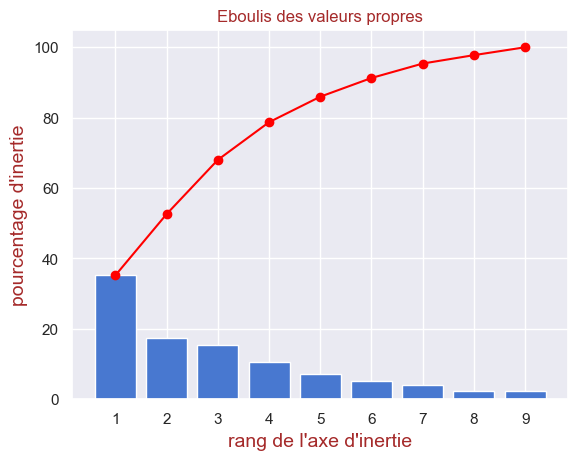

In [332]:
plt.bar(x_list_num_axes_tot, scree_tete)
plt.plot(x_list_num_axes_tot, scree_tete_cum,c="red",marker='o')
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.ylabel("pourcentage d'inertie")
plt.title("Eboulis des valeurs propres")
plt.grid()
plt.show(block=False)

On a en bleu la variance de chaque nouvelle composante, et en rouge la variance cumulée.

On voit ici que 68% de la variance est prise dans les 3 premières composantes. (79% dans les 4). On ne gagne pas grand chose

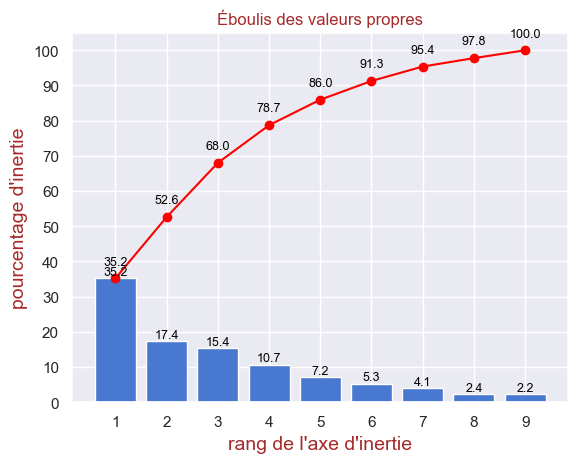

In [333]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(x_list_num_axes_tot, scree_tete)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_tete):
    plt.text(x_list_num_axes_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(x_list_num_axes_tot, scree_tete_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_tete_cum):
    plt.text(x_list_num_axes_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.4 - Components : </h4>
</div>

Intéressons nous maintenant à nos fameuses composantes. 
Les Composantes principales nous sont donnée par l'attribut `components_`. Cette variable est généralement nommée `pcs` : 

In [334]:
#les vecteurs Axes principaux enf contion des vecteurs originaux
#sur la première ligne on a ce qui compose l'axe F1, en fonction des variables d'origine
#sur la seconde ligne la décomposition de l'axe F2 en fonction des variables d'origine
#PM j'ai l'impression que ça se lit plutôt colonne par colonne
#PM et qu'on a sur la 1ère colonne la décomposition de la variable d'originie sur les axes principaux
#PM et qu'on a sur la 2ème colonne la décomposition de la variable d'originie sur les axes principaux
pcs_tete = pca_tete.components_
pcs_tete

array([[ 0.20200703, -0.09327218,  0.11243048,  0.47965855,  0.23706498,
         0.44106728,  0.23419658,  0.46689346,  0.42918857],
       [-0.11303734,  0.54092277, -0.61607745,  0.15435863, -0.05494451,
         0.18485939, -0.4118915 ,  0.27949158, -0.0792784 ],
       [-0.69067132,  0.10509618,  0.25163283, -0.03000806,  0.62722376,
        -0.00403343, -0.19503108, -0.03847544,  0.12151116],
       [ 0.05044369,  0.64748667,  0.23015066,  0.05730959,  0.11526313,
        -0.15262822,  0.58193416,  0.12106231, -0.3634258 ],
       [-0.40511014,  0.09183179,  0.07616229,  0.18044593, -0.52918269,
        -0.47826451,  0.10728131,  0.22899837,  0.46515639],
       [ 0.23430882,  0.27143593,  0.66487907,  0.20658097, -0.213275  ,
         0.06987775, -0.57584154, -0.0329517 , -0.06027959],
       [ 0.09922441, -0.30002421, -0.10607604,  0.56506918,  0.26021536,
        -0.55736726, -0.15458245,  0.16011789, -0.37640526],
       [ 0.34156692,  0.30551605, -0.17470769,  0.17903177,  0

In [335]:
features_tete

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [336]:
#CALRIFIONS LE RESULTAT/ TRANSFORMONS pcs_tete en DF
pcs_tete = pd.DataFrame(pcs_tete)
pcs_tete.columns = features_tete
pcs_tete.index = list_Fi_tot
pcs_tete.round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
F1,0.20,-0.09,0.11,0.48,0.24,0.44,0.23,0.47,0.43
F2,-0.11,0.54,-0.62,0.15,-0.05,0.18,-0.41,0.28,-0.08
F3,-0.69,0.11,0.25,-0.03,0.63,-0.00,-0.20,-0.04,0.12
F4,0.05,0.65,0.23,0.06,0.12,-0.15,0.58,0.12,-0.36
F5,-0.41,0.09,0.08,0.18,-0.53,-0.48,0.11,0.23,0.47
F6,0.23,0.27,0.66,0.21,-0.21,0.07,-0.58,-0.03,-0.06
F7,0.10,-0.30,-0.11,0.57,0.26,-0.56,-0.15,0.16,-0.38
F8,0.34,0.31,-0.17,0.18,0.27,-0.27,-0.01,-0.57,0.51
F9,0.35,0.05,0.04,-0.56,0.26,-0.36,-0.18,0.53,0.21


-- **ATTENTION** -- : Nous avons arrondi les résultats pour simplifier l'analyse

**<u>INTERPRETATIONS des Composantes:</u>**

`F1` =
0.49 * PIB/hab  
+0,45 * Acces_Alim_saine  
+0,47 * Score_Transport  
+0.43 Score_stabilite  

**F1 => Niveau de Vie (35% de la variance) (Axe important pour le poulet bio)**

F2 =  
-0,54 *Population  
-0,65 * Balance_I/E_Poulet  
-0,41 * Imp Poulet Fr/pers	

**F2 => Pays de taille importante non consommateur de poulet en masse(17% de la variance** un peu bizarre ce mix avec la population en négatif
(Axe important pour le poulet)  

F3 =
-0.69 *Prox Geo commerc  
+0.63 de Part de Volaille Alim
+0,25 Bal Imp-Exp Poulet/pers	

**F3 => Pays éloigné avec part de poulet Alim (15% de la variance)**  
(plus influencé par Chine et Inde dans cette version)  

F4 =  
0.65 Population
+0.58 * Imp_Poulet_Fr  
**F4 => Importateur de Poulet Francais (10% de la variance)+Taile du pays**
ATTENTION F4 a changé et n'est plus : Importateur mondiaux de poulet 

F5 =  
-0.41 *Prox Geo commerc 
-0.53 * Part de Volaille 
-0.48 * Part Acces Alim Saine	
0.47 * Stab
**54 =>Pays Pauvre mais stables 76% de la variance)+Taile du pays**

**les axes sont moins interprétables**


Remarque :  
on pourrait 
garder que les 4 premiers axes(79% de la variance) selon le critère de Kaiser(Axe avec plsu de 100/9=11% de variance) ou les 5 premiers pour avori plsu de80% de la variance et des axes encore interprétabels.

pour une représentation plus *visuelle*

<Axes: >

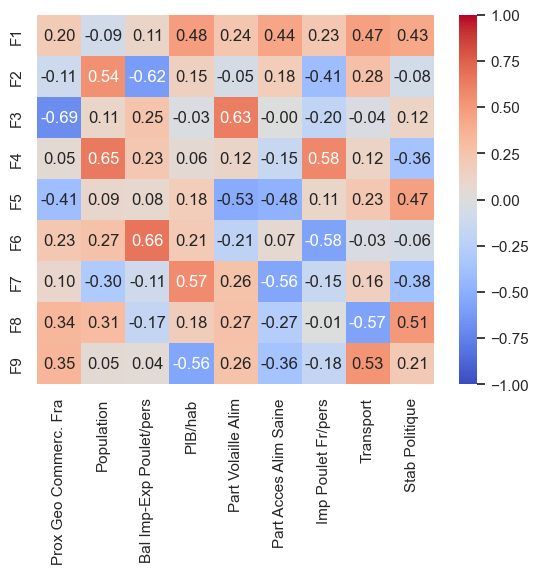

In [337]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_tete, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [338]:
#Autre visualisation :
pcs_tete.T

,F1,F2,F3,F4,F5,F6,F7,F8,F9
Prox Geo Commerc. Fra,0.202007,-0.113037,-0.690671,0.050444,-0.405110,0.234309,0.099224,0.341567,0.348304
Population,-0.093272,0.540923,0.105096,0.647487,0.091832,0.271436,-0.300024,0.305516,0.054346
Bal Imp-Exp Poulet/pers,0.112430,-0.616077,0.251633,0.230151,0.076162,0.664879,-0.106076,-0.174708,0.043356
PIB/hab,0.479659,0.154359,-0.030008,0.057310,0.180446,0.206581,0.565069,0.179032,-0.561537
Part Volaille Alim,0.237065,-0.054945,0.627224,0.115263,-0.529183,-0.213275,0.260215,0.266731,0.264023
Part Acces Alim Saine,0.441067,0.184859,-0.004033,-0.152628,-0.478265,0.069878,-0.557367,-0.268995,-0.362407
Imp Poulet Fr/pers,0.234197,-0.411891,-0.195031,0.581934,0.107281,-0.575842,-0.154582,-0.006188,-0.178258
Transport,0.466893,0.279492,-0.038475,0.121062,0.228998,-0.032952,0.160118,-0.572270,0.530191
Stab Politique,0.429189,-0.079278,0.121511,-0.363426,0.465156,-0.060280,-0.376405,0.506342,0.211191


<Axes: >

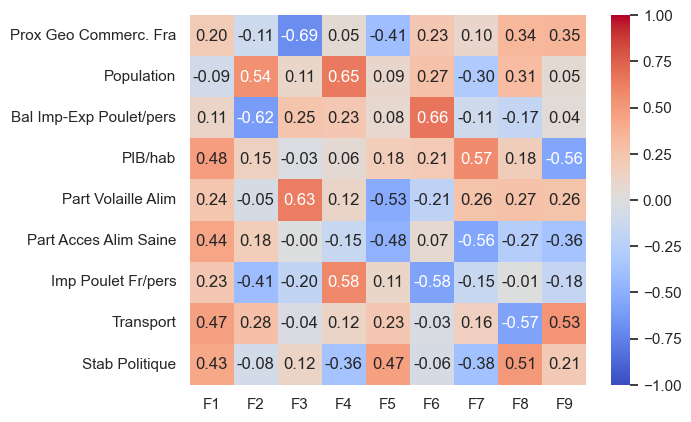

In [339]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_tete.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

##### **Pour Rappel : Corrélation des variables d'origines entre elles :**

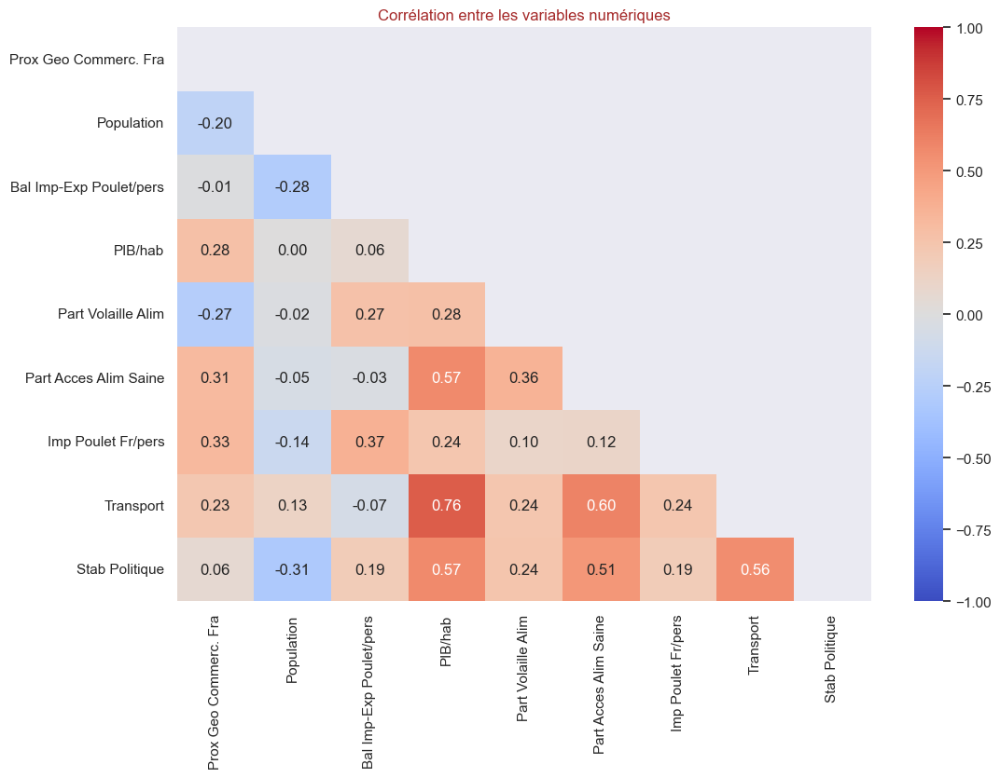

In [340]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres[quant_vars].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres[quant_vars].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

Principale corrélation qui ressort : PIB/hab -AlimSaine - Transport -Stab politique

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.5 - Graphique de Corrélation : </h4>
</div>

Définissons nos axes x et y. Nous allons utiliser les 2 premières composantes. Comme - en code - on commence à compter à partir de 0, cela nous donne : 

In [341]:
#pour F1 et F2
x,y=0,1

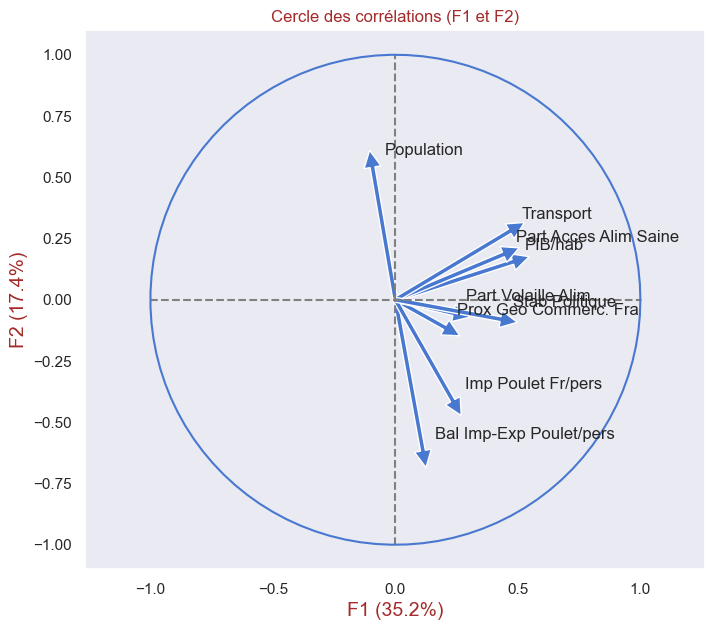

In [342]:
correlation_graph(pca_tete, (0,1) , features=df_tete_quant.columns)

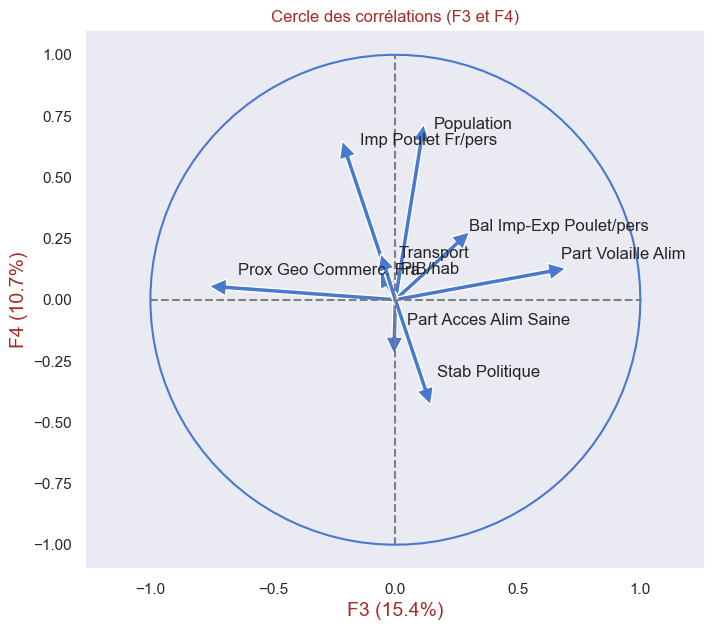

In [343]:
#pour F3 et F4
correlation_graph(pca_tete, (2,3) , features=df_tete_quant.columns)

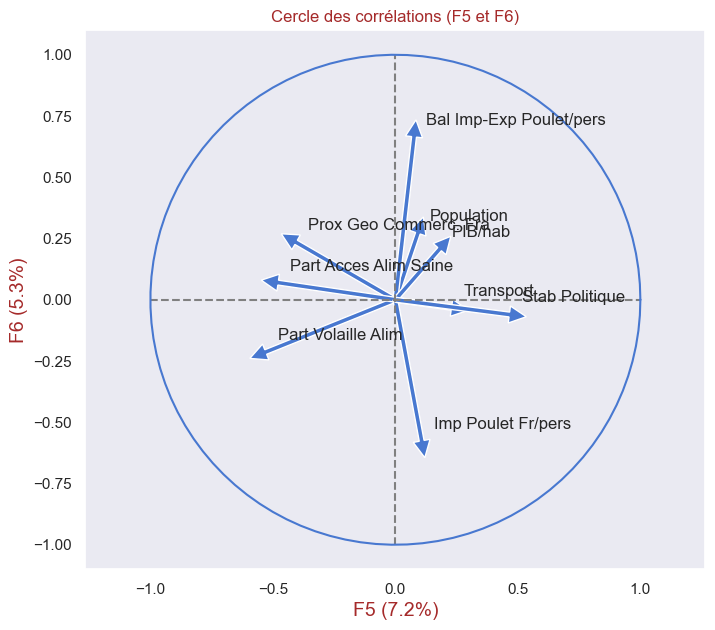

In [344]:
#pour F5 et F6
correlation_graph(pca_tete, (4,5) , features=df_tete_quant.columns)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.3.6 - Projection : </h4>
</div>

Travaillons maintenant sur la projection de nos dimensions. Tout d'abord calculons les coordonnées de nos individus dans le nouvel espace : 

In [345]:
#Visualisation de X_tete_scaled les données centrées réduites
df_temp = pd.DataFrame(X_tete_scaled) #les données centrées réduites
df_temp.columns = features_tete
df_temp.index = names_tete
df_temp.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [346]:
X_tete_scaled.shape

(107, 9)

**Projection de nos données centrées réduites sur les composantes principales**

In [347]:
#maintenant qu'on a fitté notre méthode pca_tete avec 9 axes pricnipaux
#on projette nos données centrés réduites X_tete_scaled sur nos 9 axes principaux
X_tete_proj = pca_tete.transform(X_tete_scaled)

In [348]:
#Visualisation de X_tete_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_tete_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_tete
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


In [349]:
#Visualisation dans un DF de X_tete_proj les données centrées réduites projetées sur nos axes principaux
df_X_tete_proj = pd.DataFrame(X_tete_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_tete_proj.columns = list_Fi_tot
df_X_tete_proj.index = names_tete
df_X_tete_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


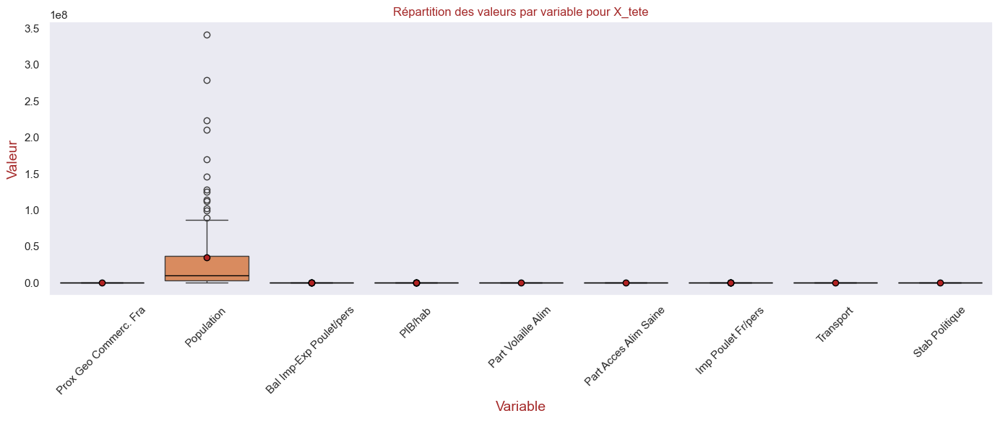

In [350]:
#boxplot de X_tete
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_tete en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_tete, index=names_tete, columns=features_tete)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_tete")
plt.tight_layout()
plt.show()

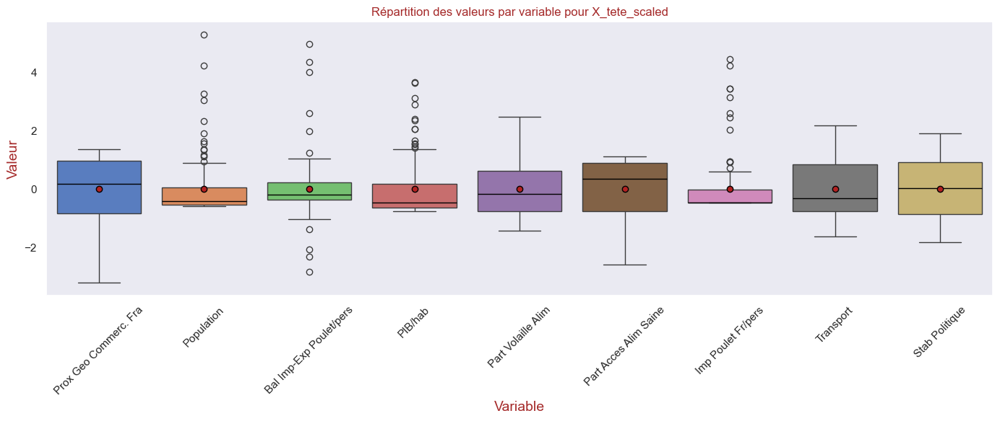

In [351]:
#boxplot de X_tete_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_tete en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_tete_scaled, index=names_tete, columns=features_tete)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_tete_scaled")
plt.tight_layout()
plt.show()


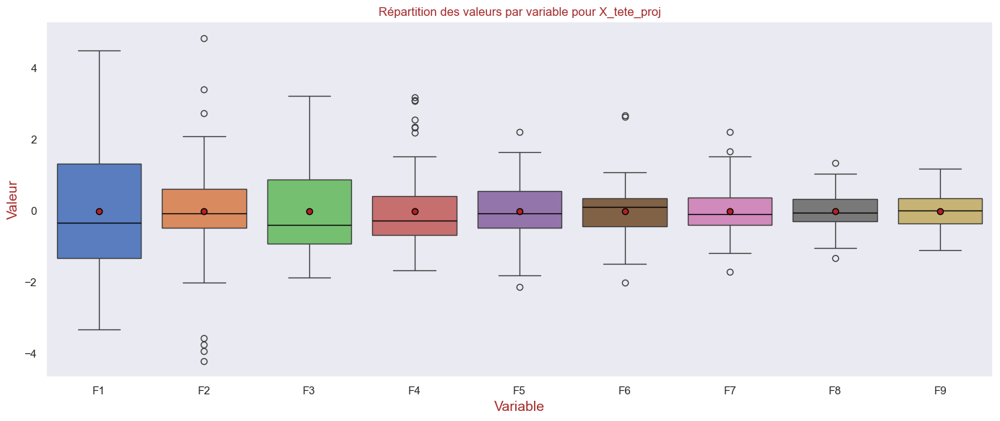

In [352]:
#boxplot de X_tete_proj 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_tete en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_tete_proj, index=names_tete, columns=list_Fi_tot)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='iso3', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_Fi,
            hue_order = Ordre_Fi
           )

#plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_tete_proj")
plt.tight_layout()
plt.show()


##### <font color='blue'>**PROJECTIONS 2D sur les AXES PRINCIPAUX :**</font>

Essayons avec F1 et F4 : nos axes qui ont le plus de sens  :

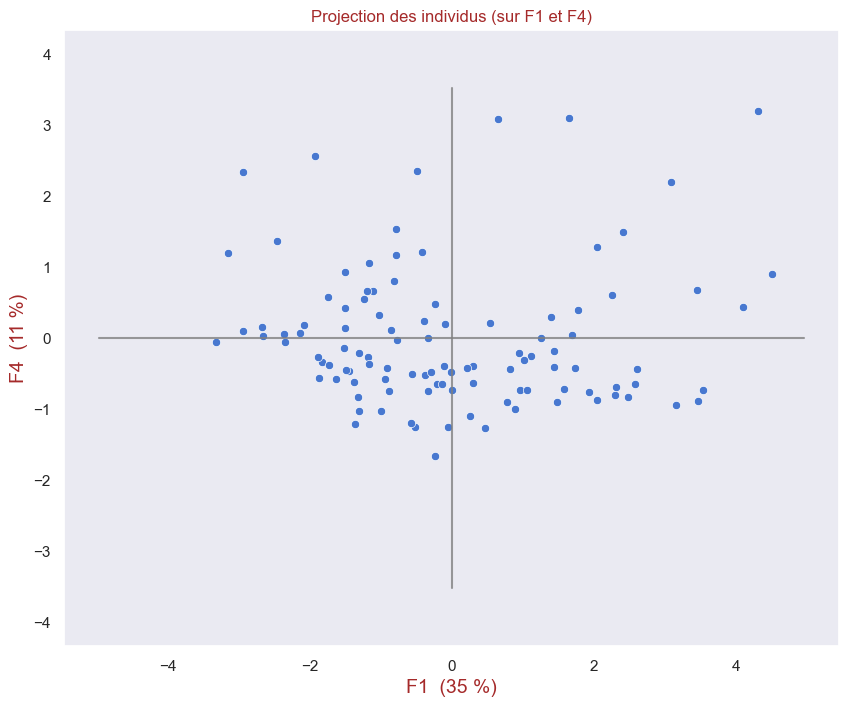

In [353]:
x_y = [0,3] #pour F1 et F4 :
display_factorial_planes(X_tete_proj, x_y, pca=pca_tete)

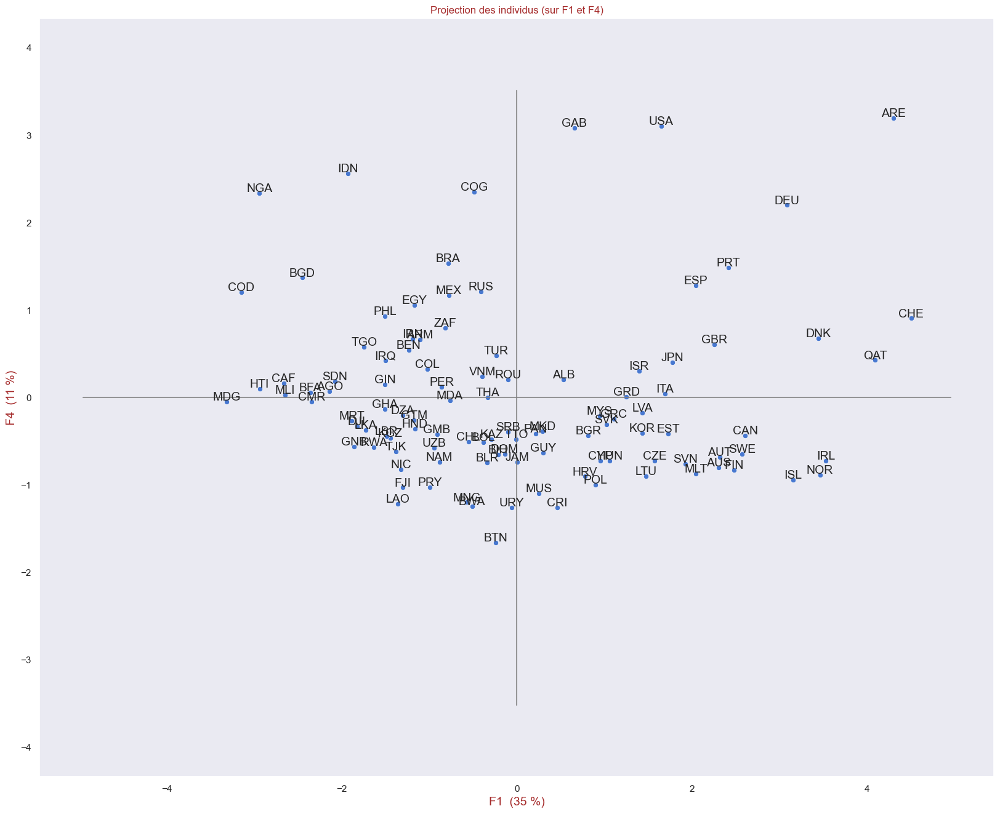

In [354]:
x_y = [0,3] #pour F1 et F4 :
display_factorial_planes(X_tete_proj, x_y,labels=names_tete,figsize=(20,16), pca=pca_tete)

Les pays qui ressortent favorablement pour F3+F4 sont : LUX, BEL, NLD, ARE, QAT  
Sur un seul axe:  
F1 : CHE, NOR, IRL  
F4 : COG, GAB   

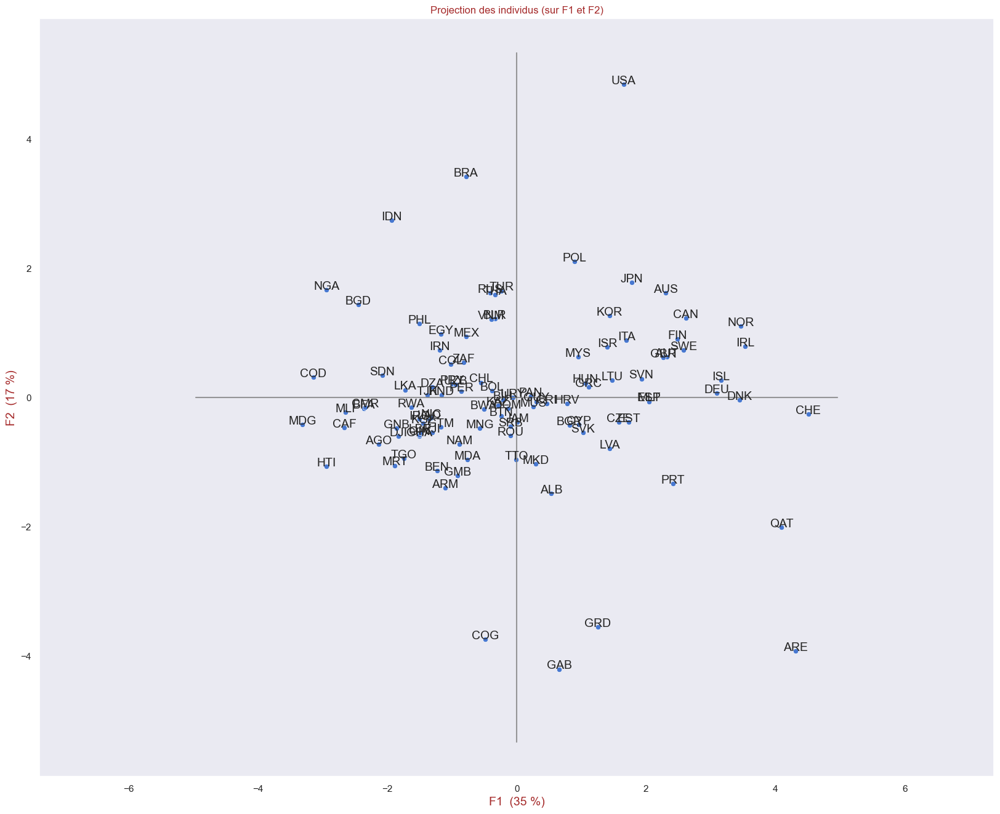

In [355]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_tete_proj, x_y,labels=names_tete,figsize=(20,16), pca=pca_tete)

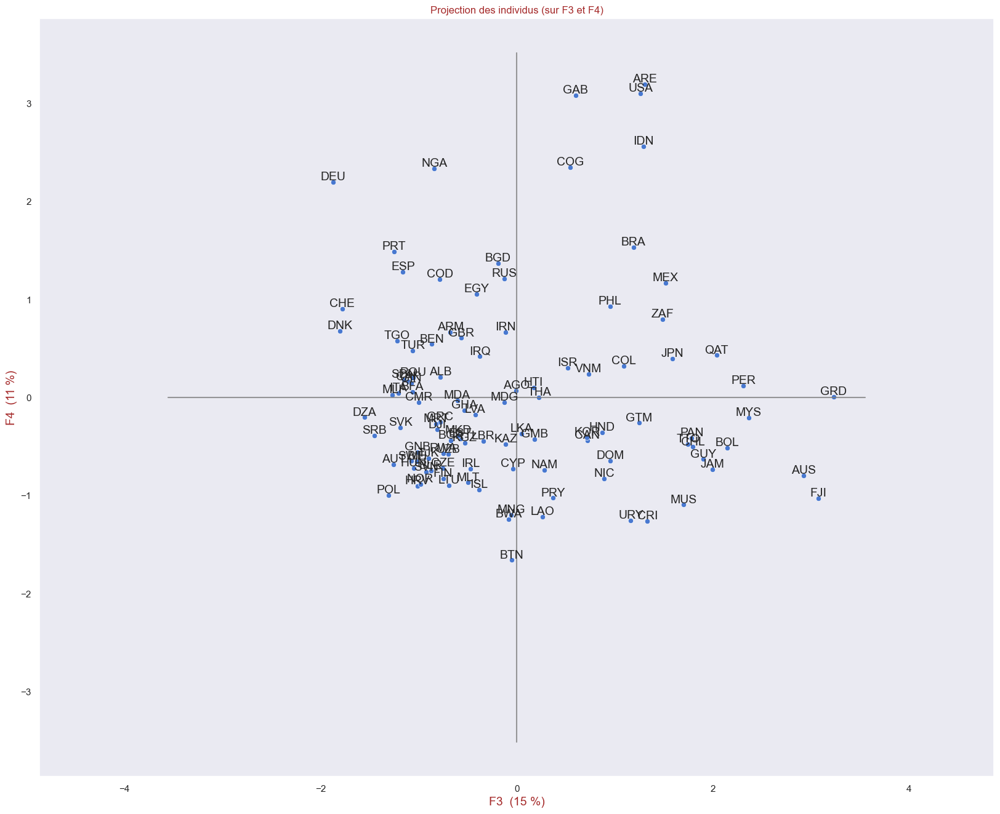

In [356]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_tete_proj, x_y,labels=names_tete,figsize=(20,16), pca=pca_tete)

Les pays qui ressortent favorablement pour F3+F4 sont : USA, IDN, BRA  
Sur un seul axe:  
F3 : AUS, JPN  
F4 : LUX, BEL, NLD   

Remarque : visualisation 2D pour F1 -Niveau de vie /F2(conso de Poulet)/F5(Commerce avec la France)

##### <font color='blue'>**PROJECTIONS 3D sur les AXES PRINCIPAUX :**</font>

In [357]:
#Visualisation de X_tete_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_tete_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_tete
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


In [358]:
fig = px.scatter_3d(df_temp, x='F1', y='F3', z='F4', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

Quand on regarde selon 3 critères : F1 (Niveau de Vie), F3(Population), F4(Import de poulet Fr),  
les pays qui ressortent sont : USA, BRA, IDN, LUX, BEL.  
Cependant le BRA et l'IDN ne sont élevés que par le critère de population F3.

In [359]:
#Avec pays consommateurs de poulet international au lieu de  la population 
fig = px.scatter_3d(df_temp, x='F1', y='F2', z='F4', opacity=0.3,text=df_temp.index)

# Forcer des axes à échelle identique
fig.update_layout(
    width=1000, height=800,
    scene=dict(
        aspectmode='cube'  # équivalent à plt.axis('equal')
    )
)

# Agrandir la figure (en pixels)
fig.update_layout(width=1000, height=800)
fig.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.4 - Réduction de l'Etude aux 4 premières composantes F1, F2, F3, F4 (77% de la variance)</h3>
</div>

In [360]:
df_X_tete_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


In [361]:
df_X_tete_proj.shape

(107, 9)

<u>**SELECTIONS DE COMPONENTS :**</u>  
Pour la suite ne gardons que F1, F2, F3 et F4 qui sont interprétables

In [362]:
nb_components_tete_selec =4

In [363]:
x_list_num_axes_tot

range(1, 10)

In [364]:
x_list_num_axes_tete_selec = range(1,nb_components_tete_selec+1)
print(x_list_num_axes_tete_selec)

range(1, 5)


In [365]:
for i in x_list_num_axes_tete_selec :
    print(i)

1
2
3
4


In [366]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'F9']

In [367]:
list_Fi_tete_selec = list_Fi_tot[:nb_components_tete_selec]
list_Fi_tete_selec

['F1', 'F2', 'F3', 'F4']

In [368]:
df_X_tete_proj_selec_PCA = df_X_tete_proj.loc[:,list_Fi_tete_selec].copy(deep=True)
df_X_tete_proj_selec_PCA

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908
...,...,...,...,...
URY,-0.056113,-0.002044,1.163132,-1.255348
USA,1.650223,4.845146,1.261062,3.104383
UZB,-0.941468,0.203175,-0.697565,-0.578076


In [369]:
df_X_tete_proj_selec_PCA.shape

(107, 4)

In [370]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_X_tete_proj_selec_PCA)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,107,107,0,107,NaN
F2,float64,107,107,0,107,NaN
F3,float64,107,107,0,107,NaN
F4,float64,107,107,0,107,NaN


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.5 - Etude des outliers</h3>
</div>

##### **Recherches des Outliers :**  
On peut rechercher les outliers sur les données d'origine centrées réduites  
ou sur les données projetées Fa à F5( à partir du moment ou les axes sélectionnées représente,t une ceraines quantité de variance.)  
Nos 5 axes portent 77 % de la variance,  
ce qui n'est pas parfait mais permet d'étudier sur les données projetées, avec les 3/4 de la variance.

**Travaillons sur une copie temporaire de `df_X_tete_proj_selec_PCA`**

In [371]:
df_temp_etude = df_X_tete_proj_selec_PCA.copy()

##### **LES DISTANCES :**

**La `distance euclidienne`** : la distance classique dans un espace vectoriel orthonormé.  

**La `distance de Mahalanobis`** :  
La distance de Mahalanobis mesure la distance entre un point et un groupe (ou une distribution) en tenant compte de la corrélation entre les variables.    
Avantage par rapport à la distance euclidienne :  
Elle corrige les effets d’échelle et de corrélation entre les variables.  
Ainsi, un point qui semble proche selon la distance euclidienne peut être un vrai outlier selon Mahalanobis s’il dévie dans une direction atypique

<u>Quand appliquer la `distance de Mahalanobis` dans un processus de PCA ?</u>  
<u>1. Option 1 : appliquer sur les données brutes (après centrage-réduction)</u>  
✅ Avantage : permet de détecter des outliers avant la réduction de dimension (avec toute l'information).  
⚠️ Inconvénient : les données peuvent être bruitées ou difficiles à interpréter dans un grand espace.  

<u>2. Option 2 : appliquer sur les données projetées sur les premières composantes principales</u>  
✅ Avantage : Travailler dans un espace plus compact, avec les dimensions les plus informatives.  
Cela peut réduire le bruit et faciliter la détection des observations aberrantes.  
⚠️ Inconvénient : Perte de l'information des composantes écartées.  
Mais si 95% de la variance a été conservé, ce risque est limité.  

**=>Nos 5 axes portent 77 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.5.1 - Outliers : Etude sur les 4 Composantes Principales : : </h4>
</div>

##### <font color ='blue'> **a.CALCUL DES DISTANCES :**</font>

La distance euclidienne

La distance de Mahalanobis

In [372]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude.mean().values
cov = np.cov(df_temp_etude.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude["mahalanobis"] = df_temp_etude.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,mahalanobis
iso3,,,,,
ARE,4.305748,-3.922011,1.307070,3.195349,5.219512
USA,1.650223,4.845146,1.261062,3.104383,5.170805
GAB,0.658074,-4.199974,0.600602,3.082033,4.616326
GRD,1.252356,-3.547906,3.229922,0.009056,3.987405
COG,-0.486269,-3.737354,0.546151,2.349956,3.846439
IDN,-1.929060,2.746762,1.292956,2.563470,3.726046
BRA,-0.781398,3.416909,1.189203,1.534977,3.317386
QAT,4.094671,-2.002713,2.037021,0.433491,3.307505
NGA,-2.938670,1.664421,-0.840313,2.338058,3.252309


In [373]:
df_temp_etude[['mahalanobis']].describe()

,mahalanobis
count,107.000000
mean,1.793681
std,0.867385
min,0.527227
25%,1.263261
50%,1.555499
75%,1.913672
max,5.219512


<u>Calcul du Seuil  pour êter un outlier selon Mahalanobis :</u>  
La distance de Mahalanobis suit une loi du χ² (chi carré) avec p degrés de liberté, 
où p est le nombre de dimensions

In [374]:
from scipy.stats import chi2
import numpy as np

In [375]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_tete_selec

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=4 : 3.34


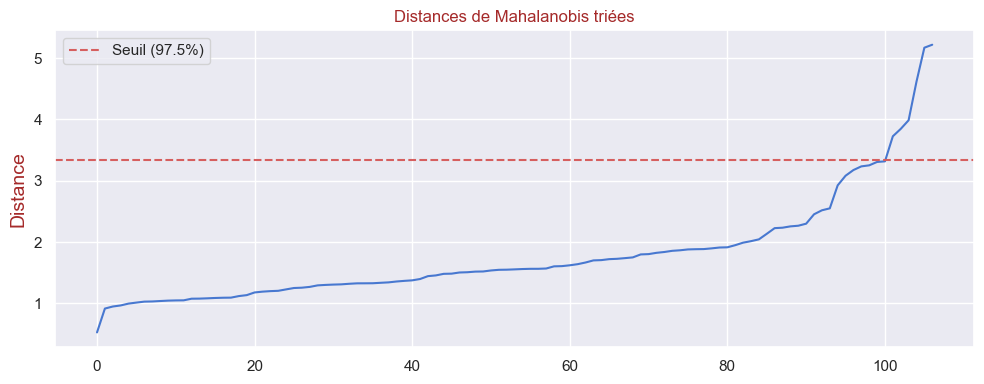

In [376]:
plt.figure(figsize=(10, 4))
plt.plot(df_temp_etude["mahalanobis"].sort_values().values)
plt.axhline(y=threshold, color='r', linestyle='--', label='Seuil (97.5%)')
plt.title("Distances de Mahalanobis triées")
plt.ylabel("Distance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

PM : si je comprends bien, LA distance est calculée sur les données , en connaissant le nombre de dimensions, de telle sorte que les données soient étalées selon une loi deu chi2, ce qui permet de prévoir à partir de quelle distance on a X% d'individus au delà.  
Il faut donc les étudier car il ya aura toujours X% au delà du seuil fourni, ce qui ne veut pas dire que toutes les valeurs sont des outliers ou qu'il n'y en a pas plus.

In [377]:
df_outliers_tete = df_temp_etude[df_temp_etude["mahalanobis"] > threshold]

In [378]:
display(df_outliers_tete.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,mahalanobis
iso3,,,,,
ARE,4.305748,-3.922011,1.307070,3.195349,5.219512
USA,1.650223,4.845146,1.261062,3.104383,5.170805
GAB,0.658074,-4.199974,0.600602,3.082033,4.616326
GRD,1.252356,-3.547906,3.229922,0.009056,3.987405
COG,-0.486269,-3.737354,0.546151,2.349956,3.846439
IDN,-1.929060,2.746762,1.292956,2.563470,3.726046


La `CHN` et l'`IND` ayant été retiré,  
les autres grands pays ressortent maintenant : USA, IDN USA.

##### Recherche classique de seuil

##### Fin Recherche classique de seuil

In [379]:
liste_iso3_outliers_tete = list(df_outliers_tete.index)
liste_iso3_outliers_tete

['ARE', 'COG', 'GAB', 'GRD', 'IDN', 'USA']

##### **Données des outliers avec les variables originales :**

In [380]:
#**Données avec les variables originales :**
#liste_iso3_outliers_tete = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres['iso3'].isin(liste_iso3_outliers_tete)

df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
24,COG,Congo,Africa,-5746.042,6035104,25.301304,2570.136581,4.734824,20.9,0.492906,2.1,46.91943
39,GAB,Gabon,Africa,-5237.393,2430747,32.117308,8427.098986,5.606583,62.7,0.623376,2.2,33.649288
46,GRD,Grenade,America,-7112.1,116913,57.456143,9509.250006,7.114045,78.9,0.0,2.5,86.25592
53,IDN,Indonésie,Asia,-11547.48,278830529,-0.001792,4787.999308,1.979152,52.4,0.0,2.9,28.909952
108,USA,USA,America,-7227.043,341534045,-10.731474,76100.715015,5.067229,95.3,0.000004,3.9,47.393364


##### **Données des outliers centrées réduites avec les variables originales :**

In [381]:
#**Données centrées réduites avec les variables originales :**
#Attention X_tete_scaled est un np.Array

#Visualisation dans un DF de X_tete_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_tete_scaled) #les données centrées réduites
df_temp_sc.columns = features_tete
df_temp_sc.index = names_tete

#liste_iso3_outliers_tete = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_tete)

df_comp_Outliers_tete = df_temp_sc.loc[mask_temp,:]
display(df_comp_Outliers_tete)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
COG,-0.129644,-0.493429,1.966691,-0.666484,0.965941,-2.008895,3.425227,-1.195988,0.013410
GAB,0.012685,-0.555613,2.599943,-0.422566,1.417919,-0.355572,4.453410,-1.049569,-0.508360
GRD,-0.511889,-0.595532,4.954089,-0.377498,2.199489,0.285189,-0.459171,-0.610310,1.560085
IDN,-1.752980,4.212927,-0.384136,-0.574119,-0.462785,-0.762970,-0.459171,-0.024631,-0.694706
USA,-0.544052,5.294708,-1.380994,2.395767,1.138282,0.933862,-0.459141,1.439565,0.032045


**OBSERVATIONS sur la Comparaison CHN IND et notre première sélection sur les données centrées réduites :**  
<u>IND :</u>  
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1 et un peu sur les transports faiblement 0.3  
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1  
<u>CHN :</u>   
Chiffres favorables (>0, la moyenne) uniquement sur la population 7.1, les transports faiblement 1.5, et un peu sur l'Alimentation saine (0.5)   
Chiffres favorables (>0, la moyenne) et significativement (>1, l'écart type) uniquement sur la population 7.1 et un peu les transports 1.5.  

In [382]:
(df_comp_Outliers_tete > 1.0).sum(axis=1)

iso3
ARE    6
COG    2
GAB    3
GRD    3
IDN    1
USA    4
dtype: int64

In [383]:
df_temp_2 = df_comp_Outliers_tete.copy(deep=True)

In [384]:
# Nombres de scores supérieurs à 1
valeur_selec = 1.0

df_temp_2[f"Nb Score >{valeur_selec}"] = (df_temp_2[quant_vars] > valeur_selec).sum(axis=1) 

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0
iso3,,,,,,,,,,
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,6
COG,-0.129644,-0.493429,1.966691,-0.666484,0.965941,-2.008895,3.425227,-1.195988,0.013410,2
GAB,0.012685,-0.555613,2.599943,-0.422566,1.417919,-0.355572,4.453410,-1.049569,-0.508360,3
GRD,-0.511889,-0.595532,4.954089,-0.377498,2.199489,0.285189,-0.459171,-0.610310,1.560085,3
IDN,-1.752980,4.212927,-0.384136,-0.574119,-0.462785,-0.762970,-0.459171,-0.024631,-0.694706,1
USA,-0.544052,5.294708,-1.380994,2.395767,1.138282,0.933862,-0.459141,1.439565,0.032045,4


(Pourquoi 1, parce que cela correspondà l'écart type,  
je considdère que le pays a plutôt un socre un peu supérieur en étant un peu au dessus de l'écart type pa rrapport à zéro( la moyenne) )    
Et qu'il présente donc un critère en sa faveur


Je vais choisir un seuil arbitrairement 4.0 ,  
qui représente donc des données éloigné de plus de 4 écart type par rappor tà la moyenne.  
pour décider des outliers hors norme.

In [385]:
# Nombres de scores supérieurs à 4
#valeur_selec = round(seuil2,2)
valeur_selec = 4

df_temp_2[f"Nb Score >{valeur_selec} ou <-{valeur_selec}"] = ((df_temp_2[quant_vars] > valeur_selec).sum(axis=1) +
                                          (df_temp_2[quant_vars] < (-1* valeur_selec)).sum(axis=1) )

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Nb Score >4 ou <-4
iso3,,,,,,,,,,,
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,6,2
COG,-0.129644,-0.493429,1.966691,-0.666484,0.965941,-2.008895,3.425227,-1.195988,0.013410,2,0
GAB,0.012685,-0.555613,2.599943,-0.422566,1.417919,-0.355572,4.453410,-1.049569,-0.508360,3,1
GRD,-0.511889,-0.595532,4.954089,-0.377498,2.199489,0.285189,-0.459171,-0.610310,1.560085,3,1
IDN,-1.752980,4.212927,-0.384136,-0.574119,-0.462785,-0.762970,-0.459171,-0.024631,-0.694706,1,1
USA,-0.544052,5.294708,-1.380994,2.395767,1.138282,0.933862,-0.459141,1.439565,0.032045,4,1


**OBSERVATIONS :**  
Sachant que notre sélection de variables a été soigneusement choisie pour être équilibrée sur les thèmes avec peu de corrélation entre elles.  
On peut accorder un intérêt à nos valeurs originales (centrées réduites).  

**BILAN RESUME ICI :** Il n'y a plus de pays avec de très gros outliers (supérieurs à 7).  

RAPPEL 

`BRA` :  
2 résutlat favorable (>1.0) : faiblement pertinent  
0 outlier important (>4.0) : pas de souci  
  
`IDN`, l'indonésie :    
1 seul résutlat favorable (>1.0) : pas pertinent pour l'étude  
1 outlier important (>4.0) : pour la population mais pas hors norme (4.2)   
  
`USA` :    
3 résultats favorables (>1.0) : candidat pertinent    
1 outlier important (>4.0) : 5.3 pour la population    
  
=>Ca ne devrait pas êter trop perturbant de laisser BRA, et IDN,    
pour les USA, c'est un peu le même principe que pour les autres déjà étudié.  
Il est pertinent donc soit on le garde, soit on l'écarte et l'étudie à part.  
  
<u>RAPPEL :</u>  
`GRD`, Grenade :  
3 résultats favorables (>1.0): intérêt intermédiaire  
1 outlier important (>4.0) : 4.2 (pas hors norme) pour un indicateur intéressant  Bal Imp-Exp Poulet/pers   
position intermédiaire avec quelques résultats pertinents (>1.0) et son outier favorable, sur une variable intéressante( Bal Imp-Exp Poulet/pers	) mais avec une population modeste et éloignée).  

Les autres pays ont des scores >1.0 sur 4 à 6 variables sur 9.  (et moins de 1 très gors outliers, sauf LUX (2))
Ils pourraient donc être des candidats intéressants dans notre étude.    
Il faut vori si nous les écartons pour les étudier séparément, ou si les garder ne perturbe pas trop.  

Note : la légère corrélation sur PIB, Alimentation saine, Transport, Politique, renforce le score de ARE, QAT.  
A noter que CHN et IND ont leurs gros outliers(>4.0) sur la Population.  
Les autres pays ont ont leurs gros outliers liés à la consommation de Poulet : Bal Imp-Exp Poulet/pers	ou Imp Poulet Fr/pers   
(+PIB pour LUX  


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2tete.5.2 - Outliers : Etude sur les 9 Composantes Principales : : </h4>
</div>

##### <font color='blue'>**Données sur les 9 Composantes Principales :**</font>

In [386]:
#Visualisation dans un DF de X_bis_proj les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9 = pd.DataFrame(X_tete_proj).copy() #les données centrées réduites projetées sur nos axes principaux
df_temp_etude_9.columns = list_Fi_tot
df_temp_etude_9.index = names_tete
df_temp_etude_9.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


In [387]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude_9.mean().values
cov = np.cov(df_temp_etude_9.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude_9["mahalanobis"] = df_temp_etude_9.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
USA,1.650223,4.845146,1.261062,3.104383,0.280065,0.923937,-0.077151,1.349635,-0.492983,6.181732
GRD,1.252356,-3.547906,3.229922,0.009056,-0.301785,2.675609,-0.811521,0.362107,0.781220,6.018645
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376,5.694203
QAT,4.094671,-2.002713,2.037021,0.433491,0.221162,2.647434,0.873288,-0.110179,-0.375869,5.321683
GAB,0.658074,-4.199974,0.600602,3.082033,-0.513724,-1.332971,-0.444590,0.094226,-0.630233,5.283008
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112,4.909423
IRL,3.531036,0.790168,-0.469717,-0.725779,-0.065385,0.585752,1.663160,1.039511,-1.099475,4.903551
COG,-0.486269,-3.737354,0.546151,2.349956,0.586176,-1.274557,0.194967,0.810101,0.128774,4.677949
NOR,3.464476,1.109097,-0.982341,-0.881361,0.660731,0.900190,1.539606,0.360537,-1.095632,4.606108


In [388]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_tete

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=9 : 4.36


In [389]:
df_outliers_tete_9 = df_temp_etude_9[df_temp_etude_9["mahalanobis"] > threshold]

In [390]:
display(df_outliers_tete_9.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,F5,F6,F7,F8,F9,mahalanobis
iso3,,,,,,,,,,
USA,1.650223,4.845146,1.261062,3.104383,0.280065,0.923937,-0.077151,1.349635,-0.492983,6.181732
GRD,1.252356,-3.547906,3.229922,0.009056,-0.301785,2.675609,-0.811521,0.362107,0.781220,6.018645
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376,5.694203
QAT,4.094671,-2.002713,2.037021,0.433491,0.221162,2.647434,0.873288,-0.110179,-0.375869,5.321683
GAB,0.658074,-4.199974,0.600602,3.082033,-0.513724,-1.332971,-0.444590,0.094226,-0.630233,5.283008
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112,4.909423
IRL,3.531036,0.790168,-0.469717,-0.725779,-0.065385,0.585752,1.663160,1.039511,-1.099475,4.903551
COG,-0.486269,-3.737354,0.546151,2.349956,0.586176,-1.274557,0.194967,0.810101,0.128774,4.677949
NOR,3.464476,1.109097,-0.982341,-0.881361,0.660731,0.900190,1.539606,0.360537,-1.095632,4.606108


In [391]:
liste_iso3_outliers_tete_9 = list(df_outliers_tete_9.index)
liste_iso3_outliers_tete_9

['ARE', 'AUS', 'COG', 'GAB', 'GRD', 'IDN', 'IRL', 'ISR', 'NOR', 'QAT', 'USA']

In [392]:
liste_iso3_outliers_suppl= [iso for iso in liste_iso3_outliers_tete_9 if iso not in liste_iso3_outliers_tete]
liste_iso3_outliers_suppl

['AUS', 'IRL', 'ISR', 'NOR', 'QAT']

Les nouveaux pays sont `AUS`, `IRL`, `ISR`, `NOR`

**Données avec les variables originales :**

In [393]:
#**Données avec les variables originales :**

mask_temp = df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres['iso3'].isin(liste_iso3_outliers_suppl)

df_Etude_Marche_analyse_1_1_tete_hors_CHN_IND_autres.loc[mask_temp,:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085
55,IRL,Irlande,Europe,-948.9664,5110016,-0.132407,105993.272773,4.308361,99.0,0.027671,3.5,78.672989
59,ISR,Israël,Asia,-3151.131,9103151,-0.020705,58086.357487,6.729034,83.5,0.0,3.7,9.952606
86,NOR,Norvège,Europe,-1544.384,5456801,0.163508,106622.826063,2.309558,98.5,0.0,3.9,77.725121
93,QAT,Qatar,Asia,-4863.478,2892455,47.121445,87974.166043,6.392373,100.0,0.067244,3.8,84.360191


**Données centrées réduites avec les variables originales :**

In [394]:
#**Données centrées réduites avec les variables originales :**
#Attention X_tete_scaled est un np.Array

#Visualisation dans un DF de X_tete_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_tete_scaled) #les données centrées réduites
df_temp_sc.columns = features_tete
df_temp_sc.index = names_tete

#liste_iso3_outliers_suppl = list((df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_suppl)

df_comp_CHN_IND = df_temp_sc.loc[mask_temp,:]
display(df_comp_CHN_IND)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200
IRL,1.212656,-0.509389,-0.396270,3.640671,0.744834,1.080208,-0.241105,0.853886,1.261931
ISR,0.596455,-0.440498,-0.385893,1.645542,1.999873,0.467134,-0.459171,1.146726,-1.440092
NOR,1.046049,-0.503406,-0.368778,3.666890,-0.291480,1.060432,-0.459171,1.439565,1.224662
QAT,0.117312,-0.547647,3.993927,2.890248,1.825325,1.119762,0.070752,1.293145,1.485546


`IRL`, `ISR`, `NOR`ne correspondent pas à de gros outliers; et l`AUS` est raisonnable Prox très faible)

**BILAN :**  
[CHN, IND, 'ARE', 'BEL','LUX', 'NLD', 'QAT','USA']  retirés  
=> plus de gros outliers mais des axes qui n'ont pas une meilleure variance, et qui sont moins interprétables/

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2tete.6 - Classement données</h3>
</div>

In [395]:
df_X_tete_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [396]:
df_X_tete_scaled_Classement = Classement(df_X_tete_scaled,1.0)
df_X_tete_scaled_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,6,15.104005
QAT,0.117312,-0.547647,3.993927,2.890248,1.825325,1.119762,0.070752,1.293145,1.485546,6,12.248371
CHE,1.364589,-0.445863,-0.039926,3.126058,-0.466991,1.072298,2.597278,2.171663,1.653258,6,11.032365
DNK,1.156174,-0.495710,-0.710624,2.059633,-0.482287,1.084164,2.459210,1.732404,1.187392,6,7.990356
DEU,1.287334,0.853134,-0.195979,1.263036,-0.613529,1.040655,3.132315,2.025244,0.777430,5,9.569641
NOR,1.046049,-0.503406,-0.368778,3.666890,-0.291480,1.060432,-0.459171,1.439565,1.224662,5,6.814762
USA,-0.544052,5.294708,-1.380994,2.395767,1.138282,0.933862,-0.459141,1.439565,0.032045,4,8.850041
IRL,1.212656,-0.509389,-0.396270,3.640671,0.744834,1.080208,-0.241105,0.853886,1.261931,4,7.647422
GBR,1.310710,0.578703,-0.090369,1.132115,0.647082,1.020879,0.493374,1.146726,0.609718,4,6.848937


In [397]:
df_X_tete_scaled.sort_values(by='Imp Poulet Fr/pers',ascending=False).head(15)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
GAB,0.012685,-0.555613,2.599943,-0.422566,1.417919,-0.355572,4.453410,-1.049569,-0.508360
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
PRT,1.117495,-0.417830,-0.151336,0.259837,0.335031,0.645123,3.446372,1.000306,0.945142
COG,-0.129644,-0.493429,1.966691,-0.666484,0.965941,-2.008895,3.425227,-1.195988,0.013410
DEU,1.287334,0.853134,-0.195979,1.263036,-0.613529,1.040655,3.132315,2.025244,0.777430
CHE,1.364589,-0.445863,-0.039926,3.126058,-0.466991,1.072298,2.597278,2.171663,1.653258
DNK,1.156174,-0.495710,-0.710624,2.059633,-0.482287,1.084164,2.459210,1.732404,1.187392
ESP,1.249553,0.227602,-0.435415,0.466327,0.341625,0.767738,2.039151,1.293145,0.330199
TGO,0.252446,-0.440730,-0.183270,-0.735459,-1.076892,-1.039842,0.939187,-0.903149,-1.272380


OBSERVATION :  
L'import de Poulet Fr compte,  
mais ce n'est pas le seul critère

In [398]:
df_X_tete_proj.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0.632416,0.402740,0.441206,0.410018,0.051225
ALB,0.534591,-1.482531,-0.777024,0.208646,-0.586819,0.242836,-0.787667,-0.013626,0.099655
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376
ARM,-1.108496,-1.395469,-0.676329,0.665314,-0.166354,0.169724,0.614714,-0.360837,0.143116
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112


In [399]:
df_X_tete_proj_Classement = Classement(df_X_tete_proj,1.0)
df_X_tete_proj_Classement.head(10)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
USA,1.650223,4.845146,1.261062,3.104383,0.280065,0.923937,-0.077151,1.349635,-0.492983,5,12.844317
JPN,1.781459,1.783624,1.585423,0.399721,1.082404,0.334070,-0.678660,-0.283384,0.510771,4,6.515428
IDN,-1.929060,2.746762,1.292956,2.563470,1.195928,0.711279,-1.088231,0.399657,0.000517,4,5.893277
AUS,2.304344,1.621174,2.924825,-0.796908,1.379331,-0.797272,0.592574,-0.903057,-1.021112,4,5.303899
QAT,4.094671,-2.002713,2.037021,0.433491,0.221162,2.647434,0.873288,-0.110179,-0.375869,3,7.818306
IRL,3.531036,0.790168,-0.469717,-0.725779,-0.065385,0.585752,1.663160,1.039511,-1.099475,3,5.249271
NOR,3.464476,1.109097,-0.982341,-0.881361,0.660731,0.900190,1.539606,0.360537,-1.095632,3,5.075303
BRA,-0.781398,3.416909,1.189203,1.534977,-0.626667,-0.987750,-0.305497,0.660857,0.419564,3,4.520198
ARE,4.305748,-3.922011,1.307070,3.195349,0.399616,0.230572,-0.344635,-0.969763,-0.192376,3,4.009569


**ATTENTION :**  
Les Composantes principales ne sont plus toutes forcément des valeurs positives, puisque elles peuvent être composées de composantes négatives sur certains axes.  
L'interpretation est donc un peu délicat il faut regarder ce que les axes contiennent pour savroi si un score élevé est favorable ou non.
Ce sera plus pertinent de regarder ce classement sur les Axes principaux dont on comprend la signifcation,  
et surtout beaucoup plus sur les données centrées réduites car là on sait (par construction des variables qu'un score positif est un score favorable)

In [400]:
df_X_tete_proj_selec_PCA.head(2)

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646


In [401]:
df_X_tete_proj_selec_PCA_Classement = Classement(df_X_tete_proj_selec_PCA,1.0)
df_X_tete_proj_selec_PCA_Classement.head(10)

,F1,F2,F3,F4,Nb Score >1.0,Score total
iso3,,,,,,
USA,1.650223,4.845146,1.261062,3.104383,4,10.860814
AUS,2.304344,1.621174,2.924825,-0.796908,3,6.053435
JPN,1.781459,1.783624,1.585423,0.399721,3,5.550226
BRA,-0.781398,3.416909,1.189203,1.534977,3,5.359691
ARE,4.305748,-3.922011,1.307070,3.195349,3,4.886156
IDN,-1.929060,2.746762,1.292956,2.563470,3,4.674128
QAT,4.094671,-2.002713,2.037021,0.433491,2,4.562470
CAN,2.612198,1.229320,0.718505,-0.436327,2,4.123695
DEU,3.090636,0.071978,-1.870052,2.200503,2,3.493066


In [402]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

43258

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3bis -Clustering  sur données post ACP-sans CHN et IND </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.1- classification hiérarchique ACH </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.1 - Préliminaires : </h4>
</div>

##### IMPORTS

In [763]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import AgglomerativeClustering

from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

##### DATA

Le jeu de données projeté avec l'ACP sur les 4 premières composantes

In [764]:
df_X_bis_proj_selec_PCA.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079


In [765]:
df_X_bis_proj_ACH=df_X_bis_proj_selec_PCA.copy(deep=True)
df_X_bis_proj_ACH.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079


In [766]:
df_X_bis_proj_ACH.shape

(110, 4)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.2 - Dendrogramme -ACH : </h4>
</div>

Effectuons une classification hiérarchique ascendante.

##### **CALCUL DES DISTANCES :**

Nous allons calculer les distances en spécifiant la méthode à utiliser: méthode de Ward adaptée à l'ACH.

In [767]:
Z = linkage(df_X_bis_proj_ACH, method="ward")
pd.DataFrame(Z)

,0,1,2,3
0,8.0,21.0,0.078305,2.0
1,31.0,105.0,0.146660,2.0
2,41.0,94.0,0.191863,2.0
3,40.0,65.0,0.200819,2.0
4,1.0,73.0,0.223674,2.0
...,...,...,...,...
104,203.0,213.0,8.439339,23.0
105,210.0,212.0,12.265288,54.0
106,205.0,211.0,13.324771,33.0
107,214.0,216.0,15.549286,56.0


In [768]:
Z.shape

(109, 4)

In [769]:
type(Z)

numpy.ndarray

##### **2. Dendogramme**

Nous pouvons désormais afficher le dendrogramme: 

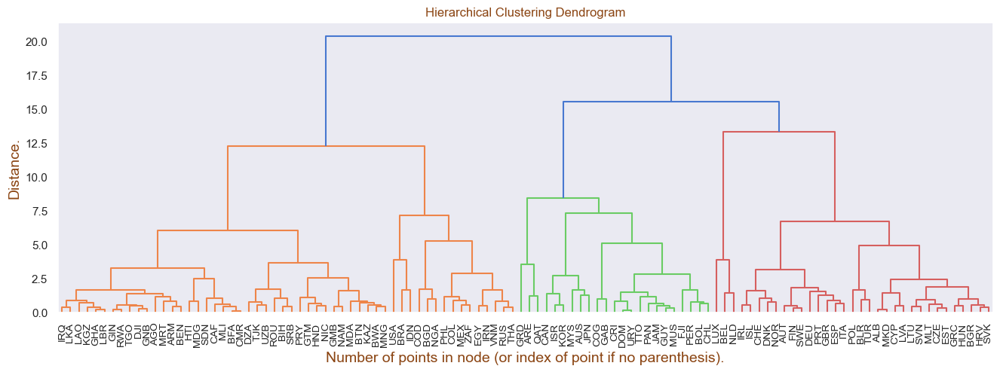

In [770]:
fig, ax = plt.subplots(1, 1, figsize=(16, 5))

_ = dendrogram(Z, ax=ax,labels=df_X_bis_proj_ACH.index)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
plt.show()

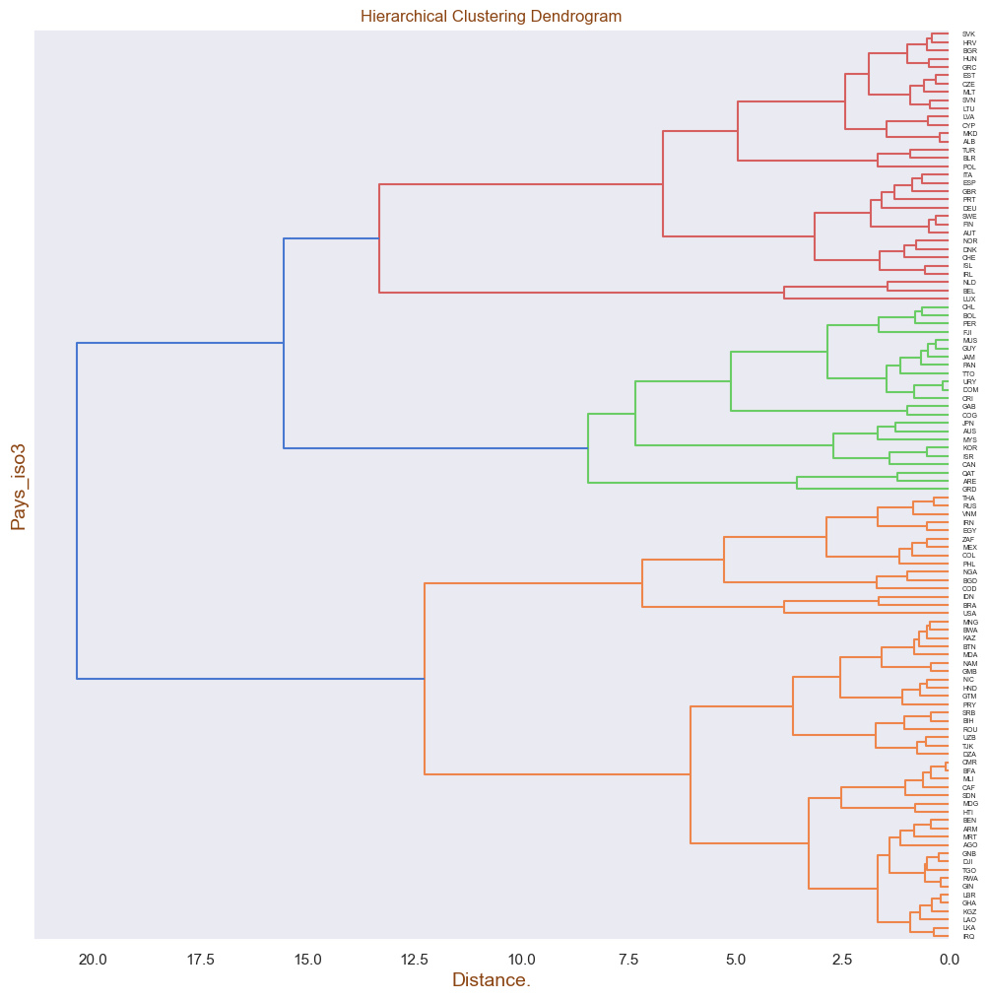

In [771]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

_ = dendrogram(Z, ax=ax,labels=df_X_bis_proj_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
plt.show()

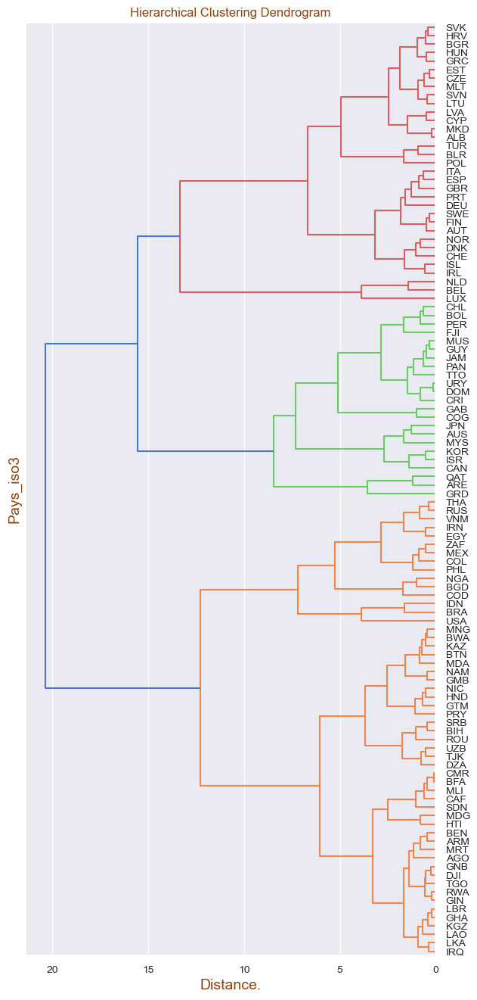

In [772]:
fig, ax = plt.subplots(1, 1, figsize=(7, 16))

_ = dendrogram(Z, ax=ax,labels=df_X_bis_proj_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

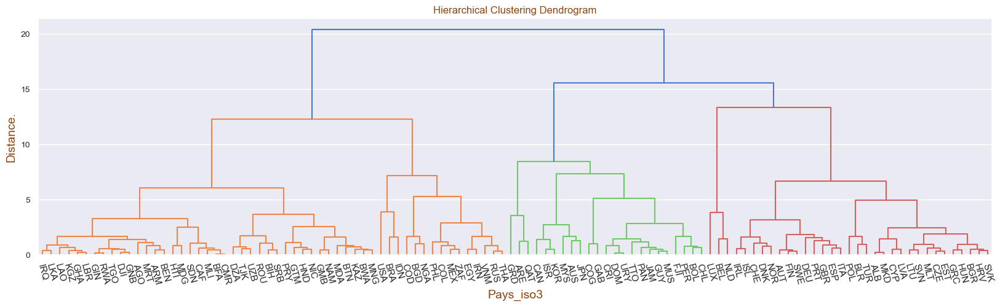

In [773]:
fig, ax = plt.subplots(1, 1, figsize=(20, 5))

_ = dendrogram(Z, ax=ax,labels=df_X_bis_proj_ACH.index, orientation = "top")

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Pays_iso3")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=11,labelrotation =-75)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

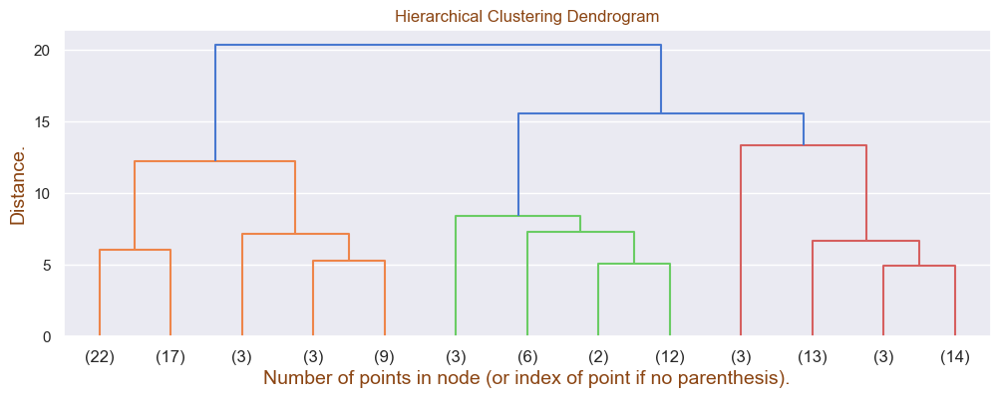

In [774]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=13, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=13 nombre au dessus duquel les distances intraclasse sont inférieur à 5

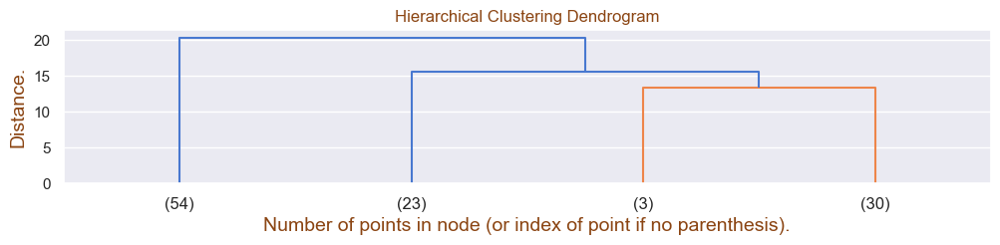

In [775]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 2))

_ = dendrogram(Z, p=4, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=4 nombre de clusters minimum pour voir apparaitre le groupe de 3 : BEL, NLD(Pays-Bas), LUX (Niveau de vie elevé/Commerce avec Fr)  
Emergence rapide de ce groupe témoignant de sa distinction des autes pays.

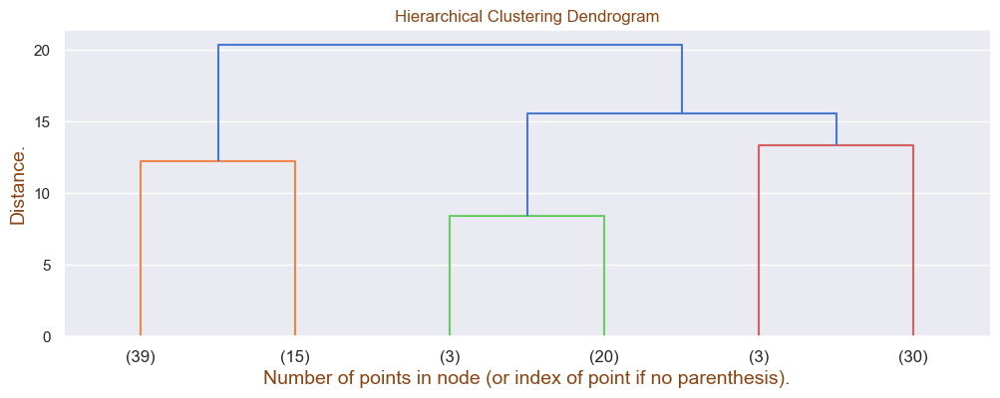

In [776]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de 3 : QAT, ARE, GRD(Grenade)

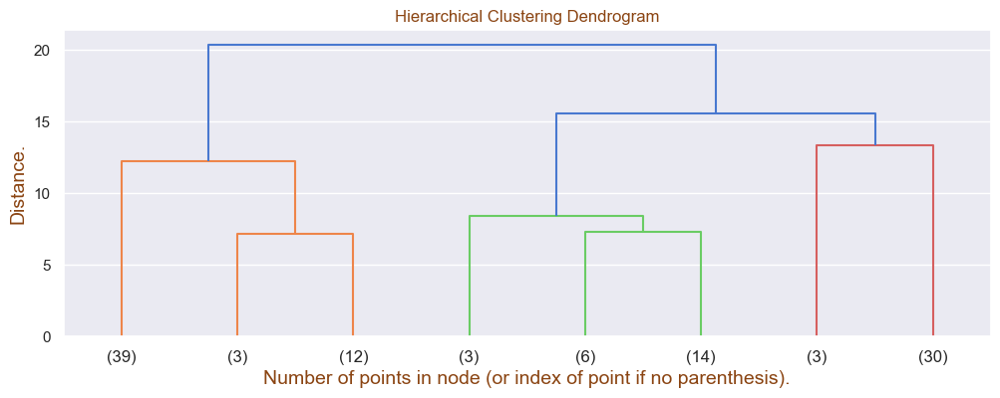

In [777]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=8, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=8 nombre de clusters minimum pour voir apparaitre le groupe de 3 : IDN(Indonésie), BRA, USA (poids de la population)

**AUTRE METHODE DE VISUALISATION (par le Nombre de noeuds) :**  
Ici j'ai des clusters qui ne sont issus que d'un noeud et d'autres de 2 noeuds.  
Je peux voir ce que ça peut donner si je prends ceux issu de 2 noeuds

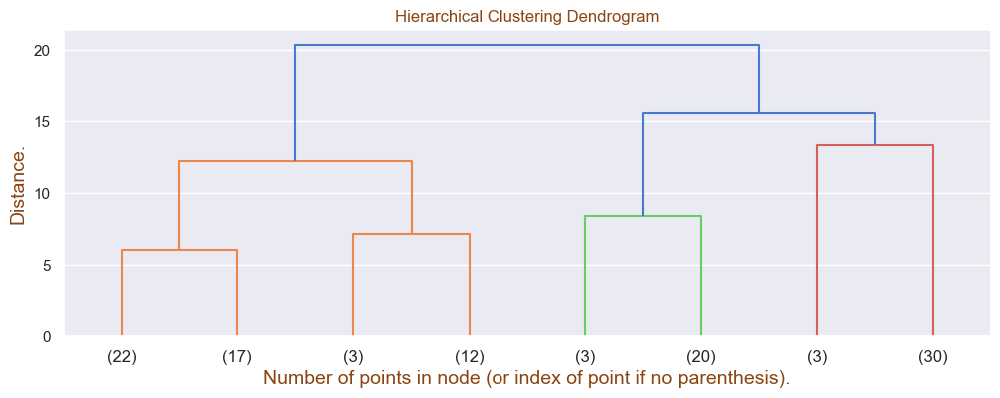

In [778]:
#  les arguments p=2, truncate_mode="level"signifient que l'on ne va afficher que les clusters issus de 2 noeuds.

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=2, truncate_mode="level", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**CHOIX DE NBRE DE CLUSTERS**  
A la lecture des Dendrogrammes, un nombre de clusters entre 6 et 8 semble pertinent.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.3 - Evaluation du nbre de cluster pertinent : Méthode de la silhouette : </h4>
</div>

Méthode du coude
Pertinent avec ACH ? ➤ ❌NON Pas directement.

Pourquoi ?

Le coude est basé sur l’inertie intra-cluster (minimisée dans K-means).

L’ACH ne repose pas sur l’inertie mais sur une distance de fusion (liaison simple, complète, moyenne…).

Le "coude" peut parfois être utilisé sur un graphe des distances de fusion (dans le dendrogramme), mais ce n’est pas la méthode standard.

Nombre de clusters : 2 — Score silhouette moyen : 0.28


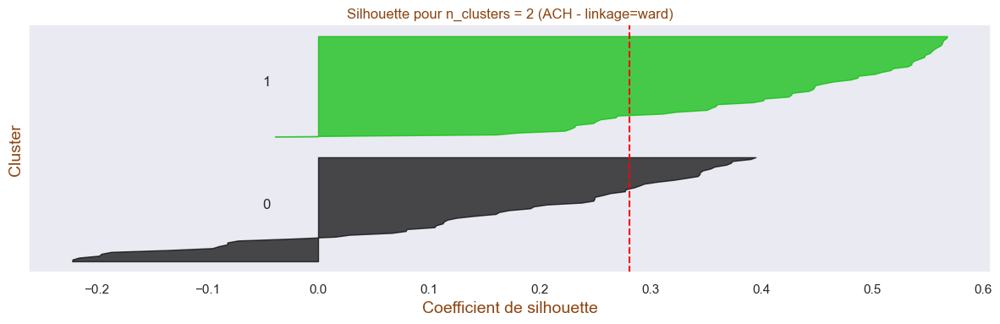

Nombre de clusters : 3 — Score silhouette moyen : 0.32


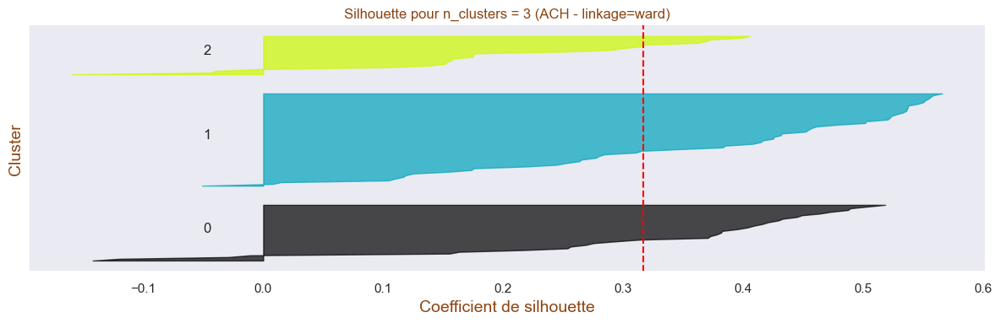

Nombre de clusters : 4 — Score silhouette moyen : 0.33


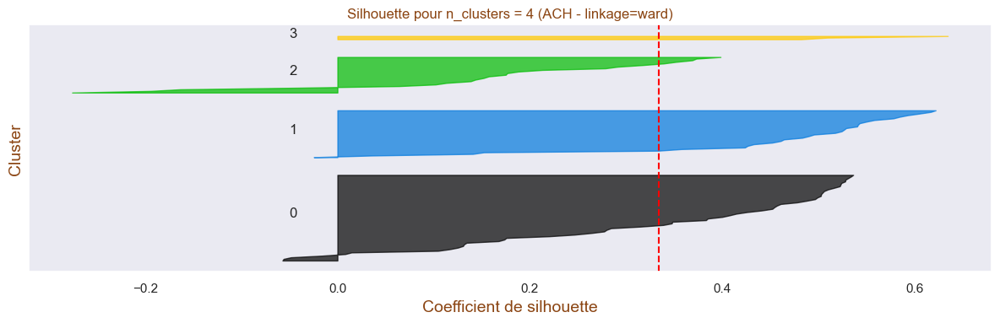

Nombre de clusters : 5 — Score silhouette moyen : 0.35


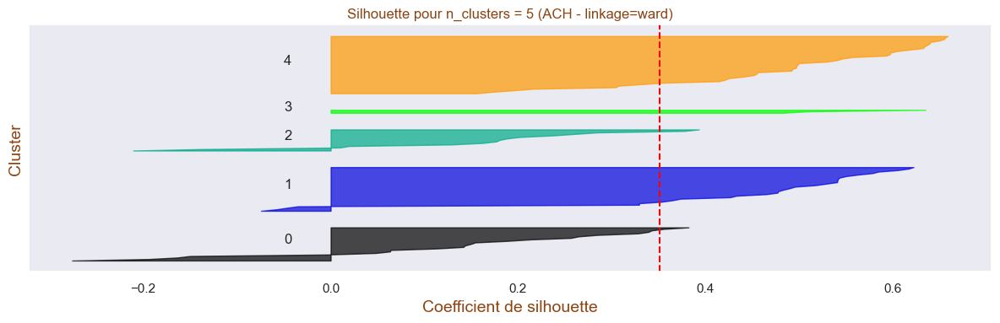

Nombre de clusters : 6 — Score silhouette moyen : 0.36


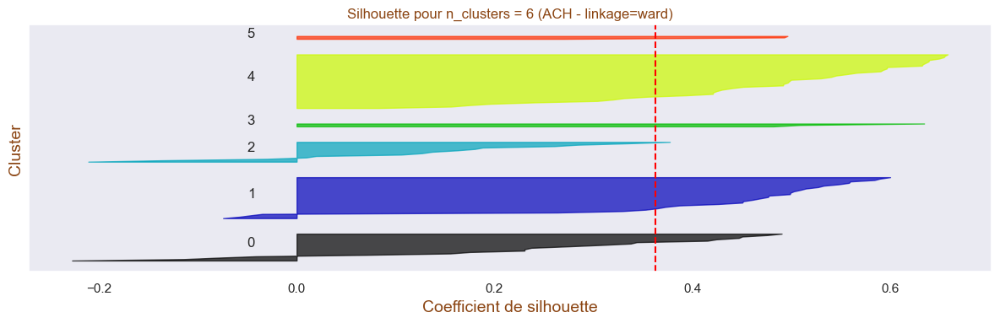

Nombre de clusters : 7 — Score silhouette moyen : 0.34


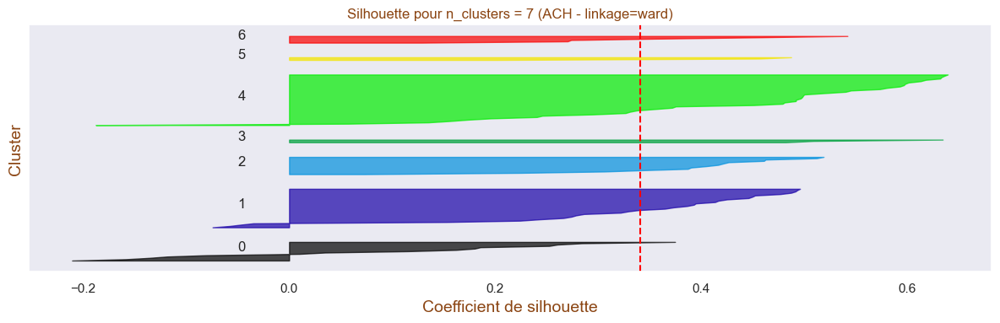

Nombre de clusters : 8 — Score silhouette moyen : 0.34


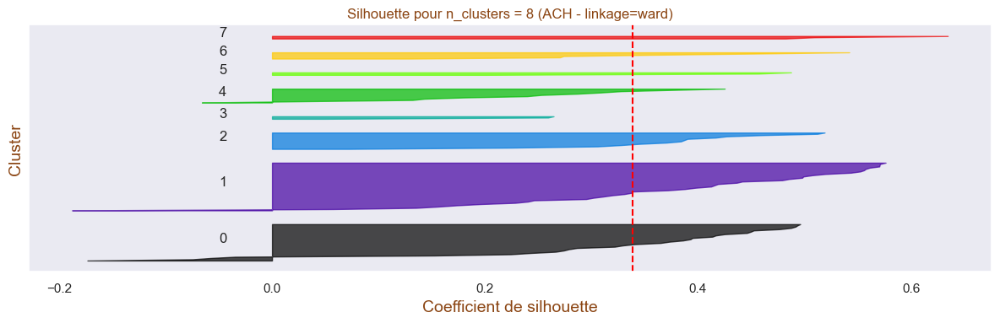

Nombre de clusters : 9 — Score silhouette moyen : 0.32


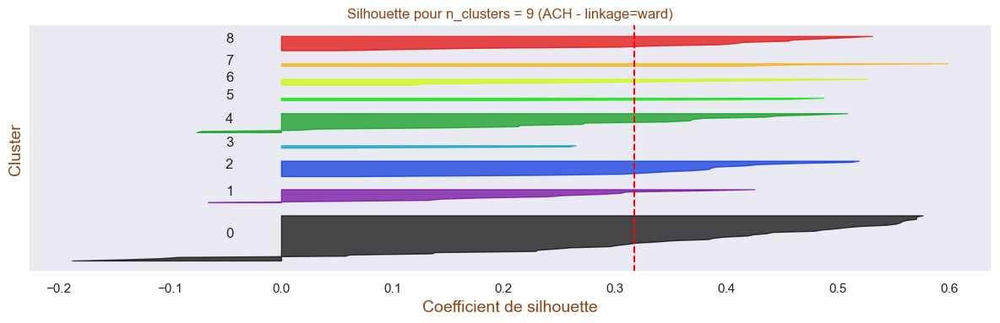

Nombre de clusters : 10 — Score silhouette moyen : 0.28


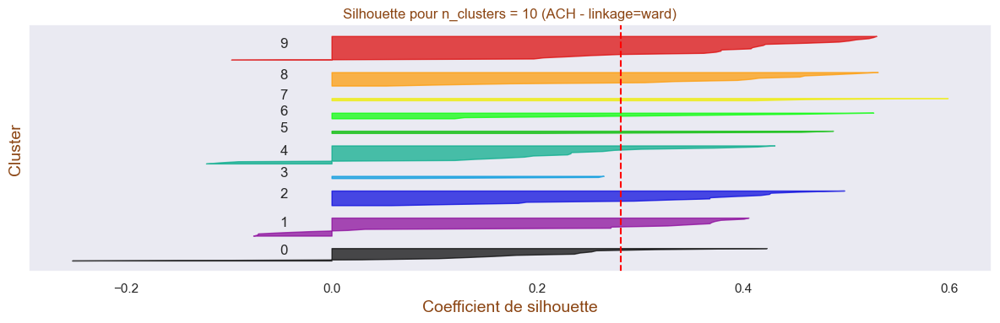

Nombre de clusters : 11 — Score silhouette moyen : 0.29


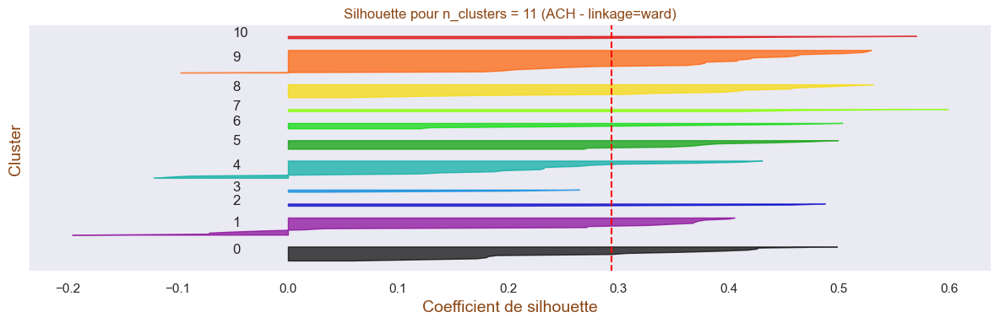

Nombre de clusters : 12 — Score silhouette moyen : 0.31


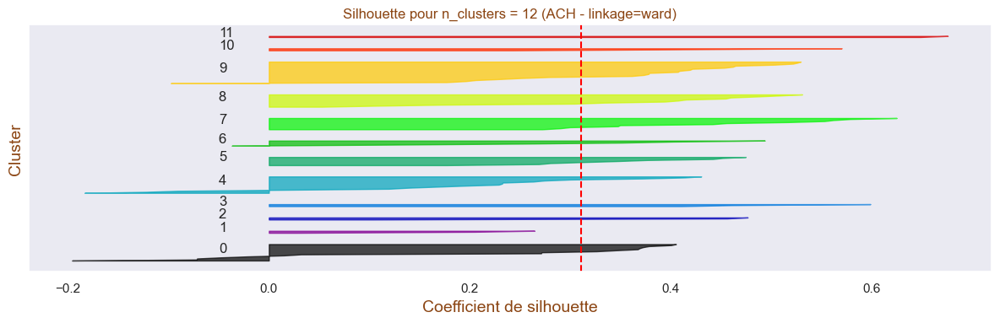

Nombre de clusters : 13 — Score silhouette moyen : 0.33


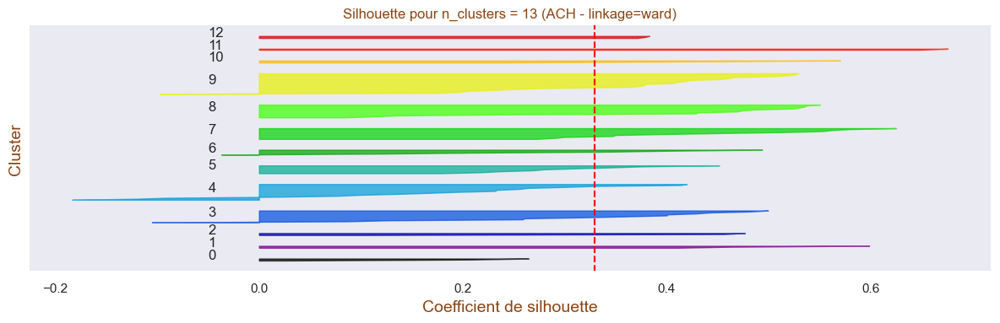

Nombre de clusters : 14 — Score silhouette moyen : 0.33


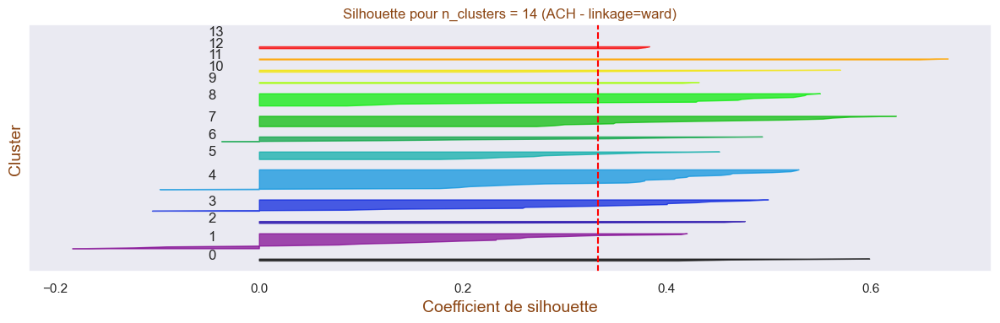

In [779]:
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import AgglomerativeClustering
#import matplotlib.pyplot as plt
#import numpy as np

X_temp = df_X_bis_proj_selec_PCA.copy()
range_nb_clust = range(2, 15)  # Par exemple de 2 à 14 clusters

for nb_clust in range_nb_clust:
    fig, ax = plt.subplots(figsize=(12, 4))

    # ✅ Utilisation de l'ACH (et non KMeans)
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    cluster_labels = cah.fit_predict(X_temp)

    # Score de silhouette moyen
    silhouette_avg = silhouette_score(X_temp, cluster_labels)
    print(f"Nombre de clusters : {nb_clust} — Score silhouette moyen : {silhouette_avg:.2f}")

    # Score silhouette par point
    sample_silhouette_values = silhouette_samples(X_temp, cluster_labels)

    y_lower = 10
    for i in range(nb_clust):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / nb_clust)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax.set_title(f"Silhouette pour n_clusters = {nb_clust} (ACH - linkage=ward)")
    ax.set_xlabel("Coefficient de silhouette")
    ax.set_ylabel("Cluster")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax.set_yticks([])
    plt.tight_layout()
    plt.show()


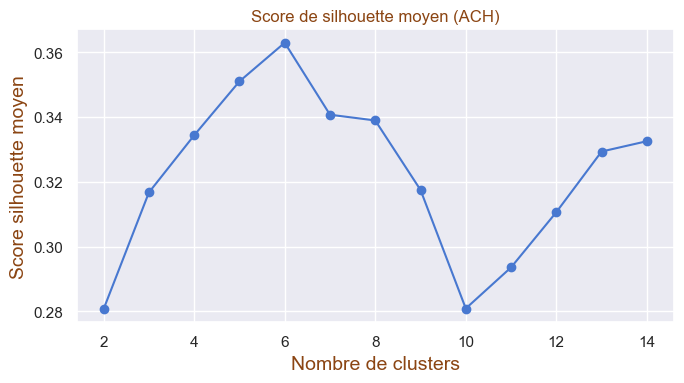

In [780]:
#graph de silhouette scores selon nombre de cluster

silhouette_scores = []

for nb_clust in range_nb_clust:
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    labels = cah.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage
plt.figure(figsize=(7, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (ACH)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


**K=6** permet d'avoir le meilleur score de silhouettte,  ce qui est cohérent avec le dendrogramme.   
C'est aussi un nombre raisonnable et analysable de clusters.

Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

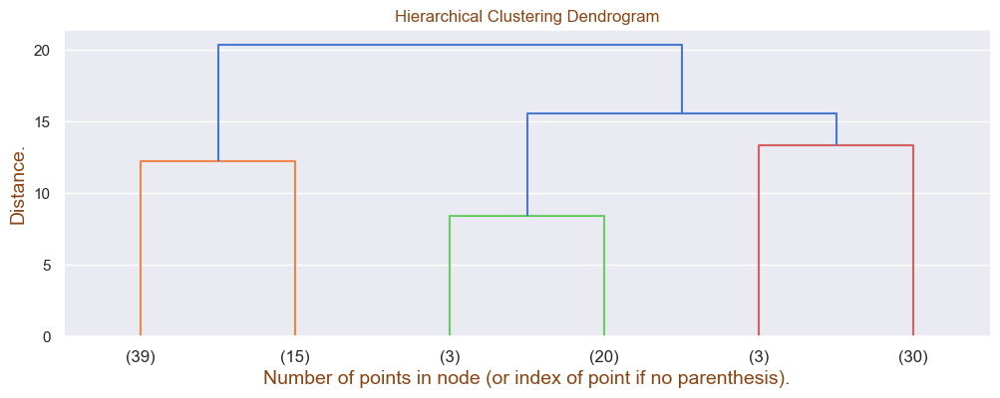

In [781]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

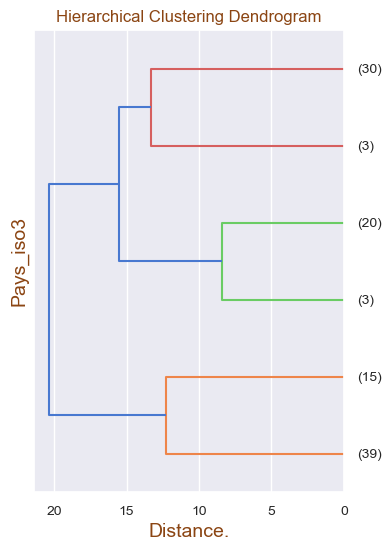

In [782]:
fig, ax = plt.subplots(1, 1, figsize=(4,6))

_ = dendrogram(Z, ax=ax,labels=df_X_bis_proj_ACH.index, orientation = "left", p=6, truncate_mode="lastp" )

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.4 - Clusters CAH : </h4>
</div>

##### **CLUSTERS CAH**

Pour définir les clusters, on peut utiliser `scipy` ou `scikit-learn`.

<u>Scikit-Learn</u>

On instancie un estimateur : 

In [783]:
n_clusters =6

In [784]:
cah = AgglomerativeClustering(n_clusters=n_clusters, linkage="ward")

On entraine l'estimateur : 

In [785]:
df_X_bis_proj_ACH.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079


In [786]:
cah.fit(df_X_bis_proj_ACH)

AgglomerativeClustering(n_clusters=6)

Regardons nos clusters : 

In [787]:
cah.labels_

array([4, 1, 5, 4, 0, 1, 3, 4, 4, 2, 1, 4, 1, 0, 2, 4, 4, 4, 0, 1, 0, 4,
       2, 0, 2, 0, 1, 1, 1, 4, 1, 0, 4, 2, 1, 1, 1, 0, 0, 1, 4, 4, 4, 4,
       1, 5, 4, 0, 4, 1, 4, 1, 2, 1, 2, 4, 1, 0, 1, 0, 0, 4, 4, 0, 4, 4,
       4, 1, 3, 1, 4, 4, 2, 1, 4, 1, 4, 4, 0, 0, 4, 2, 4, 3, 1, 0, 0, 2,
       1, 1, 4, 5, 4, 2, 4, 4, 4, 1, 1, 1, 4, 2, 4, 0, 1, 0, 2, 4, 2, 2],
      dtype=int64)

-- **ATTENTION** --  
Ici, `0`,`1`...`7` est à considérer comme une variable catégorielle cardinale. Il n'y a pas d'ordre entre les clusters.

Le cluster `0` n'est pas *supérieur* au cluster `1` par exemple. Considérez que c'est plus un *id* qu'une *valeur*. 

Pour être plus clair, nous allons utiliser des lettres plutôt que des nombres: 


Ajoutons nos labels à `df_X_bis_proj_ACH`

In [788]:
df_X_bis_proj_ACH["labels"] = cah.labels_
df_X_bis_proj_ACH.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


Observons nos clusters: 

In [789]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_bis_proj_ACH["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

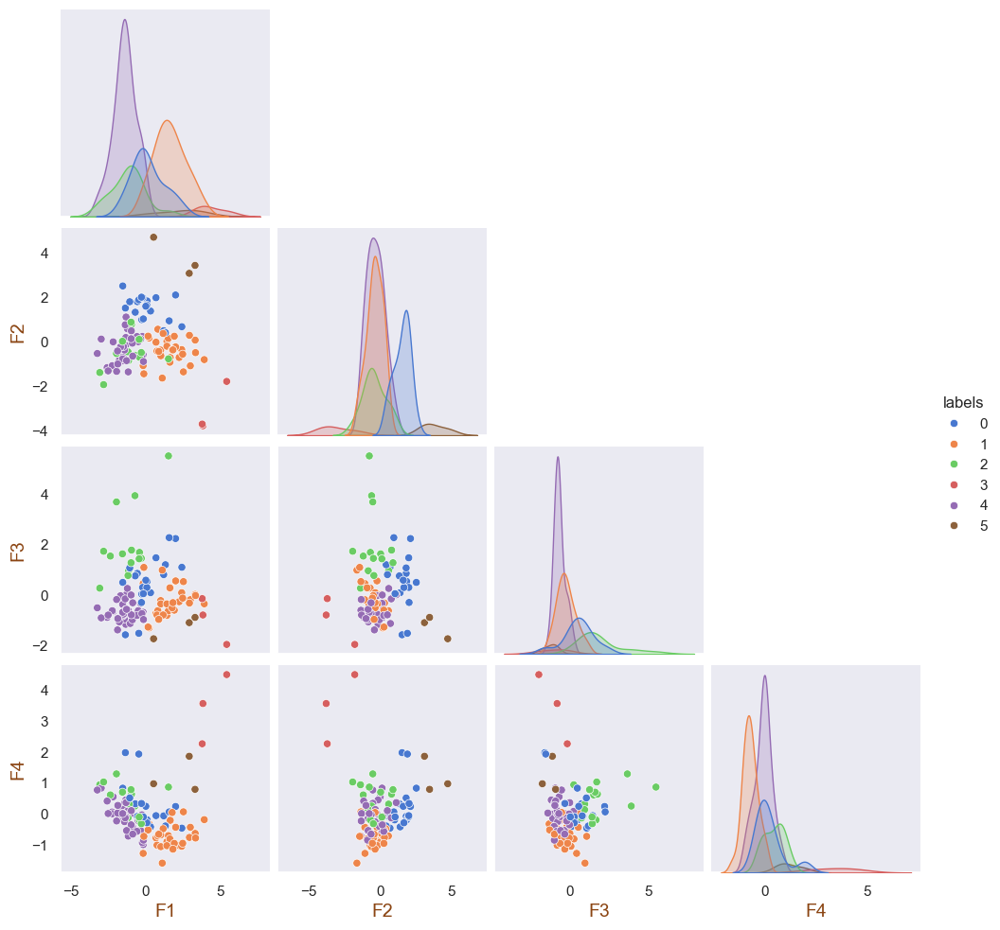

In [790]:
sns.pairplot(df_X_bis_proj_ACH, 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

In [791]:
#le Dataframe des cluster calculé par la moyenne
df_X_bis_proj_ACH_grouped = (df_X_bis_proj_ACH.groupby(by=['labels'])).mean()
df_X_bis_proj_ACH_grouped.index.name = 'cluster'
display(df_X_bis_proj_ACH_grouped)

,F1,F2,F3,F4
cluster,,,,
0,0.167493,1.503782,0.539396,0.206589
1,1.646473,-0.400899,-0.239772,-0.720366
2,-1.161469,-0.434215,1.908368,0.454306
3,4.381050,-3.098643,-0.963286,3.435539
4,-1.417505,-0.346178,-0.656888,-0.083668
5,2.272500,3.753807,-1.237247,1.207011


In [792]:
df_temp =df_X_bis_proj_ACH.copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


In [793]:
df_temp_grouped = df_X_bis_proj_ACH_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,0.167493,1.503782,0.539396,0.206589
1,1.646473,-0.400899,-0.239772,-0.720366
2,-1.161469,-0.434215,1.908368,0.454306
3,4.381050,-3.098643,-0.963286,3.435539
4,-1.417505,-0.346178,-0.656888,-0.083668


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.5 - Visualisation  : </h4>
</div>

In [794]:
df_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1


In [795]:
df_temp_grouped.head(2)

,F1,F2,F3,F4
cluster,,,,
0,0.167493,1.503782,0.539396,0.206589
1,1.646473,-0.400899,-0.239772,-0.720366


In [796]:
#CA fait doublon
# df pour la visualisation
#df = df_temp
#df_means = df_temp_grouped #le df à utiliser pour les visualisations

**Liste des pays**

In [797]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AUS  , BOL  , CAN  , CHL  , COG  , CRI  , DOM  , FJI  , GAB  , GUY  , ISR  , JAM  , JPN  , KOR  , MUS  , MYS  , PAN  , PER  , TTO  , URY 



cluster 1 :
ALB  , AUT  , BGR  , BLR  , CHE  , CYP  , CZE  , DEU  , DNK  , ESP  , EST  , FIN  , GBR  , GRC  , HRV  , HUN  , IRL  , ISL  , ITA  , LTU  , LVA  , MKD  , MLT  , NOR  , POL  , PRT  , SVK  , SVN  , SWE  , TUR 



cluster 2 :
BGD  , BRA  , COD  , COL  , EGY  , IDN  , IRN  , MEX  , NGA  , PHL  , RUS  , THA  , USA  , VNM  , ZAF 



cluster 3 :
BEL  , LUX  , NLD 



cluster 4 :
AGO  , ARM  , BEN  , BFA  , BIH  , BTN  , BWA  , CAF  , CMR  , DJI  , DZA  , GHA  , GIN  , GMB  , GNB  , GTM  , HND  , HTI  , IRQ  , KAZ  , KGZ  , LAO  , LBR  , LKA  , MDA  , MDG  , MLI  , MNG  , MRT  , NAM  , NIC  , PRY  , ROU  , RWA  , SDN  , SRB  , TGO  , TJK  , UZB 



cluster 5 :
ARE  , GRD  , QAT 





**HEATMAP**

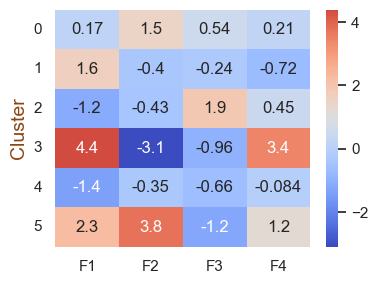

In [798]:
plt.figure(figsize=(4, 3))
sns.heatmap(data=df_X_bis_proj_ACH_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

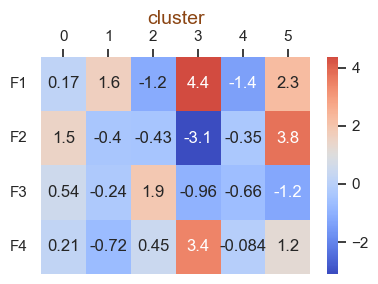

In [799]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(4, 3))

sns.heatmap(data=df_X_bis_proj_ACH_grouped.T, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('top')    # Place les ticks en haut
ax.xaxis.set_label_position('top')    # Place le label (si présent) en haut
plt.tight_layout()
plt.yticks(rotation=0)
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

cluster 3 : F1 et F4 fav   
cluster 5 : F1 et F2 fav  

secondaire :  
cluster 2 : seulement F3 (Taille du marché intéressant)  

choix de cluster intéressant :  
donc cluster 3 et 5  

**RADAR**

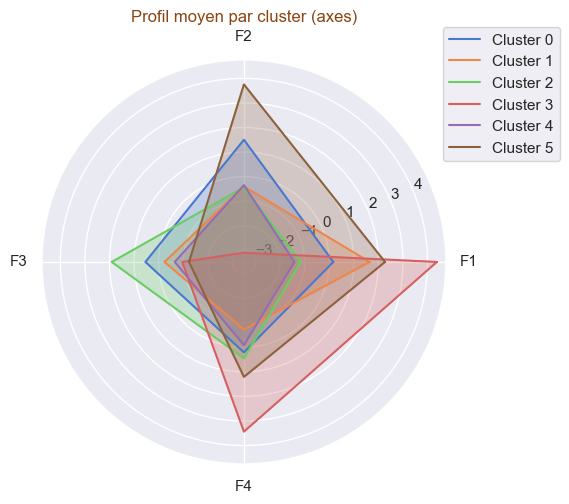

In [800]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

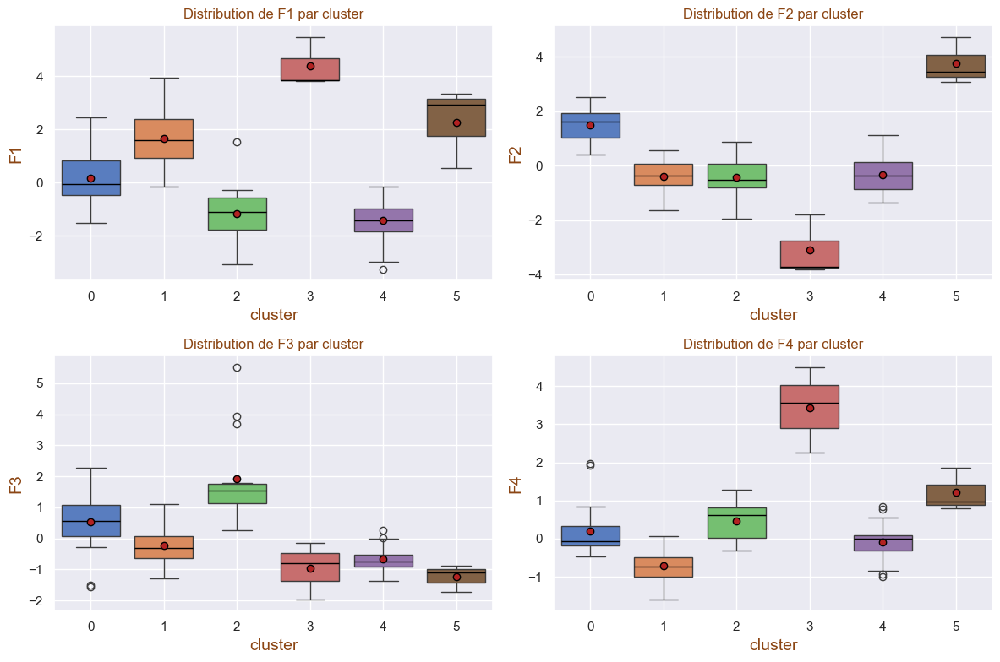

In [801]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 2
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


##### **PROJECTIONS**

In [802]:
X_proj_temp = df_temp.copy()

In [803]:
X_proj_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


In [804]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,0.167493,1.503782,0.539396,0.206589
1,1.646473,-0.400899,-0.239772,-0.720366
2,-1.161469,-0.434215,1.908368,0.454306
3,4.381050,-3.098643,-0.963286,3.435539
4,-1.417505,-0.346178,-0.656888,-0.083668
5,2.272500,3.753807,-1.237247,1.207011


In [805]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,0.167493,1.503782,0.539396,0.206589,0
1,1.646473,-0.400899,-0.239772,-0.720366,1
2,-1.161469,-0.434215,1.908368,0.454306,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,-1.417505,-0.346178,-0.656888,-0.083668,4
5,2.272500,3.753807,-1.237247,1.207011,5


Et on affiche le graphique pour F1 et F2 :

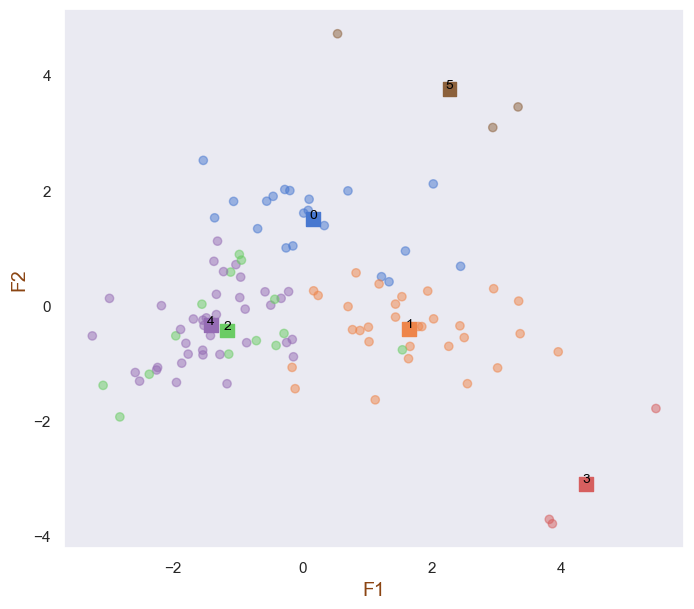

In [806]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


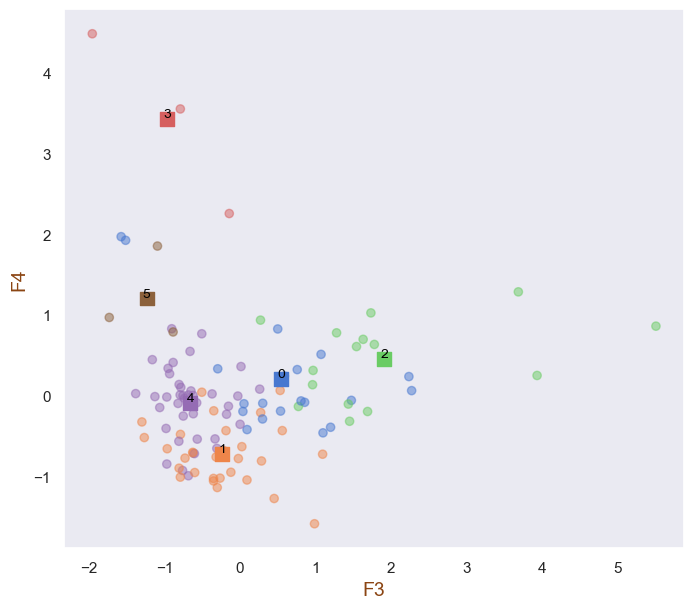

In [807]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

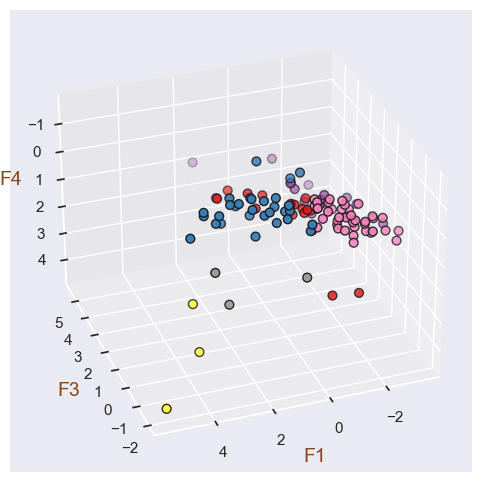

In [808]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

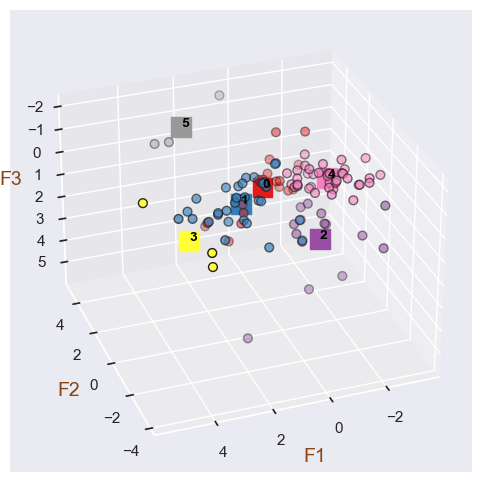

In [809]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [810]:
X_proj_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


In [811]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,0.167493,1.503782,0.539396,0.206589,0
1,1.646473,-0.400899,-0.239772,-0.720366,1
2,-1.161469,-0.434215,1.908368,0.454306,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,-1.417505,-0.346178,-0.656888,-0.083668,4


In [812]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [813]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [814]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [815]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.1.5 - Visualisation des données centrées réduites : </h4>
</div>

Le passage des données originelles centrées réduites aux données projetées est un passage d'une base orthonormée vers une base orthonormée.  
Elle est réversible (passage d'une base de 9v indépendants vers 9 vecteurs indépendants) et linéaire (puisque c'est un passage par matrice).  
Le passage dans un sens ou dans l'autre doit donc conserver les centre de gravités que sont les centroïdes.  

Mais attention si l'on calcule les centroïdes sur les données projetées mais réduites à quelques composantes principales, alors là on n'aura pas cette réversibilité. On ne pourra pas revenir en arrière à partir des centroïdes dans l'espace projetés.  

Cependant on a bien la linéarité des barycentre des points dans les données centrées réduites vers les données dans les 9 ACP,
puis dans la projection qui est une opération linéaire (mais pas réversible).

Cependant puisqu'on connait les données d'origines centrées réduites qui ont abouti à calculer les barycentres des données projetées sur nos 4 axes, 
on peut revenir en arrière à partir des pays et en calculant les barycentres.

A savori cependant que l'ACH ne s'est basée que sur nos 4 dimensions pour distinguer les clusters.  
Elle aurait peut-être pu être plus efficace en se basant sur les 9 dimensions (de la PCA ou des données centrées réduites)


ATTENTION :  
La linéarité ne concerne pas l'opération de centrage réduction.  
Le centrage est une opération affine.

Remarque :  
Lorsque l'on fait le clustering sur les données après PCA, on a perdu des informations.  
Quel est donc l'avantage de faire le clustering sur les données après PCA :  
- si les données sont volumineuses, cela permet de réduire la lourdeur du clustering (ce n'est pas le cas ici avec 120 pays)
- cela permet aussi de réduire le bruit.

Le clustering sur les données centrées réduites : 
- permet de faire le clustering sur les informations complètes
- peut êter délicat (si informations volumineuses)
- ne masque pas trop le bruit des corrélations (bien que cela dépende des qualités de l'algorithme)

Attention ne pas faire le clustering sur les données brutes :
- les variables avec des chiffres plus élevées risquent de prendre un peu surdimensionné.

In [816]:
df_X_bis_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [817]:
#Mappons df_X_bis_scaled avec nos labels
df_X_bis_scaled_ACH = df_X_bis_scaled.join(df_temp["labels"])
df_X_bis_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,4
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,4
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,0


In [818]:
df_X_bis_scaled_ACH_grouped = (df_X_bis_scaled_ACH.groupby(by=['labels'])).mean()
df_X_bis_scaled_ACH_grouped.index.name = 'cluster'
display(df_X_bis_scaled_ACH_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-1.096086,-0.251823,0.135263,0.026532,1.320654,0.096627,-0.161354,0.028070,0.372436
1,1.030935,-0.291813,-0.178671,0.657160,-0.047577,0.835695,-0.023206,0.839494,0.719800
2,-0.656173,1.967864,-0.430793,-0.368079,0.004196,-0.363901,-0.299009,0.030464,-0.968992
3,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
4,-0.066855,-0.331532,0.001413,-0.635420,-0.749627,-0.692504,-0.237188,-0.842273,-0.544899
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300


Travaillons sur des copies :

In [819]:
df_temp = df_X_bis_scaled_ACH.copy()
df_temp_grouped = df_X_bis_scaled_ACH_grouped.copy()

In [820]:
df_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,4
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1


In [821]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-1.096086,-0.251823,0.135263,0.026532,1.320654,0.096627,-0.161354,0.028070,0.372436
1,1.030935,-0.291813,-0.178671,0.657160,-0.047577,0.835695,-0.023206,0.839494,0.719800


**Liste des pays**

In [822]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AUS  , BOL  , CAN  , CHL  , COG  , CRI  , DOM  , FJI  , GAB  , GUY  , ISR  , JAM  , JPN  , KOR  , MUS  , MYS  , PAN  , PER  , TTO  , URY 



cluster 1 :
ALB  , AUT  , BGR  , BLR  , CHE  , CYP  , CZE  , DEU  , DNK  , ESP  , EST  , FIN  , GBR  , GRC  , HRV  , HUN  , IRL  , ISL  , ITA  , LTU  , LVA  , MKD  , MLT  , NOR  , POL  , PRT  , SVK  , SVN  , SWE  , TUR 



cluster 2 :
BGD  , BRA  , COD  , COL  , EGY  , IDN  , IRN  , MEX  , NGA  , PHL  , RUS  , THA  , USA  , VNM  , ZAF 



cluster 3 :
BEL  , LUX  , NLD 



cluster 4 :
AGO  , ARM  , BEN  , BFA  , BIH  , BTN  , BWA  , CAF  , CMR  , DJI  , DZA  , GHA  , GIN  , GMB  , GNB  , GTM  , HND  , HTI  , IRQ  , KAZ  , KGZ  , LAO  , LBR  , LKA  , MDA  , MDG  , MLI  , MNG  , MRT  , NAM  , NIC  , PRY  , ROU  , RWA  , SDN  , SRB  , TGO  , TJK  , UZB 



cluster 5 :
ARE  , GRD  , QAT 





**HEATMAP**

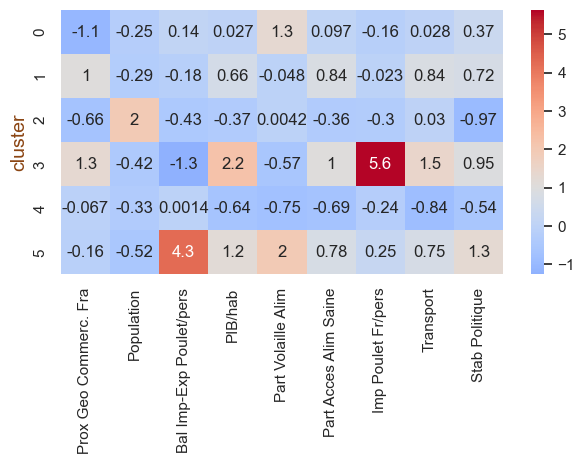

In [823]:
sns.heatmap(data=df_X_bis_scaled_ACH_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
#plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
#plt.xticks(rotation=0)
#plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

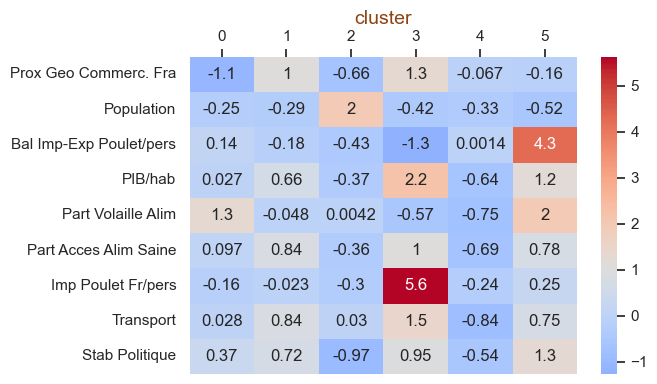

In [824]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 4))

# Heatmap
sns.heatmap(data=df_X_bis_scaled_ACH_grouped.T, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('top')    # Place les ticks en haut
ax.xaxis.set_label_position('top')    # Place le label (si présent) en haut
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

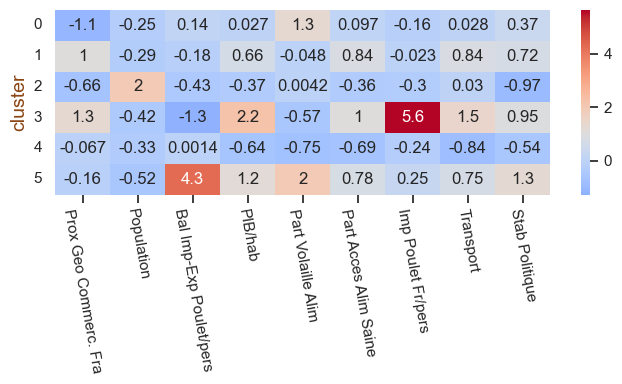

In [825]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 4))

# Heatmap
sns.heatmap(data=df_X_bis_scaled_ACH_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('bottom')    # Place les ticks en haut
ax.xaxis.set_label_position('bottom')    # Place le label (si présent) en haut
plt.yticks(rotation=0)
plt.xticks(rotation=-80)
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

En effet le cluster 3 et 5 semblent être le splus intéressants, avec un peu après le cluster 1.

cluster 3 : point fort : Prox Géo, PIB/hab, Alim saine, Import de Poulet Francais, Transport, Stab poilitique  
Cluster 5 : Bal Imp-Exp Poulet international, PIB/hab, Consommation de VOlaille, Stabilité Politique.

**RADAR**

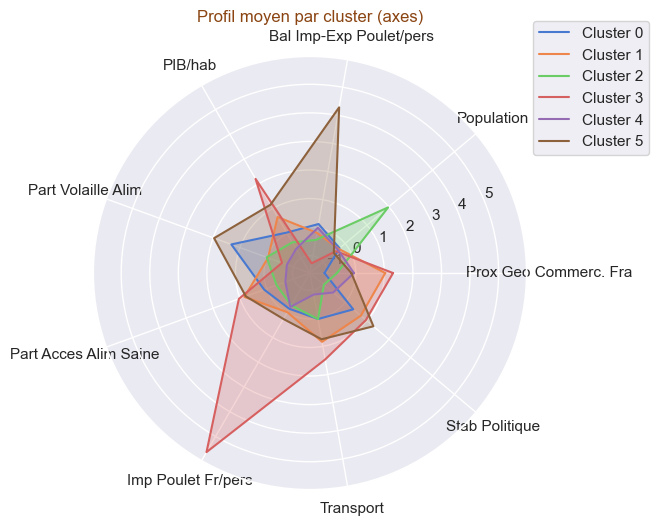

In [826]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_X_bis_scaled_ACH_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

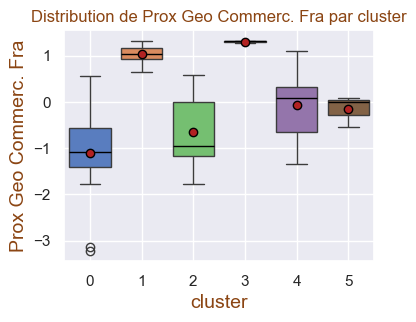

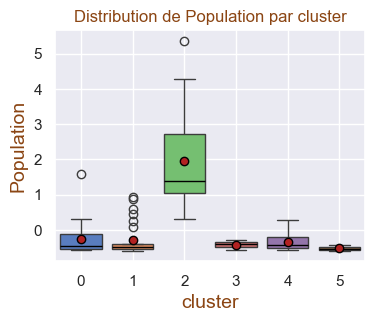

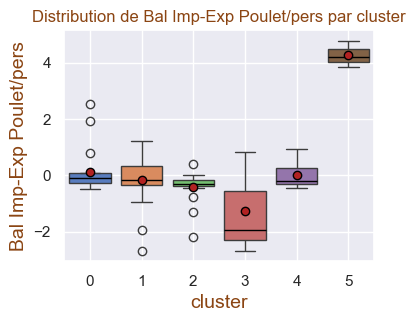

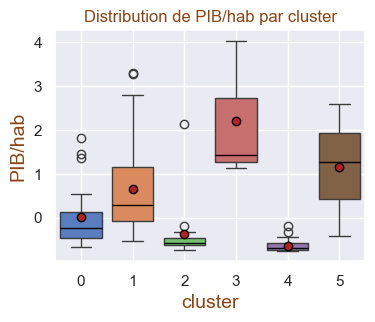

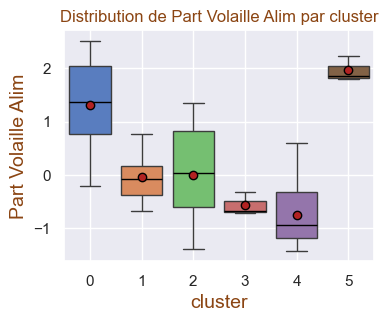

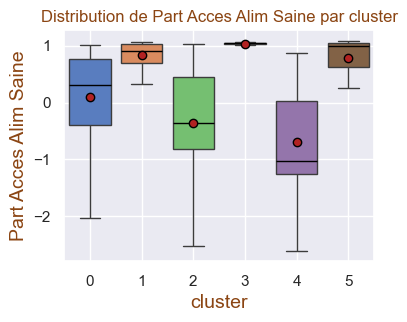

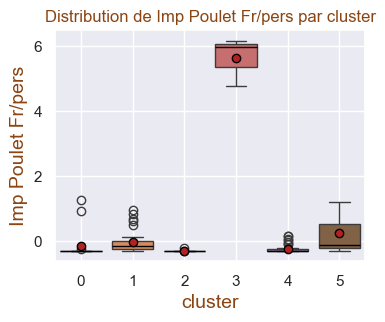

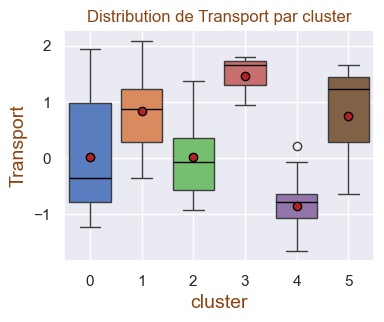

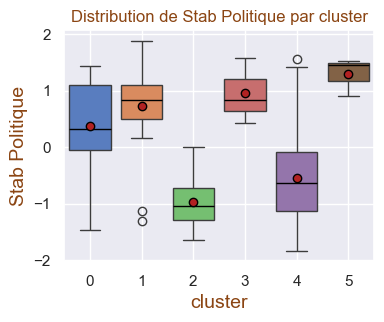

In [827]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_X_bis_scaled_ACH,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

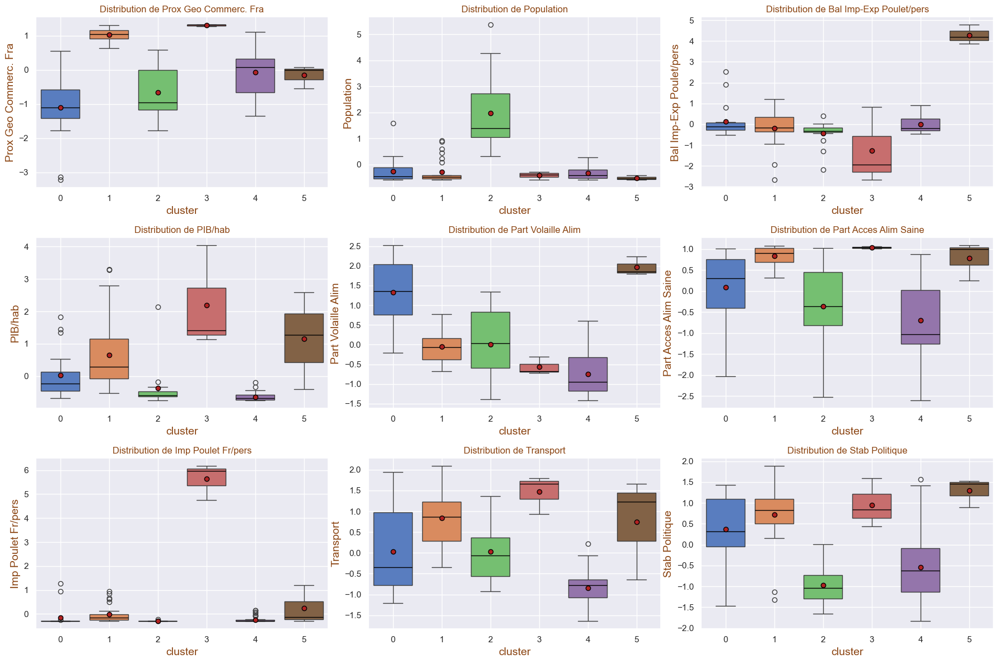

In [828]:
import matplotlib.pyplot as plt
import seaborn as sns

# Paramètres de la grille
n_rows, n_cols = 3, 3
variables = df_temp.columns.drop("labels", errors='ignore')[:n_rows * n_cols]  # Max 9 variables
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 12))  # Taille ajustée à la grille

# Aplatir les axes pour un accès direct
axes = axes.flatten()

# Génération des boxplots
for i, col in enumerate(variables):
    sns.boxplot(
        data=df_X_bis_scaled_ACH,
        x='labels',
        y=col,
        hue='labels',
        ax=axes[i],
        medianprops={'color': "black"},
        meanprops={'marker': 'o', 'markeredgecolor': 'black', 'markerfacecolor': 'firebrick'},
        showmeans=True,
        palette=palette_fixe_cluster_labels,
        hue_order=Ordre_cluster_labels,
        legend=False
    )
    axes[i].set_title(f"Distribution de {col}")
    axes[i].set_xlabel("cluster")
    axes[i].grid(True)

# Supprimer les sous-graphiques vides s’il y en a
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

In [522]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import KMeans

##### DATA :

In [523]:
df_X_bis_proj_selec_PCA.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079


In [524]:
df_X_bis_proj_KM=df_X_bis_proj_selec_PCA.copy(deep=True)
df_X_bis_proj_KM.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335
ALB,0.242622,0.174124,-1.299509,-0.323342
ARE,2.942311,3.091661,-1.093631,1.857214
ARM,-1.330664,-0.157751,-1.161689,0.448735
AUS,2.022319,2.112283,2.235469,0.239079


In [525]:
df_X_bis_proj_KM.shape

(110, 4)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [526]:
n_clusters=6

In [527]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [528]:
kmeans.fit(df_X_bis_proj_KM)

KMeans(n_clusters=6)

On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [529]:
kmeans.inertia_

238.36161808989797

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

Text(0.5, 1.0, 'Méthode du coude- Inertie intra-classe')

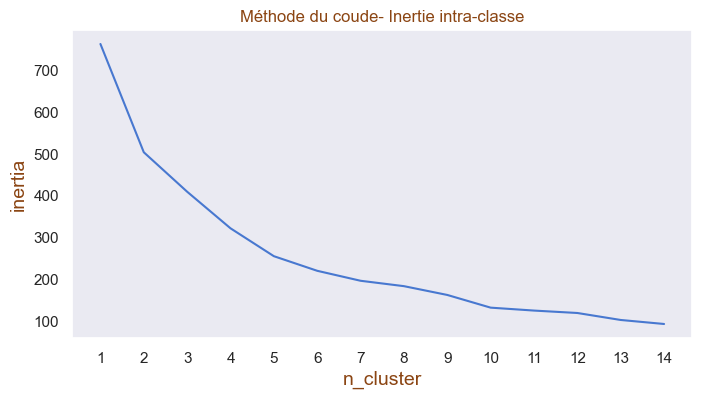

In [691]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 15)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_bis_proj_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(8,4))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)
plt.xticks(k_list)
plt.title("Méthode du coude- Inertie intra-classe")

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
Le résultat est relativement variable : 2, 3? 4, 5, 6...

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2.3bis - Methode de la silhouette sur le K-means </h4>
</div>

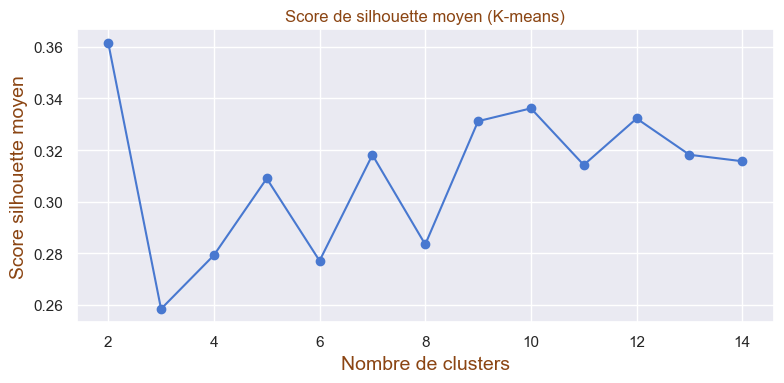

In [546]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_bis_proj_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 15)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
Les scores ne sont tous pas très élevé et compris entre 0.25 et 0.5 donnnées moyennemnt structurées.  
En croisant à la fois la méthode du coude et la méthode de la silhouette, on pourrait s'orienter vers un nombre de cluster à 5 (raisonnable).

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.2one - K-means Test à 2 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [703]:
n_clusters=2

In [704]:
df_X_bis_proj_KM_N_temp =df_X_bis_proj_KM.copy()

In [705]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_bis_proj_KM_N_temp  )

KMeans(n_clusters=2)

Voici les clusters : 

In [706]:
kmeans.labels_

array([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0,
       0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0,
       1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0])

In [707]:
pd.Series(kmeans.labels_).value_counts()

0    72
1    38
Name: count, dtype: int64

Ajoutons nos labels à `df_X_bis_proj_KM_N_temp  `

In [708]:
df_X_bis_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_bis_proj_KM_N_temp  

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0
ARE,2.942311,3.091661,-1.093631,1.857214,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,0
AUS,2.022319,2.112283,2.235469,0.239079,1
...,...,...,...,...,...
URY,-0.147778,1.034746,0.052218,-0.097757,0
USA,1.544695,-0.769873,5.506464,0.864181,1
UZB,-0.862694,-0.646368,-0.307510,-0.651443,0


Affichons cela de façon graphique :

In [709]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_bis_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

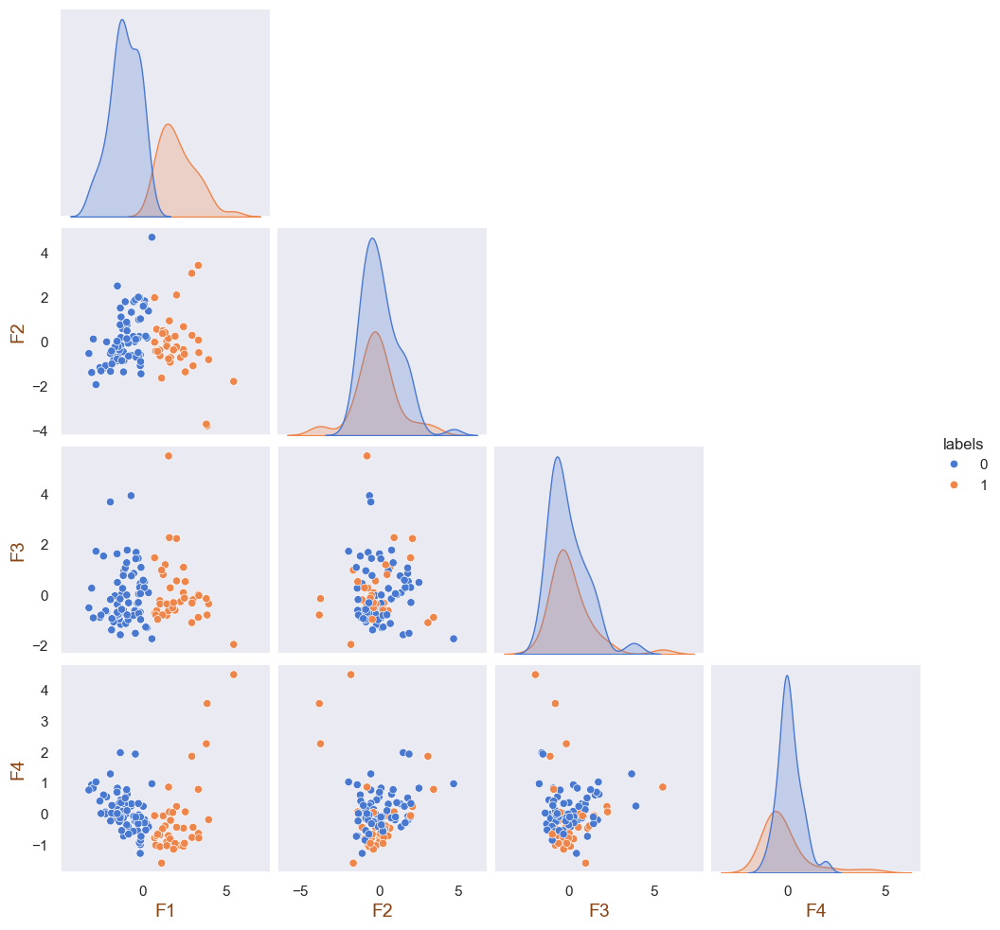

In [710]:
sns.pairplot(df_X_bis_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2one.2 - Interprétation: </h4>
</div>

In [711]:
df_X_bis_proj_KM_N_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0


CENTRE DE GRAVITE :

In [712]:
df_X_bis_proj_KM_N_temp_grouped = (df_X_bis_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_proj_KM_N_temp_grouped)

,F1,F2,F3,F4
cluster,,,,
0,-1.104685,0.094687,-0.049314,0.078015
1,2.093088,-0.179407,0.093437,-0.147818


LES CENTROIDES :

In [713]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-1.1046853 ,  0.09468696, -0.04931413,  0.07801525],
       [ 2.09308793, -0.17940687,  0.09343731, -0.14781838]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [714]:
df_temp = df_X_bis_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0
ARE,2.942311,3.091661,-1.093631,1.857214,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,0
AUS,2.022319,2.112283,2.235469,0.239079,1


In [715]:
df_temp_grouped =df_X_bis_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,-1.104685,0.094687,-0.049314,0.078015
1,2.093088,-0.179407,0.093437,-0.147818


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2one.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [716]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  , ALB  , ARM  , BEN  , BFA  , BGD  , BIH  , BLR  , BOL  , BRA  , BTN  , BWA  , CAF  , CHL  , CMR  , COD  , COG  , COL  , CRI  , DJI  , DOM  , DZA  , EGY  , FJI  , GAB  , GHA  , GIN  , GMB  , GNB  , GRD  , GTM  , GUY  , HND  , HTI  , IDN  , IRN  , IRQ  , JAM  , KAZ  , KGZ  , LAO  , LBR  , LKA  , MDA  , MDG  , MEX  , MKD  , MLI  , MNG  , MRT  , MUS  , NAM  , NGA  , NIC  , PAN  , PER  , PHL  , PRY  , ROU  , RUS  , RWA  , SDN  , SRB  , TGO  , THA  , TJK  , TTO  , TUR  , URY  , UZB  , VNM  , ZAF 



cluster 1 :
ARE  , AUS  , AUT  , BEL  , BGR  , CAN  , CHE  , CYP  , CZE  , DEU  , DNK  , ESP  , EST  , FIN  , GBR  , GRC  , HRV  , HUN  , IRL  , ISL  , ISR  , ITA  , JPN  , KOR  , LTU  , LUX  , LVA  , MLT  , MYS  , NLD  , NOR  , POL  , PRT  , QAT  , SVK  , SVN  , SWE  , USA 





**HEATMAP**

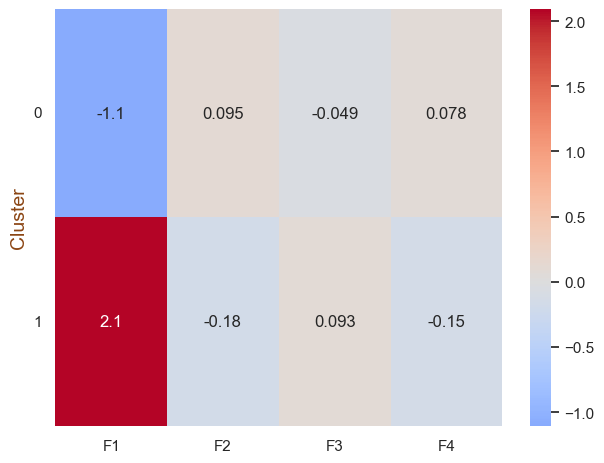

In [717]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

cluster 2 : F1 et F4 fav   
Pour les autres c'est moins clair

**RADAR**

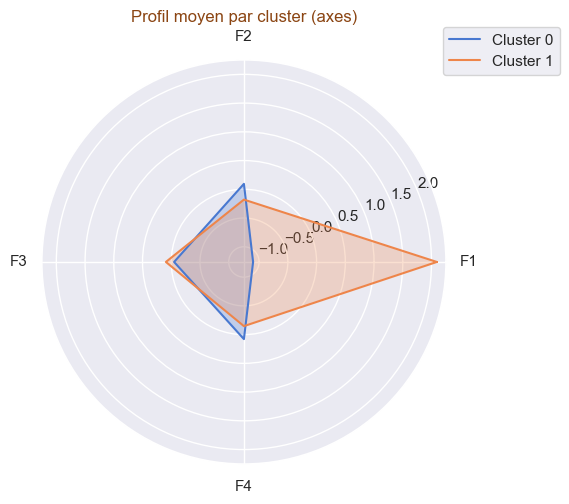

In [718]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

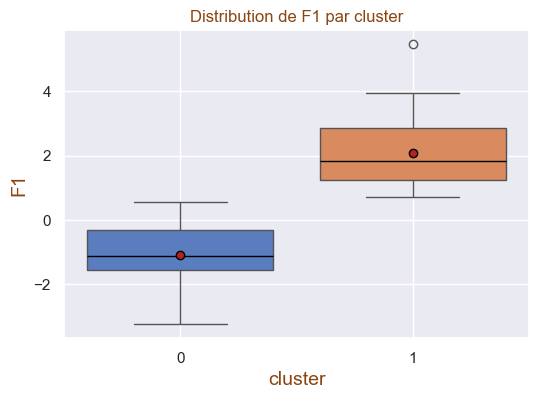

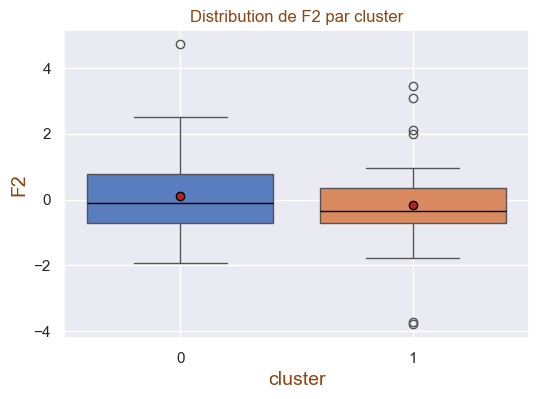

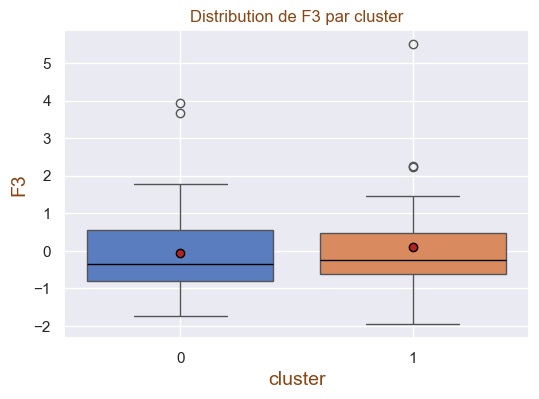

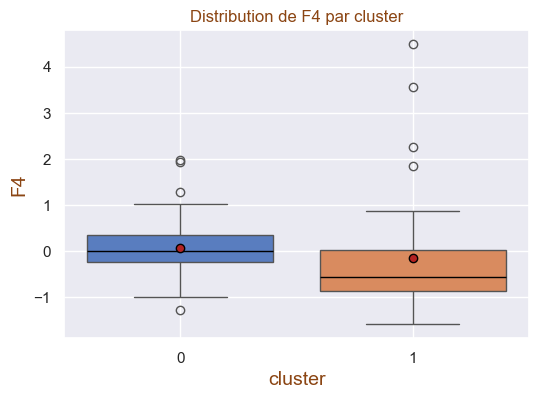

In [719]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

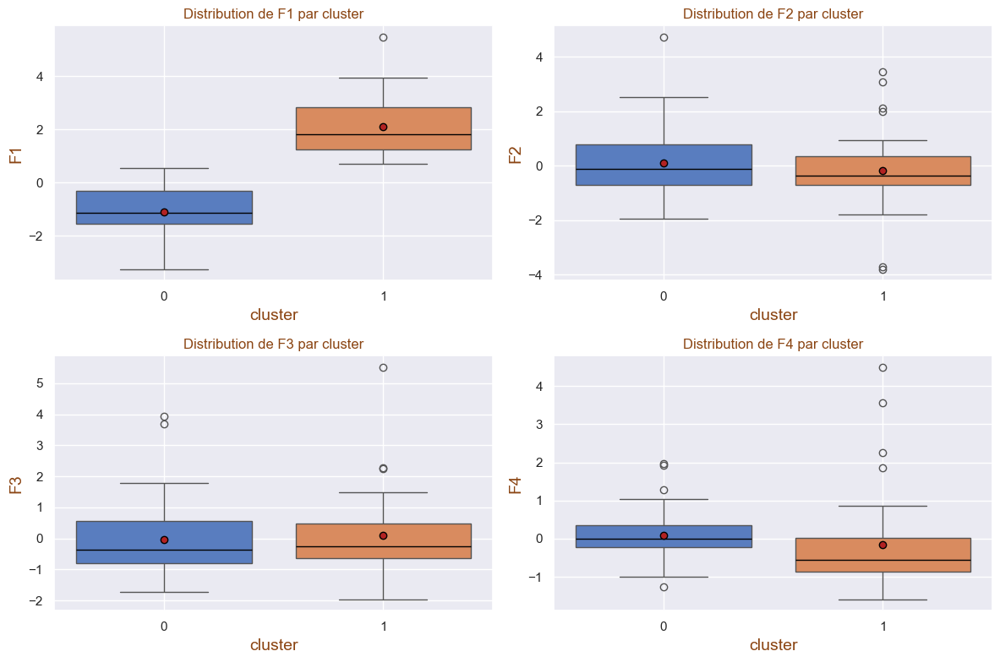

In [720]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 2
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [721]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0


In [722]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,-1.104685,0.094687,-0.049314,0.078015
1,2.093088,-0.179407,0.093437,-0.147818


In [723]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,-1.104685,0.094687,-0.049314,0.078015,0
1,2.093088,-0.179407,0.093437,-0.147818,1


Et on affiche le graphique pour F1 et F2 :

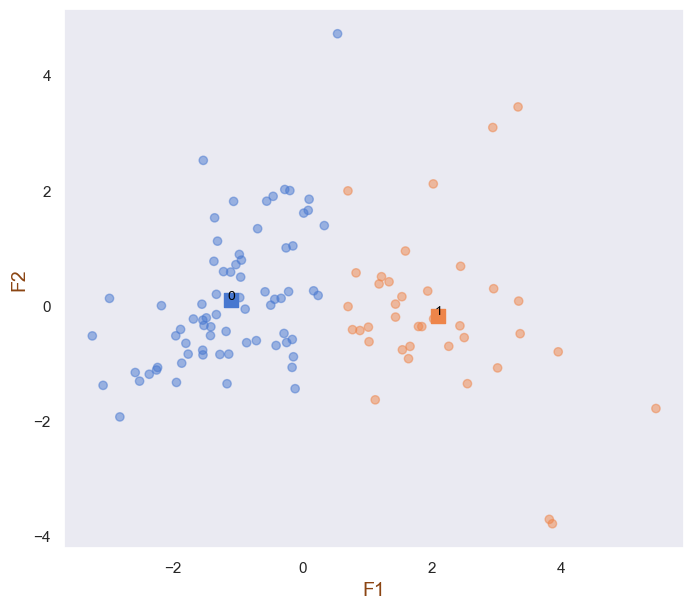

In [724]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


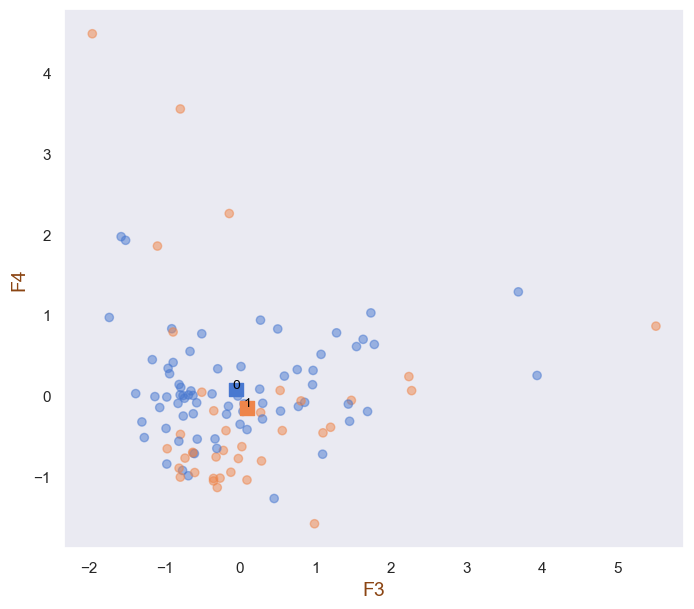

In [725]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

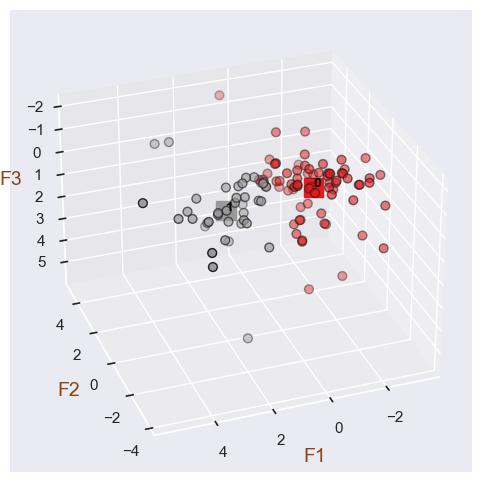

In [726]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [727]:
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0


In [728]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,-1.104685,0.094687,-0.049314,0.078015,0
1,2.093088,-0.179407,0.093437,-0.147818,1


In [729]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [730]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2one.3 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 3bis.1.5

In [731]:
df_X_bis_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [732]:
#Mappons df_X_bis_scaled avec nos labels
df_X_bis_scaled_KM_N_temp = df_X_bis_scaled.join(df_temp["labels"])
df_X_bis_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,0
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


In [733]:
df_X_bis_scaled_KM_N_temp_grouped = (df_X_bis_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.331432,0.049419,0.036828,-0.548604,-0.118445,-0.464690,-0.220472,-0.595857,-0.446913
1,0.627976,-0.093636,-0.069780,1.039460,0.224422,0.880465,0.417737,1.128992,0.846782


Travaillons sur des copies :

In [734]:
df_temp = df_X_bis_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_bis_scaled_KM_N_temp_grouped.copy()

In [735]:
df_temp.head(5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,0
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


In [736]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.331432,0.049419,0.036828,-0.548604,-0.118445,-0.464690,-0.220472,-0.595857,-0.446913
1,0.627976,-0.093636,-0.069780,1.039460,0.224422,0.880465,0.417737,1.128992,0.846782


**Liste des pays (Vérification)**

In [737]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ALB  / ARM  / BEN  / BFA  / BGD  / BIH  / BLR  / BOL  / BRA  / BTN  / BWA  / CAF  / CHL  / CMR  / COD  / COG  / COL  / CRI  / DJI  / DOM  / DZA  / EGY  / FJI  / GAB  / GHA  / GIN  / GMB  / GNB  / GRD  / GTM  / GUY  / HND  / HTI  / IDN  / IRN  / IRQ  / JAM  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MEX  / MKD  / MLI  / MNG  / MRT  / MUS  / NAM  / NGA  / NIC  / PAN  / PER  / PHL  / PRY  / ROU  / RUS  / RWA  / SDN  / SRB  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / UZB  / VNM  / ZAF 



cluster 1 :
ARE  / AUS  / AUT  / BEL  / BGR  / CAN  / CHE  / CYP  / CZE  / DEU  / DNK  / ESP  / EST  / FIN  / GBR  / GRC  / HRV  / HUN  / IRL  / ISL  / ISR  / ITA  / JPN  / KOR  / LTU  / LUX  / LVA  / MLT  / MYS  / NLD  / NOR  / POL  / PRT  / QAT  / SVK  / SVN  / SWE  / USA 





**HEATMAP**

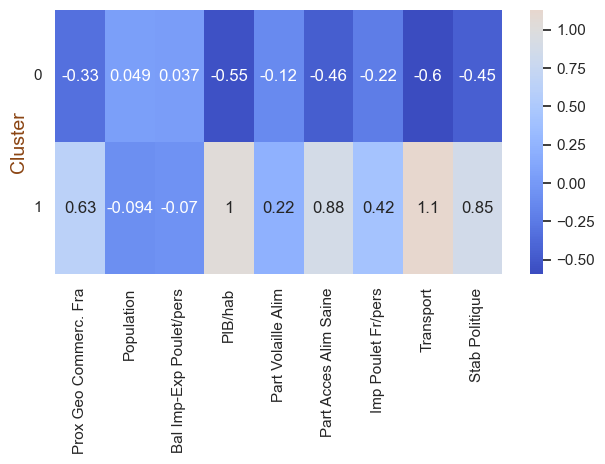

In [738]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

En effet le cluster 2 semble le plus intéressant
cluster 2 : point fort : Prox Géo, PIB/hab, Alim saine, Import de Poulet Francais, Transport, Stab poilitique  

**RADAR**

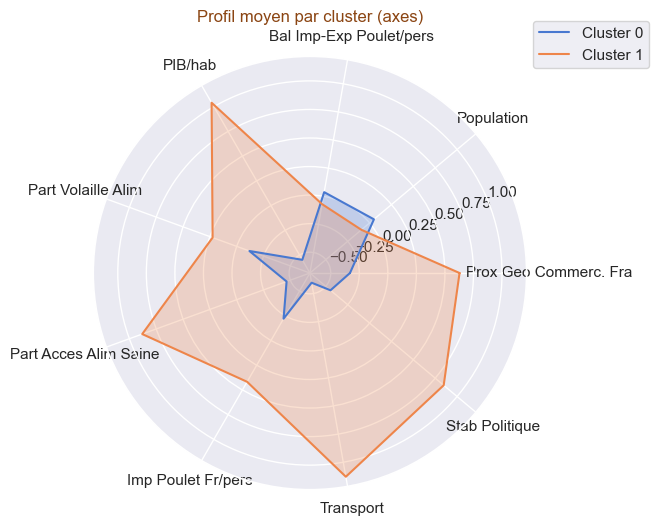

In [739]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

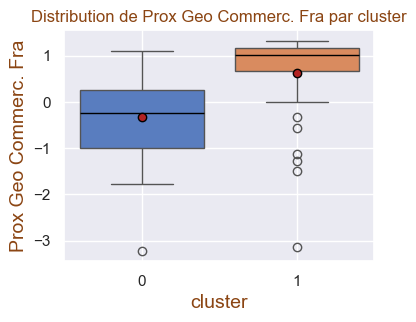

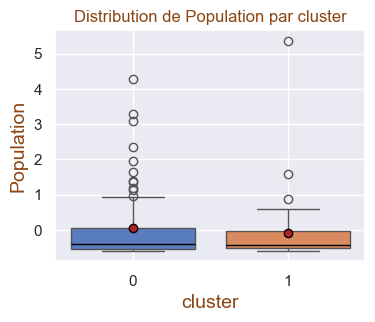

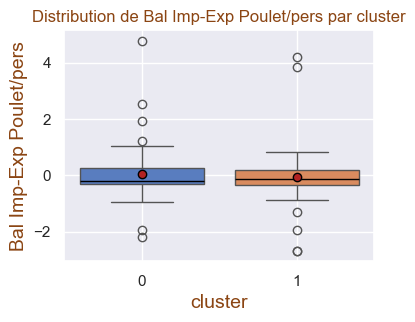

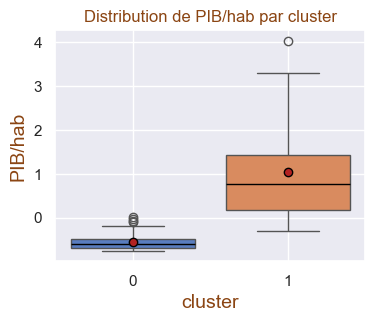

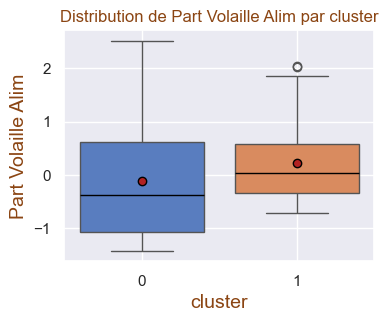

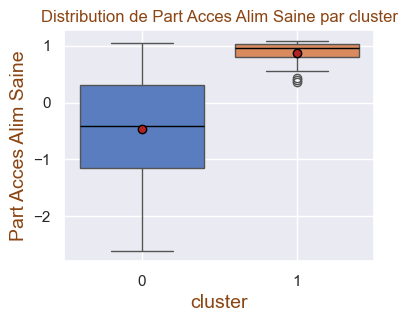

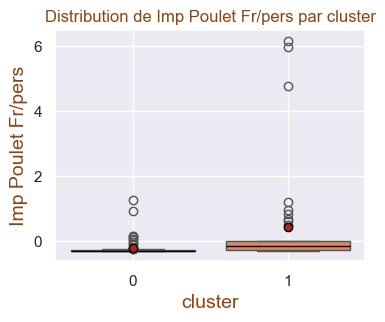

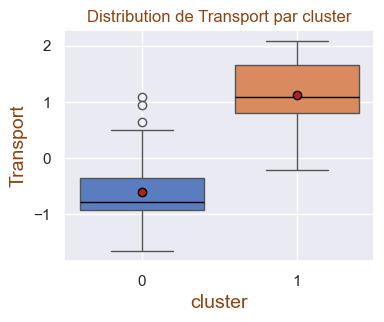

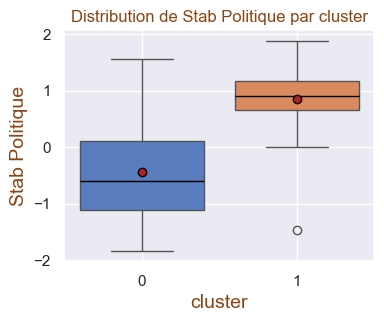

In [740]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.2bis - K-means Test à 10 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2bis.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [684]:
n_clusters=10

In [685]:
df_X_bis_proj_KM_N_temp =df_X_bis_proj_KM.copy()

In [686]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_bis_proj_KM_N_temp  )

KMeans(n_clusters=10)

Voici les clusters : 

In [589]:
kmeans.labels_

array([7, 1, 4, 7, 6, 9, 3, 7, 7, 5, 0, 1, 0, 2, 8, 1, 1, 7, 6, 9, 2, 7,
       7, 2, 2, 2, 0, 0, 9, 7, 9, 2, 7, 5, 0, 0, 9, 2, 2, 9, 7, 7, 1, 7,
       0, 4, 2, 2, 2, 0, 7, 0, 8, 9, 5, 7, 9, 6, 0, 2, 6, 1, 7, 6, 1, 7,
       7, 0, 3, 0, 1, 7, 2, 1, 7, 0, 1, 7, 2, 6, 1, 5, 2, 3, 9, 2, 2, 5,
       0, 0, 1, 4, 1, 5, 7, 7, 1, 0, 0, 9, 7, 5, 7, 2, 5, 2, 8, 1, 5, 2])

In [590]:
pd.Series(kmeans.labels_).value_counts()

7    24
2    20
0    17
1    15
9    10
5     9
6     6
4     3
3     3
8     3
Name: count, dtype: int64

Ajoutons nos labels à `df_X_bis_proj_KM_N_temp  `

In [591]:
df_X_bis_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_bis_proj_KM_N_temp  

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,7
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,4
ARM,-1.330664,-0.157751,-1.161689,0.448735,7
AUS,2.022319,2.112283,2.235469,0.239079,6
...,...,...,...,...,...
URY,-0.147778,1.034746,0.052218,-0.097757,2
USA,1.544695,-0.769873,5.506464,0.864181,8
UZB,-0.862694,-0.646368,-0.307510,-0.651443,1


Affichons cela de façon graphique :

In [592]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_bis_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

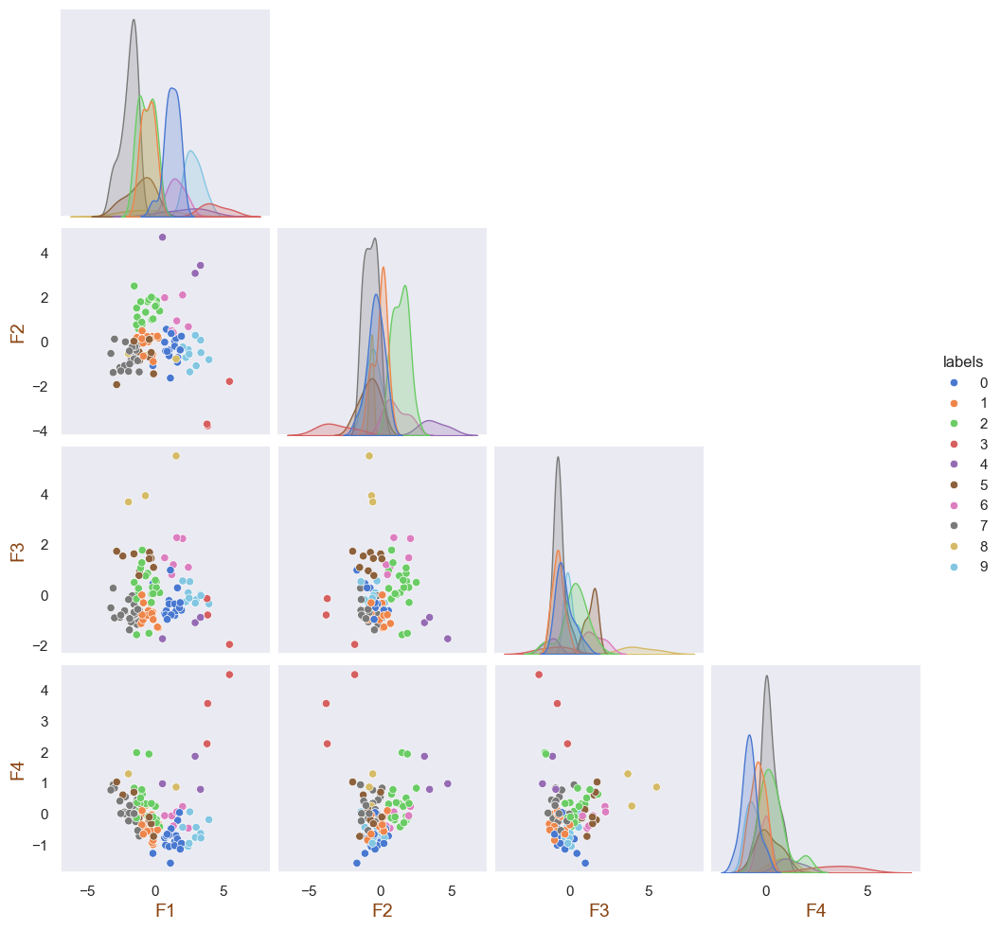

In [593]:
sns.pairplot(df_X_bis_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2bis.2 - Interprétation: </h4>
</div>

In [594]:
df_X_bis_proj_KM_N_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,7
ALB,0.242622,0.174124,-1.299509,-0.323342,1


CENTRE DE GRAVITE :

In [595]:
df_X_bis_proj_KM_N_temp_grouped = (df_X_bis_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_proj_KM_N_temp_grouped)

,F1,F2,F3,F4
cluster,,,,
0,1.216789,-0.340579,-0.333236,-0.817165
1,-0.517947,-0.017416,-0.750037,-0.423248
2,-0.645145,1.408127,0.292256,0.342319
3,4.381050,-3.098643,-0.963286,3.435539
4,2.272500,3.753807,-1.237247,1.207011
5,-1.144294,-0.768881,1.366823,0.112463
6,1.553729,1.107125,1.514122,-0.110470
7,-1.928277,-0.694667,-0.699327,0.119420
8,-0.375304,-0.635643,4.374576,0.802053


LES CENTROIDES :

In [596]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[ 1.216789  , -0.34057891, -0.33323635, -0.81716454],
       [-0.51794661, -0.01741593, -0.75003734, -0.4232477 ],
       [-0.64514495,  1.40812666,  0.29225596,  0.34231873],
       [ 4.38104979, -3.09864302, -0.96328609,  3.43553862],
       [ 2.27250004,  3.75380681, -1.23724742,  1.2070106 ],
       [-1.14429406, -0.76888067,  1.36682325,  0.11246304],
       [ 1.55372914,  1.10712532,  1.51412228, -0.1104703 ],
       [-1.92827713, -0.69466677, -0.69932728,  0.11941956],
       [-0.37530354, -0.63564289,  4.37457638,  0.80205338],
       [ 2.84068691, -0.52208391, -0.00539577, -0.61550847]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [597]:
df_temp = df_X_bis_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,7
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,4
ARM,-1.330664,-0.157751,-1.161689,0.448735,7
AUS,2.022319,2.112283,2.235469,0.239079,6


In [598]:
df_temp_grouped =df_X_bis_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,1.216789,-0.340579,-0.333236,-0.817165
1,-0.517947,-0.017416,-0.750037,-0.423248
2,-0.645145,1.408127,0.292256,0.342319
3,4.381050,-3.098643,-0.963286,3.435539
4,2.272500,3.753807,-1.237247,1.207011


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2bis.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [601]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGR  , BLR  , CYP  , CZE  , ESP  , EST  , GRC  , HRV  , HUN  , ITA  , LTU  , LVA  , MLT  , POL  , PRT  , SVK  , SVN 



cluster 1 :
ALB  , BIH  , BTN  , BWA  , GMB  , KAZ  , LAO  , MDA  , MKD  , MNG  , NAM  , PRY  , ROU  , SRB  , UZB 



cluster 2 :
BOL  , CHL  , COG  , COL  , CRI  , DOM  , FJI  , GAB  , GTM  , GUY  , HND  , JAM  , MEX  , MUS  , NIC  , PAN  , PER  , TTO  , URY  , ZAF 



cluster 3 :
BEL  , LUX  , NLD 



cluster 4 :
ARE  , GRD  , QAT 



cluster 5 :
BGD  , EGY  , IRN  , NGA  , PHL  , RUS  , THA  , TUR  , VNM 



cluster 6 :
AUS  , CAN  , ISR  , JPN  , KOR  , MYS 



cluster 7 :
AGO  , ARM  , BEN  , BFA  , CAF  , CMR  , COD  , DJI  , DZA  , GHA  , GIN  , GNB  , HTI  , IRQ  , KGZ  , LBR  , LKA  , MDG  , MLI  , MRT  , RWA  , SDN  , TGO  , TJK 



cluster 8 :
BRA  , IDN  , USA 



cluster 9 :
AUT  , CHE  , DEU  , DNK  , FIN  , GBR  , IRL  , ISL  , NOR  , SWE 





**HEATMAP**

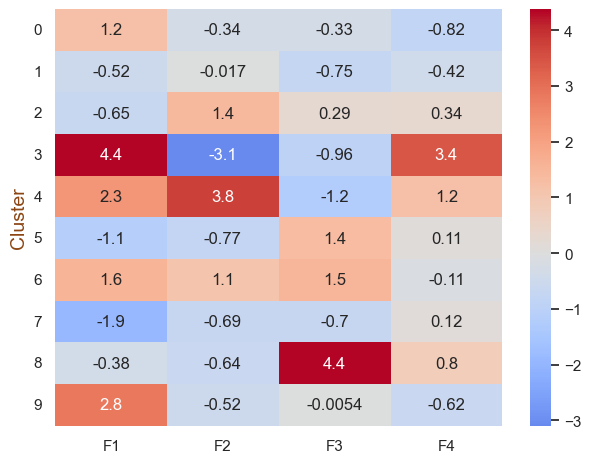

In [600]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

cluster 2 : F1 et F4 fav   
Pour les autres c'est moins clair
Toujours un seul cluster qui ressort du lot

**RADAR**

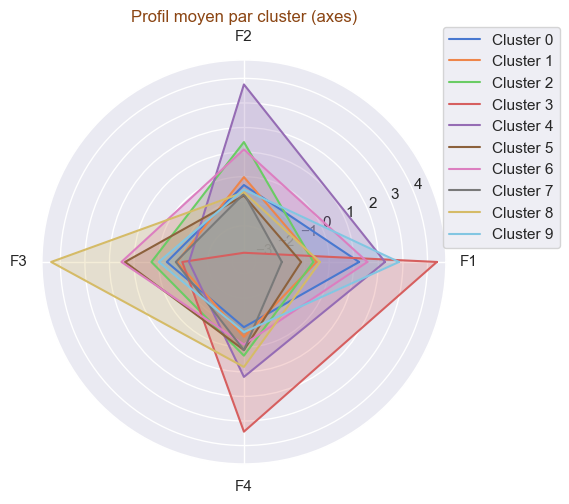

In [602]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

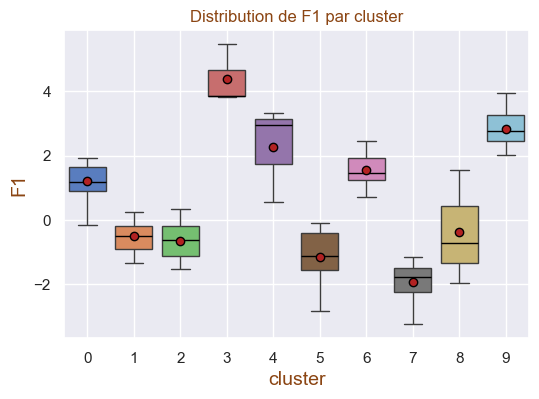

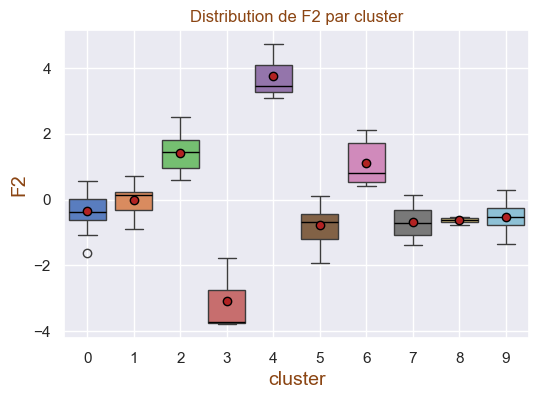

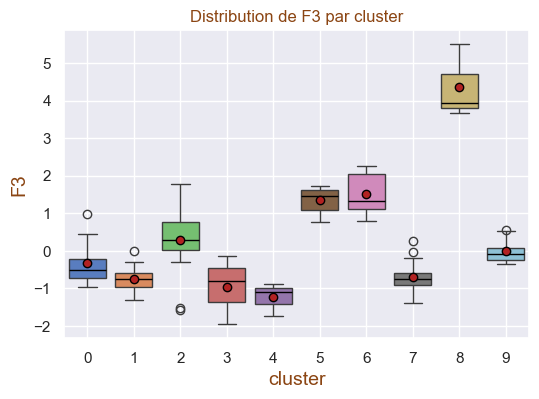

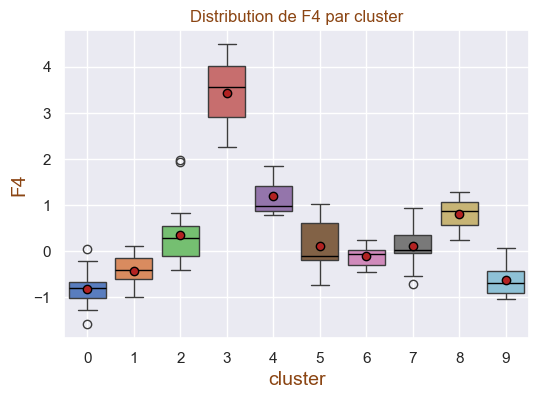

In [603]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [604]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,7
ALB,0.242622,0.174124,-1.299509,-0.323342,1


In [605]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,1.216789,-0.340579,-0.333236,-0.817165
1,-0.517947,-0.017416,-0.750037,-0.423248
2,-0.645145,1.408127,0.292256,0.342319
3,4.381050,-3.098643,-0.963286,3.435539
4,2.272500,3.753807,-1.237247,1.207011
5,-1.144294,-0.768881,1.366823,0.112463
6,1.553729,1.107125,1.514122,-0.110470
7,-1.928277,-0.694667,-0.699327,0.119420
8,-0.375304,-0.635643,4.374576,0.802053


In [606]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,1.216789,-0.340579,-0.333236,-0.817165,0
1,-0.517947,-0.017416,-0.750037,-0.423248,1
2,-0.645145,1.408127,0.292256,0.342319,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,2.272500,3.753807,-1.237247,1.207011,4
5,-1.144294,-0.768881,1.366823,0.112463,5
6,1.553729,1.107125,1.514122,-0.110470,6
7,-1.928277,-0.694667,-0.699327,0.119420,7
8,-0.375304,-0.635643,4.374576,0.802053,8


Et on affiche le graphique pour F1 et F2 :

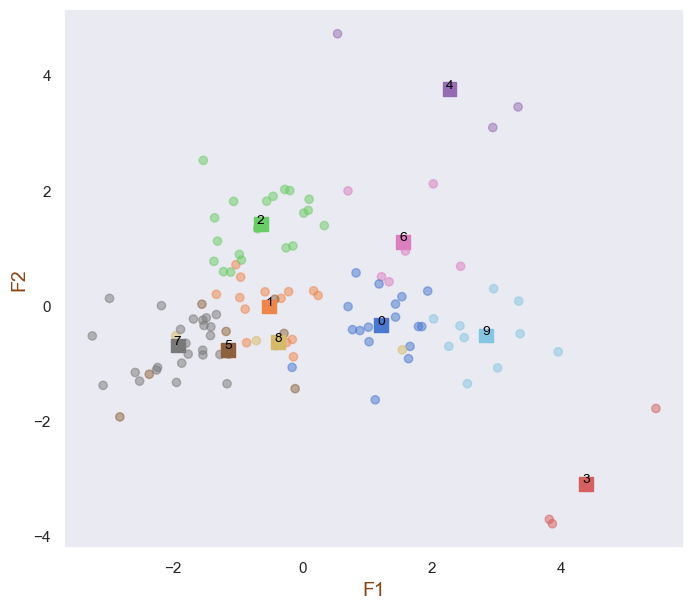

In [607]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


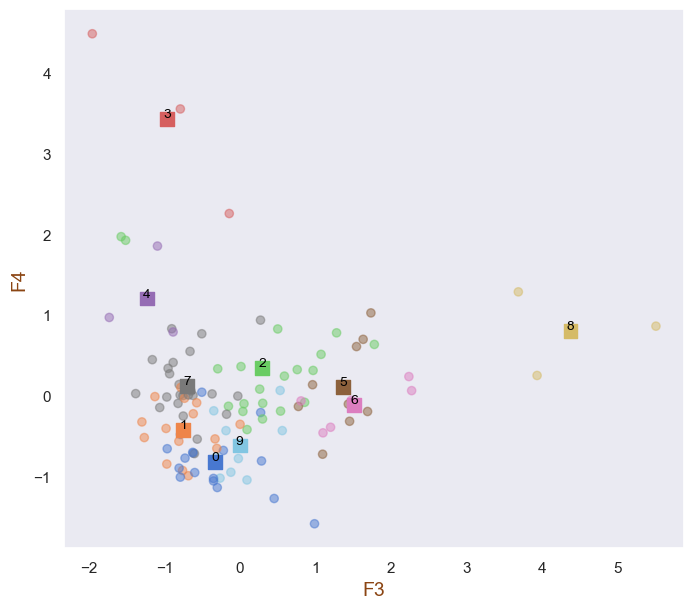

In [608]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

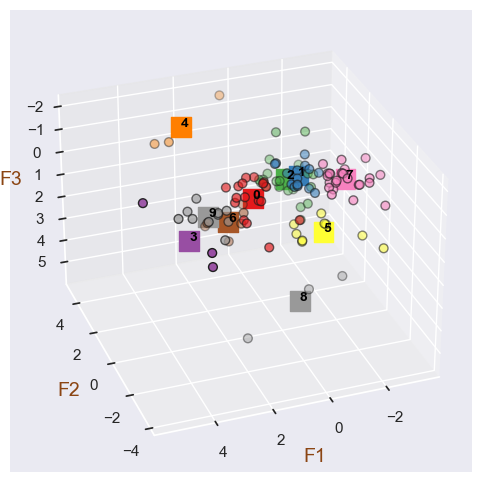

In [609]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [610]:
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,7
ALB,0.242622,0.174124,-1.299509,-0.323342,1


In [611]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,1.216789,-0.340579,-0.333236,-0.817165,0
1,-0.517947,-0.017416,-0.750037,-0.423248,1
2,-0.645145,1.408127,0.292256,0.342319,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,2.272500,3.753807,-1.237247,1.207011,4


In [612]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [613]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [614]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2bis.3 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 3bis.1.5

In [615]:
df_X_bis_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [616]:
#Mappons df_X_bis_scaled avec nos labels
df_X_bis_scaled_KM_N_temp = df_X_bis_scaled.join(df_temp["labels"])
df_X_bis_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,7
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,4
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,7
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,6


In [617]:
df_X_bis_scaled_KM_N_temp_grouped = (df_X_bis_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.018608,-0.364312,-0.261262,0.114550,0.043058,0.768723,-0.058618,0.585211,0.661435
1,0.070531,-0.454983,0.177491,-0.532506,-0.594058,0.032059,-0.213712,-0.601442,0.250657
2,-1.068828,-0.258652,0.185000,-0.402116,1.208173,-0.287026,-0.161602,-0.524847,-0.013353
3,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
4,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300
5,-0.273582,1.564346,-0.392313,-0.543684,-0.440633,-0.089748,-0.303858,-0.033365,-1.071043
6,-1.134807,0.237867,-0.156447,0.883755,1.091493,0.850570,-0.303688,1.514484,0.541315
7,0.053695,-0.202020,-0.020855,-0.694623,-0.980376,-1.166418,-0.228480,-0.932953,-1.040572
8,-1.098915,4.238093,-1.266487,0.372268,0.680140,0.067338,-0.304512,0.557052,-0.484355


Travaillons sur des copies :

In [618]:
df_temp = df_X_bis_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_bis_scaled_KM_N_temp_grouped.copy()

In [619]:
df_temp.head(5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,7
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,4
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,7
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,6


In [620]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.018608,-0.364312,-0.261262,0.114550,0.043058,0.768723,-0.058618,0.585211,0.661435
1,0.070531,-0.454983,0.177491,-0.532506,-0.594058,0.032059,-0.213712,-0.601442,0.250657


**Liste des pays (Vérification)**

In [621]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGR  , BLR  , CYP  , CZE  , ESP  , EST  , GRC  , HRV  , HUN  , ITA  , LTU  , LVA  , MLT  , POL  , PRT  , SVK  , SVN 



cluster 1 :
ALB  , BIH  , BTN  , BWA  , GMB  , KAZ  , LAO  , MDA  , MKD  , MNG  , NAM  , PRY  , ROU  , SRB  , UZB 



cluster 2 :
BOL  , CHL  , COG  , COL  , CRI  , DOM  , FJI  , GAB  , GTM  , GUY  , HND  , JAM  , MEX  , MUS  , NIC  , PAN  , PER  , TTO  , URY  , ZAF 



cluster 3 :
BEL  , LUX  , NLD 



cluster 4 :
ARE  , GRD  , QAT 



cluster 5 :
BGD  , EGY  , IRN  , NGA  , PHL  , RUS  , THA  , TUR  , VNM 



cluster 6 :
AUS  , CAN  , ISR  , JPN  , KOR  , MYS 



cluster 7 :
AGO  , ARM  , BEN  , BFA  , CAF  , CMR  , COD  , DJI  , DZA  , GHA  , GIN  , GNB  , HTI  , IRQ  , KGZ  , LBR  , LKA  , MDG  , MLI  , MRT  , RWA  , SDN  , TGO  , TJK 



cluster 8 :
BRA  , IDN  , USA 



cluster 9 :
AUT  , CHE  , DEU  , DNK  , FIN  , GBR  , IRL  , ISL  , NOR  , SWE 





**HEATMAP**

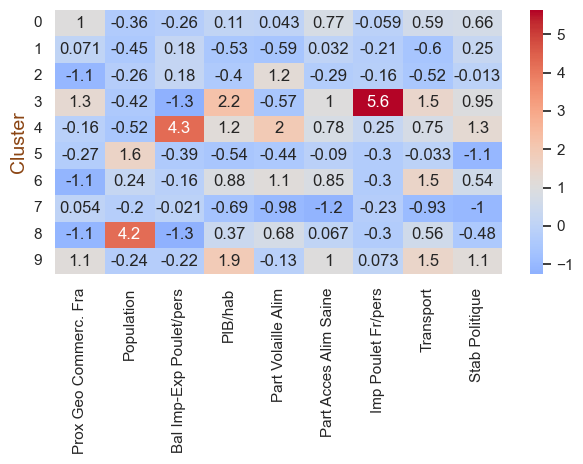

In [622]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

En effet le cluster 2 semble le plus intéressant
cluster 2 : point fort : Prox Géo, PIB/hab, Alim saine, Import de Poulet Francais, Transport, Stab poilitique  

**RADAR**

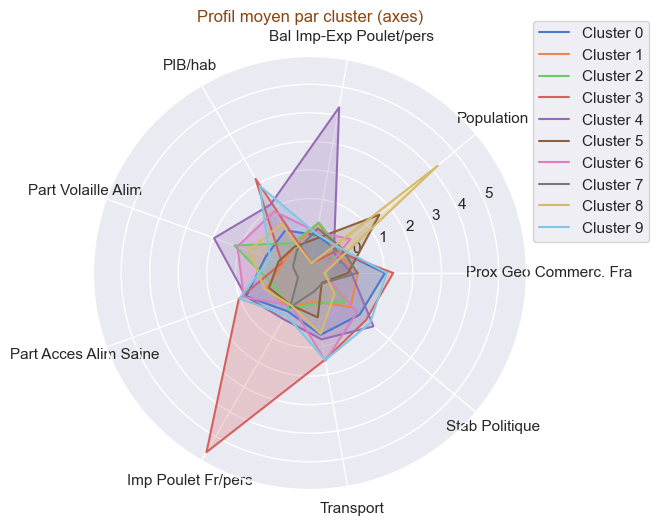

In [623]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

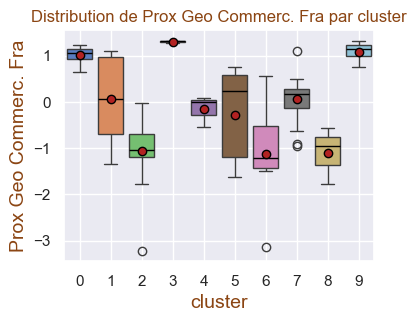

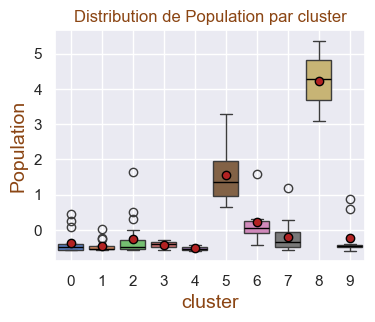

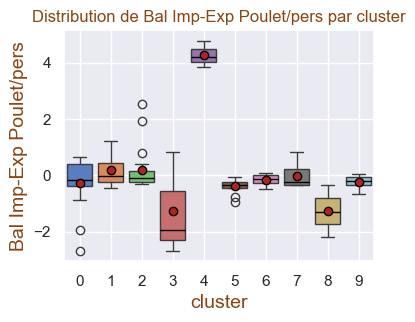

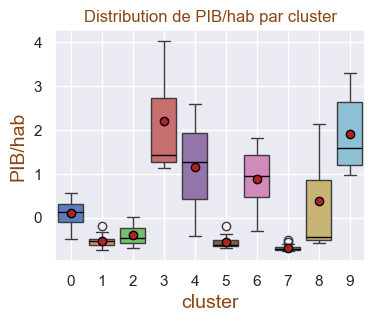

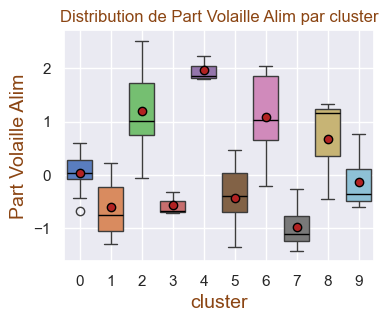

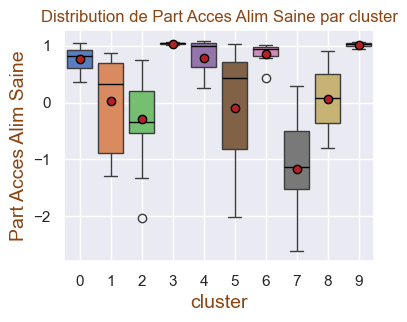

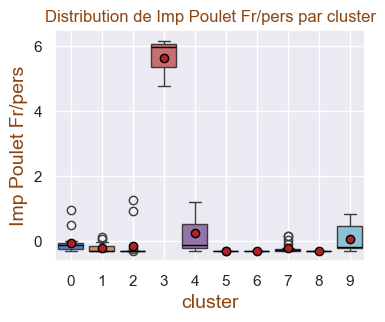

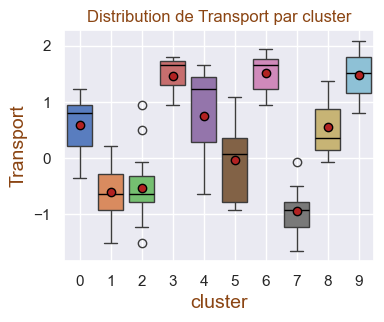

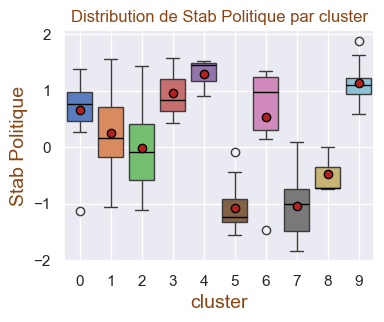

In [624]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.2ter - K-means Test à 9 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2ter.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [625]:
n_clusters=9

In [626]:
df_X_bis_proj_KM_N_temp =df_X_bis_proj_KM.copy()

In [627]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_bis_proj_KM_N_temp  )

KMeans(n_clusters=9)

Voici les clusters : 

In [628]:
kmeans.labels_

array([2, 1, 6, 2, 8, 7, 3, 2, 2, 0, 1, 1, 1, 4, 5, 1, 1, 2, 8, 7, 4, 2,
       0, 4, 4, 4, 1, 1, 7, 2, 7, 4, 2, 5, 7, 1, 7, 4, 4, 7, 2, 2, 2, 2,
       1, 6, 4, 4, 4, 1, 2, 1, 0, 7, 5, 2, 7, 8, 7, 4, 8, 1, 2, 8, 2, 2,
       2, 1, 3, 1, 2, 2, 5, 1, 2, 7, 1, 2, 4, 8, 2, 0, 4, 3, 7, 4, 4, 5,
       7, 7, 2, 6, 1, 5, 2, 2, 1, 1, 7, 7, 2, 5, 2, 4, 5, 4, 8, 2, 5, 4])

In [629]:
pd.Series(kmeans.labels_).value_counts()

2    29
1    20
4    19
7    16
5     9
8     7
0     4
6     3
3     3
Name: count, dtype: int64

Ajoutons nos labels à `df_X_bis_proj_KM_N_temp  `

In [630]:
df_X_bis_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_bis_proj_KM_N_temp  

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,2
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,6
ARM,-1.330664,-0.157751,-1.161689,0.448735,2
AUS,2.022319,2.112283,2.235469,0.239079,8
...,...,...,...,...,...
URY,-0.147778,1.034746,0.052218,-0.097757,4
USA,1.544695,-0.769873,5.506464,0.864181,8
UZB,-0.862694,-0.646368,-0.307510,-0.651443,2


Affichons cela de façon graphique :

In [631]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_bis_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

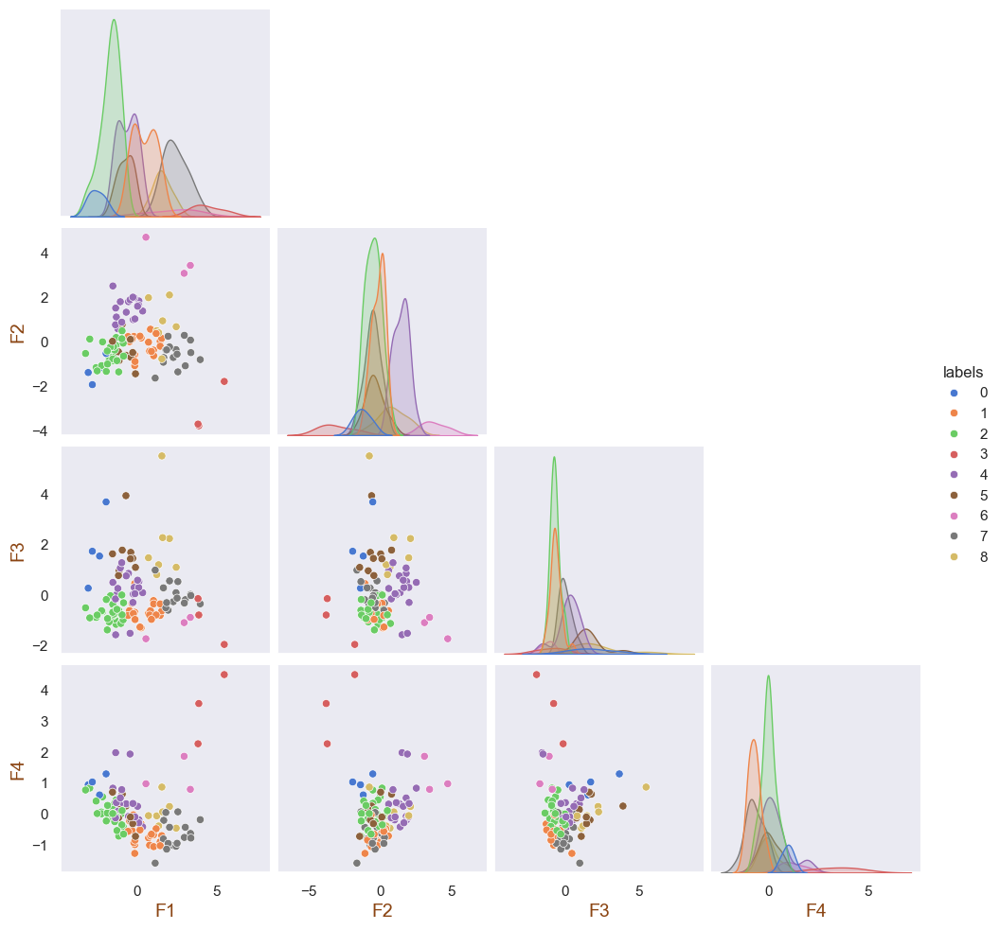

In [632]:
sns.pairplot(df_X_bis_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2ter.2 - Interprétation: </h4>
</div>

In [633]:
df_X_bis_proj_KM_N_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,2
ALB,0.242622,0.174124,-1.299509,-0.323342,1


CENTRE DE GRAVITE :

In [634]:
df_X_bis_proj_KM_N_temp_grouped = (df_X_bis_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_proj_KM_N_temp_grouped)

,F1,F2,F3,F4
cluster,,,,
0,-2.557589,-1.261007,1.807377,0.966913
1,0.447250,-0.156148,-0.663890,-0.709974
2,-1.697509,-0.498588,-0.718168,0.018232
3,4.381050,-3.098643,-0.963286,3.435539
4,-0.629450,1.440739,0.214067,0.326784
5,-0.751541,-0.401311,1.637533,0.029199
6,2.272500,3.753807,-1.237247,1.207011
7,2.400551,-0.560912,0.005030,-0.674850
8,1.552439,0.838983,2.084457,0.028766


LES CENTROIDES :

In [635]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-2.55758897, -1.26100698,  1.80737655,  0.96691349],
       [ 0.44725018, -0.15614813, -0.66388954, -0.70997395],
       [-1.69750941, -0.49858762, -0.71816763,  0.01823214],
       [ 4.38104979, -3.09864302, -0.96328609,  3.43553862],
       [-0.6294497 ,  1.44073914,  0.21406713,  0.32678423],
       [-0.751541  , -0.40131068,  1.63753253,  0.02919877],
       [ 2.27250004,  3.75380681, -1.23724742,  1.2070106 ],
       [ 2.4005512 , -0.56091163,  0.00503004, -0.6748502 ],
       [ 1.55243855,  0.83898271,  2.08445674,  0.02876559]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [636]:
df_temp = df_X_bis_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,2
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,6
ARM,-1.330664,-0.157751,-1.161689,0.448735,2
AUS,2.022319,2.112283,2.235469,0.239079,8


In [637]:
df_temp_grouped =df_X_bis_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,-2.557589,-1.261007,1.807377,0.966913
1,0.447250,-0.156148,-0.663890,-0.709974
2,-1.697509,-0.498588,-0.718168,0.018232
3,4.381050,-3.098643,-0.963286,3.435539
4,-0.629450,1.440739,0.214067,0.326784


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2ter.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [663]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGD  , COD  , IDN  , NGA 



cluster 1 :
ALB  , BGR  , BIH  , BLR  , BTN  , BWA  , CYP  , CZE  , EST  , GRC  , HRV  , HUN  , KAZ  , LTU  , LVA  , MKD  , MNG  , ROU  , SRB  , SVK 



cluster 2 :
AGO  , ARM  , BEN  , BFA  , CAF  , CMR  , DJI  , DZA  , GHA  , GIN  , GMB  , GNB  , HTI  , IRQ  , KGZ  , LAO  , LBR  , LKA  , MDA  , MDG  , MLI  , MRT  , NAM  , PRY  , RWA  , SDN  , TGO  , TJK  , UZB 



cluster 3 :
BEL  , LUX  , NLD 



cluster 4 :
BOL  , CHL  , COG  , COL  , CRI  , DOM  , FJI  , GAB  , GTM  , GUY  , HND  , JAM  , MUS  , NIC  , PAN  , PER  , TTO  , URY  , ZAF 



cluster 5 :
BRA  , EGY  , IRN  , MEX  , PHL  , RUS  , THA  , TUR  , VNM 



cluster 6 :
ARE  , GRD  , QAT 



cluster 7 :
AUT  , CHE  , DEU  , DNK  , ESP  , FIN  , GBR  , IRL  , ISL  , ITA  , MLT  , NOR  , POL  , PRT  , SVN  , SWE 



cluster 8 :
AUS  , CAN  , ISR  , JPN  , KOR  , MYS  , USA 





**HEATMAP**

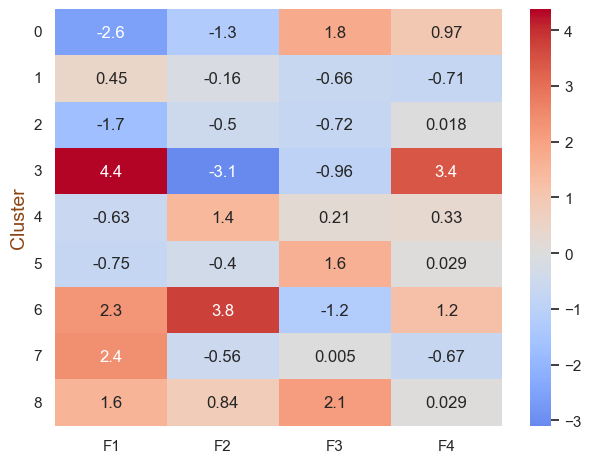

In [639]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

cluster 0 : F1 et F4 fav   
cluster 2 : F2 fav et le reste légèrement positif  
clsuter 4 : F3 fav important et un peu de F4  
(a voir la taille surtout en sa faveur, et un peu F4°


**RADAR**

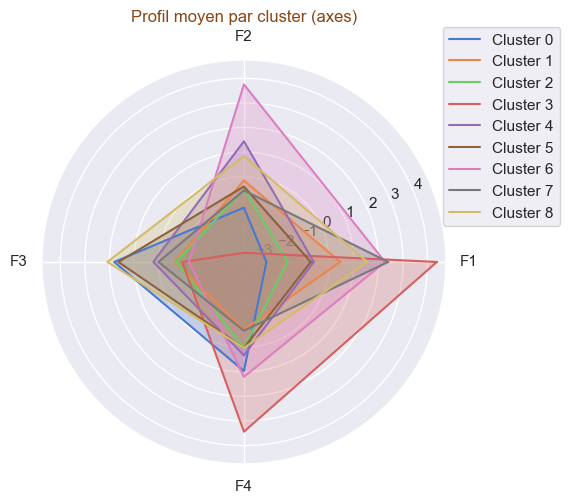

In [640]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

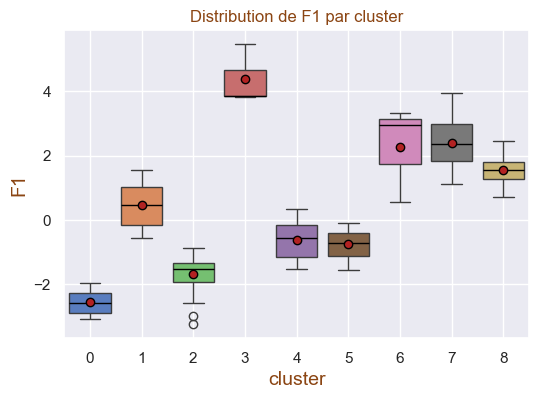

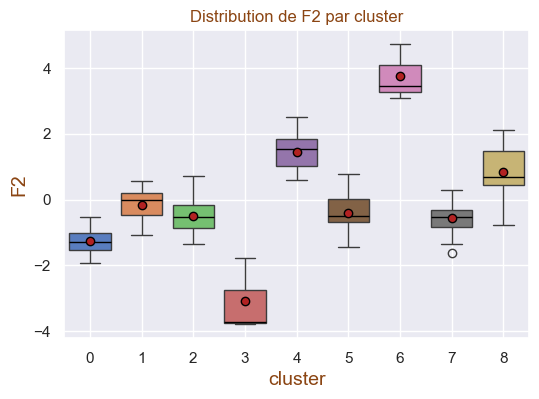

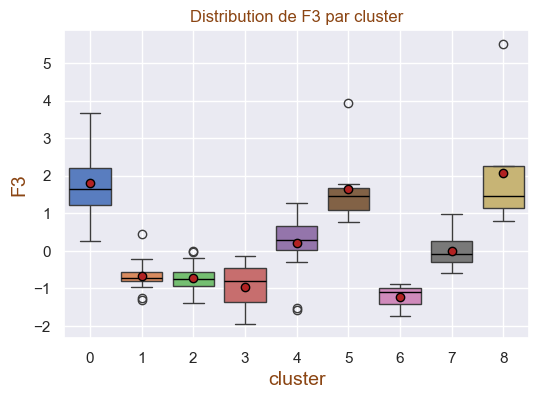

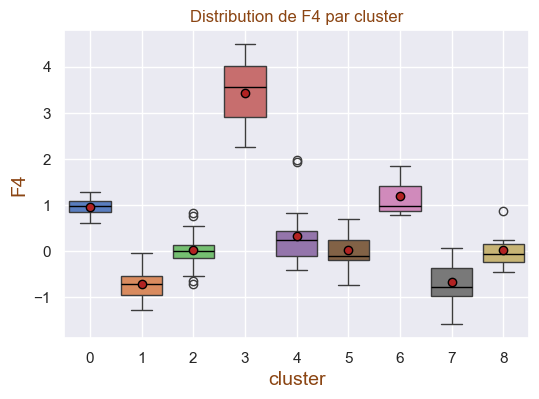

In [641]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [642]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,2
ALB,0.242622,0.174124,-1.299509,-0.323342,1


In [643]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,-2.557589,-1.261007,1.807377,0.966913
1,0.447250,-0.156148,-0.663890,-0.709974
2,-1.697509,-0.498588,-0.718168,0.018232
3,4.381050,-3.098643,-0.963286,3.435539
4,-0.629450,1.440739,0.214067,0.326784
5,-0.751541,-0.401311,1.637533,0.029199
6,2.272500,3.753807,-1.237247,1.207011
7,2.400551,-0.560912,0.005030,-0.674850
8,1.552439,0.838983,2.084457,0.028766


In [644]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,-2.557589,-1.261007,1.807377,0.966913,0
1,0.447250,-0.156148,-0.663890,-0.709974,1
2,-1.697509,-0.498588,-0.718168,0.018232,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,-0.629450,1.440739,0.214067,0.326784,4
5,-0.751541,-0.401311,1.637533,0.029199,5
6,2.272500,3.753807,-1.237247,1.207011,6
7,2.400551,-0.560912,0.005030,-0.674850,7
8,1.552439,0.838983,2.084457,0.028766,8


Et on affiche le graphique pour F1 et F2 :

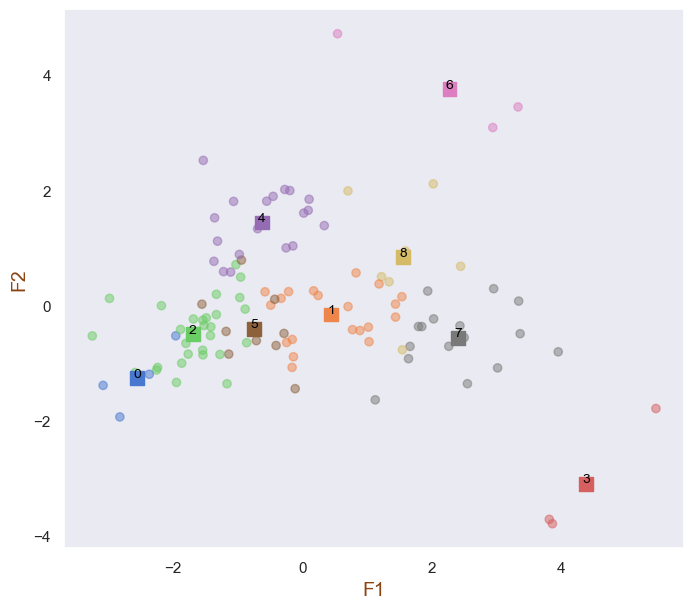

In [645]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


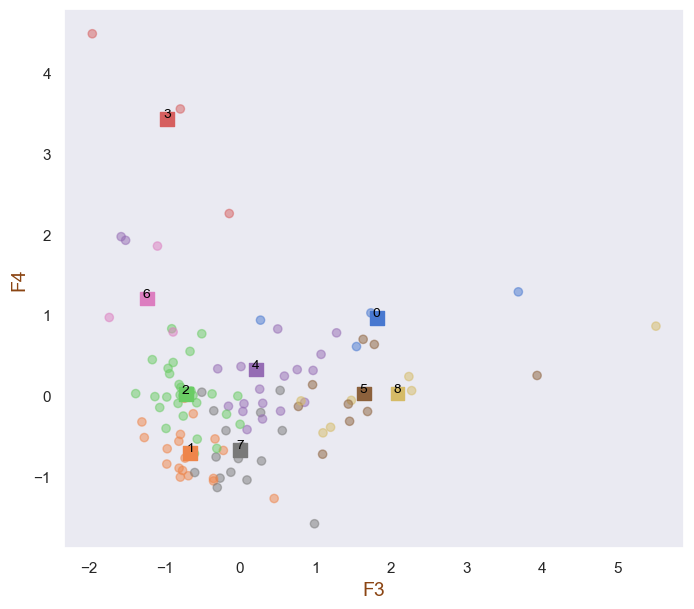

In [646]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

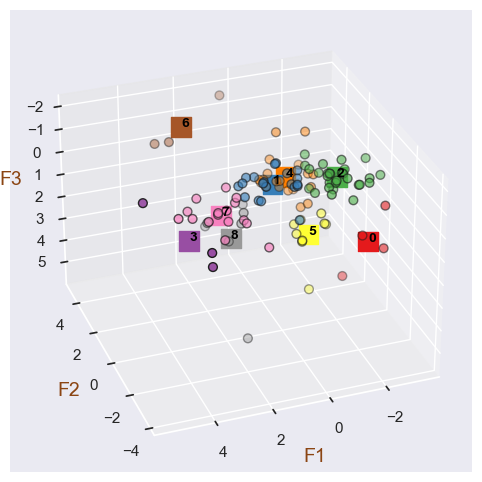

In [647]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [648]:
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,2
ALB,0.242622,0.174124,-1.299509,-0.323342,1


In [649]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,-2.557589,-1.261007,1.807377,0.966913,0
1,0.447250,-0.156148,-0.663890,-0.709974,1
2,-1.697509,-0.498588,-0.718168,0.018232,2
3,4.381050,-3.098643,-0.963286,3.435539,3
4,-0.629450,1.440739,0.214067,0.326784,4


In [650]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [651]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [652]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3bis.2ter.3 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 3bis.1.15

In [653]:
df_X_bis_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [654]:
#Mappons df_X_bis_scaled avec nos labels
df_X_bis_scaled_KM_N_temp = df_X_bis_scaled.join(df_temp["labels"])
df_X_bis_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,2
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,6
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,2
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,8


In [655]:
df_X_bis_scaled_KM_N_temp_grouped = (df_X_bis_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.634506,2.782222,-0.315942,-0.674354,-1.138603,-1.536314,-0.285348,-0.675643,-1.291567
1,0.684135,-0.484404,0.046432,-0.201168,-0.269048,0.512661,-0.162592,-0.015014,0.483989
2,-0.018362,-0.296171,0.020132,-0.681381,-0.879729,-0.937996,-0.236548,-0.912112,-0.788455
3,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
4,-1.065141,-0.359173,0.174084,-0.405770,1.229153,-0.312674,-0.154080,-0.541476,0.036553
5,-0.446553,1.460413,-0.516848,-0.477092,0.097793,0.257332,-0.303859,0.174079,-0.949161
6,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300
7,1.099038,-0.197937,-0.358710,1.311830,-0.042906,0.953081,0.086456,1.317014,1.012705
8,-1.054817,0.970440,-0.318133,1.062554,1.101892,0.858092,-0.303805,1.493968,0.464733


Travaillons sur des copies :

In [669]:
df_temp = df_X_bis_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_bis_scaled_KM_N_temp_grouped.copy()

In [665]:
df_temp.head(5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,2
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,1
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,6
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,2
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,8


In [666]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.634506,2.782222,-0.315942,-0.674354,-1.138603,-1.536314,-0.285348,-0.675643,-1.291567
1,0.684135,-0.484404,0.046432,-0.201168,-0.269048,0.512661,-0.162592,-0.015014,0.483989


**Liste des pays (Vérification)**

In [667]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGD  / COD  / IDN  / NGA 



cluster 1 :
ALB  / BGR  / BIH  / BLR  / BTN  / BWA  / CYP  / CZE  / EST  / GRC  / HRV  / HUN  / KAZ  / LTU  / LVA  / MKD  / MNG  / ROU  / SRB  / SVK 



cluster 2 :
AGO  / ARM  / BEN  / BFA  / CAF  / CMR  / DJI  / DZA  / GHA  / GIN  / GMB  / GNB  / HTI  / IRQ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MLI  / MRT  / NAM  / PRY  / RWA  / SDN  / TGO  / TJK  / UZB 



cluster 3 :
BEL  / LUX  / NLD 



cluster 4 :
BOL  / CHL  / COG  / COL  / CRI  / DOM  / FJI  / GAB  / GTM  / GUY  / HND  / JAM  / MUS  / NIC  / PAN  / PER  / TTO  / URY  / ZAF 



cluster 5 :
BRA  / EGY  / IRN  / MEX  / PHL  / RUS  / THA  / TUR  / VNM 



cluster 6 :
ARE  / GRD  / QAT 



cluster 7 :
AUT  / CHE  / DEU  / DNK  / ESP  / FIN  / GBR  / IRL  / ISL  / ITA  / MLT  / NOR  / POL  / PRT  / SVN  / SWE 



cluster 8 :
AUS  / CAN  / ISR  / JPN  / KOR  / MYS  / USA 





**HEATMAP**

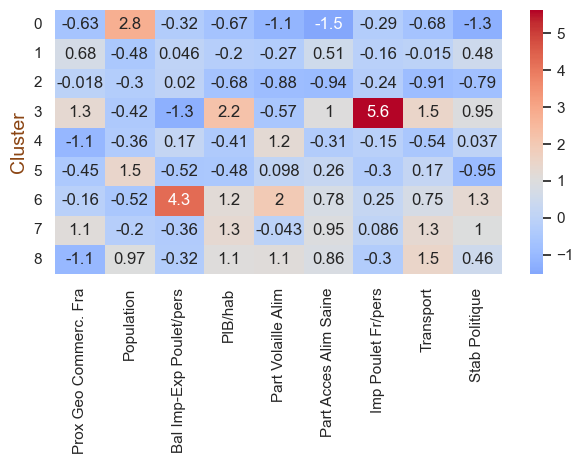

In [668]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

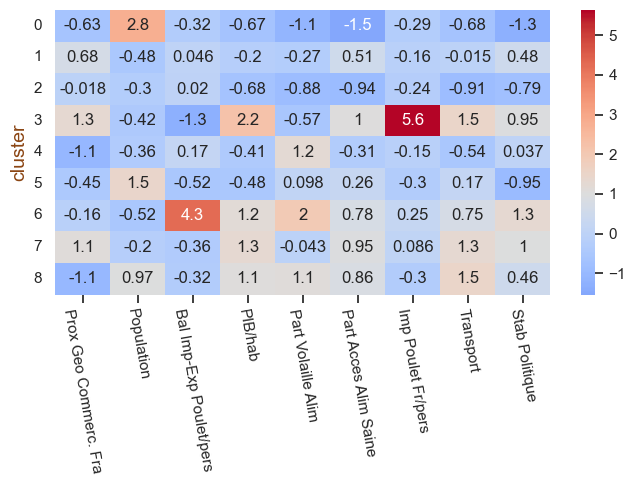

In [672]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 5))

# Heatmap
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('bottom')    # Place les ticks en haut
ax.xaxis.set_label_position('bottom')    # Place le label (si présent) en haut
plt.yticks(rotation=0)
plt.xticks(rotation=-80)
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

En effet le cluster 0 semble le plus intéressant
cluster 0 : point fort : Prox Géo, PIB/hab, Alim saine, Import de Poulet Francais, Transport, Stab poilitique  
cluster 2 : forte consoammation de poulet  
clsuter 3: pays à haut niveau de vie mais sans apétance pour la volaille  
cluster 4 : pays à forte population (niveaud e vie probablement hétérogène : US IDN BRA

**RADAR**

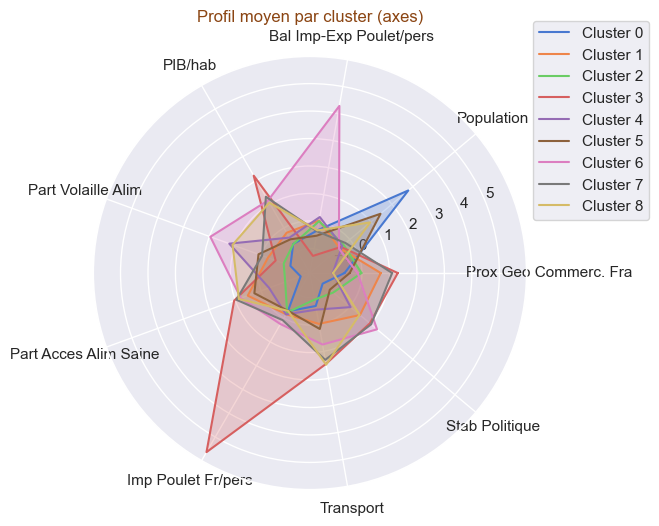

In [673]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

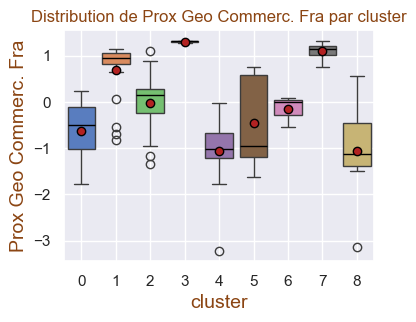

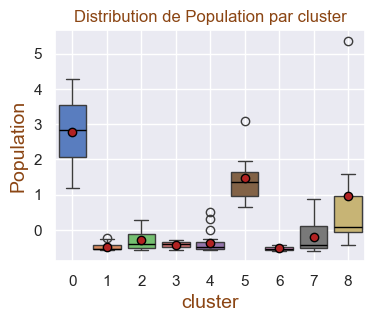

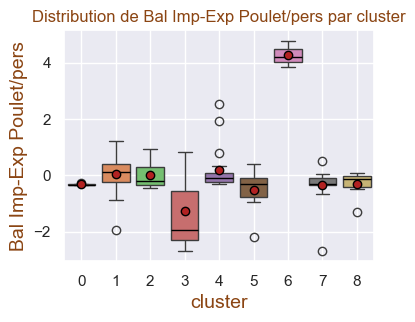

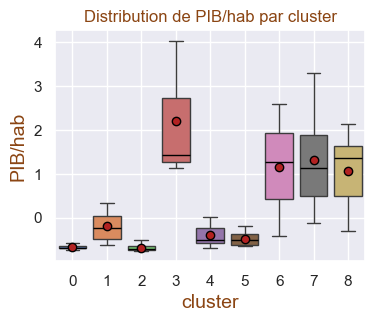

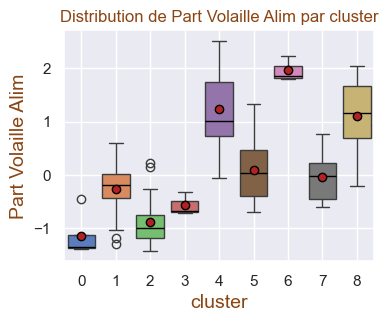

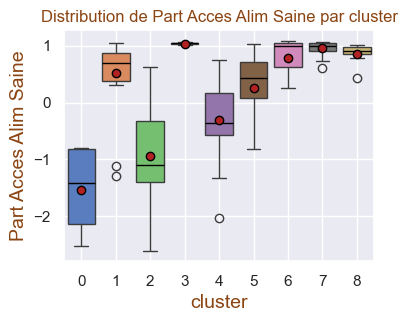

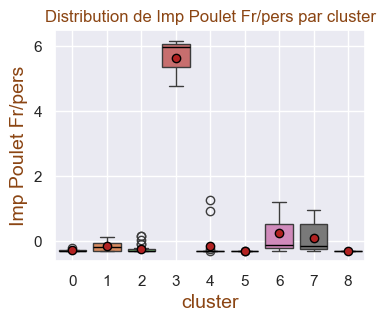

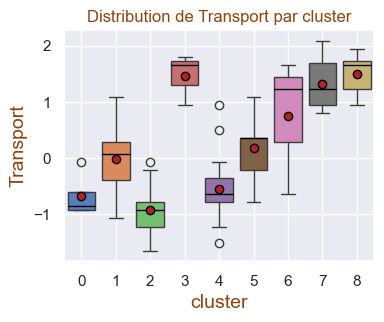

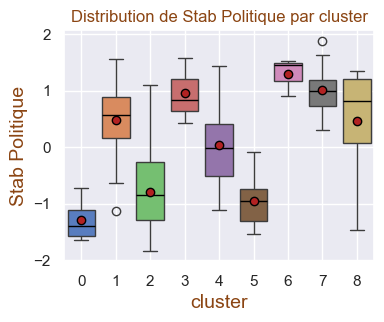

In [674]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3bis.3 - Choix du clustering  </h3>
</div>

**CALCUL DES SCORES DE SILHOUETTE :**

In [829]:
df_X_bis_proj_ACH.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


In [830]:
df_X_bis_proj_KM_N_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0
ALB,0.242622,0.174124,-1.299509,-0.323342,0
ARE,2.942311,3.091661,-1.093631,1.857214,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,0
AUS,2.022319,2.112283,2.235469,0.239079,1


In [831]:
#from sklearn.metrics import silhouette_score

score_kmeans = silhouette_score(df_X_bis_proj_selec_PCA, kmeans.labels_)
score_ach = silhouette_score(df_X_bis_proj_selec_PCA, cah.labels_)

print(f"Score de silhouette de l'ACH : {score_ach}")
print("\n")
print(f"Score de silhouette du K_means : {score_kmeans}")


Score de silhouette de l'ACH : 0.36292752570508857


Score de silhouette du K_means : 0.361577981834045


**INTERPRETATIONS :**

In [832]:
df_X_bis_proj_ACH.head(5)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,4
ALB,0.242622,0.174124,-1.299509,-0.323342,1
ARE,2.942311,3.091661,-1.093631,1.857214,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,4
AUS,2.022319,2.112283,2.235469,0.239079,0


In [833]:
df_X_bis_proj_ACH_grouped

,F1,F2,F3,F4
cluster,,,,
0,0.167493,1.503782,0.539396,0.206589
1,1.646473,-0.400899,-0.239772,-0.720366
2,-1.161469,-0.434215,1.908368,0.454306
3,4.381050,-3.098643,-0.963286,3.435539
4,-1.417505,-0.346178,-0.656888,-0.083668
5,2.272500,3.753807,-1.237247,1.207011


In [834]:
df_X_bis_proj_ACH_grouped_Classement = Classement(df_X_bis_proj_ACH_grouped,1.0)
df_X_bis_proj_ACH_grouped_Classement.head(10)

,F1,F2,F3,F4,Nb Score >1.0,Score total
cluster,,,,,,
5,2.272500,3.753807,-1.237247,1.207011,3,5.996070
3,4.381050,-3.098643,-0.963286,3.435539,2,3.754659
0,0.167493,1.503782,0.539396,0.206589,1,2.417260
2,-1.161469,-0.434215,1.908368,0.454306,1,0.766990
1,1.646473,-0.400899,-0.239772,-0.720366,1,0.285436
4,-1.417505,-0.346178,-0.656888,-0.083668,0,-2.504239


In [835]:
df_X_bis_scaled_ACH_grouped

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-1.096086,-0.251823,0.135263,0.026532,1.320654,0.096627,-0.161354,0.028070,0.372436
1,1.030935,-0.291813,-0.178671,0.657160,-0.047577,0.835695,-0.023206,0.839494,0.719800
2,-0.656173,1.967864,-0.430793,-0.368079,0.004196,-0.363901,-0.299009,0.030464,-0.968992
3,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
4,-0.066855,-0.331532,0.001413,-0.635420,-0.749627,-0.692504,-0.237188,-0.842273,-0.544899
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300


In [836]:
df_X_bis_scaled_ACH_grouped_Classement = Classement(df_X_bis_scaled_ACH_grouped,1.0)
df_X_bis_scaled_ACH_grouped_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Score total
cluster,,,,,,,,,,,
3,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442,5,10.352182
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300,4,9.801782
1,1.030935,-0.291813,-0.178671,0.657160,-0.047577,0.835695,-0.023206,0.839494,0.719800,1,3.541818
0,-1.096086,-0.251823,0.135263,0.026532,1.320654,0.096627,-0.161354,0.028070,0.372436,1,0.470318
2,-0.656173,1.967864,-0.430793,-0.368079,0.004196,-0.363901,-0.299009,0.030464,-0.968992,1,-1.084423
4,-0.066855,-0.331532,0.001413,-0.635420,-0.749627,-0.692504,-0.237188,-0.842273,-0.544899,0,-4.098884


In [837]:
df_X_bis_scaled_ACH_grouped_Classement[['Nb Score >1.0','Score total']]

,Nb Score >1.0,Score total
cluster,,
3,5,10.352182
5,4,9.801782
1,1,3.541818
0,1,0.470318
2,1,-1.084423
4,0,-4.098884


**LES PAYS DU CLUSTER 3 : BEL, LUX, NLD**

In [857]:
#LES PAYS DU CLUSTER Clust

Clust = 3

mask_temp = df_X_bis_proj_ACH['labels']==Clust

liste_iso3 = df_X_bis_proj_ACH.loc[mask_temp,:].index
liste_iso3

Index(['BEL', 'LUX', 'NLD'], dtype='string', name='iso3')

In [858]:
#Affichage des données centrées réduites des pays du cluster Clust
mask_temp = df_X_bis_scaled.index.isin(liste_iso3)

df_clust_3 = df_X_bis_scaled.loc[mask_temp,:] 
display(df_clust_3)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889


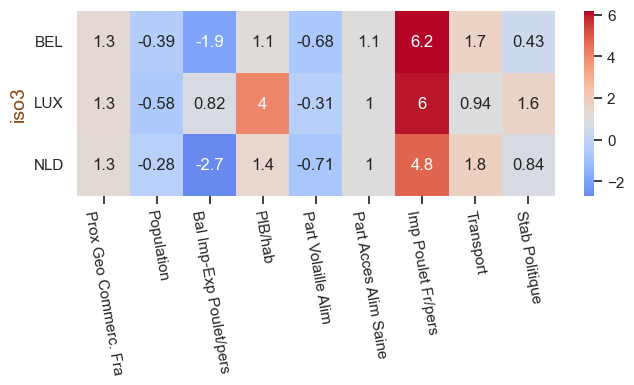

In [859]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 4))

# Heatmap
sns.heatmap(data=df_clust_3, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('bottom')    # Place les ticks en haut
ax.xaxis.set_label_position('bottom')    # Place le label (si présent) en haut
plt.yticks(rotation=0)
plt.xticks(rotation=-80)
plt.tight_layout()
plt.show()

In [860]:
df_clust_3_Classement = Classement(df_clust_3,1.0)
df_clust_3_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >1.0,Score total
iso3,,,,,,,,,,,
LUX,1.319586,-0.581173,0.822430,4.037108,-0.310780,1.013798,5.969594,0.940025,1.585578,5,14.796165
BEL,1.321173,-0.389466,-1.935379,1.138042,-0.676797,1.061187,6.172992,1.658099,0.432860,5,8.782711
NLD,1.272016,-0.280208,-2.673492,1.420837,-0.714192,1.045391,4.763715,1.801714,0.841889,5,7.477669


In [881]:
df_clust_3_Classement[['Nb Score >1.0','Score total']]

,Nb Score >1.0,Score total
iso3,,
LUX,5,14.796165
BEL,5,8.782711
NLD,5,7.477669


In [880]:
((df_clust_3_Classement[['Nb Score >1.0','Score total']]).T).round(2)

iso3,LUX,BEL,NLD
Nb Score >1.0,5.0,5.00,5.00
Score total,14.8,8.78,7.48


In [878]:
df_Etude_Marche_analyse_1_1.loc[df_Etude_Marche_analyse_1_1['iso3'].isin(['LUX','BEL','NLD']),:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
6,BEL,Belgique,Europe,-378.6808,11641820,-17.998686,49986.832591,1.547455,99.3,2.576017,4.1,58.293839
70,LUX,Luxembourg,Europe,-384.4114,653313,12.971271,125897.199853,2.247201,98.1,2.495129,3.6,87.677727
85,NLD,Pays-Bas,Europe,-556.2308,17904421,-26.287624,57391.6356,1.475962,98.9,2.015567,4.2,68.720383


**LES PAYS DU CLUSTER 5 : ARE, GRD, QAT**

In [862]:
#LES PAYS DU CLUSTER Clust

Clust = 5

mask_temp = df_X_bis_proj_ACH['labels']==Clust

liste_iso3 = df_X_bis_proj_ACH.loc[mask_temp,:].index
liste_iso3

Index(['ARE', 'GRD', 'QAT'], dtype='string', name='iso3')

In [863]:
#Affichage des données centrées réduites des pays du cluster Clust
mask_temp = df_X_bis_scaled.index.isin(liste_iso3)

df_clust_5 = df_X_bis_scaled.loc[mask_temp,:] 
display(df_clust_5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
GRD,-0.543051,-0.590531,4.783715,-0.407822,2.234919,0.255577,-0.304515,-0.639739,1.529801
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432


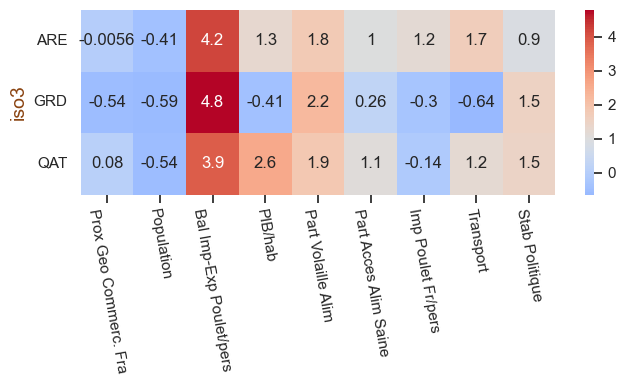

In [864]:
#modif visuel libellés x au dessus

# Création de la figure
fig, ax = plt.subplots(figsize=(7, 4))

# Heatmap
sns.heatmap(data=df_clust_5, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )

# Déplacement des labels de l'axe x en haut
ax.xaxis.set_ticks_position('bottom')    # Place les ticks en haut
ax.xaxis.set_label_position('bottom')    # Place le label (si présent) en haut
plt.yticks(rotation=0)
plt.xticks(rotation=-80)
plt.tight_layout()
plt.show()

In [871]:
df_clust_5_Classement = Classement(df_clust_5,0.99)
df_clust_5_Classement.head(10)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,Nb Score >0.99,Score total
iso3,,,,,,,,,,,
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,6,11.603840
QAT,0.079505,-0.542109,3.863432,2.588803,1.857434,1.088830,-0.135427,1.227254,1.455432,6,11.483155
GRD,-0.543051,-0.590531,4.783715,-0.407822,2.234919,0.255577,-0.304515,-0.639739,1.529801,3,6.318352


In [872]:
df_clust_5_Classement[['Nb Score >0.99','Score total']]

,Nb Score >0.99,Score total
iso3,,
ARE,6,11.603840
QAT,6,11.483155
GRD,3,6.318352


In [874]:
#Affichage des données centrées réduites des pays du cluster Clust
mask_temp = df_bis_quant.index.isin(liste_iso3)

df_bis_quant.loc[mask_temp,:] 


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
GRD,-7112.1,116913,57.456143,9509.250006,7.114045,78.9,0.0,2.5,86.25592
QAT,-4863.478,2892455,47.121445,87974.166043,6.392373,100.0,0.067244,3.8,84.360191


In [876]:
df_Etude_Marche_analyse_1_1.loc[df_Etude_Marche_analyse_1_1['iso3'].isin(['ARE','GRD','QAT']),:]

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
46,GRD,Grenade,America,-7112.1,116913,57.456143,9509.250006,7.114045,78.9,0.0,2.5,86.25592
93,QAT,Qatar,Asia,-4863.478,2892455,47.121445,87974.166043,6.392373,100.0,0.067244,3.8,84.360191


In [681]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

67147

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3tete-HORS CHN IND BEL NLD LUX -Clustering  sur données post ACP-sans CHN et IND </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3tete.1- classification hiérarchique ACH </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.1 - Préliminaires : </h4>
</div>

##### IMPORTS

##### DATA

Le jeu de données projeté avec l'ACP sur les 4 premières composantes

In [582]:
df_X_tete_proj_selec_PCA.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908


In [583]:
df_X_tete_proj_ACH=df_X_tete_proj_selec_PCA.copy(deep=True)
df_X_tete_proj_ACH.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908


In [584]:
df_X_tete_proj_ACH.shape

(107, 4)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.2 - Dendrogramme -ACH : </h4>
</div>

Effectuons une classification hiérarchique ascendante.

##### **CALCUL DES DISTANCES :**

Nous allons calculer les distances en spécifiant la méthode à utiliser: méthode de Ward adaptée à l'ACH.

In [585]:
Z = linkage(df_X_tete_proj_ACH, method="ward")
pd.DataFrame(Z)

,0,1,2,3
0,7.0,20.0,0.125876,2.0
1,61.0,64.0,0.241504,2.0
2,46.0,82.0,0.272848,2.0
3,15.0,74.0,0.300375,2.0
4,16.0,72.0,0.317263,2.0
...,...,...,...,...
101,201.0,207.0,8.887629,39.0
102,197.0,203.0,11.689290,47.0
103,206.0,209.0,12.316704,63.0
104,205.0,208.0,14.072852,44.0


In [586]:
Z.shape

(106, 4)

In [587]:
type(Z)

numpy.ndarray

##### **2. Dendogramme**

Nous pouvons désormais afficher le dendrogramme: 

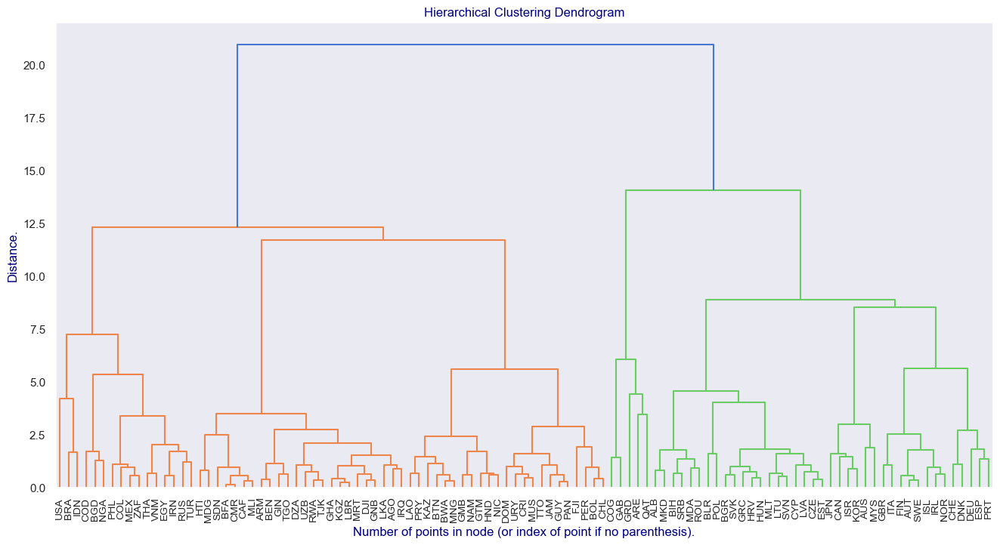

In [588]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_tete_proj_ACH.index)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
plt.show()

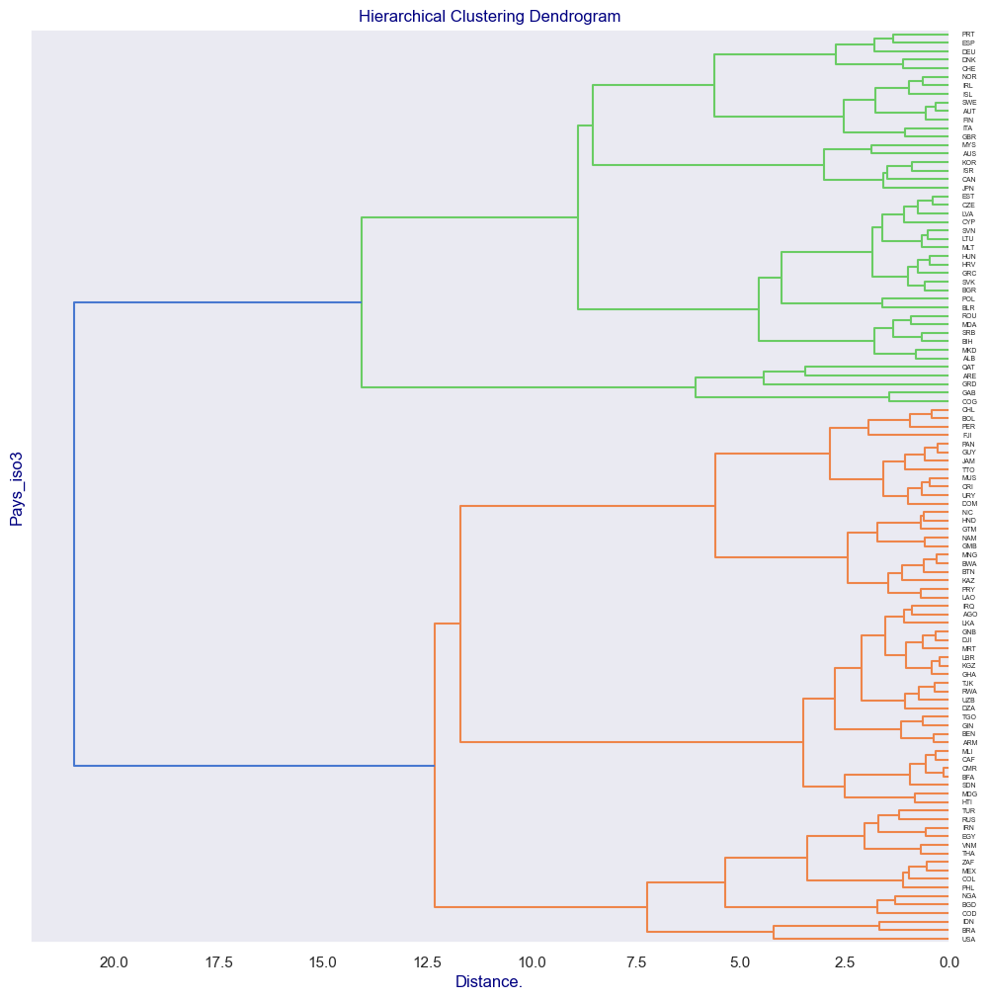

In [589]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

_ = dendrogram(Z, ax=ax,labels=df_X_tete_proj_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
plt.show()

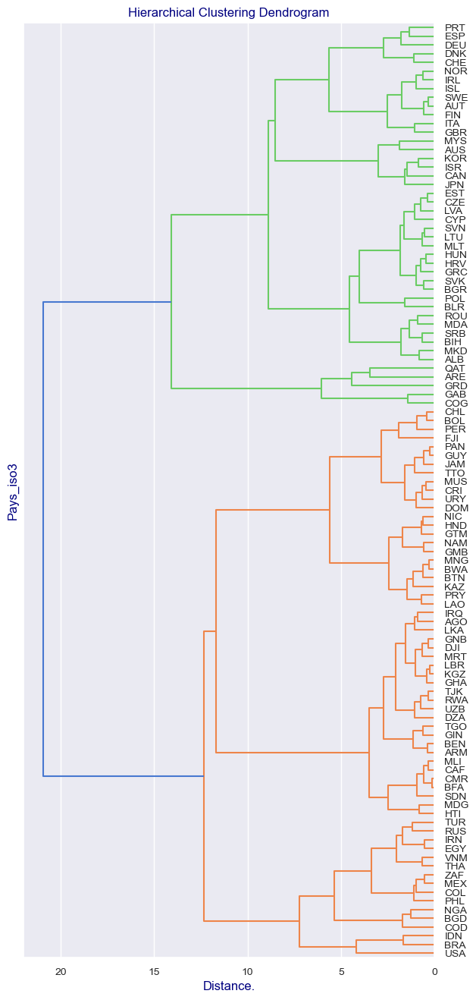

In [590]:
fig, ax = plt.subplots(1, 1, figsize=(7, 16))

_ = dendrogram(Z, ax=ax,labels=df_X_tete_proj_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

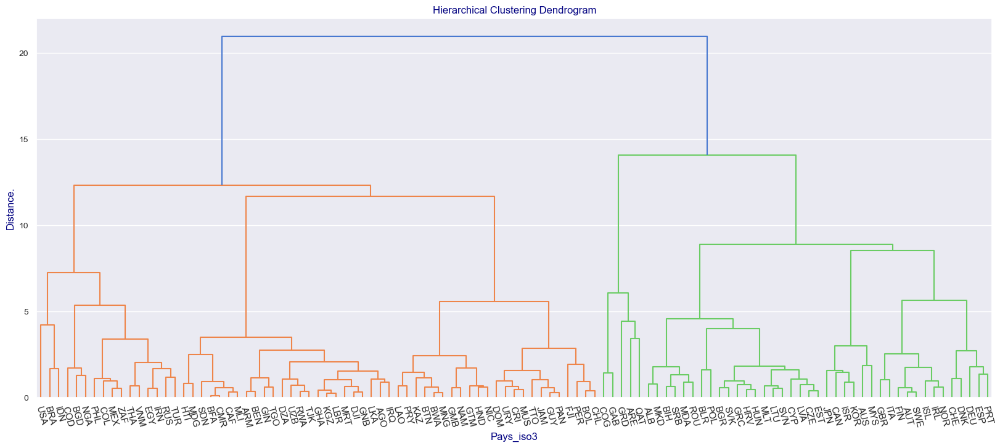

In [591]:
fig, ax = plt.subplots(1, 1, figsize=(20, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_tete_proj_ACH.index, orientation = "top")

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Pays_iso3")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=11,labelrotation =-75)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

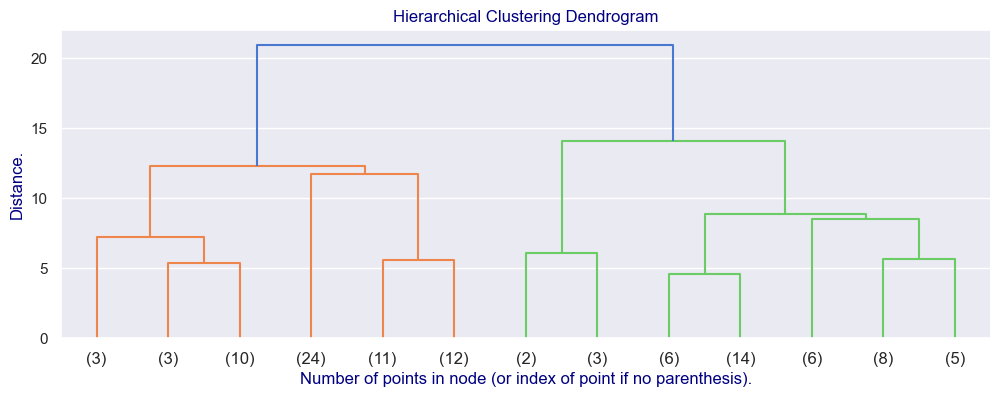

In [592]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=13, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=13 nombre au dessus duquel les distances intraclasse sont inférieur à 5

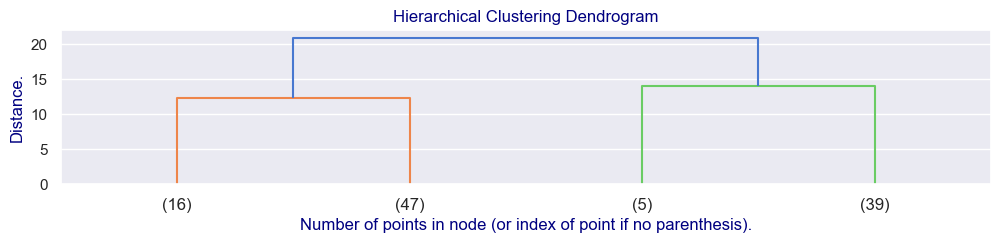

In [593]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 2))

_ = dendrogram(Z, p=4, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=4 nombre de clusters minimum pour voir apparaitre le groupe de 3 : BEL, NLD(Pays-Bas), LUX (Niveau de vie elevé/Commerce avec Fr)  
Emergence rapide de ce groupe témoignant de sa distinction des autes pays.

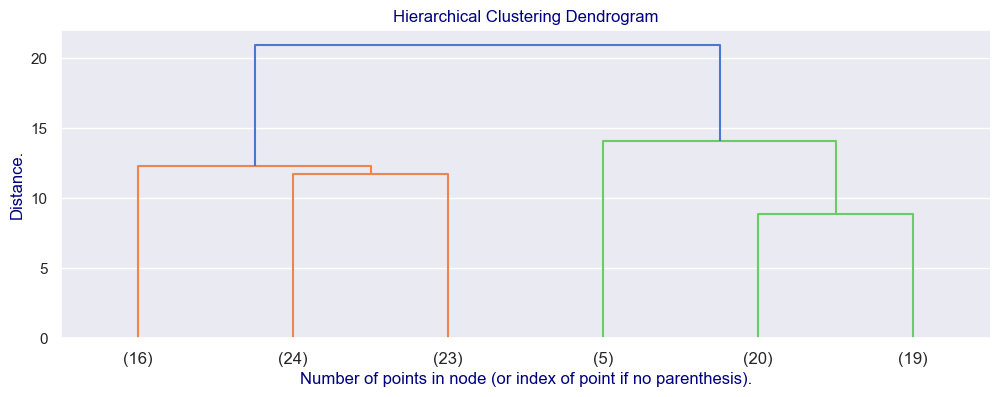

In [594]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de 3 : QAT, ARE, GRD(Grenade)

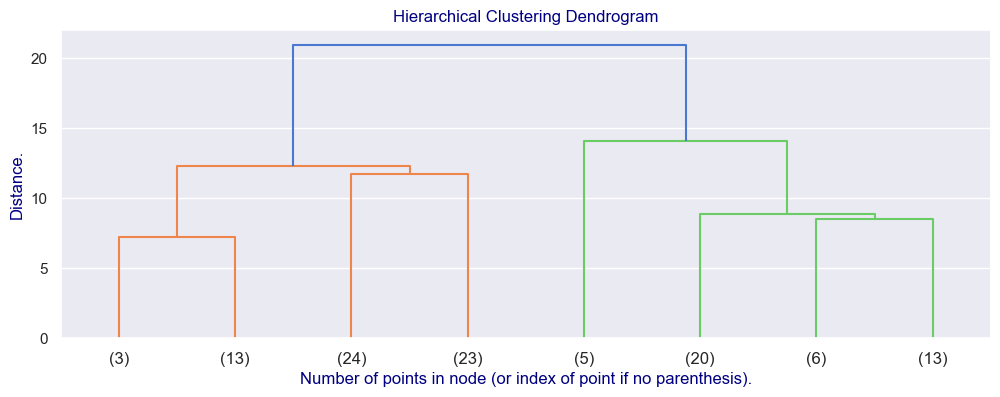

In [595]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=8, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=8 nombre de clusters minimum pour voir apparaitre le groupe de 3 : IDN(Indonésie), BRA, USA (poids de la population)

**AUTRE METHODE DE VISUALISATION (par le Nombre de noeuds) :**  
Ici j'ai des clusters qui ne sont issus que d'un noeud et d'autres de 2 noeuds.  
Je peux voir ce que ça peut donner si je prends ceux issu de 2 noeuds

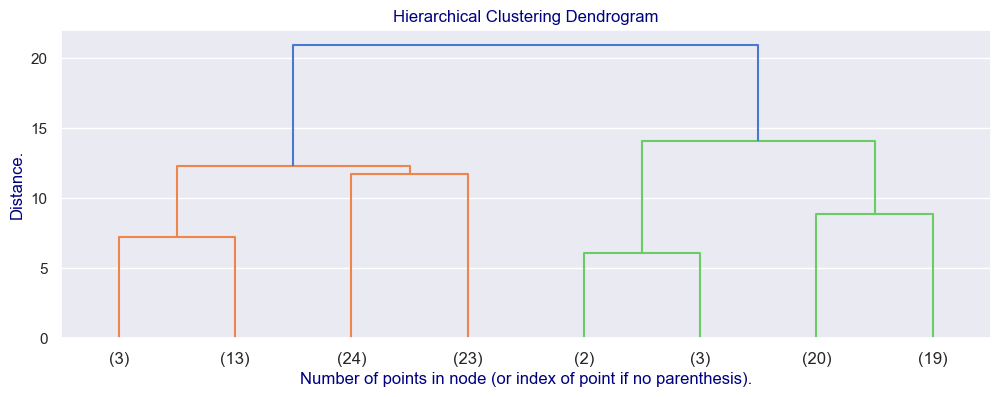

In [596]:
#  les arguments p=2, truncate_mode="level"signifient que l'on ne va afficher que les clusters issus de 2 noeuds.

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=2, truncate_mode="level", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**CHOIX DE NBRE DE CLUSTERS**  
A la lecture des Dendrogrammes, un nombre de clusters entre 6 et 8 semble pertinent.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.3 - Evaluation du nbre de cluster pertinent : Méthode de la silhouette : </h4>
</div>

Méthode du coude
Pertinent avec ACH ? ➤ ❌NON Pas directement.

Pourquoi ?

Le coude est basé sur l’inertie intra-cluster (minimisée dans K-means).

L’ACH ne repose pas sur l’inertie mais sur une distance de fusion (liaison simple, complète, moyenne…).

Le "coude" peut parfois être utilisé sur un graphe des distances de fusion (dans le dendrogramme), mais ce n’est pas la méthode standard.

Nombre de clusters : 2 — Score silhouette moyen : 0.30


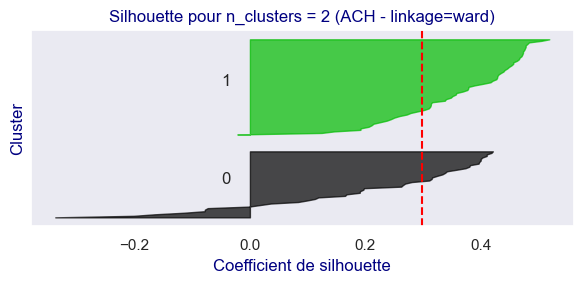

Nombre de clusters : 3 — Score silhouette moyen : 0.31


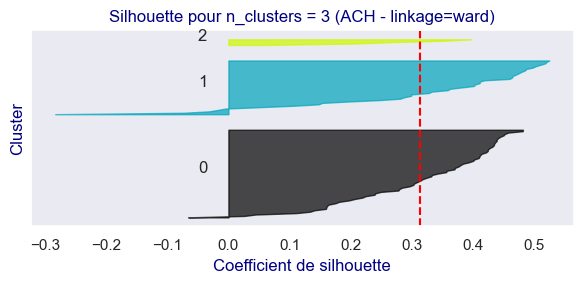

Nombre de clusters : 4 — Score silhouette moyen : 0.29


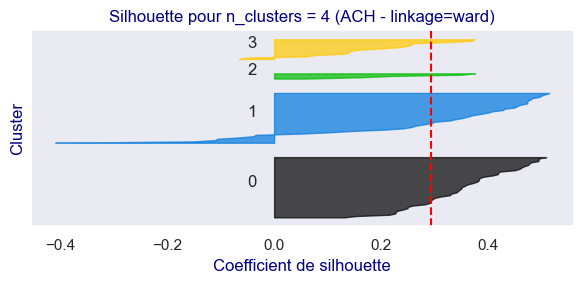

Nombre de clusters : 5 — Score silhouette moyen : 0.29


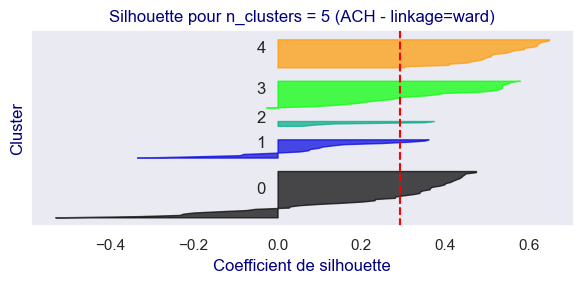

Nombre de clusters : 6 — Score silhouette moyen : 0.27


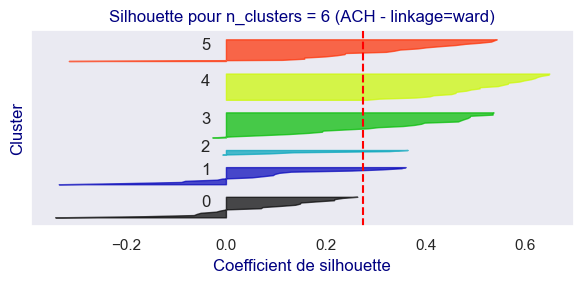

Nombre de clusters : 7 — Score silhouette moyen : 0.30


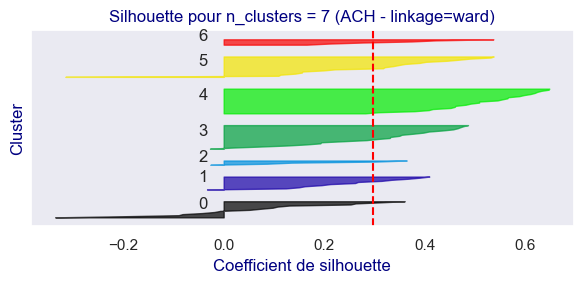

Nombre de clusters : 8 — Score silhouette moyen : 0.31


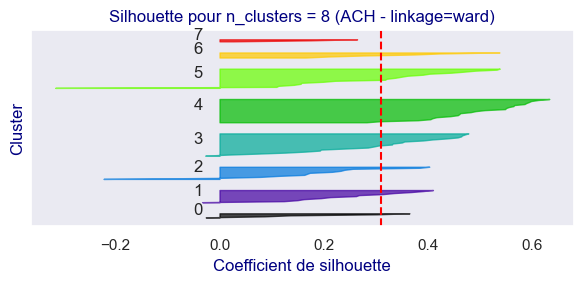

Nombre de clusters : 9 — Score silhouette moyen : 0.32


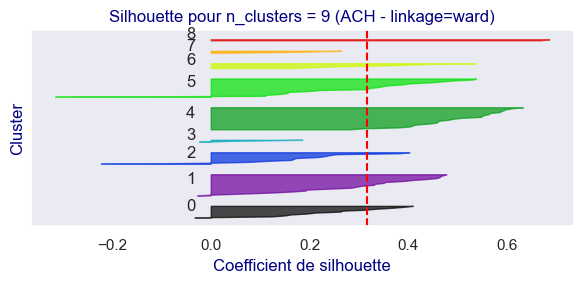

Nombre de clusters : 10 — Score silhouette moyen : 0.31


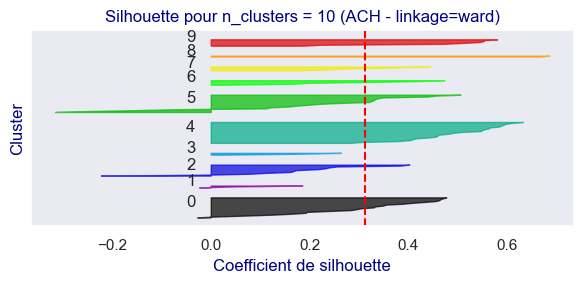

Nombre de clusters : 11 — Score silhouette moyen : 0.29


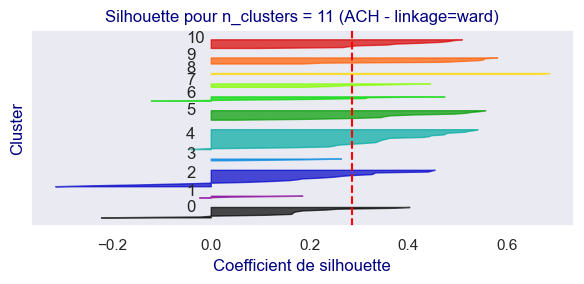

In [597]:
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import AgglomerativeClustering
#import matplotlib.pyplot as plt
#import numpy as np

X_temp = df_X_tete_proj_selec_PCA.copy()
range_nb_clust = range(2, 12)  # Par exemple de 2 à 14 clusters

for nb_clust in range_nb_clust:
    fig, ax = plt.subplots(figsize=(6, 3))

    # ✅ Utilisation de l'ACH (et non KMeans)
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    cluster_labels = cah.fit_predict(X_temp)

    # Score de silhouette moyen
    silhouette_avg = silhouette_score(X_temp, cluster_labels)
    print(f"Nombre de clusters : {nb_clust} — Score silhouette moyen : {silhouette_avg:.2f}")

    # Score silhouette par point
    sample_silhouette_values = silhouette_samples(X_temp, cluster_labels)

    y_lower = 10
    for i in range(nb_clust):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / nb_clust)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax.set_title(f"Silhouette pour n_clusters = {nb_clust} (ACH - linkage=ward)")
    ax.set_xlabel("Coefficient de silhouette")
    ax.set_ylabel("Cluster")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax.set_yticks([])
    plt.tight_layout()
    plt.show()


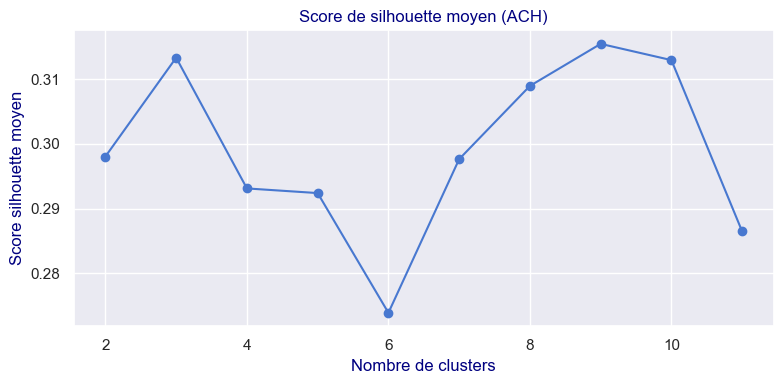

In [598]:
#graph de silhouette scores selon nombre de cluster

silhouette_scores = []

for nb_clust in range_nb_clust:
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    labels = cah.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (ACH)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


**K=9** permet d'avoir le meilleur score de silhouettte,  ce qui est cohérent avec le dendrogramme.   
C'est aussi un nombre raisonnable et analysable de clusters.

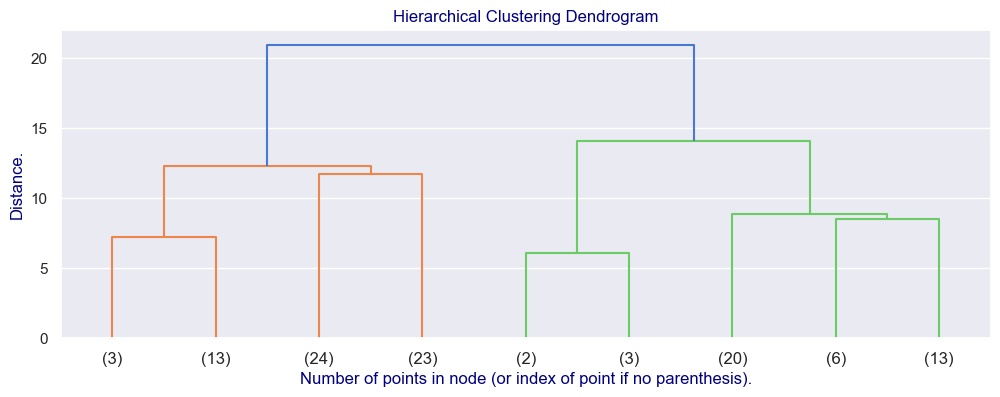

In [599]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=9, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

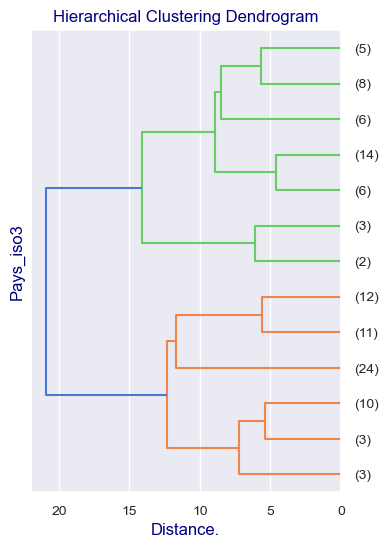

In [600]:
fig, ax = plt.subplots(1, 1, figsize=(4,6))

_ = dendrogram(Z, ax=ax,labels=df_X_tete_proj_ACH.index, orientation = "left", p=13, truncate_mode="lastp" )

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.4 - Clusters CAH : </h4>
</div>

##### **CLUSTERS CAH**

Pour définir les clusters, on peut utiliser `scipy` ou `scikit-learn`.

<u>Scikit-Learn</u>

On instancie un estimateur : 

In [601]:
n_clusters =9

In [602]:
cah = AgglomerativeClustering(n_clusters=n_clusters, linkage="ward")

On entraine l'estimateur : 

In [603]:
df_X_tete_proj_ACH.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908


In [604]:
cah.fit(df_X_tete_proj_ACH)

AgglomerativeClustering(n_clusters=9)

Regardons nos clusters : 

In [605]:
cah.labels_

array([4, 5, 3, 4, 6, 0, 4, 4, 2, 5, 5, 5, 1, 7, 1, 1, 4, 6, 0, 1, 4, 2,
       8, 2, 1, 5, 5, 0, 4, 0, 1, 4, 2, 0, 5, 0, 1, 8, 0, 4, 4, 1, 4, 5,
       3, 1, 1, 1, 5, 4, 5, 7, 0, 2, 4, 0, 6, 0, 1, 6, 1, 4, 6, 1, 4, 4,
       5, 5, 5, 4, 2, 5, 4, 5, 1, 4, 1, 6, 1, 2, 1, 0, 1, 1, 2, 5, 0, 1,
       3, 5, 2, 4, 4, 5, 5, 5, 0, 4, 2, 4, 1, 2, 1, 7, 4, 2, 2],
      dtype=int64)

-- **ATTENTION** --  
Ici, `0`,`1`...`7` est à considérer comme une variable catégorielle cardinale. Il n'y a pas d'ordre entre les clusters.

Le cluster `0` n'est pas *supérieur* au cluster `1` par exemple. Considérez que c'est plus un *id* qu'une *valeur*. 

Pour être plus clair, nous allons utiliser des lettres plutôt que des nombres: 


Ajoutons nos labels à `df_X_tete_proj_ACH`

In [606]:
df_X_tete_proj_ACH["labels"] = cah.labels_
df_X_tete_proj_ACH.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,4
ALB,0.534591,-1.482531,-0.777024,0.208646,5
ARE,4.305748,-3.922011,1.307070,3.195349,3
ARM,-1.108496,-1.395469,-0.676329,0.665314,4
AUS,2.304344,1.621174,2.924825,-0.796908,6


Observons nos clusters: 

In [607]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_tete_proj_ACH["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

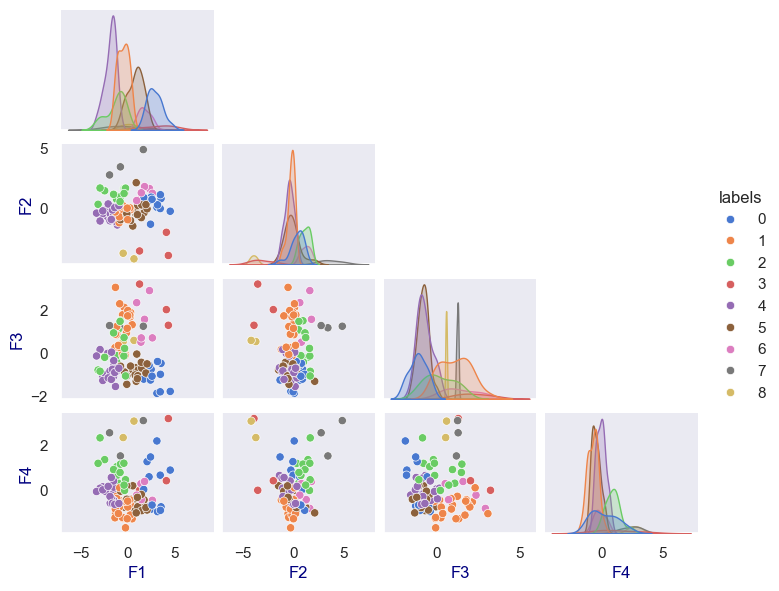

In [608]:
sns.pairplot(df_X_tete_proj_ACH, 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait 3 pouces de haut
             aspect=1.2
            )

In [609]:
#le Dataframe des cluster calculé par la moyenne
df_X_tete_proj_ACH_grouped = (df_X_tete_proj_ACH.groupby(by=['labels'])).mean()
df_X_tete_proj_ACH_grouped.index.name = 'cluster'
display(df_X_tete_proj_ACH_grouped)

,F1,F2,F3,F4
cluster,,,,
0,2.845546,0.332835,-1.118759,0.192863
1,-0.498078,-0.248953,1.117925,-0.775219
2,-1.260346,1.104791,0.191564,0.907219
3,3.217592,-3.157543,2.191338,1.212632
4,-1.856559,-0.438595,-0.735931,-0.068916
5,0.808203,-0.167607,-0.814372,-0.497379
6,1.746201,1.219392,1.471175,-0.190362
7,-0.353412,3.669606,1.247741,2.400943
8,0.085902,-3.968664,0.573377,2.715995


In [610]:
df_temp =df_X_tete_proj_ACH.copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,4
ALB,0.534591,-1.482531,-0.777024,0.208646,5
ARE,4.305748,-3.922011,1.307070,3.195349,3
ARM,-1.108496,-1.395469,-0.676329,0.665314,4
AUS,2.304344,1.621174,2.924825,-0.796908,6


In [611]:
df_temp_grouped = df_X_tete_proj_ACH_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,2.845546,0.332835,-1.118759,0.192863
1,-0.498078,-0.248953,1.117925,-0.775219
2,-1.260346,1.104791,0.191564,0.907219
3,3.217592,-3.157543,2.191338,1.212632
4,-1.856559,-0.438595,-0.735931,-0.068916


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.5 - Visualisation  : </h4>
</div>

In [612]:
df_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,4
ALB,0.534591,-1.482531,-0.777024,0.208646,5


In [613]:
df_temp_grouped.head(2)

,F1,F2,F3,F4
cluster,,,,
0,2.845546,0.332835,-1.118759,0.192863
1,-0.498078,-0.248953,1.117925,-0.775219


In [614]:
#CA fait doublon
# df pour la visualisation
#df = df_temp
#df_means = df_temp_grouped #le df à utiliser pour les visualisations

**Liste des pays**

In [615]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AUT  / CHE  / DEU  / DNK  / ESP  / FIN  / GBR  / IRL  / ISL  / ITA  / NOR  / PRT  / SWE 



cluster 1 :
BOL  / BTN  / BWA  / CHL  / CRI  / DOM  / FJI  / GMB  / GTM  / GUY  / HND  / JAM  / KAZ  / LAO  / MNG  / MUS  / NAM  / NIC  / PAN  / PER  / PRY  / TTO  / URY 



cluster 2 :
BGD  / COD  / COL  / EGY  / IRN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / VNM  / ZAF 



cluster 3 :
ARE  / GRD  / QAT 



cluster 4 :
AGO  / ARM  / BEN  / BFA  / CAF  / CMR  / DJI  / DZA  / GHA  / GIN  / GNB  / HTI  / IRQ  / KGZ  / LBR  / LKA  / MDG  / MLI  / MRT  / RWA  / SDN  / TGO  / TJK  / UZB 



cluster 5 :
ALB  / BGR  / BIH  / BLR  / CYP  / CZE  / EST  / GRC  / HRV  / HUN  / LTU  / LVA  / MDA  / MKD  / MLT  / POL  / ROU  / SRB  / SVK  / SVN 



cluster 6 :
AUS  / CAN  / ISR  / JPN  / KOR  / MYS 



cluster 7 :
BRA  / IDN  / USA 



cluster 8 :
COG  / GAB 





**HEATMAP**

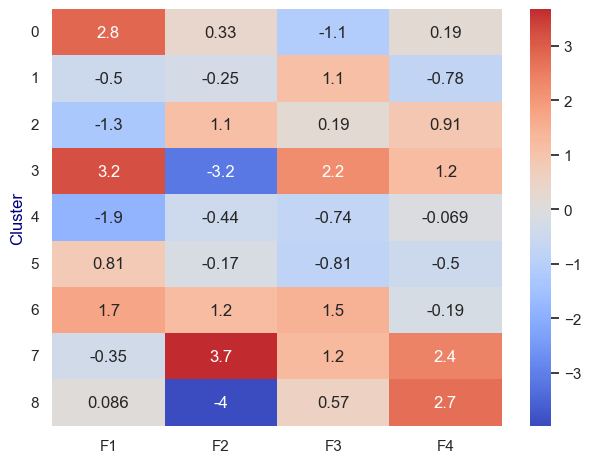

In [616]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            center =0,
            cmap='coolwarm'#pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  
Rappel PCA tete :
F1 => Niveau de Vie (35% de la variance) (Axe important pour le poulet bio)  
F2 => Pays de taille importante non consommateur de poulet en masse(17% de la variance)  
F3 => Pays éloigné avec part de poulet Alim (15% de la variance)  
F4 => Importateur de Poulet Francais (10% de la variance)+Taile du pays  
(F5 =>Pays Pauvre mais stables 76% de la variance)+Taile du pays  

Attention F2 n'est pas que un critère positif : taille +++ faibel consomatteur de poulet et F1 est neutre.

Regardons les critères qui dépassent 1 : 

cluster 0 : F1 fav  
cluster 1 : F3 fav  
cluster 2 : F2 fav  
**cluster 3 : F1, F3, F4 fav  =>Cluster +++ intéressant (PIB Importateur de poulet)**  
Cluster 4 :
Cluster 5 : 
Cluster 6 :F1, F2, F3  fav => cluster intéressant (vérifier dans les données d'origines)  
Cluster 7 : F2, F3, F4 => forte valeur sur F2 à vérifier (vérifier dans les données d'origines)
clsuter 8 : F4 mais forte valeur sur F2


**RADAR**

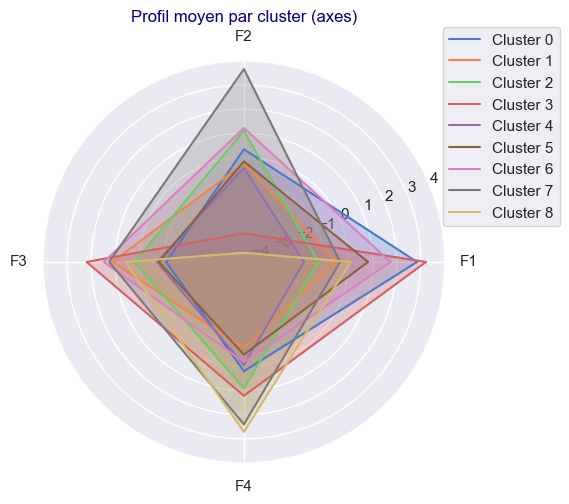

In [617]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


**ATTENTION L'AXE F2 n'est pas Favorable.**

##### Boxplot

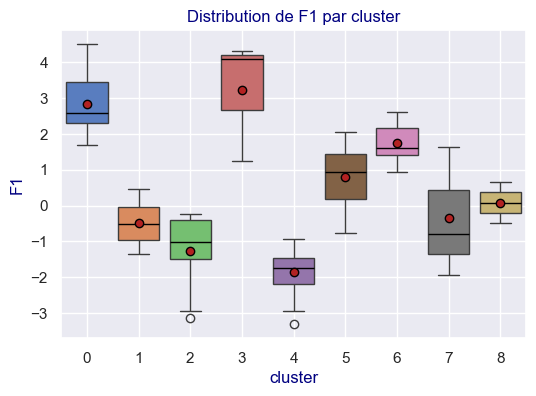

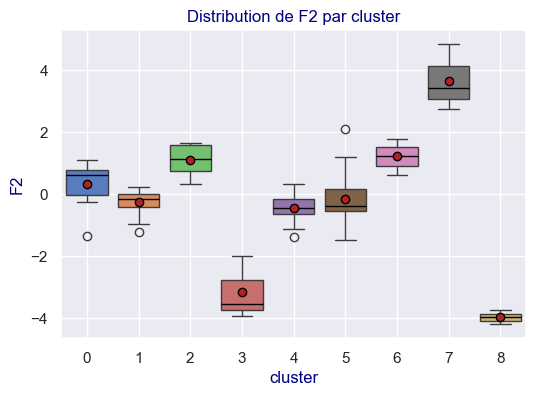

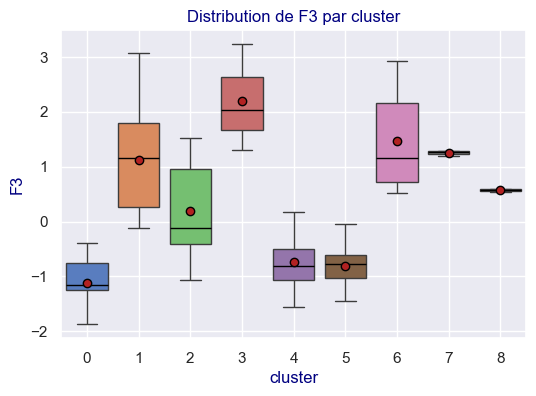

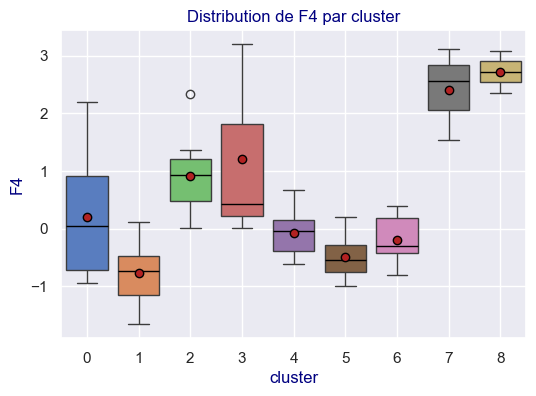

In [618]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [619]:
X_proj_temp = df_temp.copy()

In [620]:
X_proj_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,4
ALB,0.534591,-1.482531,-0.777024,0.208646,5
ARE,4.305748,-3.922011,1.307070,3.195349,3
ARM,-1.108496,-1.395469,-0.676329,0.665314,4
AUS,2.304344,1.621174,2.924825,-0.796908,6


In [621]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,2.845546,0.332835,-1.118759,0.192863
1,-0.498078,-0.248953,1.117925,-0.775219
2,-1.260346,1.104791,0.191564,0.907219
3,3.217592,-3.157543,2.191338,1.212632
4,-1.856559,-0.438595,-0.735931,-0.068916
5,0.808203,-0.167607,-0.814372,-0.497379
6,1.746201,1.219392,1.471175,-0.190362
7,-0.353412,3.669606,1.247741,2.400943
8,0.085902,-3.968664,0.573377,2.715995


In [622]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,2.845546,0.332835,-1.118759,0.192863,0
1,-0.498078,-0.248953,1.117925,-0.775219,1
2,-1.260346,1.104791,0.191564,0.907219,2
3,3.217592,-3.157543,2.191338,1.212632,3
4,-1.856559,-0.438595,-0.735931,-0.068916,4
5,0.808203,-0.167607,-0.814372,-0.497379,5
6,1.746201,1.219392,1.471175,-0.190362,6
7,-0.353412,3.669606,1.247741,2.400943,7
8,0.085902,-3.968664,0.573377,2.715995,8


Et on affiche le graphique pour F1 et F2 :

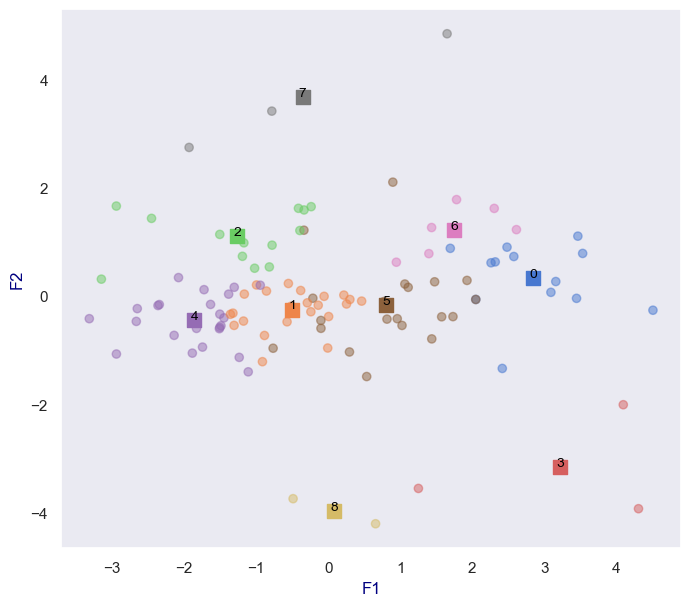

In [623]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


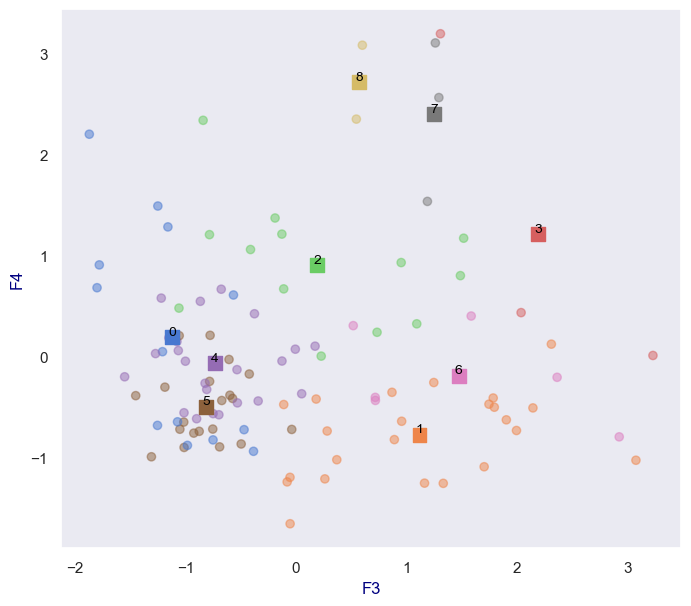

In [624]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

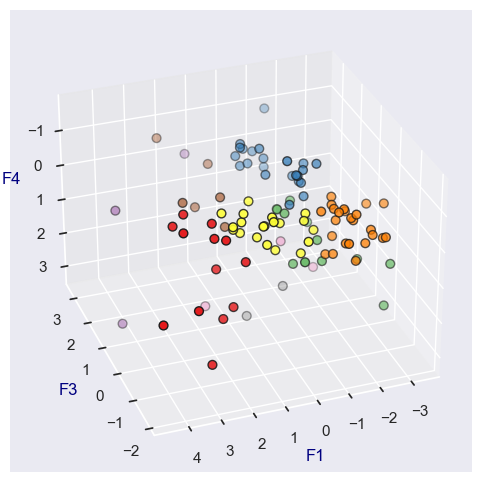

In [625]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

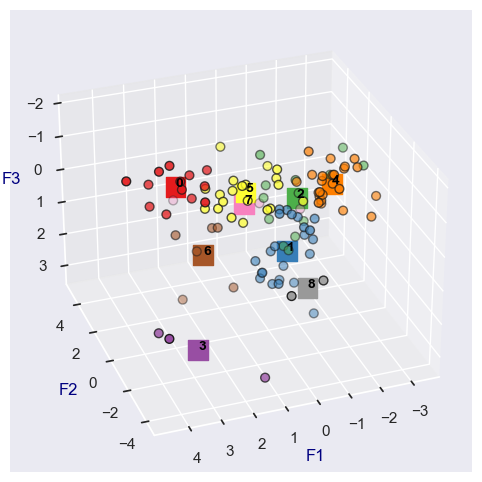

In [626]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [627]:
X_proj_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,4
ALB,0.534591,-1.482531,-0.777024,0.208646,5
ARE,4.305748,-3.922011,1.307070,3.195349,3
ARM,-1.108496,-1.395469,-0.676329,0.665314,4
AUS,2.304344,1.621174,2.924825,-0.796908,6


In [628]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,2.845546,0.332835,-1.118759,0.192863,0
1,-0.498078,-0.248953,1.117925,-0.775219,1
2,-1.260346,1.104791,0.191564,0.907219,2
3,3.217592,-3.157543,2.191338,1.212632,3
4,-1.856559,-0.438595,-0.735931,-0.068916,4


In [629]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [630]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [631]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [632]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.1.5 - Visualisation des données centrées réduites : </h4>
</div>

Le passage des données originelles centrées réduites aux données projetées est un passage d'une base orthonormée vers une base orthonormée.  
Elle est réversible (passage d'une base de 9v indépendants vers 9 vecteurs indépendants) et linéaire (puisque c'est un passage par matrice).  
Le passage dans un sens ou dans l'autre doit donc conserver les centre de gravités que sont les centroïdes.  

Mais attention si l'on calcule les centroïdes sur les données projetées mais réduites à quelques composantes principales, alors là on n'aura pas cette réversibilité. On ne pourra pas revenir en arrière à partir des centroïdes dans l'espace projetés.  

Cependant on a bien la linéarité des barycentre des points dans les données centrées réduites vers les données dans les 9 ACP,
puis dans la projection qui est une opération linéaire (mais pas réversible).

Cependant puisqu'on connait les données d'origines centrées réduites qui ont abouti à calculer les barycentres des données projetées sur nos 4 axes, 
on peut revenir en arrière à partir des pays et en calculant les barycentres.

A savori cependant que l'ACH ne s'est basée que sur nos 4 dimensions pour distinguer les clusters.  
Elle aurait peut-être pu être plus efficace en se basant sur les 9 dimensions (de la PCA ou des données centrées réduites)


ATTENTION :  
La linéarité ne concerne pas l'opération de centrage réduction.  
Le centrage est une opération affine.

Remarque :  
Lorsque l'on fait le clustering sur les données après PCA, on a perdu des informations.  
Quel est donc l'avantage de faire le clustering sur les données après PCA :  
- si les données sont volumineuses, cela permet de réduire la lourdeur du clustering (ce n'est pas le cas ici avec 120 pays)
- cela permet aussi de réduire le bruit.

Le clustering sur les données centrées réduites : 
- permet de faire le clustering sur les informations complètes
- peut êter délicat (si informations volumineuses)
- ne masque pas trop le bruit des corrélations (bien que cela dépende des qualités de l'algorithme)

Attention ne pas faire le clustering sur les données brutes :
- les variables avec des chiffres plus élevées risquent de prendre un peu surdimensionné.

In [633]:
df_X_tete_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [634]:
#Mappons df_X_tete_scaled avec nos labels
df_X_tete_scaled_ACH = df_X_tete_scaled.join(df_temp["labels"])
df_X_tete_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,4
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,5
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,3
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572,4
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200,6


In [635]:
df_X_tete_scaled_ACH_grouped = (df_X_tete_scaled_ACH.groupby(by=['labels'])).mean()
df_X_tete_scaled_ACH_grouped.index.name = 'cluster'
display(df_X_tete_scaled_ACH_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.151449,-0.171690,-0.280301,1.767189,-0.090495,0.984064,0.983680,1.473354,1.048349
1,-0.975022,-0.463962,-0.028322,-0.412568,0.524162,-0.141125,-0.451848,-0.578480,0.397446
2,-0.413023,1.337132,-0.326682,-0.520212,-0.196334,-0.341576,-0.439264,-0.002105,-1.083167
3,-0.121109,-0.521343,4.431357,1.325317,1.929800,0.811247,1.281215,0.805080,1.324046
4,0.101335,-0.259828,-0.056003,-0.687315,-0.976741,-1.013144,-0.230887,-0.903149,-0.957921
5,1.037753,-0.475550,-0.134934,-0.035905,-0.071518,0.678150,0.062552,0.216961,0.439211
6,-1.109960,0.223665,-0.200148,1.030935,1.066124,0.881124,-0.456579,1.585985,0.569343
7,-1.073685,4.179454,-1.358289,0.473171,0.658391,0.096653,-0.459161,0.609854,-0.458668
8,-0.058479,-0.524521,2.283317,-0.544525,1.191930,-1.182233,3.939319,-1.122779,-0.247475


Travaillons sur des copies :

In [636]:
df_temp = df_X_tete_scaled_ACH.copy()
df_temp_grouped = df_X_tete_scaled_ACH_grouped.copy()

In [637]:
df_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,4
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,5


In [638]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.151449,-0.171690,-0.280301,1.767189,-0.090495,0.984064,0.983680,1.473354,1.048349
1,-0.975022,-0.463962,-0.028322,-0.412568,0.524162,-0.141125,-0.451848,-0.578480,0.397446


**Liste des pays**

In [639]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AUT  / CHE  / DEU  / DNK  / ESP  / FIN  / GBR  / IRL  / ISL  / ITA  / NOR  / PRT  / SWE 



cluster 1 :
BOL  / BTN  / BWA  / CHL  / CRI  / DOM  / FJI  / GMB  / GTM  / GUY  / HND  / JAM  / KAZ  / LAO  / MNG  / MUS  / NAM  / NIC  / PAN  / PER  / PRY  / TTO  / URY 



cluster 2 :
BGD  / COD  / COL  / EGY  / IRN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / VNM  / ZAF 



cluster 3 :
ARE  / GRD  / QAT 



cluster 4 :
AGO  / ARM  / BEN  / BFA  / CAF  / CMR  / DJI  / DZA  / GHA  / GIN  / GNB  / HTI  / IRQ  / KGZ  / LBR  / LKA  / MDG  / MLI  / MRT  / RWA  / SDN  / TGO  / TJK  / UZB 



cluster 5 :
ALB  / BGR  / BIH  / BLR  / CYP  / CZE  / EST  / GRC  / HRV  / HUN  / LTU  / LVA  / MDA  / MKD  / MLT  / POL  / ROU  / SRB  / SVK  / SVN 



cluster 6 :
AUS  / CAN  / ISR  / JPN  / KOR  / MYS 



cluster 7 :
BRA  / IDN  / USA 



cluster 8 :
COG  / GAB 





**HEATMAP**

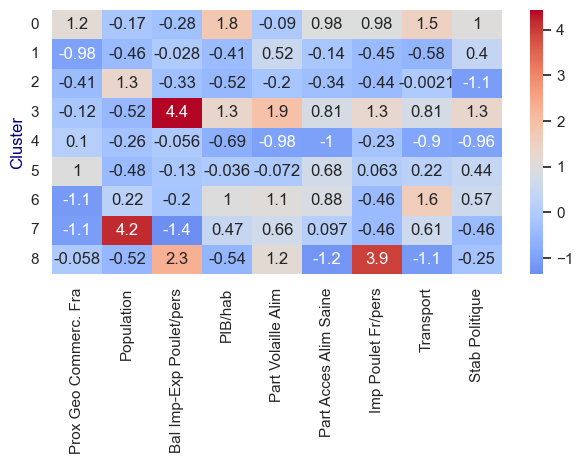

In [640]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

Cluster 0 : intéressant 
- fav : Prox Géo, PIB/hab, Alim_Saine,Imp_Poulet_Transport, Stab Politique

**Cluster 3 : très intéressant**
- très Fav : Imp Poulet
- fav : PIB/hab, Consomm_Volaill, Imp_Poulet_Fr, Stab  Pol
- léger fav : Alim_Saine, Transport
  
Cluster 6 : faiblement intéressant
- fav PIB/hab, Part_Volaille, transport
- leger fav : Alim_Saine

Cluster 8 : faibelemnt intéressant ( import de poulet mais peu de gens ont accès à une alimentation saine)
- très fav : Imp_Poulet Fr
-fav : Imp_Poulet_international, Part_Volaille
-défav : Alim Saine

**RADAR**

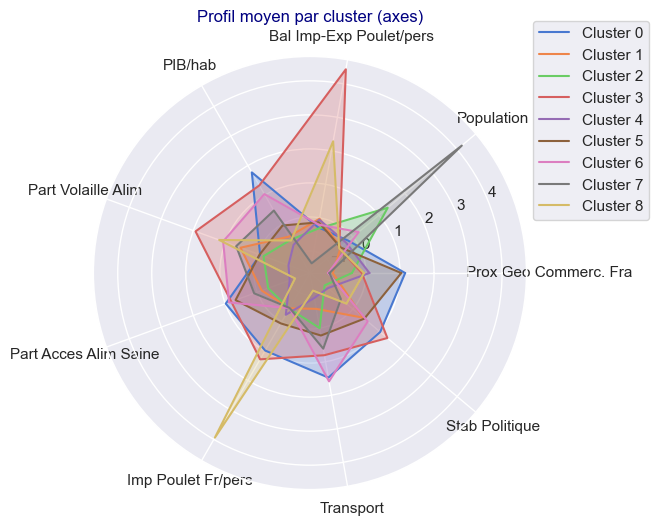

In [641]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

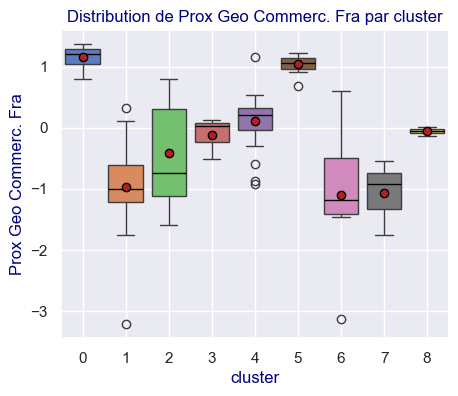

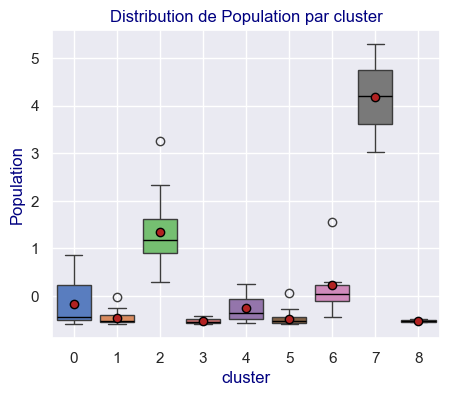

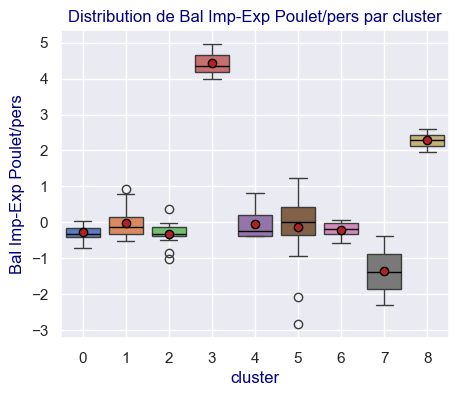

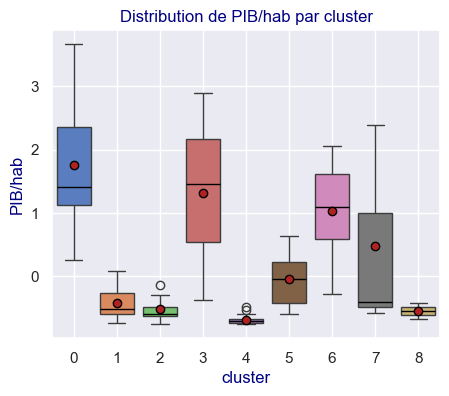

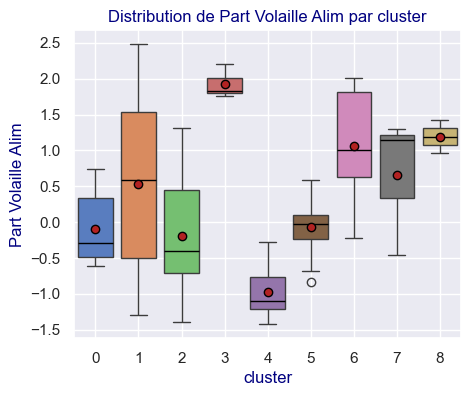

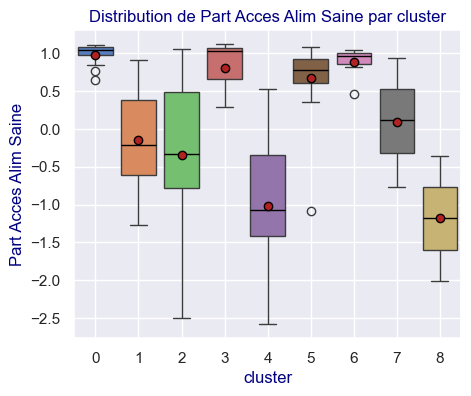

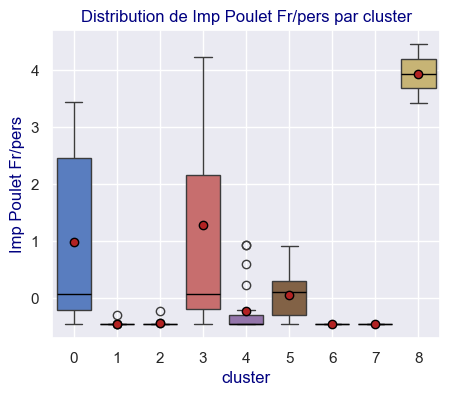

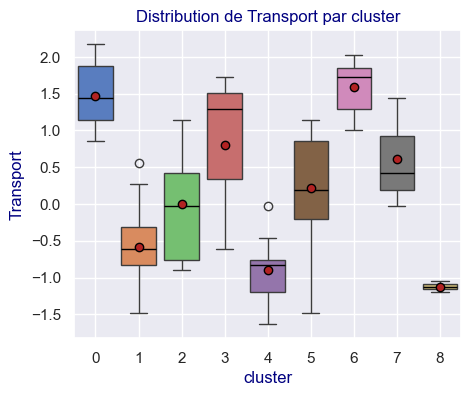

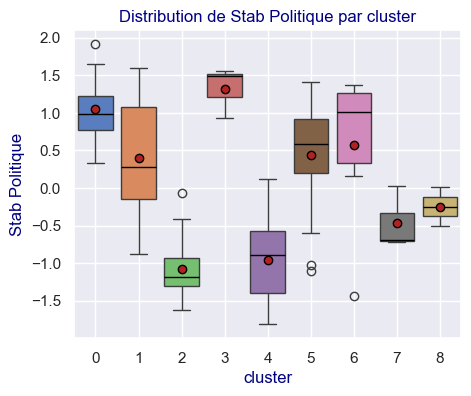

In [642]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3tete.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

In [643]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import KMeans

##### DATA :

In [644]:
df_X_tete_proj_selec_PCA.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908


In [645]:
df_X_tete_proj_KM=df_X_tete_proj_selec_PCA.copy(deep=True)
df_X_tete_proj_KM.head()

,F1,F2,F3,F4
iso3,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297
ALB,0.534591,-1.482531,-0.777024,0.208646
ARE,4.305748,-3.922011,1.307070,3.195349
ARM,-1.108496,-1.395469,-0.676329,0.665314
AUS,2.304344,1.621174,2.924825,-0.796908


In [646]:
df_X_tete_proj_KM.shape

(107, 4)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [647]:
n_clusters=6

In [648]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [649]:
kmeans.fit(df_X_tete_proj_KM)

KMeans(n_clusters=6)

On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [650]:
kmeans.inertia_

238.62035475121115

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

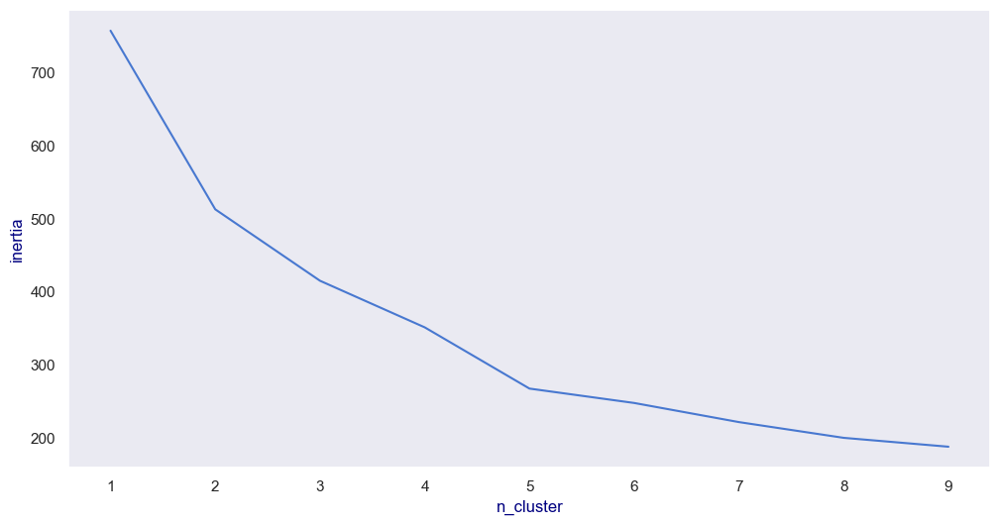

In [651]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 10)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_tete_proj_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(12,6))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
2 et 5 semblent revenir.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2.4- Methode de la silhouette sur le K-means </h4>
</div>

##### JOLI Mais pas très pratique :

##### FIN JOLI Mais pas très pratique :

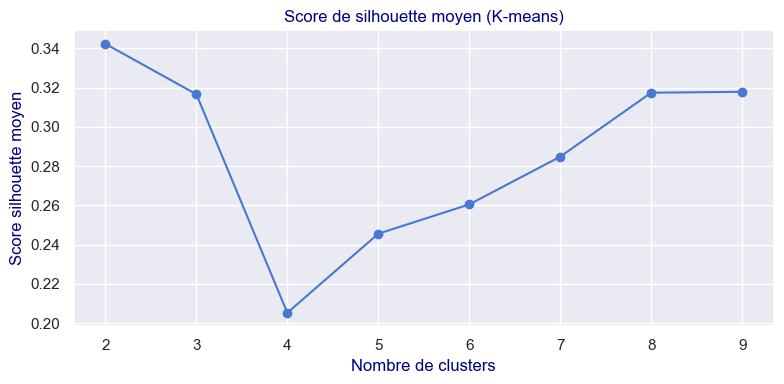

In [652]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_tete_proj_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 10)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
Les scores ne sont tous pas très élevé et compris entre 0.20 et 0.35 donnnées moyennemnt structurées.  
2, 3 8, et 9 semblent le nb de clusters donnnant les meilleurs résultats.  

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3tete.2one - K-means Test à 2 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [653]:
n_clusters=2

In [654]:
df_X_tete_proj_KM_N_temp =df_X_tete_proj_KM.copy()

In [655]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_tete_proj_KM_N_temp  )

KMeans(n_clusters=2)

Voici les clusters : 

In [656]:
kmeans.labels_

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [657]:
pd.Series(kmeans.labels_).value_counts()

0    102
1      5
Name: count, dtype: int64

Ajoutons nos labels à `df_X_tete_proj_KM_N_temp  `

In [658]:
df_X_tete_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_tete_proj_KM_N_temp  

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0
ALB,0.534591,-1.482531,-0.777024,0.208646,0
ARE,4.305748,-3.922011,1.307070,3.195349,1
ARM,-1.108496,-1.395469,-0.676329,0.665314,0
AUS,2.304344,1.621174,2.924825,-0.796908,0
...,...,...,...,...,...
URY,-0.056113,-0.002044,1.163132,-1.255348,0
USA,1.650223,4.845146,1.261062,3.104383,0
UZB,-0.941468,0.203175,-0.697565,-0.578076,0


Affichons cela de façon graphique :

In [659]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_tete_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

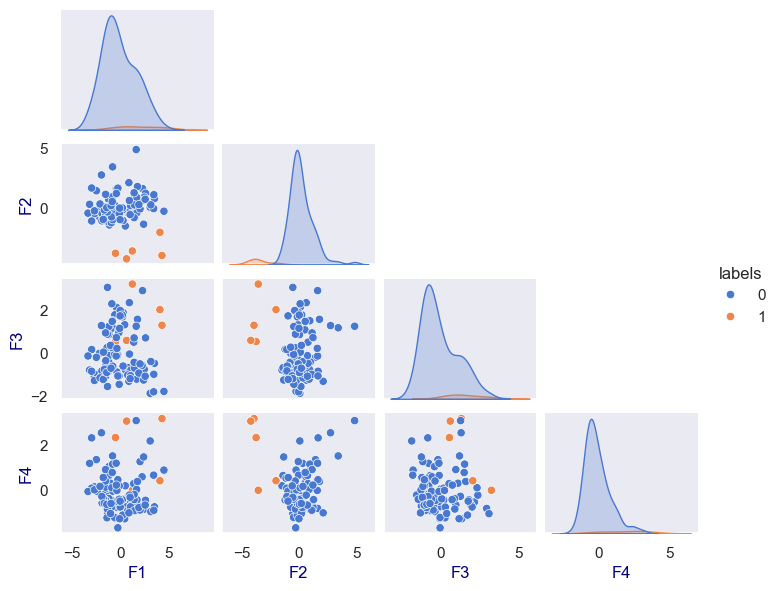

In [660]:
sns.pairplot(df_X_tete_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait x pouces de haut
             aspect=1.2)

F1 est ce qui difféencie le plsu les 2 groupes

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2one.2 - Interprétation: </h4>
</div>

In [661]:
df_X_tete_proj_KM_N_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0
ALB,0.534591,-1.482531,-0.777024,0.208646,0


CENTRE DE GRAVITE :

In [662]:
df_X_tete_proj_KM_N_temp_grouped = (df_X_tete_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_tete_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_tete_proj_KM_N_temp_grouped)

,F1,F2,F3,F4
cluster,,,,
0,-0.096319,0.170686,-0.075694,-0.088920
1,1.964916,-3.481992,1.544153,1.813977


LES CENTROIDES :

In [663]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-0.09631941,  0.17068586, -0.07569378, -0.08892045],
       [ 1.96491589, -3.48199156,  1.5441532 ,  1.81397719]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [664]:
df_temp = df_X_tete_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0
ALB,0.534591,-1.482531,-0.777024,0.208646,0
ARE,4.305748,-3.922011,1.307070,3.195349,1
ARM,-1.108496,-1.395469,-0.676329,0.665314,0
AUS,2.304344,1.621174,2.924825,-0.796908,0


In [665]:
df_temp_grouped =df_X_tete_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,-0.096319,0.170686,-0.075694,-0.088920
1,1.964916,-3.481992,1.544153,1.813977


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2one.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [666]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ALB  / ARM  / AUS  / AUT  / BEN  / BFA  / BGD  / BGR  / BIH  / BLR  / BOL  / BRA  / BTN  / BWA  / CAF  / CAN  / CHE  / CHL  / CMR  / COD  / COL  / CRI  / CYP  / CZE  / DEU  / DJI  / DNK  / DOM  / DZA  / EGY  / ESP  / EST  / FIN  / FJI  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IDN  / IRL  / IRN  / IRQ  / ISL  / ISR  / ITA  / JAM  / JPN  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MEX  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NGA  / NIC  / NOR  / PAN  / PER  / PHL  / POL  / PRT  / PRY  / ROU  / RUS  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / USA  / UZB  / VNM  / ZAF 



cluster 1 :
ARE  / COG  / GAB  / GRD  / QAT 





**HEATMAP**

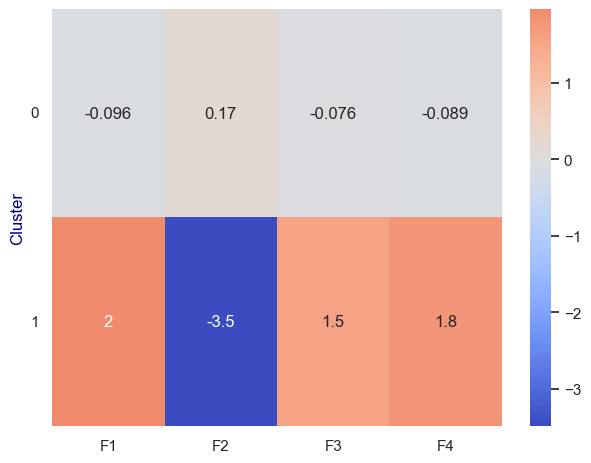

In [667]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

La distinction se fait uniquement sur le niveau de vie... pas très intéressant !!!

**RADAR**

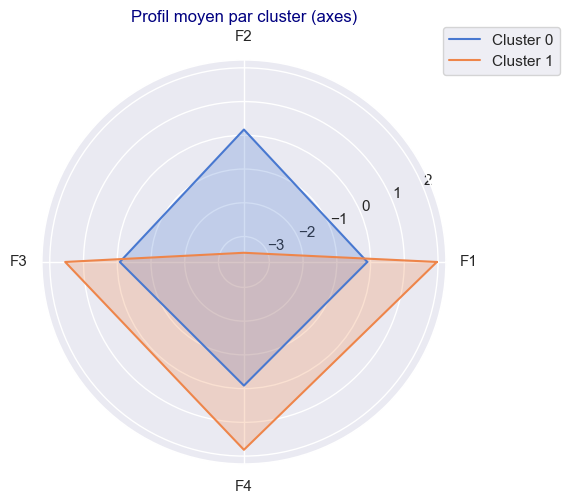

In [668]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

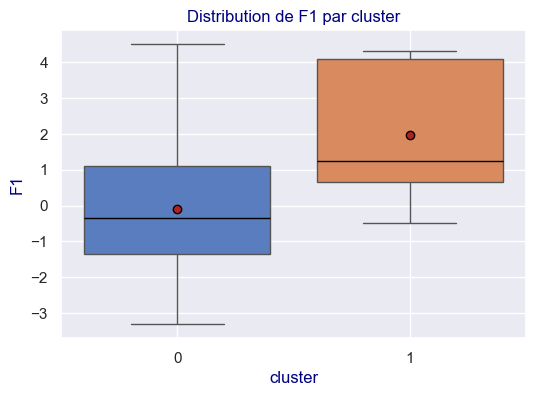

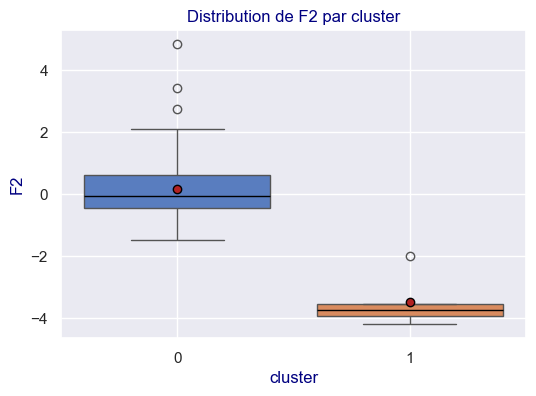

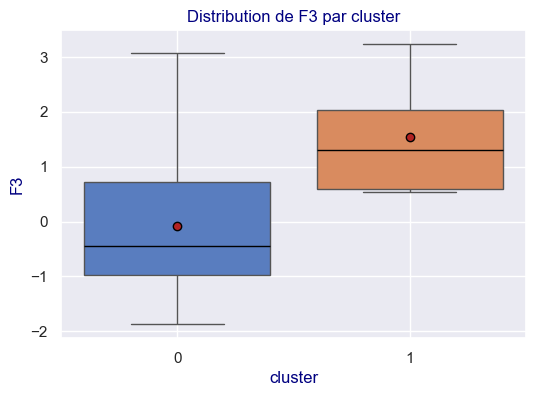

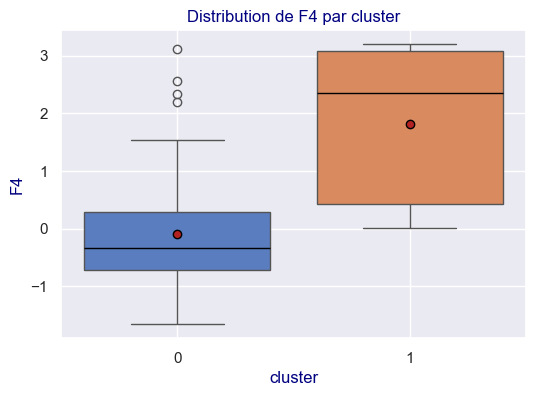

In [669]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [670]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0
ALB,0.534591,-1.482531,-0.777024,0.208646,0


In [671]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,-0.096319,0.170686,-0.075694,-0.088920
1,1.964916,-3.481992,1.544153,1.813977


In [672]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,-0.096319,0.170686,-0.075694,-0.088920,0
1,1.964916,-3.481992,1.544153,1.813977,1


Et on affiche le graphique pour F1 et F2 :

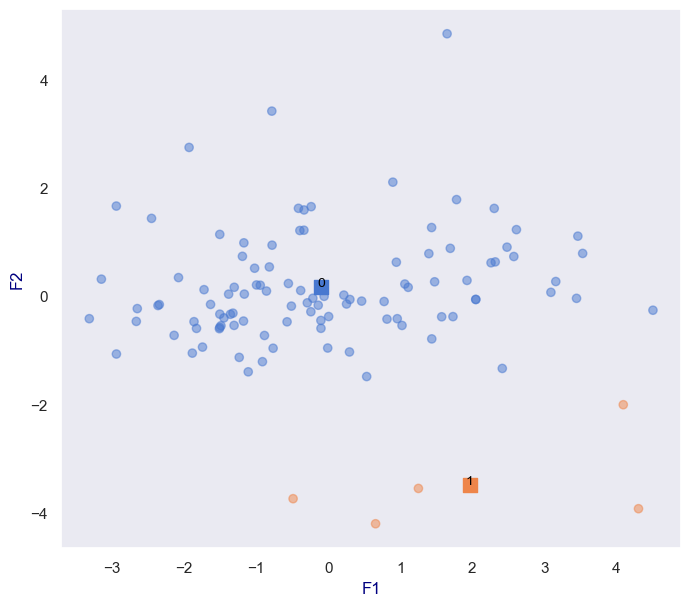

In [673]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


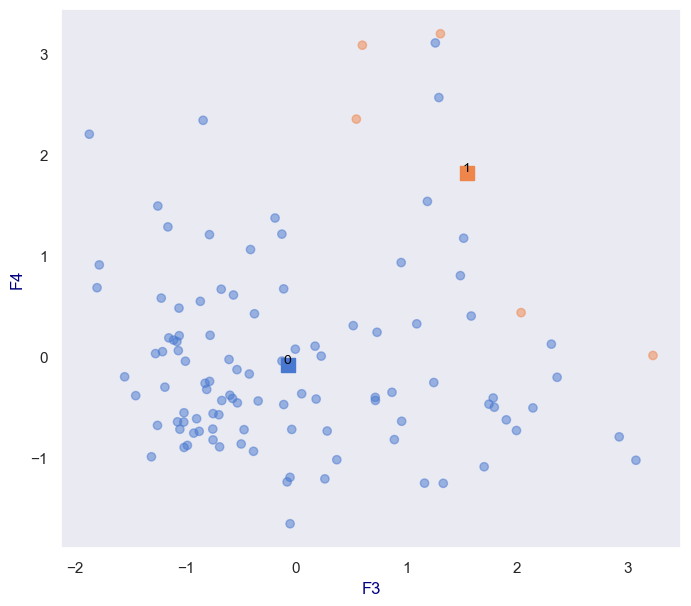

In [674]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

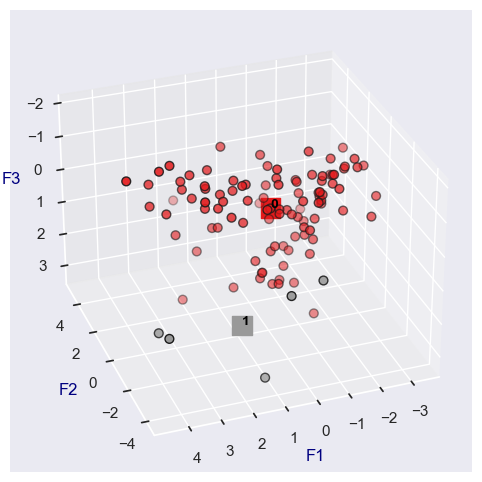

In [675]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [676]:
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,0
ALB,0.534591,-1.482531,-0.777024,0.208646,0


In [677]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,-0.096319,0.170686,-0.075694,-0.088920,0
1,1.964916,-3.481992,1.544153,1.813977,1


In [678]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [679]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [680]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2one.3 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 3.1.15

In [681]:
df_X_tete_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [682]:
#Mappons df_X_tete_scaled avec nos labels
df_X_tete_scaled_KM_N_temp = df_X_tete_scaled.join(df_temp["labels"])
df_X_tete_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,0
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,0
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,1
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572,0
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200,0


In [683]:
df_X_tete_scaled_KM_N_temp_grouped = (df_X_tete_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_tete_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_tete_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,0.004709,0.025618,-0.175105,-0.028303,-0.080130,-0.000679,-0.114924,-0.001664,-0.034090
1,-0.096057,-0.522614,3.572141,0.577380,1.634652,0.013855,2.344457,0.033937,0.695438


Travaillons sur des copies :

In [684]:
df_temp = df_X_tete_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_tete_scaled_KM_N_temp_grouped.copy()

In [685]:
df_temp.head(5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,0
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,0
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,1
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572,0
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200,0


In [686]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,0.004709,0.025618,-0.175105,-0.028303,-0.080130,-0.000679,-0.114924,-0.001664,-0.034090
1,-0.096057,-0.522614,3.572141,0.577380,1.634652,0.013855,2.344457,0.033937,0.695438


**Liste des pays (Vérification)**

In [687]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ALB  / ARM  / AUS  / AUT  / BEN  / BFA  / BGD  / BGR  / BIH  / BLR  / BOL  / BRA  / BTN  / BWA  / CAF  / CAN  / CHE  / CHL  / CMR  / COD  / COL  / CRI  / CYP  / CZE  / DEU  / DJI  / DNK  / DOM  / DZA  / EGY  / ESP  / EST  / FIN  / FJI  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IDN  / IRL  / IRN  / IRQ  / ISL  / ISR  / ITA  / JAM  / JPN  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MEX  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NGA  / NIC  / NOR  / PAN  / PER  / PHL  / POL  / PRT  / PRY  / ROU  / RUS  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / USA  / UZB  / VNM  / ZAF 



cluster 1 :
ARE  / COG  / GAB  / GRD  / QAT 





**HEATMAP**

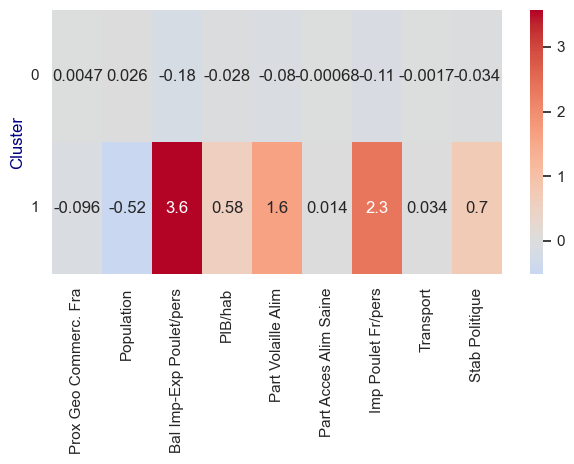

In [688]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =0 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

Confirmation :  
dans le cluster 0 il y a un fort niveau de vie, mais ce n'est pas uffisant, car sur la consomarion de poulet, c'est assez neutre

**RADAR**

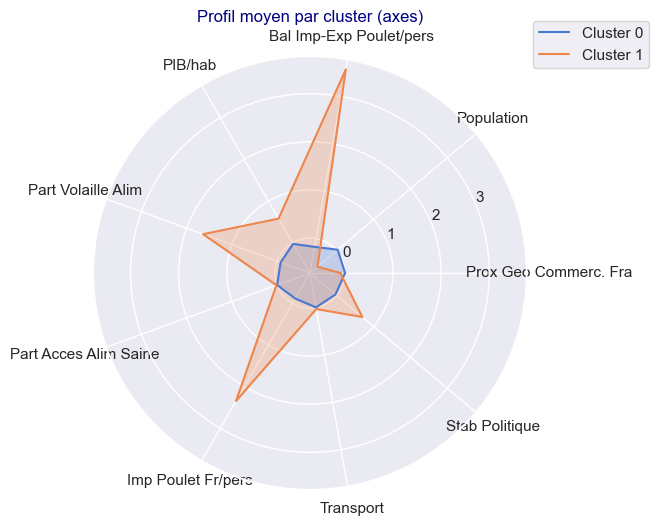

In [689]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

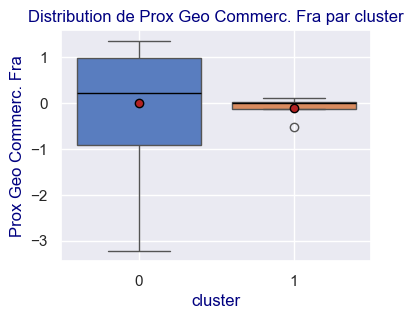

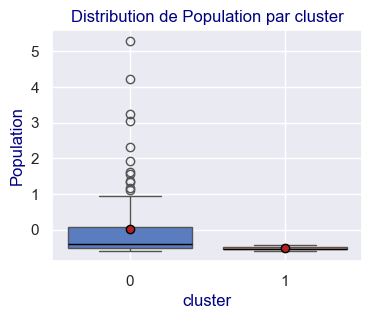

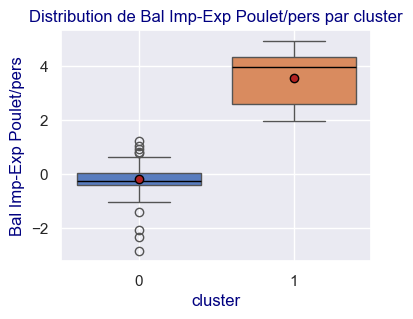

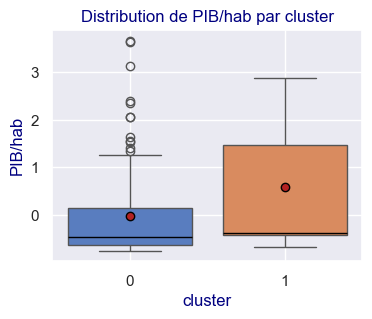

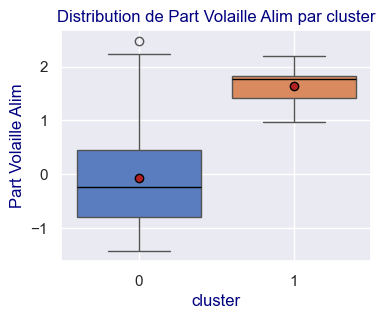

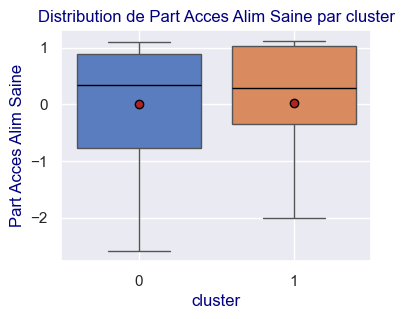

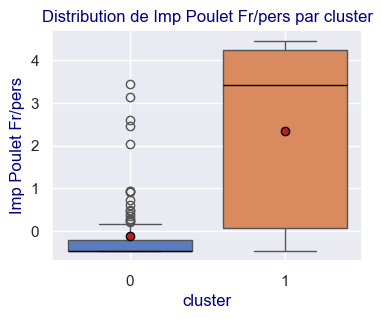

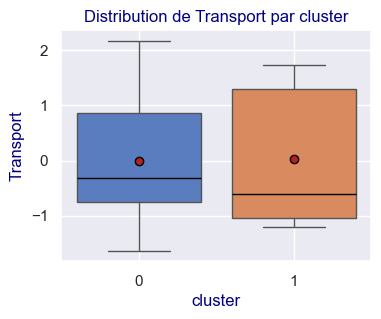

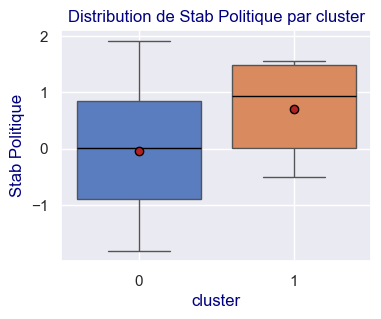

In [690]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3tete.2bis - K-means Test à 9 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2bis.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [691]:
n_clusters=9

In [692]:
df_X_tete_proj_KM_N_temp =df_X_tete_proj_KM.copy()

In [693]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_tete_proj_KM_N_temp  )

KMeans(n_clusters=9)

Voici les clusters : 

In [694]:
kmeans.labels_

array([2, 0, 5, 2, 3, 8, 2, 2, 7, 0, 4, 4, 3, 1, 4, 4, 2, 8, 6, 3, 2, 2,
       5, 7, 3, 0, 0, 6, 2, 6, 3, 2, 7, 6, 0, 8, 3, 5, 8, 2, 2, 4, 2, 0,
       5, 3, 3, 4, 0, 2, 0, 1, 8, 7, 2, 8, 8, 8, 3, 8, 4, 4, 8, 4, 4, 4,
       0, 0, 4, 2, 7, 0, 2, 8, 4, 2, 3, 3, 4, 7, 4, 8, 3, 3, 7, 8, 6, 4,
       6, 0, 7, 2, 2, 0, 0, 8, 8, 2, 7, 4, 3, 7, 3, 1, 4, 7, 7])

In [695]:
pd.Series(kmeans.labels_).value_counts()

2    20
4    18
3    15
8    15
0    14
7    12
6     6
5     4
1     3
Name: count, dtype: int64

Ajoutons nos labels à `df_X_tete_proj_KM_N_temp  `

In [696]:
df_X_tete_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_tete_proj_KM_N_temp  

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,2
ALB,0.534591,-1.482531,-0.777024,0.208646,0
ARE,4.305748,-3.922011,1.307070,3.195349,5
ARM,-1.108496,-1.395469,-0.676329,0.665314,2
AUS,2.304344,1.621174,2.924825,-0.796908,3
...,...,...,...,...,...
URY,-0.056113,-0.002044,1.163132,-1.255348,3
USA,1.650223,4.845146,1.261062,3.104383,1
UZB,-0.941468,0.203175,-0.697565,-0.578076,4


Affichons cela de façon graphique :

In [697]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_tete_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

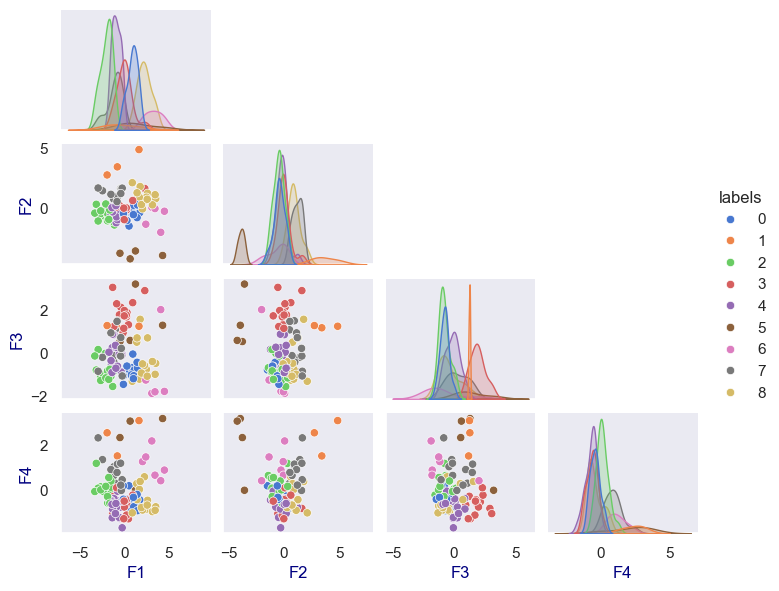

In [698]:
sns.pairplot(df_X_tete_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait x pouces de haut
             aspect=1.2)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2bis.2 - Interprétation: </h4>
</div>

In [699]:
df_X_tete_proj_KM_N_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,2
ALB,0.534591,-1.482531,-0.777024,0.208646,0


CENTRE DE GRAVITE :

In [700]:
df_X_tete_proj_KM_N_temp_grouped = (df_X_tete_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_tete_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_tete_proj_KM_N_temp_grouped)

,F1,F2,F3,F4
cluster,,,,
0,0.900256,-0.422298,-0.790141,-0.421618
1,-0.353412,3.669606,1.247741,2.400943
2,-2.036375,-0.481484,-0.801385,0.100994
3,0.002052,-0.005517,1.896247,-0.645363
4,-0.917971,-0.208509,-0.131005,-0.724725
5,1.432477,-3.851811,1.420936,2.159099
6,3.267044,-0.603425,-0.970248,1.165289
7,-1.103202,1.170577,0.272759,0.882333
8,2.238873,0.889988,-0.391635,-0.454046


LES CENTROIDES :

In [701]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[ 9.00256196e-01, -4.22298219e-01, -7.90141205e-01,
        -4.21618438e-01],
       [-3.53411794e-01,  3.66960586e+00,  1.24774059e+00,
         2.40094289e+00],
       [-2.03637522e+00, -4.81483686e-01, -8.01384939e-01,
         1.00994421e-01],
       [ 2.05224510e-03, -5.51721951e-03,  1.89624695e+00,
        -6.45363462e-01],
       [-9.17971452e-01, -2.08509432e-01, -1.31005395e-01,
        -7.24725123e-01],
       [ 1.43247710e+00, -3.85181118e+00,  1.42093628e+00,
         2.15909875e+00],
       [ 3.26704444e+00, -6.03424734e-01, -9.70247688e-01,
         1.16528918e+00],
       [-1.10320181e+00,  1.17057741e+00,  2.72759012e-01,
         8.82333348e-01],
       [ 2.23887349e+00,  8.89988230e-01, -3.91634693e-01,
        -4.54045670e-01]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [702]:
df_temp = df_X_tete_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,2
ALB,0.534591,-1.482531,-0.777024,0.208646,0
ARE,4.305748,-3.922011,1.307070,3.195349,5
ARM,-1.108496,-1.395469,-0.676329,0.665314,2
AUS,2.304344,1.621174,2.924825,-0.796908,3


In [703]:
df_temp_grouped =df_X_tete_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3,F4
cluster,,,,
0,0.900256,-0.422298,-0.790141,-0.421618
1,-0.353412,3.669606,1.247741,2.400943
2,-2.036375,-0.481484,-0.801385,0.100994
3,0.002052,-0.005517,1.896247,-0.645363
4,-0.917971,-0.208509,-0.131005,-0.724725


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2bis.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [704]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
ALB  / BGR  / CYP  / CZE  / EST  / GRC  / HRV  / HUN  / LTU  / LVA  / MKD  / ROU  / SRB  / SVK 



cluster 1 :
BRA  / IDN  / USA 



cluster 2 :
AGO  / ARM  / BEN  / BFA  / CAF  / CMR  / COD  / DJI  / DZA  / GHA  / GIN  / GNB  / HTI  / IRQ  / MDG  / MLI  / MRT  / RWA  / SDN  / TGO 



cluster 3 :
AUS  / BOL  / CHL  / CRI  / DOM  / FJI  / GTM  / GUY  / JAM  / MUS  / MYS  / PAN  / PER  / TTO  / URY 



cluster 4 :
BIH  / BLR  / BTN  / BWA  / GMB  / HND  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MNG  / NAM  / NIC  / PRY  / TJK  / UZB 



cluster 5 :
ARE  / COG  / GAB  / GRD 



cluster 6 :
CHE  / DEU  / DNK  / ESP  / PRT  / QAT 



cluster 7 :
BGD  / COL  / EGY  / IRN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / VNM  / ZAF 



cluster 8 :
AUT  / CAN  / FIN  / GBR  / IRL  / ISL  / ISR  / ITA  / JPN  / KOR  / MLT  / NOR  / POL  / SVN  / SWE 





**HEATMAP**

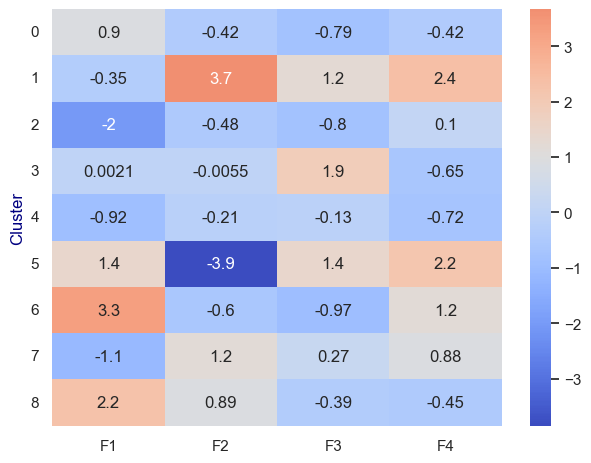

In [705]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =1 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

Rappel PCA tete :
F1 => Niveau de Vie (35% de la variance) (Axe important pour le poulet bio)  
F2 => Pays de taille importante non consommateur de poulet en masse(17% de la variance)  
F3 => Pays éloigné avec part de poulet Alim (15% de la variance)  
F4 => Importateur de Poulet Francais (10% de la variance)+Taile du pays  
(F5 =>Pays Pauvre mais stables 76% de la variance)+Taile du pays  

Attention F2 n'est pas que un critère positif : taille +++ faibel consomatteur de poulet et F1 est neutre.

Regardons les critères qui dépassent 1 : 

cluster 2 :
- fav : F1

**cluster 3 : intéressant**
- fav : F1, F2, F3 (mais F2 pas forcément positif)

cluster 6 : 
- fav : F3, et F4
- défav : F2 (pas frocément un pb, voir détail)

**cluster 7 intéressant :**
- très fav : F1
- fav : F3, F4

**RADAR**

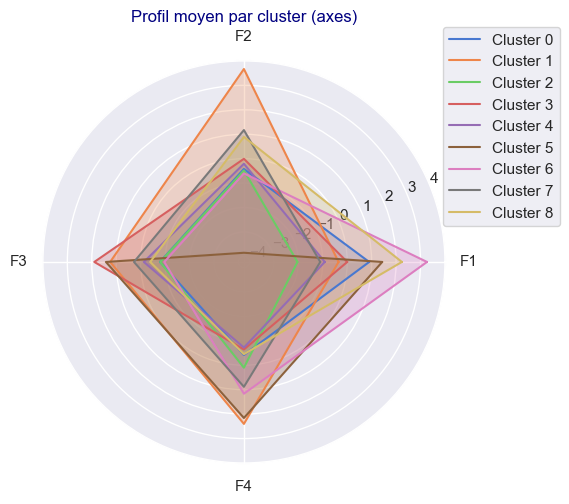

In [706]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

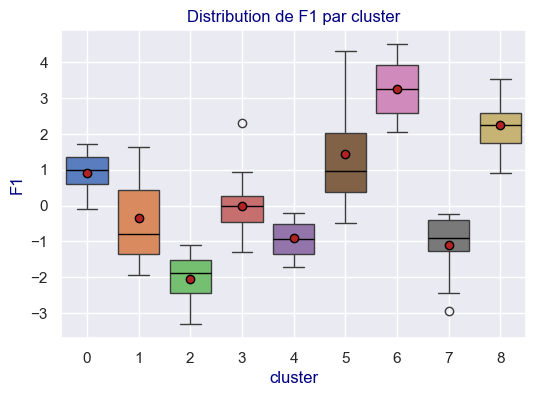

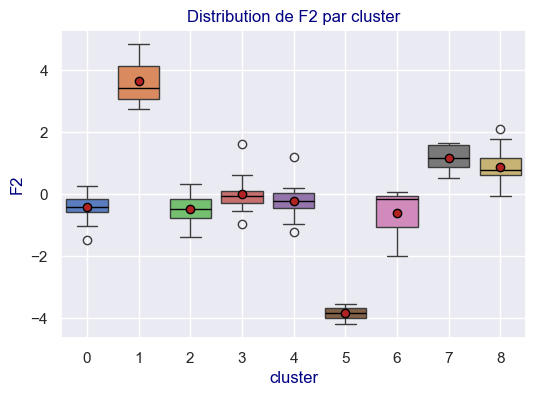

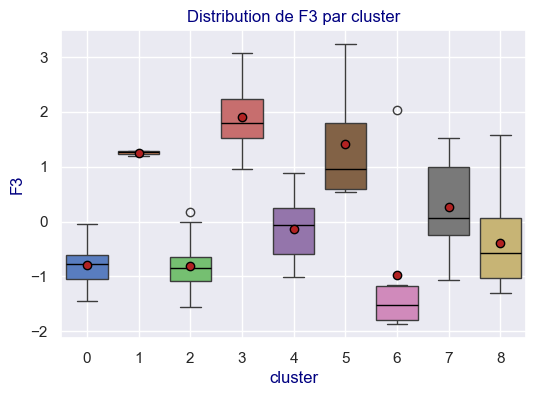

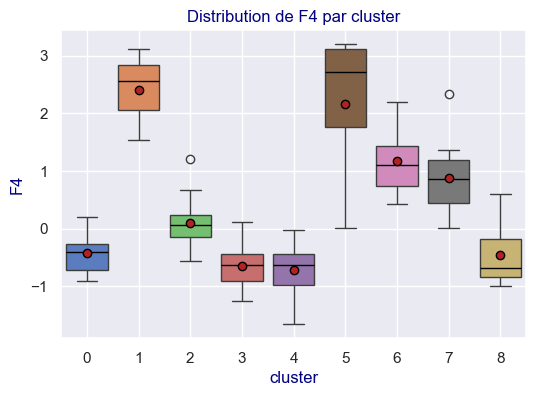

In [707]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [708]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,2
ALB,0.534591,-1.482531,-0.777024,0.208646,0


In [709]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4
cluster,,,,
0,0.900256,-0.422298,-0.790141,-0.421618
1,-0.353412,3.669606,1.247741,2.400943
2,-2.036375,-0.481484,-0.801385,0.100994
3,0.002052,-0.005517,1.896247,-0.645363
4,-0.917971,-0.208509,-0.131005,-0.724725
5,1.432477,-3.851811,1.420936,2.159099
6,3.267044,-0.603425,-0.970248,1.165289
7,-1.103202,1.170577,0.272759,0.882333
8,2.238873,0.889988,-0.391635,-0.454046


In [710]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,labels
cluster,,,,,
0,0.900256,-0.422298,-0.790141,-0.421618,0
1,-0.353412,3.669606,1.247741,2.400943,1
2,-2.036375,-0.481484,-0.801385,0.100994,2
3,0.002052,-0.005517,1.896247,-0.645363,3
4,-0.917971,-0.208509,-0.131005,-0.724725,4
5,1.432477,-3.851811,1.420936,2.159099,5
6,3.267044,-0.603425,-0.970248,1.165289,6
7,-1.103202,1.170577,0.272759,0.882333,7
8,2.238873,0.889988,-0.391635,-0.454046,8


Et on affiche le graphique pour F1 et F2 :

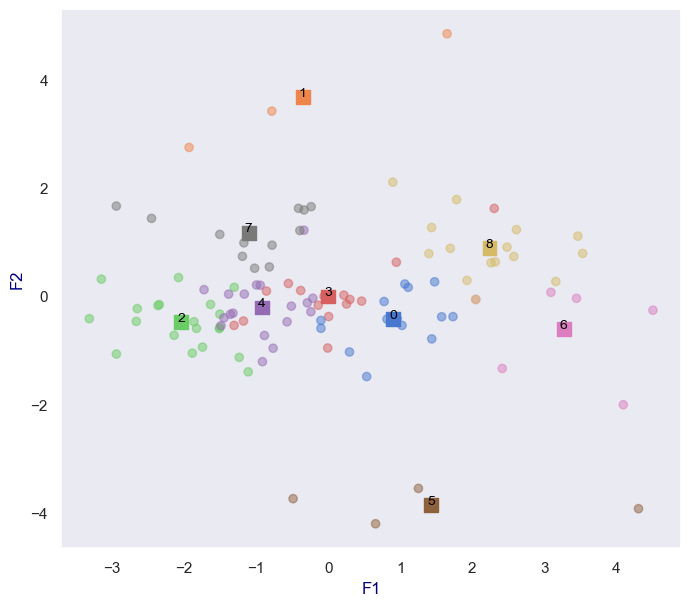

In [711]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


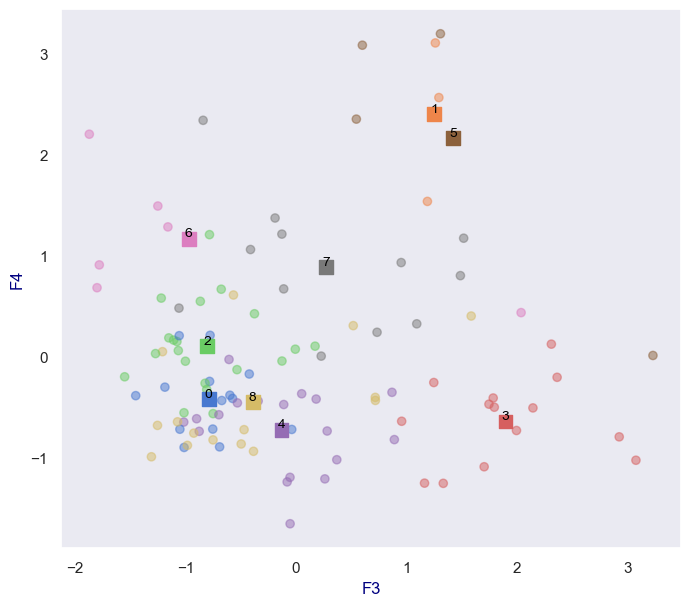

In [712]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

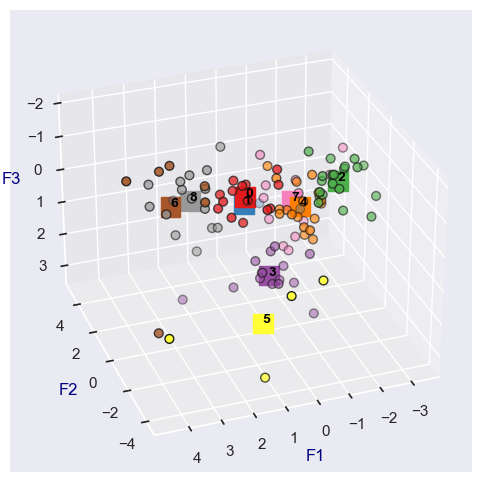

In [713]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [714]:
X_proj_temp.head(2)

,F1,F2,F3,F4,labels
iso3,,,,,
AGO,-2.136898,-0.722247,-0.006006,0.071297,2
ALB,0.534591,-1.482531,-0.777024,0.208646,0


In [715]:
centroids_proj_temp.head()

,F1,F2,F3,F4,labels
cluster,,,,,
0,0.900256,-0.422298,-0.790141,-0.421618,0
1,-0.353412,3.669606,1.247741,2.400943,1
2,-2.036375,-0.481484,-0.801385,0.100994,2
3,0.002052,-0.005517,1.896247,-0.645363,3
4,-0.917971,-0.208509,-0.131005,-0.724725,4


In [716]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [717]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [718]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3tete.2bis.4 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 3.1.15

In [719]:
df_X_tete_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200


In [720]:
#Mappons df_X_tete_scaled avec nos labels
df_X_tete_scaled_KM_N_temp = df_X_tete_scaled.join(df_temp["labels"])
df_X_tete_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,2
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,0
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,5
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572,2
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200,3


In [721]:
df_X_tete_scaled_KM_N_temp_grouped = (df_X_tete_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_tete_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_tete_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.024507,-0.492826,0.167896,-0.014720,-0.160149,0.571102,0.176240,0.257749,0.605725
1,-1.073685,4.179454,-1.358289,0.473171,0.658391,0.096653,-0.459161,0.609854,-0.458668
2,0.148105,-0.173210,-0.022318,-0.687769,-1.020734,-1.255407,-0.182971,-0.947075,-1.093488
3,-1.353918,-0.395919,-0.097711,-0.129823,1.397312,0.068174,-0.448069,-0.258903,0.410949
4,-0.246027,-0.444785,-0.167743,-0.597423,-0.526034,-0.072767,-0.409533,-0.699789,-0.058023
5,-0.149399,-0.516356,3.466694,-0.000837,1.586983,-0.262622,2.912883,-0.280866,0.497911
6,1.048743,-0.137719,0.410108,1.677523,0.156529,0.954957,2.290846,1.585985,1.063161
7,-0.430812,1.351140,-0.327722,-0.501296,-0.096216,-0.162091,-0.457625,0.072982,-1.037894
8,0.675201,-0.103442,-0.382604,1.413110,0.203869,0.958385,-0.216196,1.380997,0.915326


Travaillons sur des copies :

In [722]:
df_temp = df_X_tete_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_tete_scaled_KM_N_temp_grouped.copy()

In [723]:
df_temp.head(5)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.302446,0.017238,0.419332,-0.640932,-0.645310,-1.735978,-0.404244,-1.195988,-0.564264,2
ALB,1.069291,-0.548766,1.032971,-0.496356,-0.178672,0.637213,0.910093,-0.317471,0.199756,0
ARE,0.031251,-0.420849,4.346053,1.463200,1.764585,1.028789,4.232065,1.732404,0.926507,5
ARM,0.529250,-0.547847,0.822240,-0.481244,-0.380305,-1.051708,0.600367,-0.463890,-1.160572,2
AUS,-3.128955,-0.145521,-0.561512,2.052857,1.283717,0.993191,-0.459171,1.732404,1.299200,3


In [724]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,1.024507,-0.492826,0.167896,-0.014720,-0.160149,0.571102,0.176240,0.257749,0.605725
1,-1.073685,4.179454,-1.358289,0.473171,0.658391,0.096653,-0.459161,0.609854,-0.458668


**Liste des pays (Vérification)**

In [725]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
ALB  / BGR  / CYP  / CZE  / EST  / GRC  / HRV  / HUN  / LTU  / LVA  / MKD  / ROU  / SRB  / SVK 



cluster 1 :
BRA  / IDN  / USA 



cluster 2 :
AGO  / ARM  / BEN  / BFA  / CAF  / CMR  / COD  / DJI  / DZA  / GHA  / GIN  / GNB  / HTI  / IRQ  / MDG  / MLI  / MRT  / RWA  / SDN  / TGO 



cluster 3 :
AUS  / BOL  / CHL  / CRI  / DOM  / FJI  / GTM  / GUY  / JAM  / MUS  / MYS  / PAN  / PER  / TTO  / URY 



cluster 4 :
BIH  / BLR  / BTN  / BWA  / GMB  / HND  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MNG  / NAM  / NIC  / PRY  / TJK  / UZB 



cluster 5 :
ARE  / COG  / GAB  / GRD 



cluster 6 :
CHE  / DEU  / DNK  / ESP  / PRT  / QAT 



cluster 7 :
BGD  / COL  / EGY  / IRN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / VNM  / ZAF 



cluster 8 :
AUT  / CAN  / FIN  / GBR  / IRL  / ISL  / ISR  / ITA  / JPN  / KOR  / MLT  / NOR  / POL  / SVN  / SWE 





**HEATMAP**

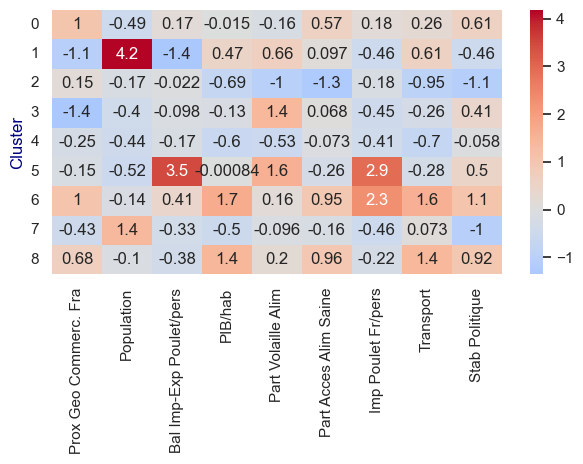

In [726]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =0 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

**Cluster 7 : ++++ intéressant  :**  
Niveau de vie élevé et fort importation de Pouler

Cluster 6 : ++ intéressant (bonnes valeur sur le Poulet et Poulet Fr) mais alimentation Saine, Niveau de vie en retrait.  
Bon pour le Poulet mais pas forcément poru le poulet bio.  

Cluster 2 : +. intéressant  :
Niveau de vie correct et Import de Poulet Fr.

**RADAR**

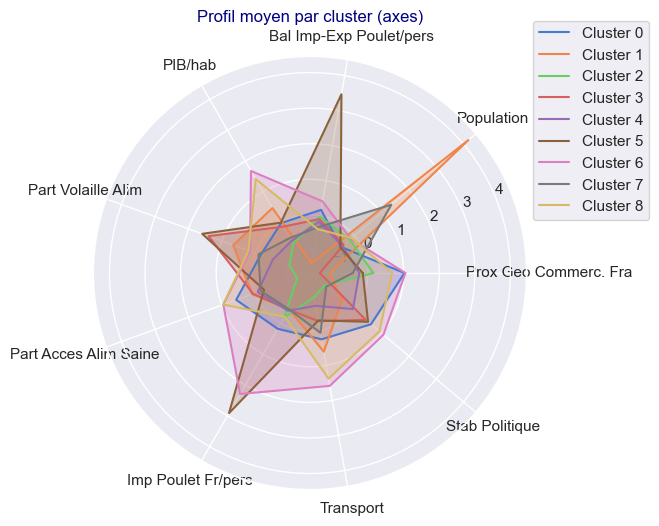

In [727]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

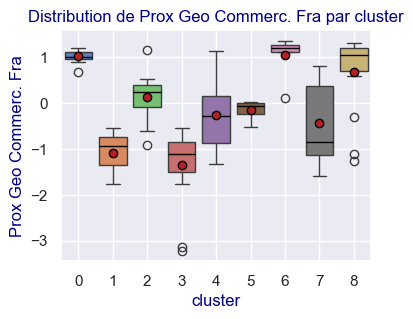

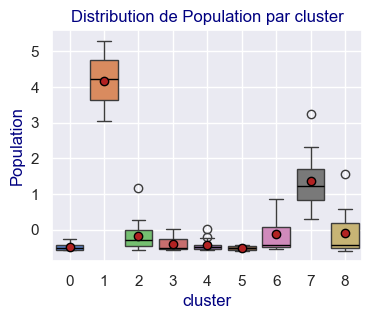

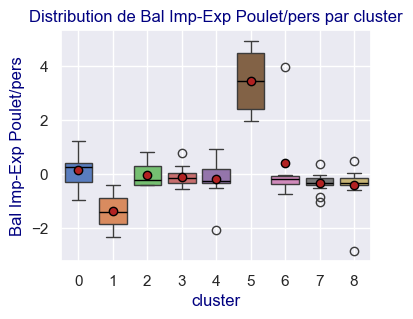

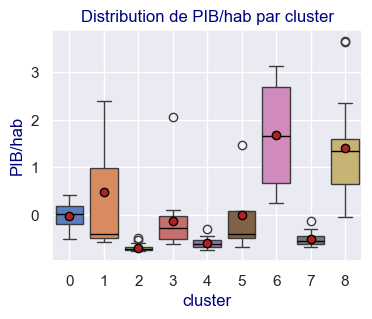

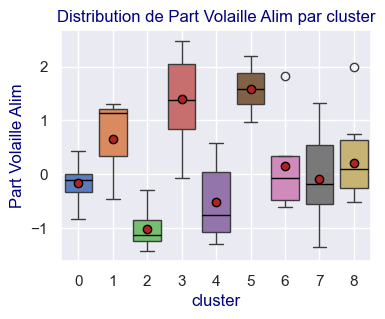

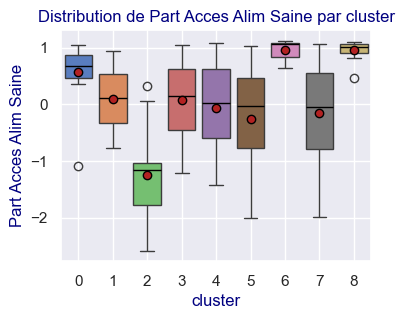

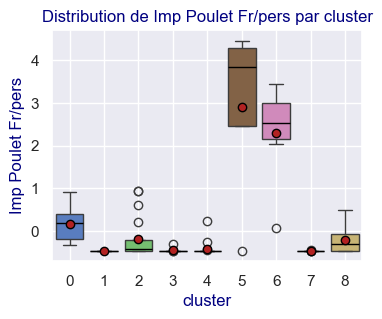

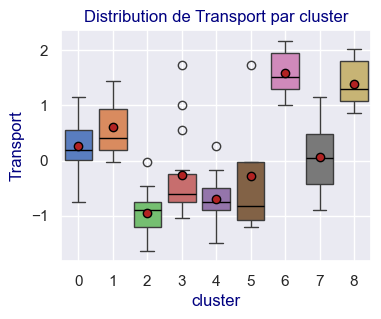

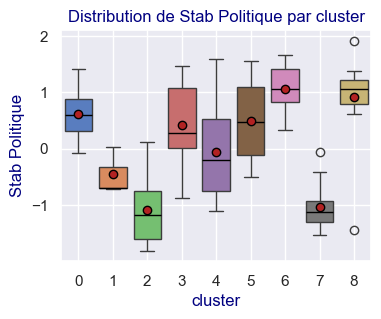

In [728]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

In [729]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

73388

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape E -  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">E.1 -  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 4Orig -Clustering  sur données originales sans CHN et IND</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Orig.0- Préparation Data  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.1 - Data : </h4>
</div>

<font color='blue'>**DATA :**</font>  
Le jeu de données orginales :  
df_Etude_Marche_analyse_1_1

In [730]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.2 - Selection : </h4>
</div>

##### **SELECTION DE PAYS :**

Nosu avons déjà établi que la CHN et l'IND n'avaient pas des valeurs pertinentes  pour notre étude dans la partie 2-PCA.  
Et que ses valeurs pouvaient perturber la PCA et le clustering.

In [731]:
#CREATION d'un DF sans les outliers CHN et IND : (pour une nouvelle étude)
liste_iso3_temp = ['CHN','IND']
mask_temp = ~(df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_temp))

df_Etude_Marche_analyse_1_1_Orig_Pays_selec = df_Etude_Marche_analyse_1_1.loc[mask_temp,:]
df_Etude_Marche_analyse_1_1_Orig_Pays_selec.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [732]:
df_Etude_Marche_analyse_1_1_Orig_Pays_selec.shape

(110, 12)

POINT SUR LES DONNEES :

In [733]:
Premieres_Analyses (df_Etude_Marche_analyse_1_1_Orig_Pays_selec )


---- SHAPE ----


(110, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 110 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     110 non-null    string 
 1   pays                     110 non-null    string 
 2   continent                110 non-null    string 
 3   Prox Geo Commerc. Fra    110 non-null    Float64
 4   Population               110 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  110 non-null    Float64
 6   PIB/hab                  110 non-null    Float64
 7   Part Volaille Alim       110 non-null    Float64
 8   Part Acces Alim Saine    110 non-null    Float64
 9   Imp Poulet Fr/pers       110 non-null    Float64
 10  Transport                110 non-null    Float64
 11  Stab Politique           110 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 12.1 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0
mean,-5150.644766,33965768.745455,3.735451,20187.846674,2.841348,72.428182,0.121102,2.945455,47.259802
std,3628.445949,57581642.758081,11.281307,26304.26403,1.92054,25.438309,0.399507,0.699493,25.607641
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8079.743,3387239.5,0.04186,3491.884738,1.407101,53.2,0.0,2.4,24.881517
50%,-4536.2785,10327283.0,1.949559,8082.376833,2.442977,81.15,0.000626,2.75,49.526068
75%,-1743.15775,35461010.5,6.600689,25533.223319,4.025661,94.625,0.067048,3.6,69.905214
max,-378.6808,341534045.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],110,110,0,110,0.0
pays,string[python],110,110,0,110,0.0
continent,string[python],110,110,0,5,0.0
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN


In [734]:
df_Etude_Marche_analyse_1_1_Orig_Pays_selec.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

In [735]:
df_Etude_Marche_analyse_1_1_Orig_Pays_selec.dtypes

iso3                       string[python]
pays                       string[python]
continent                  string[python]
Prox Geo Commerc. Fra             Float64
Population                          Int64
Bal Imp-Exp Poulet/pers           Float64
PIB/hab                           Float64
Part Volaille Alim                Float64
Part Acces Alim Saine             Float64
Imp Poulet Fr/pers                Float64
Transport                         Float64
Stab Politique                    Float64
dtype: object

##### **SELECTION DES COLONNES QUANTITATIVES :**

In [736]:
#Rappel :
# Liste des variables quantitatives
print(quant_vars) 

['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport', 'Stab Politique']


In [737]:
df_Orig_quant = (df_Etude_Marche_analyse_1_1_Orig_Pays_selec.set_index(keys=['iso3'])[quant_vars] ).copy(deep=True)
df_Orig_quant.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
ALB,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
ARM,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
AUS,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


Notre dataframe a maintenant une dimension de : 

In [738]:
df_Orig_quant.shape

(110, 9)

In [739]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_Orig_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN
Transport,Float64,110,110,0,26,NaN
Stab Politique,Float64,110,110,0,110,NaN


##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.3 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_ter` la matrice des données : 

In [740]:
#X_ter récupère les valeurs de df_ter_quant dans un np.array
X_Orig = df_Orig_quant.values
#X_Orig[:5]
pd.DataFrame(X_Orig).head()

,0,1,2,3,4,5,6,7,8
0,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [741]:
X_Orig.shape

(110, 9)

Nous enregistrons les noms de nos pays-iso3 dans une variable `names_Orig` : 

In [742]:
names_Orig = df_Orig_quant.index
names_Orig

Index(['AGO', 'ALB', 'ARE', 'ARM', 'AUS', 'AUT', 'BEL', 'BEN', 'BFA', 'BGD',
       ...
       'TGO', 'THA', 'TJK', 'TTO', 'TUR', 'URY', 'USA', 'UZB', 'VNM', 'ZAF'],
      dtype='string', name='iso3', length=110)

In [743]:
names_Orig.shape

(110,)

et nos colonnes, nos features_base, dans une variable `features_Orig` : 

In [744]:
#DEJA FAIT DANS PCA_Bis_sans CHN_IND :
features_Orig = df_Orig_quant.columns
features_Orig

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [745]:
features_Orig.shape

(9,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.4 - Data Split : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données `X_Orig` :



In [746]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_Orig = StandardScaler()
scaler_Orig

StandardScaler()

In [747]:
#préparation de la fonction pour s'adapter au format de nos données X_ter (Fitage) :
scaler_Orig.fit(X_Orig)

StandardScaler()

In [748]:
#Centrage -réduction de X_Orig dans le np.array X_Orig_scaled :
X_Orig_scaled = scaler_Orig.transform(X_Orig)
pd.DataFrame(X_Orig_scaled).head(5) #visualisation de X_Orig_scaled

,0,1,2,3,4,5,6,7,8
0,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
1,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
2,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
3,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
4,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


##### VISUALISATION de `X_Orig_scaled` :

In [749]:
type(X_Orig_scaled)

numpy.ndarray

In [750]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Orig_scaled).describe().round(2)

,0,1,2,3,4,5,6,7,8
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.59,-2.68,-0.75,-1.42,-2.61,-0.30,-1.65,-1.84
25%,-0.81,-0.53,-0.33,-0.64,-0.75,-0.76,-0.30,-0.78,-0.88
50%,0.17,-0.41,-0.16,-0.46,-0.21,0.34,-0.30,-0.28,0.09
75%,0.94,0.03,0.26,0.20,0.62,0.88,-0.14,0.94,0.89
max,1.32,5.37,4.78,4.04,2.52,1.09,6.17,2.09,1.88


In [751]:
#de manière plus explicite en récupérant le nom des colonnes : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Orig_scaled,columns=quant_vars).describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.22,-0.59,-2.68,-0.75,-1.42,-2.61,-0.30,-1.65,-1.84
25%,-0.81,-0.53,-0.33,-0.64,-0.75,-0.76,-0.30,-0.78,-0.88
50%,0.17,-0.41,-0.16,-0.46,-0.21,0.34,-0.30,-0.28,0.09
75%,0.94,0.03,0.26,0.20,0.62,0.88,-0.14,0.94,0.89
max,1.32,5.37,4.78,4.04,2.52,1.09,6.17,2.09,1.88


In [752]:
pd.DataFrame(X_Orig_scaled).mean().round(2)

0   -0.0
1    0.0
2    0.0
3    0.0
4    0.0
5   -0.0
6   -0.0
7    0.0
8    0.0
dtype: float64

In [753]:
pd.DataFrame(X_Orig_scaled).std(ddof=1).round(2)

0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
6    1.0
7    1.0
8    1.0
dtype: float64

#Visualisation de X_Orig_scaled les données centrées réduites

In [754]:
#Visualisation de X_Orig_scaled les données centrées réduites
df_X_Orig_scaled = pd.DataFrame(X_Orig_scaled) #les données centrées réduites
df_X_Orig_scaled.columns = features_Orig
df_X_Orig_scaled.index = names_Orig
df_X_Orig_scaled.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.5 - Pas de PCA : </h4>
</div>

La PCA est utileis poure réduire la quantité d'information.  
Nous n'avons pas beaucoup de données. 
C'est pour ça que nous allons pouvoir tenter de faire un clustering sur les données originales centrées réduites.
Nous pourrons tester plusiseurs manières de centre réduire.  
Nous n'avons pas la contrainte de la PCA qui requiert un centrage sur la moyenne et une réduction sur la Variance à 1.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.0.5 - Pas de PCA : </h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Orig.1- classification hiérarchique ACH </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.1 - Préliminaires : </h4>
</div>

##### IMPORTS

##### DATA

Ici il n'y aura pas de projection, on considère que l'on est déjà pro

In [755]:
df_X_Orig_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [756]:
df_X_Orig_scaled_ACH=df_X_Orig_scaled.copy(deep=True)
df_X_Orig_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [757]:
df_X_Orig_scaled_ACH.shape

(110, 9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.2 - Dendrogramme -ACH : </h4>
</div>

Effectuons une classification hiérarchique ascendante.

##### **CALCUL DES DISTANCES :**

Nous allons calculer les distances en spécifiant la méthode à utiliser: méthode de Ward adaptée à l'ACH.

In [758]:
Z = linkage(df_X_Orig_scaled_ACH, method="ward")
pd.DataFrame(Z)

,0,1,2,3
0,67.0,98.0,0.506387,2.0
1,5.0,99.0,0.516325,2.0
2,21.0,74.0,0.531187,2.0
3,35.0,75.0,0.552716,2.0
4,8.0,112.0,0.582318,3.0
...,...,...,...,...
104,200.0,212.0,11.434862,32.0
105,206.0,213.0,11.490266,34.0
106,211.0,215.0,13.419115,75.0
107,205.0,214.0,14.300790,35.0


In [759]:
Z.shape

(109, 4)

In [760]:
type(Z)

numpy.ndarray

##### **2. Dendrogramme**

Nous pouvons désormais afficher le dendrogramme: 

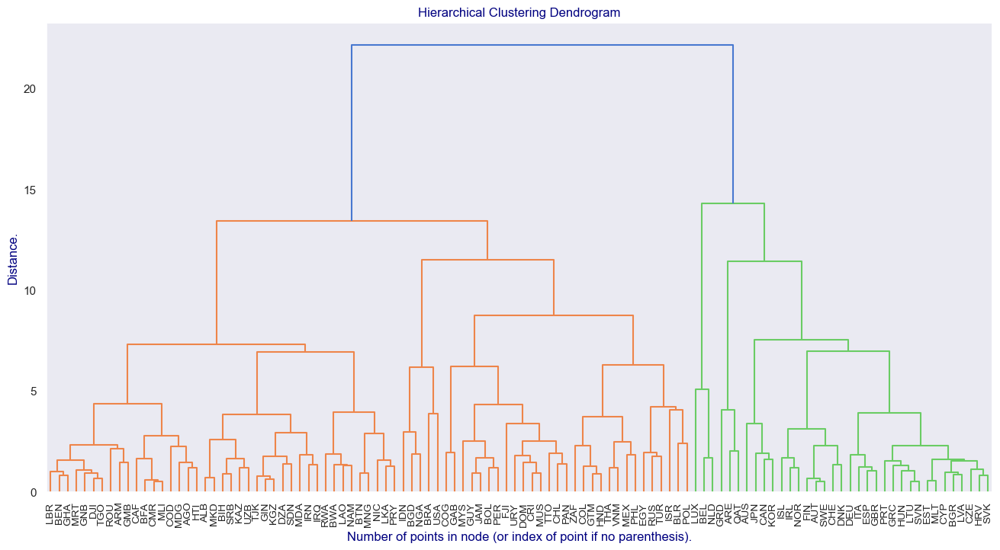

In [761]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_Orig_scaled_ACH.index)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
plt.show()

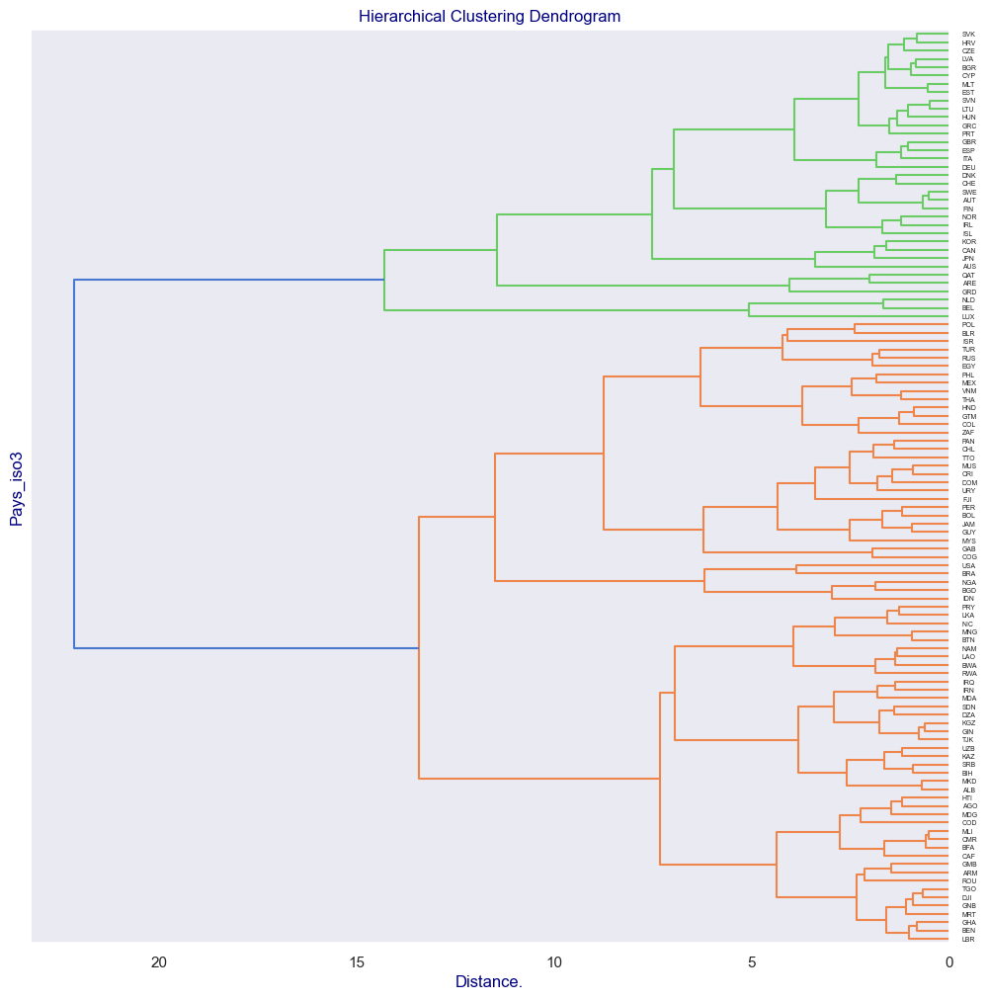

In [762]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

_ = dendrogram(Z, ax=ax,labels=df_X_Orig_scaled_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
plt.show()

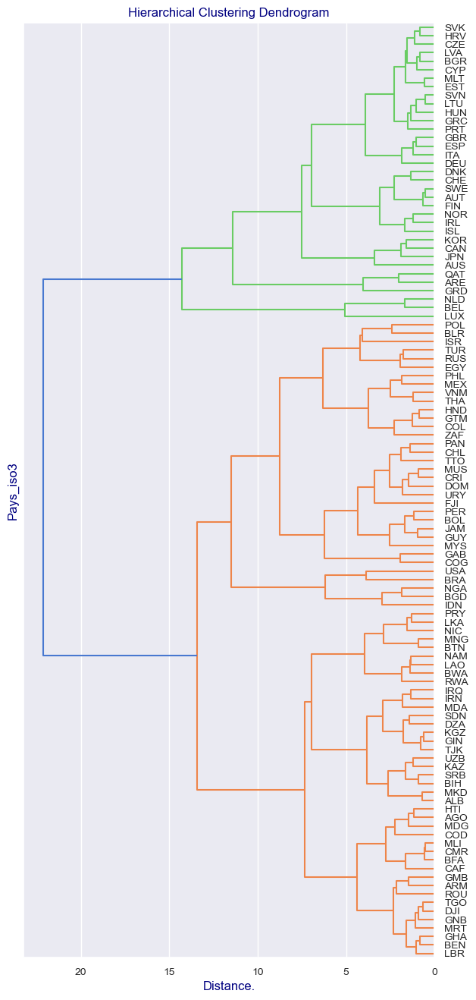

In [763]:
fig, ax = plt.subplots(1, 1, figsize=(7, 16))

_ = dendrogram(Z, ax=ax,labels=df_X_Orig_scaled_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

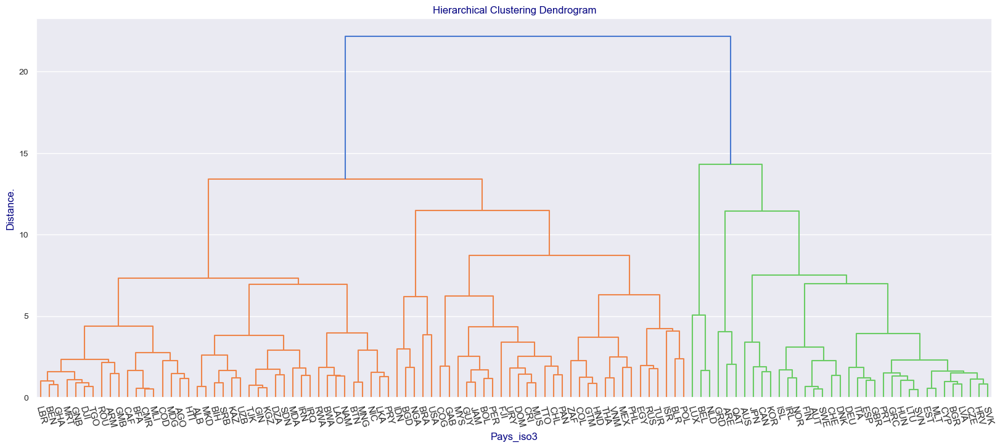

In [764]:
fig, ax = plt.subplots(1, 1, figsize=(20, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_Orig_scaled_ACH.index, orientation = "top")

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Pays_iso3")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=11,labelrotation =-75)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

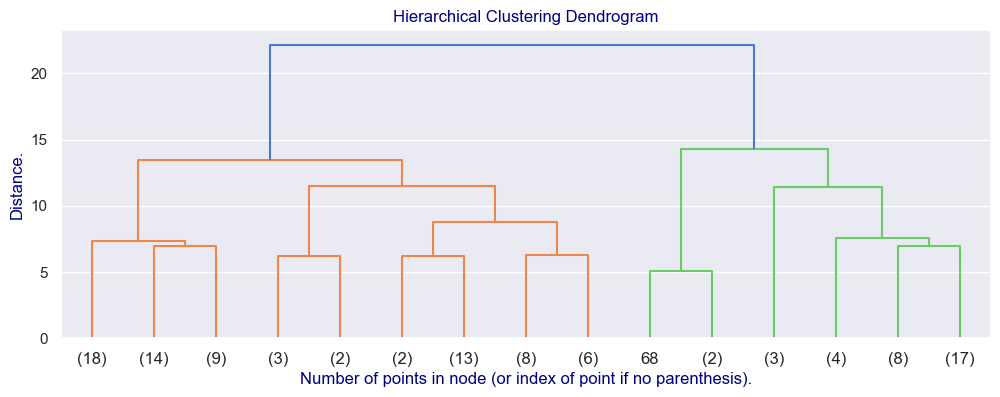

In [765]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=15, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=15 nombre au dessus duquel les distances intraclasse sont inférieur à 5

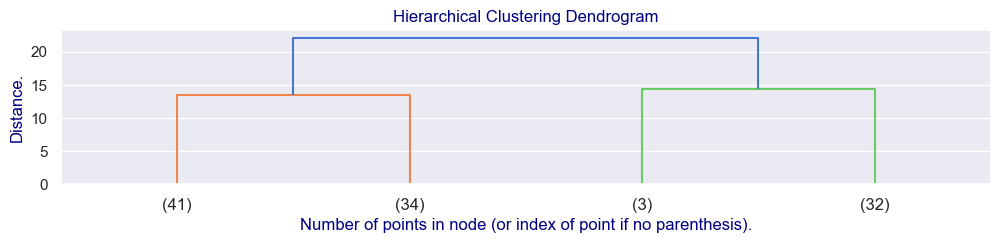

In [766]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 2))

_ = dendrogram(Z, p=4, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=4 nombre de clusters minimum pour voir apparaitre le groupe de 3 : BEL, NLD(Pays-Bas), LUX (Niveau de vie elevé/Commerce avec Fr)  
Emergence rapide de ce groupe témoignant de sa distinction des autes pays.

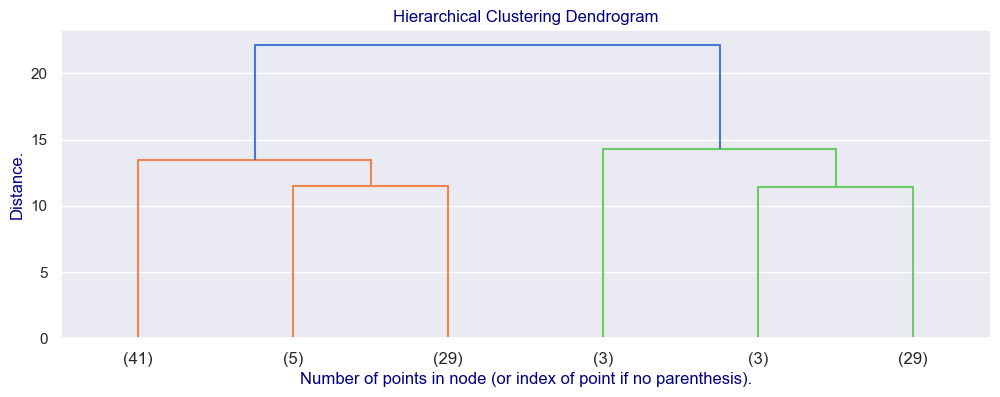

In [767]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de 3 : QAT, ARE, GRD(Grenade)  

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de  : IDN(Indonésie), BRA, USA (poids de la population) +NGA et BGD

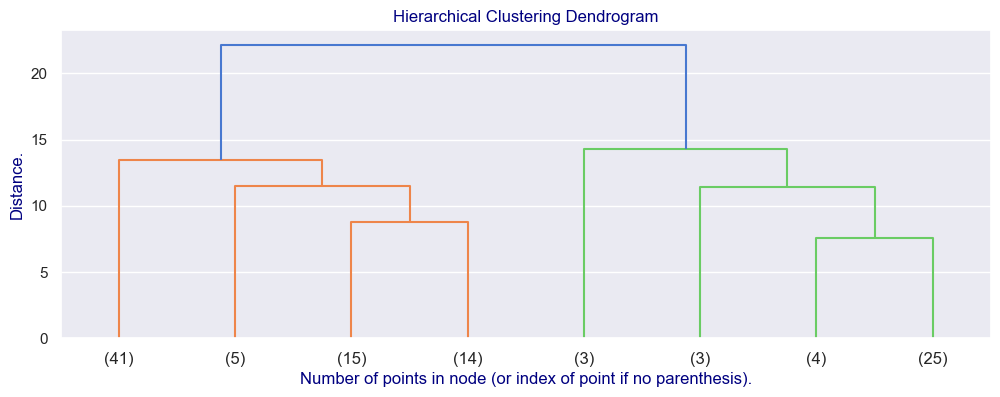

In [768]:
# les arguments p=8, truncate_mode="lastp" signifient que l'on ne va afficher que 8 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=8, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**AUTRE METHODE DE VISUALISATION (par le Nombre de noeuds) :**  
Ici j'ai des clusters qui ne sont issus que d'un noeud et d'autres de 2 noeuds.  
Je peux voir ce que ça peut donner si je prends ceux issu de 2 noeuds

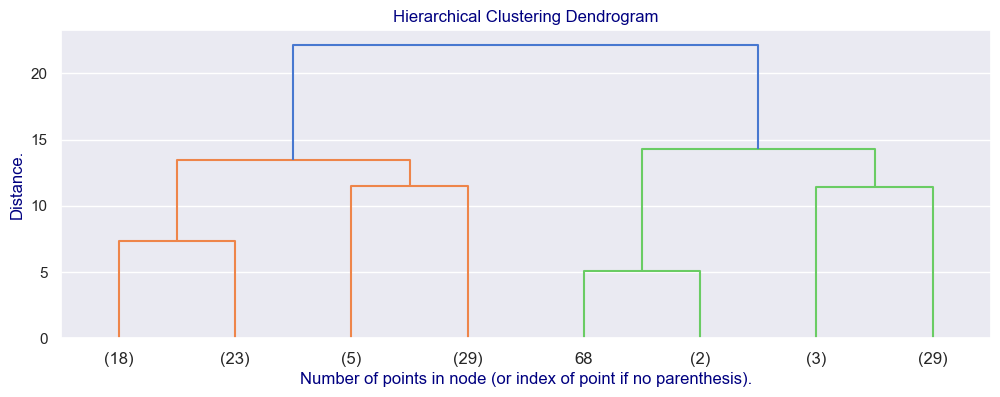

In [769]:
#  les arguments p=2, truncate_mode="level"signifient que l'on ne va afficher que les clusters issus de 2 noeuds.

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=2, truncate_mode="level", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**CHOIX DE NBRE DE CLUSTERS**  
A la lecture des Dendrogrammes, un nombre de clusters entre 6 et 8 semble pertinent.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.3 - Evaluation du nbre de cluster pertinent : Méthode de la silhouette : </h4>
</div>

Méthode du coude
Pertinent avec ACH ? ➤ ❌NON Pas directement.

Pourquoi ?

Le coude est basé sur l’inertie intra-cluster (minimisée dans K-means).

L’ACH ne repose pas sur l’inertie mais sur une distance de fusion (liaison simple, complète, moyenne…).

Le "coude" peut parfois être utilisé sur un graphe des distances de fusion (dans le dendrogramme), mais ce n’est pas la méthode standard.

Nombre de clusters : 2 — Score silhouette moyen : 0.28


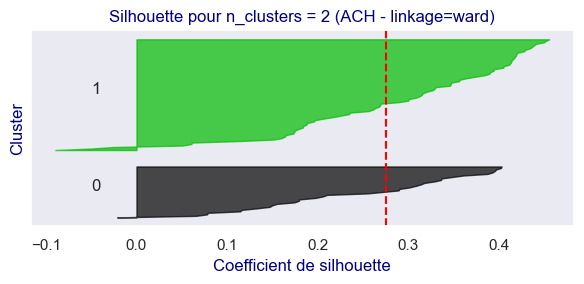

Nombre de clusters : 3 — Score silhouette moyen : 0.27


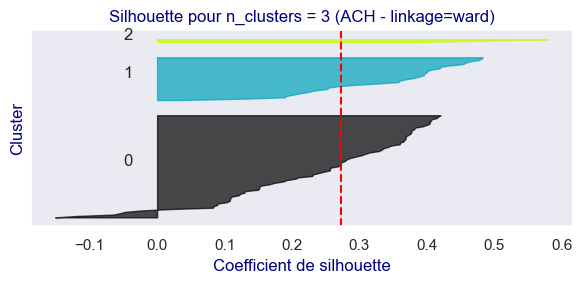

Nombre de clusters : 4 — Score silhouette moyen : 0.24


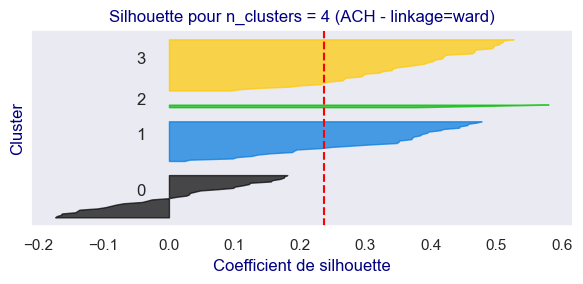

Nombre de clusters : 5 — Score silhouette moyen : 0.25


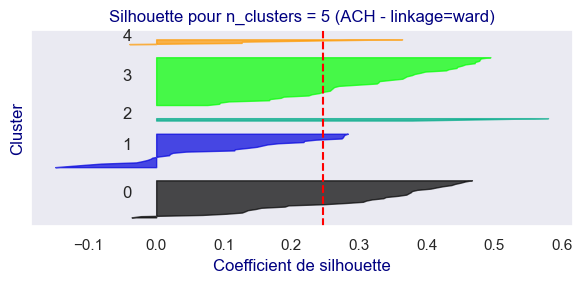

Nombre de clusters : 6 — Score silhouette moyen : 0.27


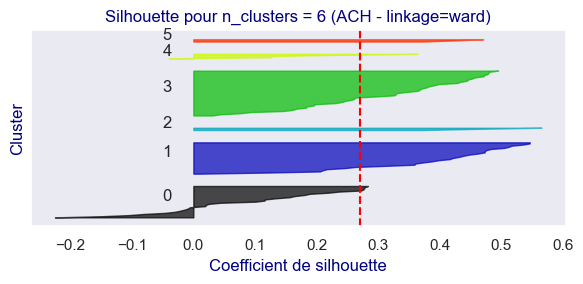

Nombre de clusters : 7 — Score silhouette moyen : 0.27


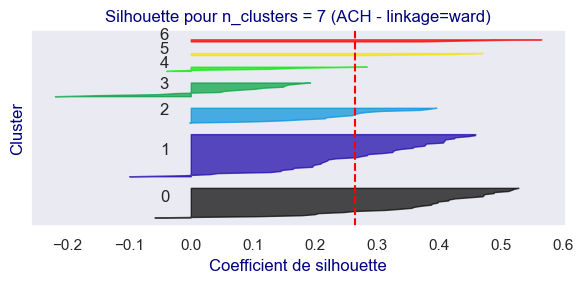

Nombre de clusters : 8 — Score silhouette moyen : 0.26


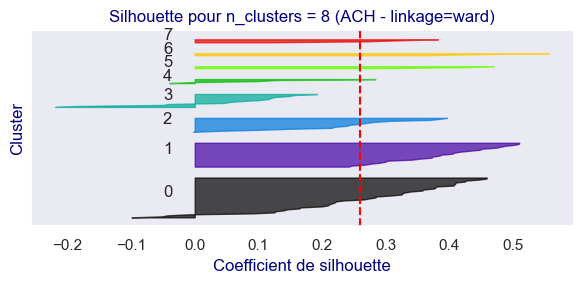

Nombre de clusters : 9 — Score silhouette moyen : 0.21


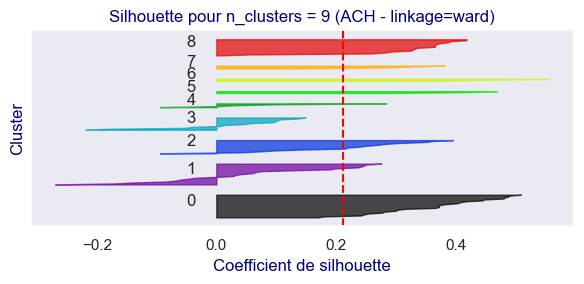

Nombre de clusters : 10 — Score silhouette moyen : 0.20


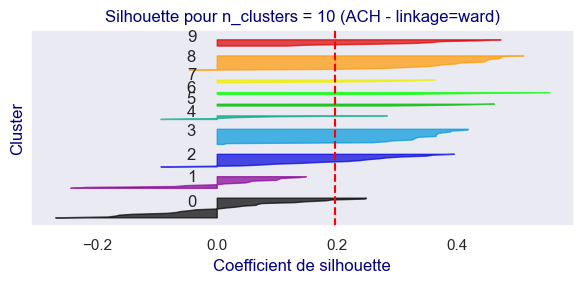

Nombre de clusters : 11 — Score silhouette moyen : 0.21


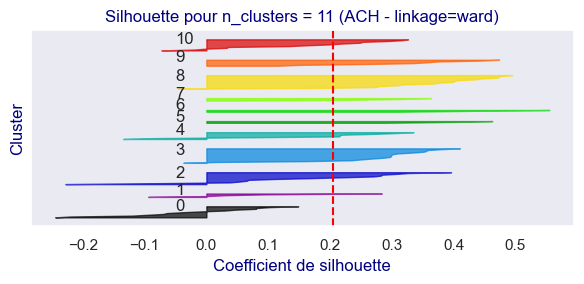

In [770]:
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import AgglomerativeClustering
#import matplotlib.pyplot as plt
#import numpy as np

X_temp = df_X_Orig_scaled.copy()
range_nb_clust = range(2, 12)  # Par exemple de 2 à 14 clusters

for nb_clust in range_nb_clust:
    fig, ax = plt.subplots(figsize=(6, 3))

    # ✅ Utilisation de l'ACH (et non KMeans)
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    cluster_labels = cah.fit_predict(X_temp)

    # Score de silhouette moyen
    silhouette_avg = silhouette_score(X_temp, cluster_labels)
    print(f"Nombre de clusters : {nb_clust} — Score silhouette moyen : {silhouette_avg:.2f}")

    # Score silhouette par point
    sample_silhouette_values = silhouette_samples(X_temp, cluster_labels)

    y_lower = 10
    for i in range(nb_clust):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / nb_clust)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax.set_title(f"Silhouette pour n_clusters = {nb_clust} (ACH - linkage=ward)")
    ax.set_xlabel("Coefficient de silhouette")
    ax.set_ylabel("Cluster")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax.set_yticks([])
    plt.tight_layout()
    plt.show()


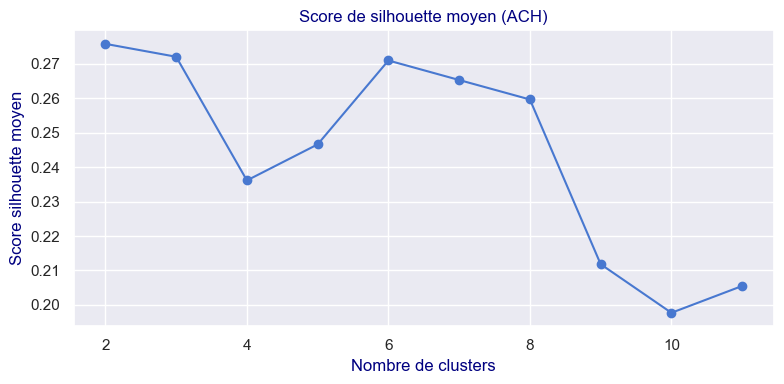

In [771]:
#graph de silhouette scores selon nombre de cluster

silhouette_scores = []

for nb_clust in range_nb_clust:
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    labels = cah.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (ACH)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


<u>**CHOIX DU NOMBRE DE CLUSTER :** </u>  
Score de silhouette : 2, 3et 6 semblent avoir un score de silhouette le plus haut (mais relativement bas environ 0.27).  
**k=6** semble êter le meilleur compromis entre un score de silhouette le plus haut et un nombre de groupe interprétable.


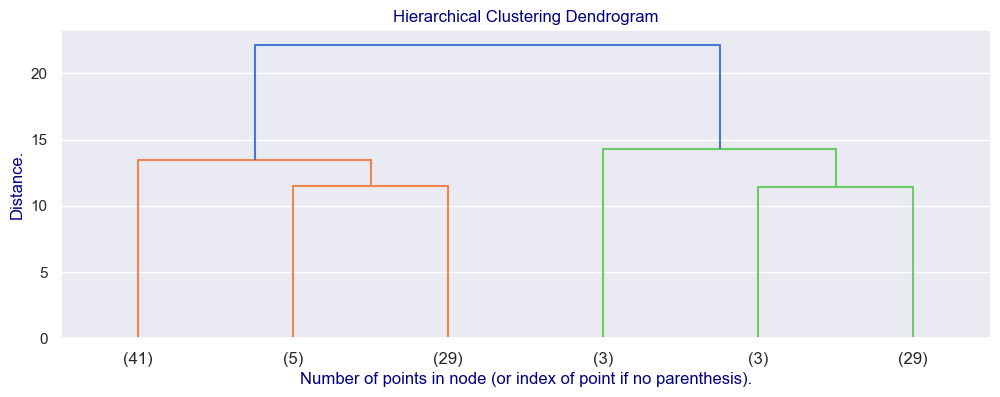

In [772]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

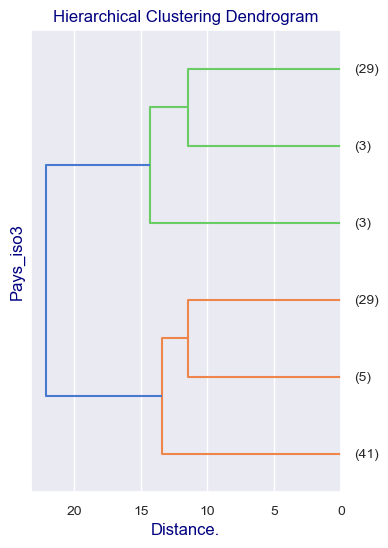

In [773]:
fig, ax = plt.subplots(1, 1, figsize=(4,6))

_ = dendrogram(Z, ax=ax,labels=df_X_Orig_scaled_ACH.index, orientation = "left", p=6, truncate_mode="lastp" )

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.4 - Clusters CAH : </h4>
</div>

##### **CLUSTERS CAH**

Pour définir les clusters, on peut utiliser `scipy` ou `scikit-learn`.

<u>Scikit-Learn</u>

On instancie un estimateur : 

In [774]:
n_clusters =6

In [775]:
cah = AgglomerativeClustering(n_clusters=n_clusters, linkage="ward")

On entraine l'estimateur : 

In [776]:
df_X_Orig_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [777]:
cah.fit(df_X_Orig_scaled_ACH)

AgglomerativeClustering(n_clusters=6)

Regardons nos clusters : 

In [778]:
cah.labels_

array([3, 3, 5, 3, 1, 1, 2, 3, 3, 4, 1, 3, 0, 0, 4, 3, 3, 3, 1, 1, 0, 3,
       3, 0, 0, 0, 1, 1, 1, 3, 1, 0, 3, 0, 1, 1, 1, 0, 0, 1, 3, 3, 3, 3,
       1, 5, 0, 0, 0, 1, 3, 1, 4, 1, 3, 3, 1, 0, 1, 0, 1, 3, 3, 1, 3, 3,
       3, 1, 2, 1, 3, 3, 0, 3, 3, 1, 3, 3, 0, 0, 3, 4, 3, 2, 1, 0, 0, 0,
       0, 1, 3, 5, 3, 0, 3, 3, 3, 1, 1, 1, 3, 0, 3, 0, 0, 0, 4, 3, 0, 0],
      dtype=int64)

Ajoutons nos labels à `df_X_Orig_scaled_ACH`

In [779]:
df_X_Orig_scaled_ACH["labels"] = cah.labels_
df_X_Orig_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,3
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,3
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,3
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


Observons nos clusters: 

In [780]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Orig_scaled_ACH["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

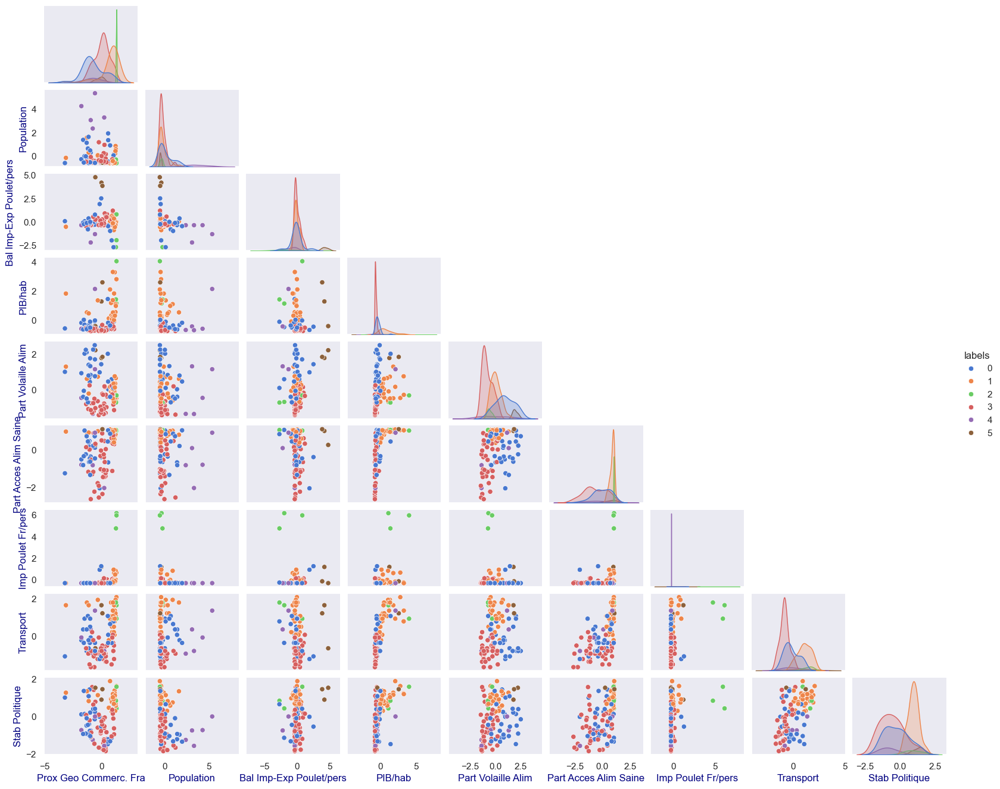

In [781]:
sns.pairplot(df_X_Orig_scaled_ACH, 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait 3 pouces de haut
             aspect=1.2
            )

In [782]:
#le Dataframe des cluster calculé par la moyenne
df_X_Orig_scaled_ACH_grouped = (df_X_Orig_scaled_ACH.groupby(by=['labels'])).mean()
df_X_Orig_scaled_ACH_grouped.index.name = 'cluster'
display(df_X_Orig_scaled_ACH_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.741165,0.068014,-0.124460,-0.336069,0.939344,-0.029573,-0.203876,-0.149468,-0.247358
1,0.700967,-0.219768,-0.093600,0.892318,0.042296,0.864278,-0.031915,1.083640,0.952801
2,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
3,0.037850,-0.272661,0.042116,-0.632749,-0.780135,-0.659452,-0.226786,-0.821885,-0.559782
4,-0.765943,3.675473,-0.892932,-0.049125,-0.133748,-0.526339,-0.304511,-0.007834,-0.850002
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300


In [783]:
df_temp =df_X_Orig_scaled_ACH.copy()
df_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,3
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,3
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,3
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


In [784]:
df_temp_grouped = df_X_Orig_scaled_ACH_grouped.copy()
df_temp_grouped.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.741165,0.068014,-0.124460,-0.336069,0.939344,-0.029573,-0.203876,-0.149468,-0.247358
1,0.700967,-0.219768,-0.093600,0.892318,0.042296,0.864278,-0.031915,1.083640,0.952801
2,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
3,0.037850,-0.272661,0.042116,-0.632749,-0.780135,-0.659452,-0.226786,-0.821885,-0.559782
4,-0.765943,3.675473,-0.892932,-0.049125,-0.133748,-0.526339,-0.304511,-0.007834,-0.850002


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.5 - Visualisation  des données (centrées réduites) : </h4>
</div>

In [785]:
df_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,3
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,3


In [786]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.741165,0.068014,-0.12446,-0.336069,0.939344,-0.029573,-0.203876,-0.149468,-0.247358
1,0.700967,-0.219768,-0.09360,0.892318,0.042296,0.864278,-0.031915,1.083640,0.952801


In [787]:
#CA fait doublon
# df pour la visualisation
#df = df_temp
#df_means = df_temp_grouped #le df à utiliser pour les visualisations

**Liste des pays**

In [788]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BLR  / BOL  / CHL  / COG  / COL  / CRI  / DOM  / EGY  / FJI  / GAB  / GTM  / GUY  / HND  / ISR  / JAM  / MEX  / MUS  / MYS  / PAN  / PER  / PHL  / POL  / RUS  / THA  / TTO  / TUR  / URY  / VNM  / ZAF 



cluster 1 :
AUS  / AUT  / BGR  / CAN  / CHE  / CYP  / CZE  / DEU  / DNK  / ESP  / EST  / FIN  / GBR  / GRC  / HRV  / HUN  / IRL  / ISL  / ITA  / JPN  / KOR  / LTU  / LVA  / MLT  / NOR  / PRT  / SVK  / SVN  / SWE 



cluster 2 :
BEL  / LUX  / NLD 



cluster 3 :
AGO  / ALB  / ARM  / BEN  / BFA  / BIH  / BTN  / BWA  / CAF  / CMR  / COD  / DJI  / DZA  / GHA  / GIN  / GMB  / GNB  / HTI  / IRN  / IRQ  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MKD  / MLI  / MNG  / MRT  / NAM  / NIC  / PRY  / ROU  / RWA  / SDN  / SRB  / TGO  / TJK  / UZB 



cluster 4 :
BGD  / BRA  / IDN  / NGA  / USA 



cluster 5 :
ARE  / GRD  / QAT 





**HEATMAP**

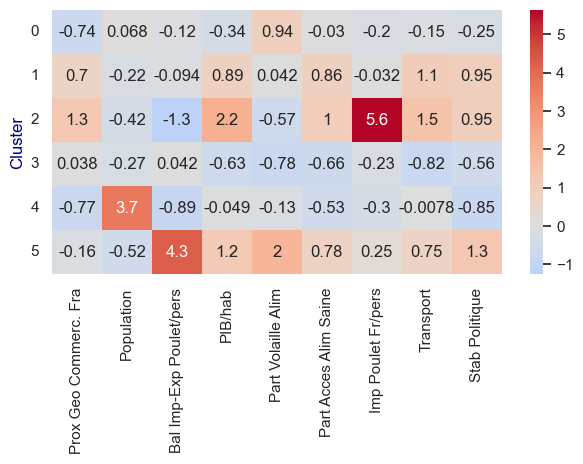

In [789]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            center =0,
            cmap='coolwarm'#pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

Cluster 2 intéressant :  
Import de poulet Fr élevé et bon niveau de vie
Cluster 5 intéressant :  
BonNiveau de vie  et Bonne consommation de Poulet international et un peu français

**RADAR**

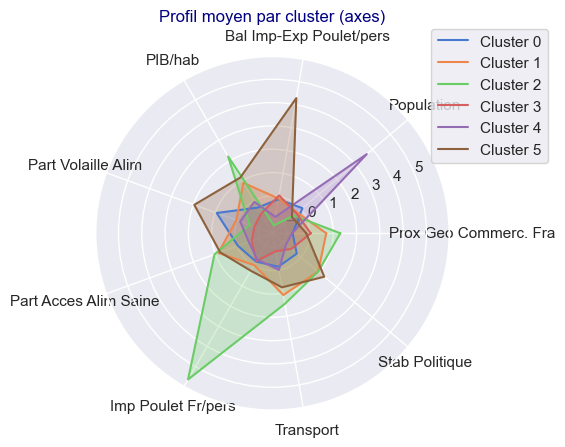

In [790]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


On a bien les Clusters 2 et 5 qui ressortent .

cluster 2 : 
BEL  / LUX  / NLD

cluster 5 : 
ARE  / GRD  / QAT  

##### Boxplot

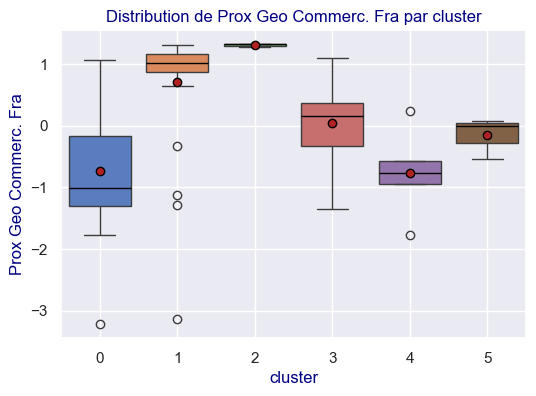

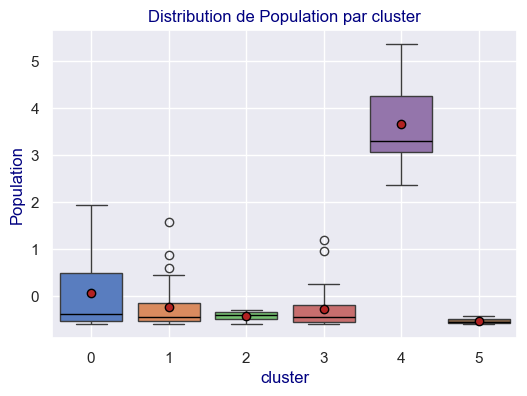

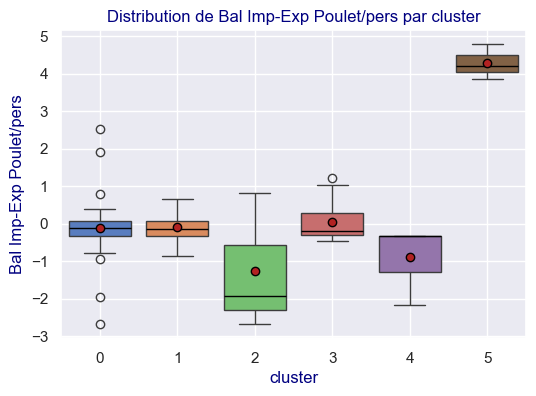

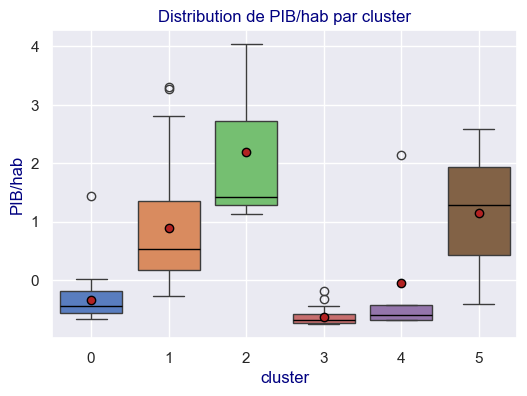

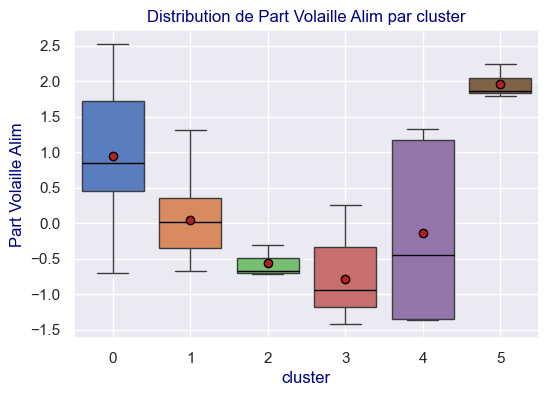

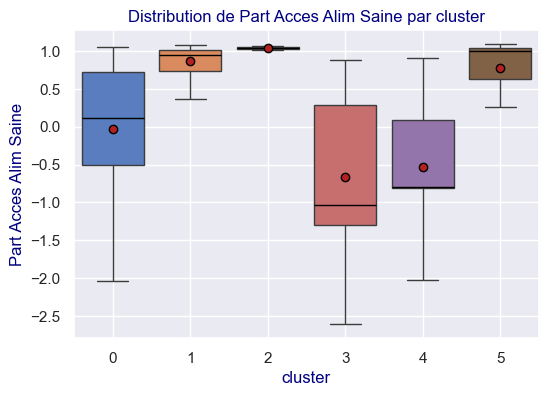

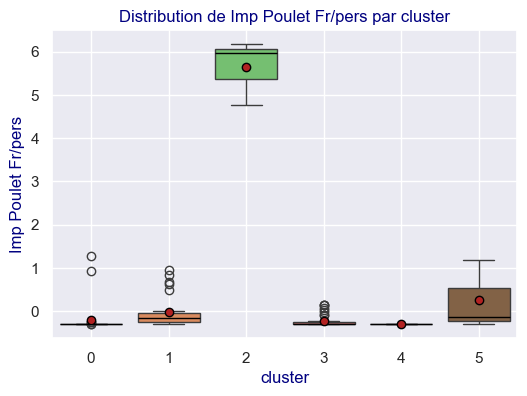

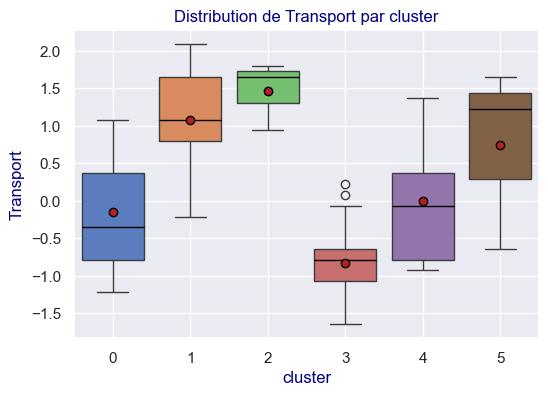

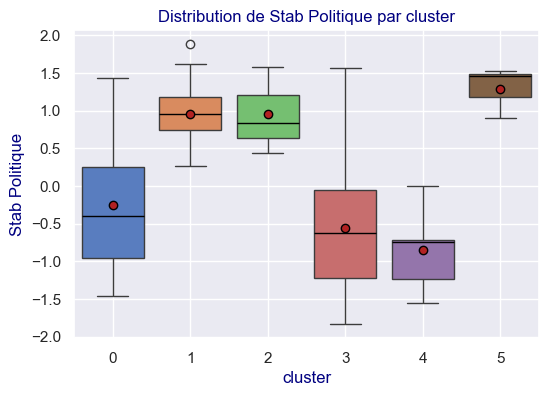

In [791]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.5 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

In [792]:
X_proj_temp = df_temp.copy()

In [793]:
X_proj_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,3
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,3
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,3
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


In [794]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.741165,0.068014,-0.124460,-0.336069,0.939344,-0.029573,-0.203876,-0.149468,-0.247358
1,0.700967,-0.219768,-0.093600,0.892318,0.042296,0.864278,-0.031915,1.083640,0.952801
2,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442
3,0.037850,-0.272661,0.042116,-0.632749,-0.780135,-0.659452,-0.226786,-0.821885,-0.559782
4,-0.765943,3.675473,-0.892932,-0.049125,-0.133748,-0.526339,-0.304511,-0.007834,-0.850002
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300


In [795]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
cluster,,,,,,,,,,
0,-0.741165,0.068014,-0.124460,-0.336069,0.939344,-0.029573,-0.203876,-0.149468,-0.247358,0
1,0.700967,-0.219768,-0.093600,0.892318,0.042296,0.864278,-0.031915,1.083640,0.952801,1
2,1.304258,-0.416949,-1.262147,2.198662,-0.567256,1.040125,5.635434,1.466613,0.953442,2
3,0.037850,-0.272661,0.042116,-0.632749,-0.780135,-0.659452,-0.226786,-0.821885,-0.559782,3
4,-0.765943,3.675473,-0.892932,-0.049125,-0.133748,-0.526339,-0.304511,-0.007834,-0.850002,4
5,-0.156398,-0.515509,4.282693,1.153712,1.962836,0.780803,0.250807,0.748538,1.294300,5


Les axes intéressants sont  poulet International(2)  Poulet FR(6) et PIB(3) (éventuellement la population en (1)

2 # Bal Imp-Exp Poulet/pers  
3 # PIB/hab	  
6 # Imp Poulet Fr/pers

Et on affiche le graphique pour poulet International(2)  Poulet FR(6) :

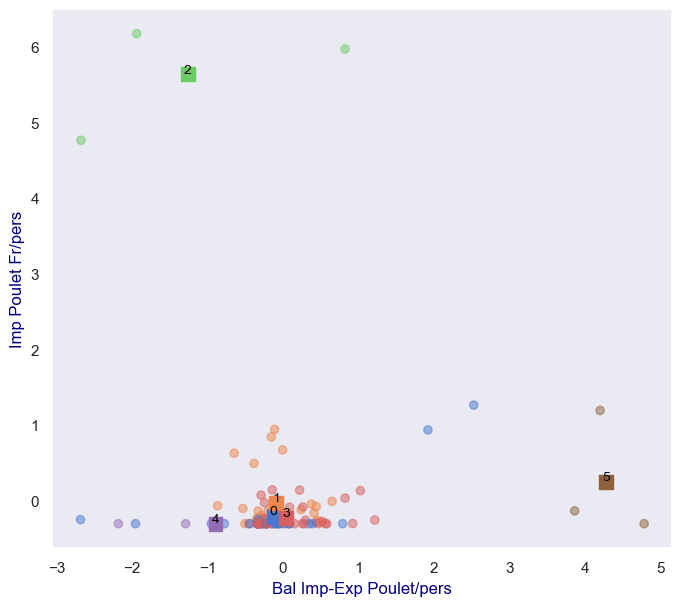

In [796]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
#3 # PIB/hab	

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


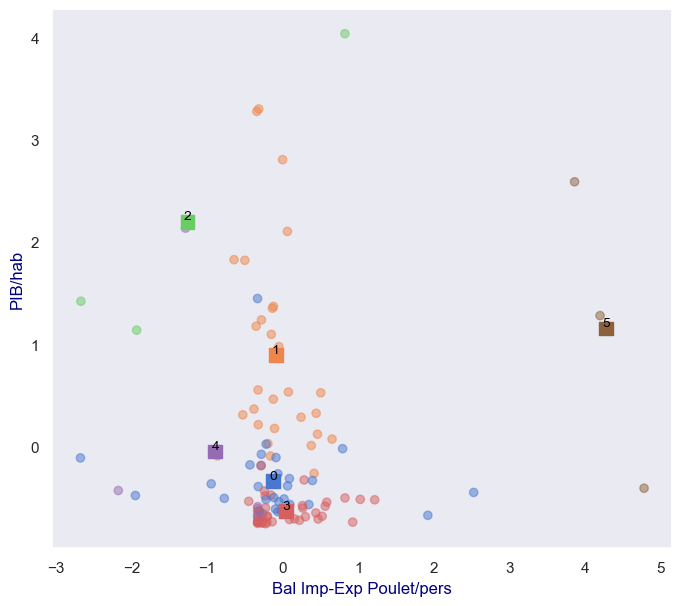

In [797]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 3 # PIB/hab
#6 # Imp Poulet Fr/pers

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :

In [798]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [799]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.1.6 - Visualisation des données projetées : </h4>
</div>

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.  

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

**Projetons X_Orig_scaled / df_X_Orig_scaled_AXH**

A l'identique du reste je pourrai projeter sur seulement 4 composantes :
#nb_components_Orig = 4

In [800]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_Orig = 9

#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_Orig = PCA(n_components= nb_components_Orig )

#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_Orig .fit(X_Orig_scaled)

#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_Orig_proj = pca_Orig.transform(X_Orig_scaled)

In [801]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_Orig_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_Orig
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [802]:
df_X_Orig_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,3
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,3
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,5
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,3
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,1


In [803]:
#Mappons df_X_tete_scaled avec nos labels
df_X_Orig_proj_ACH = df_temp.join(df_X_Orig_scaled_ACH["labels"])
df_X_Orig_proj_ACH.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,3
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,3
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,3
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,1


In [804]:
X_proj_temp = df_X_Orig_proj_ACH.copy()
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,3
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,3
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,3
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,1


**Récupérons les centroïdes**

Etant donné la linéarité de la transformation, 
les barycentres sont conservés et donc je peux soit projetés les centroids soit récupérer les barycentres de df_X_Orig_proj_ACH

In [805]:
df_X_Orig_proj_ACH_grouped = (df_X_Orig_proj_ACH.groupby(by=['labels'])).mean()
df_X_Orig_proj_ACH_grouped.index.name = 'cluster'
display(df_X_Orig_proj_ACH_grouped)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987
2,4.381050,-3.098643,-0.963286,3.435539,1.188001,1.145697,-0.517875,0.056788,0.049061
3,-1.380399,-0.405271,-0.668672,-0.091289,0.026184,-0.125236,-0.042266,0.117623,0.067084
4,-1.263324,-1.007382,3.279576,0.809139,-0.851255,-0.802827,-0.424633,0.215673,-0.623380
5,2.272500,3.753807,-1.237247,1.207011,-1.829053,-0.943912,-0.334173,-0.187347,0.312046


In [806]:
centroids_proj_temp =df_X_Orig_proj_ACH_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987
2,4.381050,-3.098643,-0.963286,3.435539,1.188001,1.145697,-0.517875,0.056788,0.049061
3,-1.380399,-0.405271,-0.668672,-0.091289,0.026184,-0.125236,-0.042266,0.117623,0.067084
4,-1.263324,-1.007382,3.279576,0.809139,-0.851255,-0.802827,-0.424633,0.215673,-0.623380
5,2.272500,3.753807,-1.237247,1.207011,-1.829053,-0.943912,-0.334173,-0.187347,0.312046


Travaillons sur des copies :

In [807]:
df_temp = df_X_Orig_proj_ACH.copy()
df_temp_grouped = df_X_Orig_proj_ACH_grouped.copy()

In [808]:
df_temp.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,3
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,3


In [809]:
df_temp_grouped.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987


**Liste des pays**

In [810]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BLR  / BOL  / CHL  / COG  / COL  / CRI  / DOM  / EGY  / FJI  / GAB  / GTM  / GUY  / HND  / ISR  / JAM  / MEX  / MUS  / MYS  / PAN  / PER  / PHL  / POL  / RUS  / THA  / TTO  / TUR  / URY  / VNM  / ZAF 



cluster 1 :
AUS  / AUT  / BGR  / CAN  / CHE  / CYP  / CZE  / DEU  / DNK  / ESP  / EST  / FIN  / GBR  / GRC  / HRV  / HUN  / IRL  / ISL  / ITA  / JPN  / KOR  / LTU  / LVA  / MLT  / NOR  / PRT  / SVK  / SVN  / SWE 



cluster 2 :
BEL  / LUX  / NLD 



cluster 3 :
AGO  / ALB  / ARM  / BEN  / BFA  / BIH  / BTN  / BWA  / CAF  / CMR  / COD  / DJI  / DZA  / GHA  / GIN  / GMB  / GNB  / HTI  / IRN  / IRQ  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MKD  / MLI  / MNG  / MRT  / NAM  / NIC  / PRY  / ROU  / RWA  / SDN  / SRB  / TGO  / TJK  / UZB 



cluster 4 :
BGD  / BRA  / IDN  / NGA  / USA 



cluster 5 :
ARE  / GRD  / QAT 





**HEATMAP**

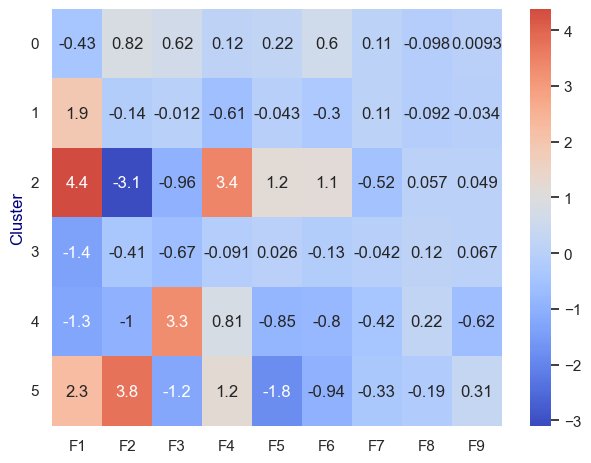

In [811]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  


**RADAR**

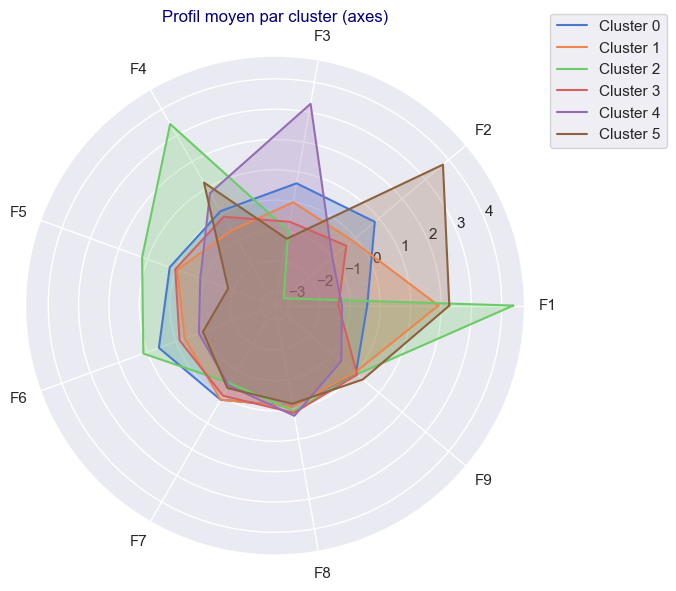

In [812]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

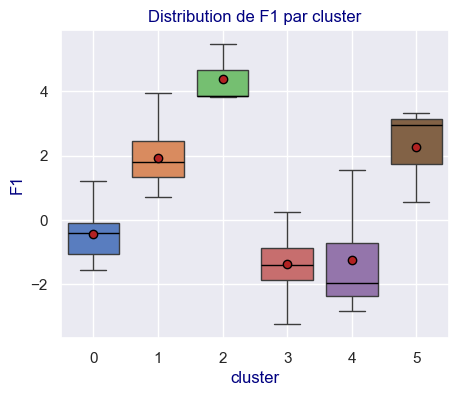

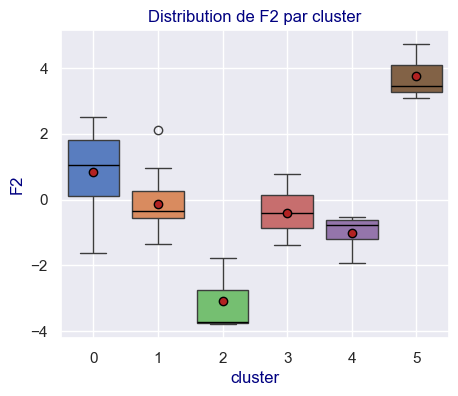

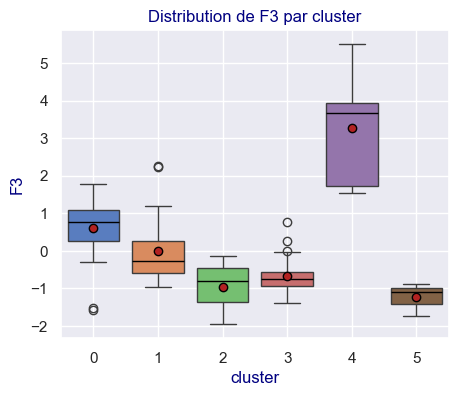

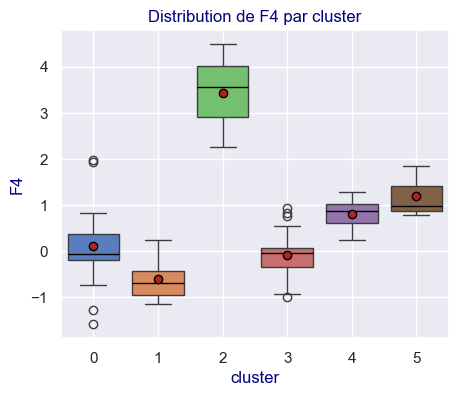

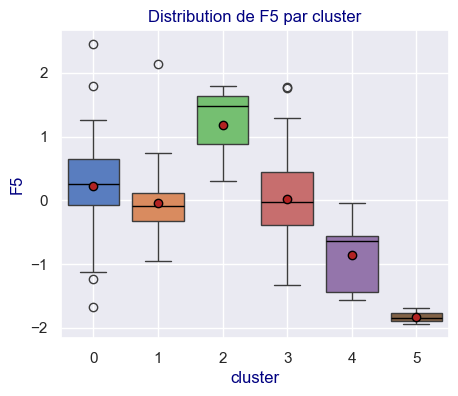

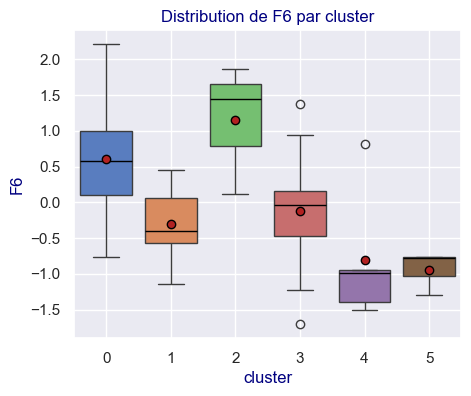

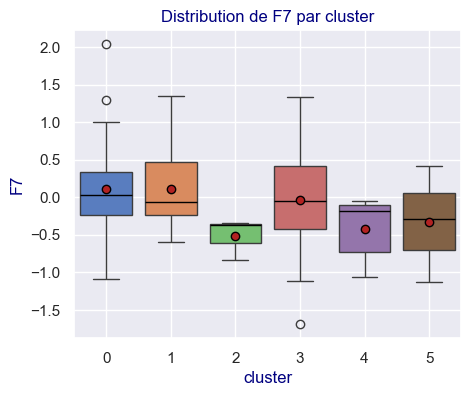

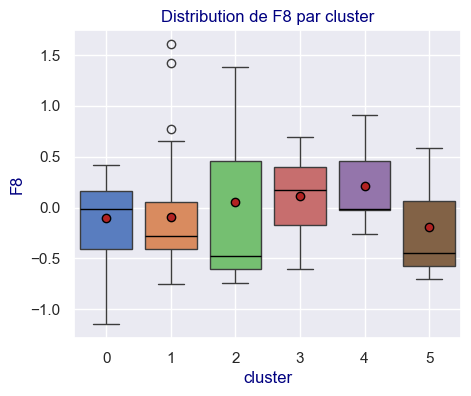

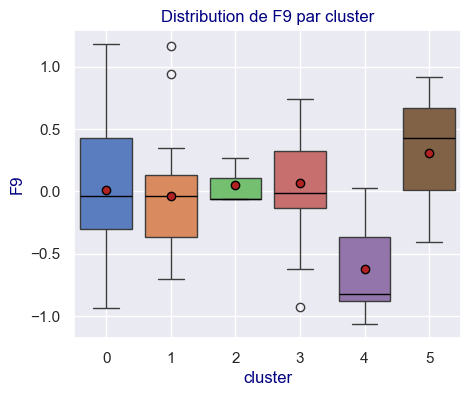

In [813]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [814]:
X_proj_temp = df_temp.copy()

In [815]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,3
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,3
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,3
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,1


In [816]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987
2,4.381050,-3.098643,-0.963286,3.435539,1.188001,1.145697,-0.517875,0.056788,0.049061
3,-1.380399,-0.405271,-0.668672,-0.091289,0.026184,-0.125236,-0.042266,0.117623,0.067084
4,-1.263324,-1.007382,3.279576,0.809139,-0.851255,-0.802827,-0.424633,0.215673,-0.623380
5,2.272500,3.753807,-1.237247,1.207011,-1.829053,-0.943912,-0.334173,-0.187347,0.312046


In [817]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269,0
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987,1
2,4.381050,-3.098643,-0.963286,3.435539,1.188001,1.145697,-0.517875,0.056788,0.049061,2
3,-1.380399,-0.405271,-0.668672,-0.091289,0.026184,-0.125236,-0.042266,0.117623,0.067084,3
4,-1.263324,-1.007382,3.279576,0.809139,-0.851255,-0.802827,-0.424633,0.215673,-0.623380,4
5,2.272500,3.753807,-1.237247,1.207011,-1.829053,-0.943912,-0.334173,-0.187347,0.312046,5


Et on affiche pour F1 et F2

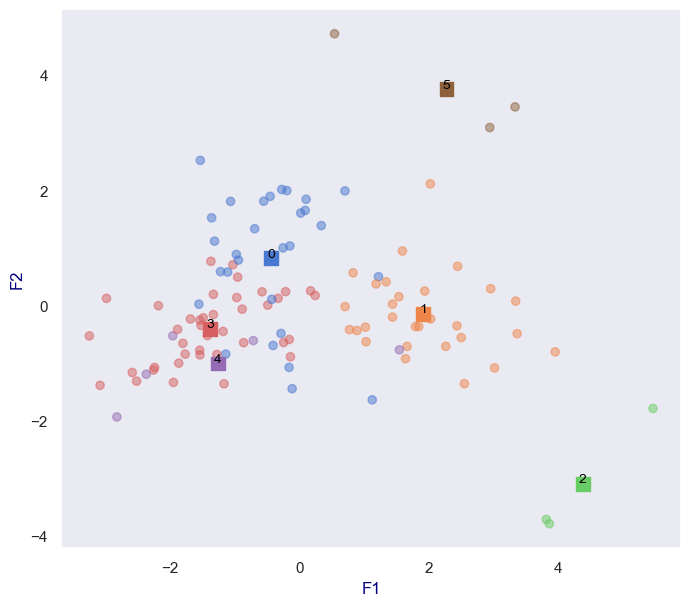

In [818]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


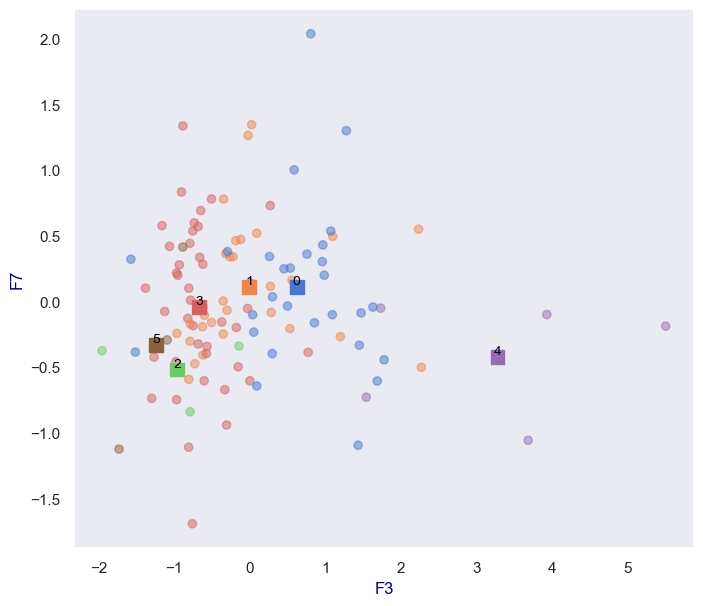

In [819]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 6], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 6], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 6] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[2])
ax.set_ylabel(X_proj_temp.columns[6])
plt.show()


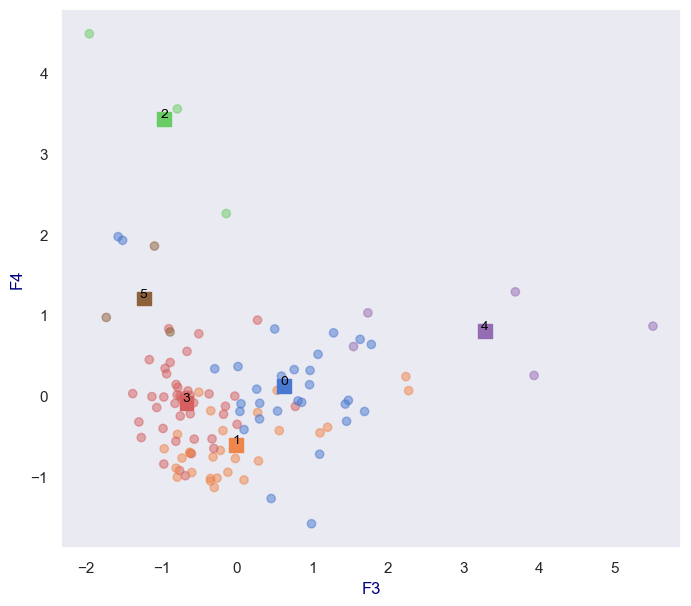

In [820]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

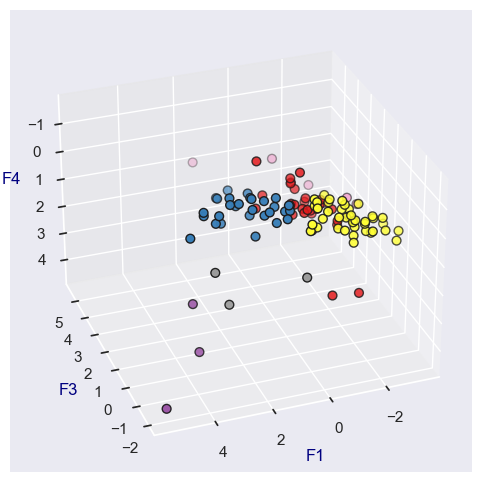

In [821]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

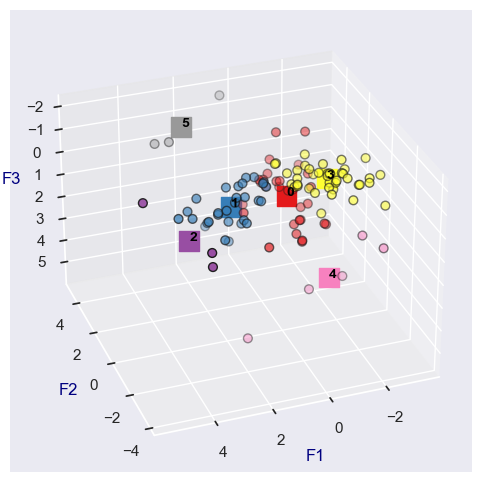

In [822]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [823]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,3
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,3
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,5
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,3
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,1


In [824]:
centroids_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-0.433526,0.821816,0.619716,0.120765,0.218608,0.599089,0.111053,-0.098200,0.009269,0
1,1.914640,-0.142936,-0.012155,-0.611472,-0.042543,-0.304487,0.110058,-0.091774,-0.033987,1
2,4.381050,-3.098643,-0.963286,3.435539,1.188001,1.145697,-0.517875,0.056788,0.049061,2
3,-1.380399,-0.405271,-0.668672,-0.091289,0.026184,-0.125236,-0.042266,0.117623,0.067084,3
4,-1.263324,-1.007382,3.279576,0.809139,-0.851255,-0.802827,-0.424633,0.215673,-0.623380,4


In [825]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [826]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [827]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [828]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Orig.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

In [829]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import KMeans

##### DATA :

In [830]:
df_X_Orig_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [831]:
df_X_Orig_scaled_KM=df_X_Orig_scaled.copy(deep=True)
df_X_Orig_scaled_KM.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510


In [832]:
df_X_Orig_scaled_KM.shape

(110, 9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [833]:
n_clusters=6

In [834]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [835]:
kmeans.fit(df_X_Orig_scaled_KM)

KMeans(n_clusters=6)

On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [836]:
kmeans.inertia_

465.7350090065034

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

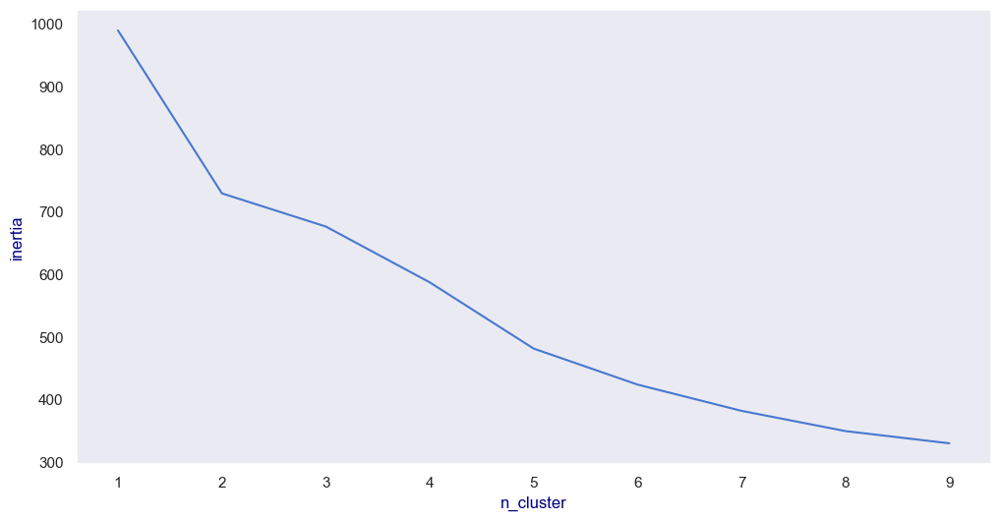

In [837]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 10)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_Orig_scaled_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(12,6))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
2, 5 7 ?

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2.3bis - Methode de la silhouette sur le K-means </h4>
</div>

##### JOLI Mais pas très pratique :

##### FIN JOLI Mais pas très pratique :

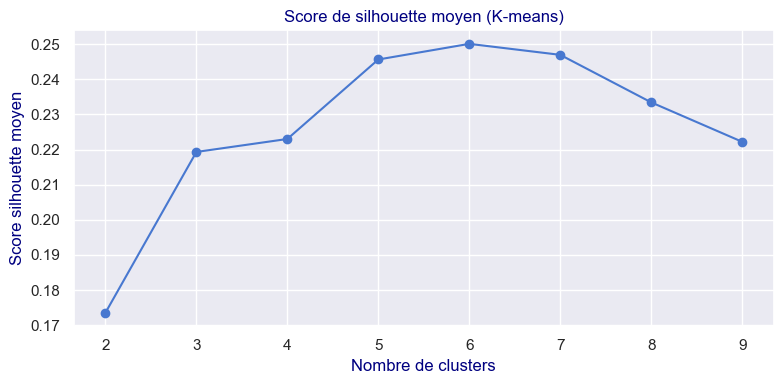

In [838]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_Orig_scaled_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 10)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
Les scores ne sont tous pas très élevé et compris entre 0.17 et 0.25 donnnées moyennemnt structurées.  
6 semble clairement le nb de clusters donnnant les meilleurs résultats.  

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Orig.2one - K-means Test à 6 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [839]:
n_clusters=6

In [840]:
df_X_Orig_scaled_KM_N_temp =df_X_Orig_scaled_KM.copy()

In [841]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_Orig_scaled_KM_N_temp  )

KMeans(n_clusters=6)

Voici les clusters : 

In [842]:
kmeans.labels_

array([0, 4, 1, 0, 2, 1, 1, 0, 0, 3, 4, 4, 4, 2, 3, 4, 0, 0, 1, 1, 2, 0,
       0, 0, 3, 2, 4, 1, 1, 0, 1, 2, 4, 3, 1, 1, 1, 2, 2, 1, 0, 0, 0, 0,
       1, 2, 2, 2, 2, 4, 0, 4, 3, 1, 4, 4, 1, 1, 1, 2, 3, 4, 0, 1, 0, 0,
       0, 1, 1, 1, 4, 0, 3, 4, 0, 1, 4, 0, 2, 2, 0, 3, 2, 1, 1, 2, 2, 3,
       1, 1, 0, 1, 0, 3, 0, 0, 4, 4, 1, 1, 0, 3, 0, 2, 4, 2, 5, 4, 3, 3])

In [843]:
pd.Series(kmeans.labels_).value_counts()

0    29
1    29
4    19
2    19
3    13
5     1
Name: count, dtype: int64

Ajoutons nos labels à `df_X_Orig_scaled_KM_N_temp  `

In [844]:
df_X_Orig_scaled_KM_N_temp  ["labels"] = kmeans.labels_
df_X_Orig_scaled_KM_N_temp  

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,4
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,2
...,...,...,...,...,...,...,...,...,...,...
URY,-1.556295,-0.533413,-0.221024,0.023122,-0.053515,-0.336784,-0.304515,-0.352509,1.362471,2
USA,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240,5
UZB,0.006023,0.016978,-0.204202,-0.682323,-1.133407,0.496470,-0.304515,-0.783354,-0.255051,4


Affichons cela de façon graphique :

In [845]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Orig_scaled_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

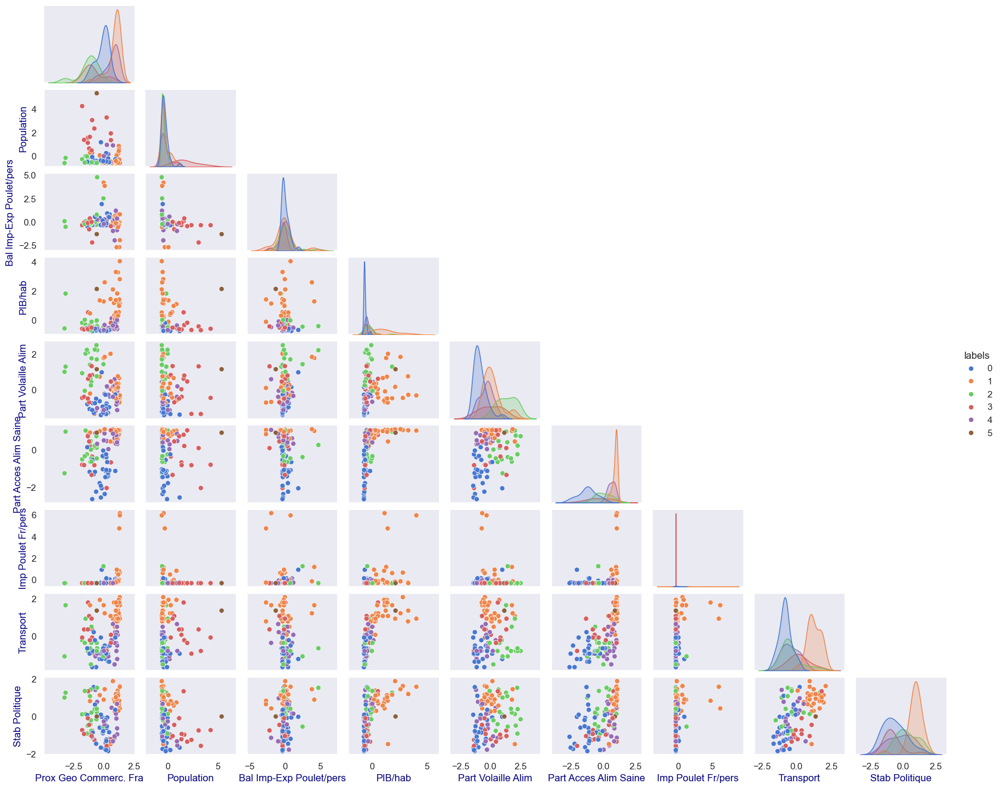

In [846]:
sns.pairplot(df_X_Orig_scaled_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait x pouces de haut
             aspect=1.2)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2one.2 - Interprétation: </h4>
</div>

In [847]:
df_X_Orig_scaled_KM_N_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,4


CENTRE DE GRAVITE :

In [848]:
df_X_Orig_scaled_KM_N_temp_grouped = (df_X_Orig_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Orig_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Orig_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.109682,-0.294660,0.051209,-0.669175,-0.867230,-1.227912,-0.185750,-0.822972,-0.641000
1,0.877731,-0.272466,-0.042946,1.229026,0.142300,0.906356,0.616017,1.252016,0.902795
2,-1.225626,-0.413474,0.313772,-0.258271,1.356287,0.000758,-0.219218,-0.420537,0.304672
3,-0.813803,1.813623,-0.354232,-0.444414,0.055132,-0.270257,-0.303950,0.199856,-0.769913
4,0.640409,-0.244227,-0.016213,-0.404552,-0.348816,0.627413,-0.213513,-0.443213,-0.177747
5,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240


LES CENTROIDES :

In [849]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-1.09681961e-01, -2.94659838e-01,  5.12094956e-02,
        -6.69175199e-01, -8.67229986e-01, -1.22791202e+00,
        -1.85749769e-01, -8.22971801e-01, -6.41000006e-01],
       [ 8.77731398e-01, -2.72466200e-01, -4.29458184e-02,
         1.22902604e+00,  1.42300230e-01,  9.06356192e-01,
         6.16016893e-01,  1.25201563e+00,  9.02794691e-01],
       [-1.22562587e+00, -4.13474140e-01,  3.13771862e-01,
        -2.58271424e-01,  1.35628716e+00,  7.57692429e-04,
        -2.19217985e-01, -4.20537358e-01,  3.04672049e-01],
       [-8.13803167e-01,  1.81362328e+00, -3.54231820e-01,
        -4.44414079e-01,  5.51320792e-02, -2.70257247e-01,
        -3.03949630e-01,  1.99855675e-01, -7.69912598e-01],
       [ 6.40409140e-01, -2.44227065e-01, -1.62131116e-02,
        -4.04551718e-01, -3.48815868e-01,  6.27412790e-01,
        -2.13513374e-01, -4.43213392e-01, -1.77746874e-01],
       [-5.74874555e-01,  5.36587537e+00, -1.28824923e+00,
         2.13534824e+00,  1.16429135e+00,  9.032241

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [850]:
df_temp = df_X_Orig_scaled_KM_N_temp  .copy()
df_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,4
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,2


In [851]:
df_temp_grouped =df_X_Orig_scaled_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.109682,-0.294660,0.051209,-0.669175,-0.867230,-1.227912,-0.185750,-0.822972,-0.641000
1,0.877731,-0.272466,-0.042946,1.229026,0.142300,0.906356,0.616017,1.252016,0.902795
2,-1.225626,-0.413474,0.313772,-0.258271,1.356287,0.000758,-0.219218,-0.420537,0.304672
3,-0.813803,1.813623,-0.354232,-0.444414,0.055132,-0.270257,-0.303950,0.199856,-0.769913
4,0.640409,-0.244227,-0.016213,-0.404552,-0.348816,0.627413,-0.213513,-0.443213,-0.177747


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2one.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [852]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ARM  / BEN  / BFA  / BWA  / CAF  / CMR  / COD  / COG  / DJI  / GHA  / GIN  / GMB  / GNB  / HTI  / KGZ  / LAO  / LBR  / LKA  / MDG  / MLI  / MRT  / NAM  / PRY  / ROU  / RWA  / SDN  / TGO  / TJK 



cluster 1 :
ARE  / AUT  / BEL  / CAN  / CHE  / CZE  / DEU  / DNK  / ESP  / EST  / FIN  / GBR  / GRC  / IRL  / ISL  / ISR  / ITA  / KOR  / LTU  / LUX  / LVA  / MLT  / NLD  / NOR  / POL  / PRT  / QAT  / SVN  / SWE 



cluster 2 :
AUS  / BOL  / CHL  / CRI  / DOM  / FJI  / GAB  / GRD  / GTM  / GUY  / HND  / JAM  / MUS  / MYS  / NIC  / PAN  / PER  / TTO  / URY 



cluster 3 :
BGD  / BRA  / COL  / EGY  / IDN  / JPN  / MEX  / NGA  / PHL  / RUS  / THA  / VNM  / ZAF 



cluster 4 :
ALB  / BGR  / BIH  / BLR  / BTN  / CYP  / DZA  / HRV  / HUN  / IRN  / IRQ  / KAZ  / MDA  / MKD  / MNG  / SRB  / SVK  / TUR  / UZB 



cluster 5 :
USA 





**HEATMAP**

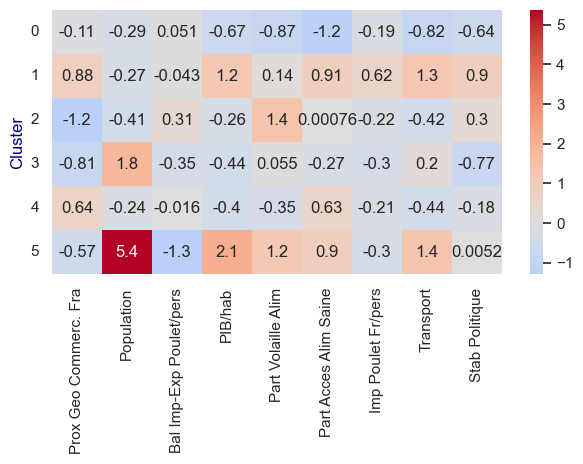

In [853]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

La distinction se fait uniquement sur le niveau de vie... pas très intéressant !!!

**RADAR**

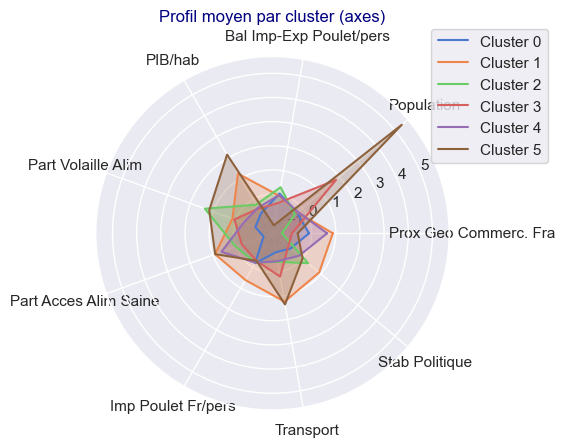

In [854]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

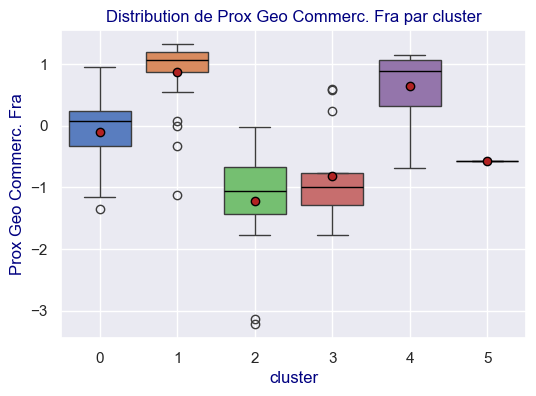

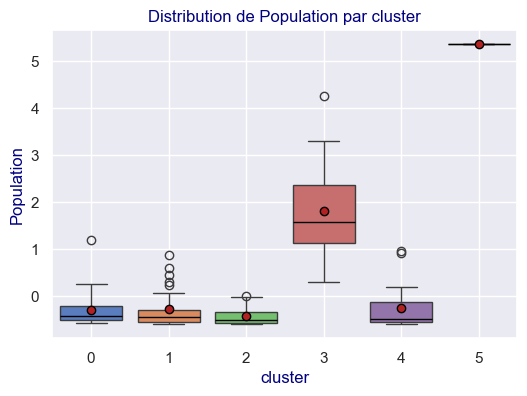

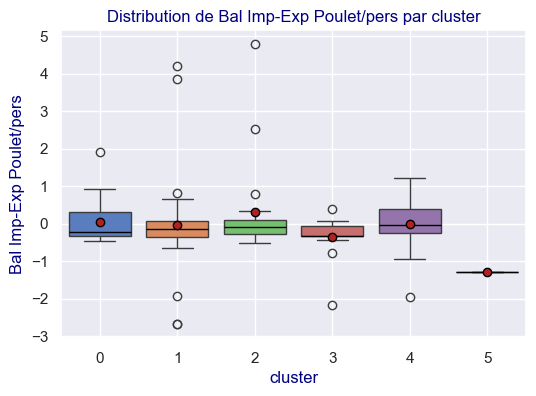

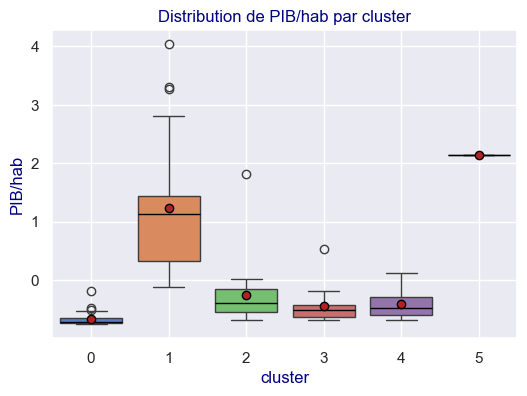

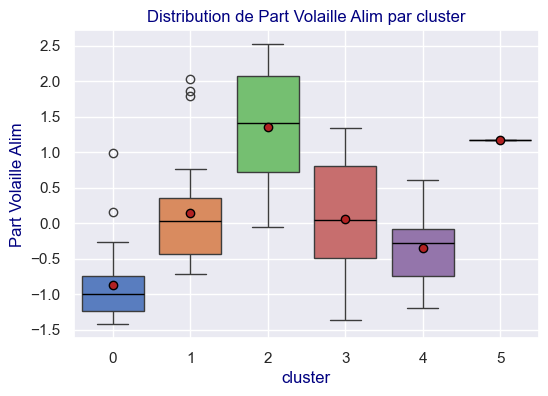

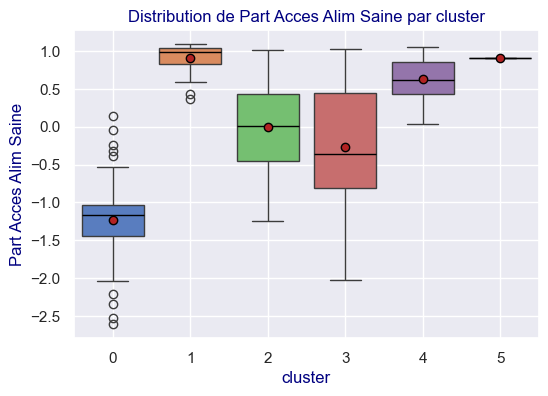

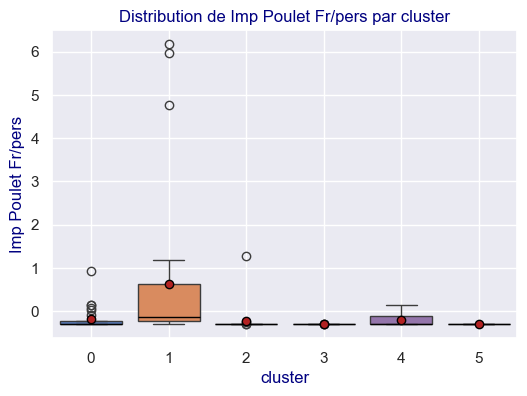

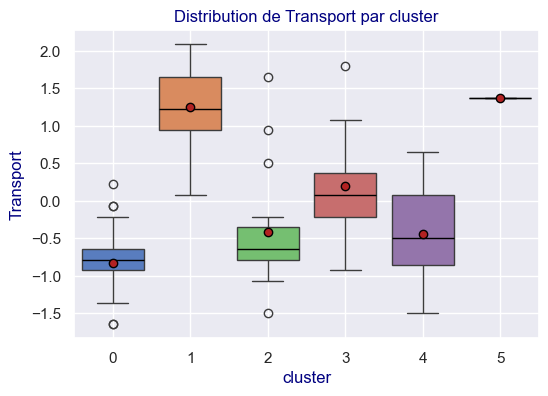

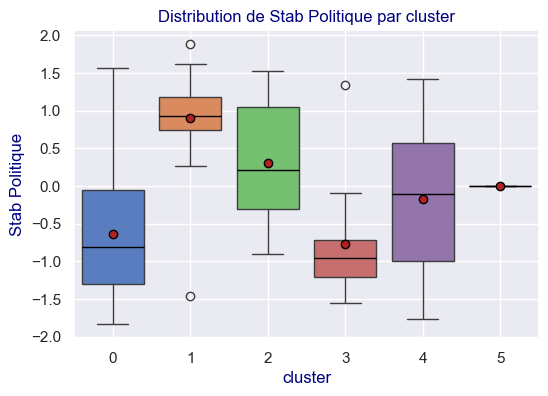

In [855]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2one.4 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

In [856]:
X_proj_temp = df_temp.copy()

In [857]:
X_proj_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,4
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,2


In [858]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.109682,-0.294660,0.051209,-0.669175,-0.867230,-1.227912,-0.185750,-0.822972,-0.641000
1,0.877731,-0.272466,-0.042946,1.229026,0.142300,0.906356,0.616017,1.252016,0.902795
2,-1.225626,-0.413474,0.313772,-0.258271,1.356287,0.000758,-0.219218,-0.420537,0.304672
3,-0.813803,1.813623,-0.354232,-0.444414,0.055132,-0.270257,-0.303950,0.199856,-0.769913
4,0.640409,-0.244227,-0.016213,-0.404552,-0.348816,0.627413,-0.213513,-0.443213,-0.177747
5,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240


In [859]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
cluster,,,,,,,,,,
0,-0.109682,-0.294660,0.051209,-0.669175,-0.867230,-1.227912,-0.185750,-0.822972,-0.641000,0
1,0.877731,-0.272466,-0.042946,1.229026,0.142300,0.906356,0.616017,1.252016,0.902795,1
2,-1.225626,-0.413474,0.313772,-0.258271,1.356287,0.000758,-0.219218,-0.420537,0.304672,2
3,-0.813803,1.813623,-0.354232,-0.444414,0.055132,-0.270257,-0.303950,0.199856,-0.769913,3
4,0.640409,-0.244227,-0.016213,-0.404552,-0.348816,0.627413,-0.213513,-0.443213,-0.177747,4
5,-0.574875,5.365875,-1.288249,2.135348,1.164291,0.903224,-0.304506,1.370869,0.005240,5


Les axes intéressants sont  poulet International(2)  Poulet FR(6) et PIB(3) (éventuellement la population en (1)

2 # Bal Imp-Exp Poulet/pers  
3 # PIB/hab	  
6 # Imp Poulet Fr/pers

Et on affiche le graphique pour poulet International(2)  Poulet FR(6) :

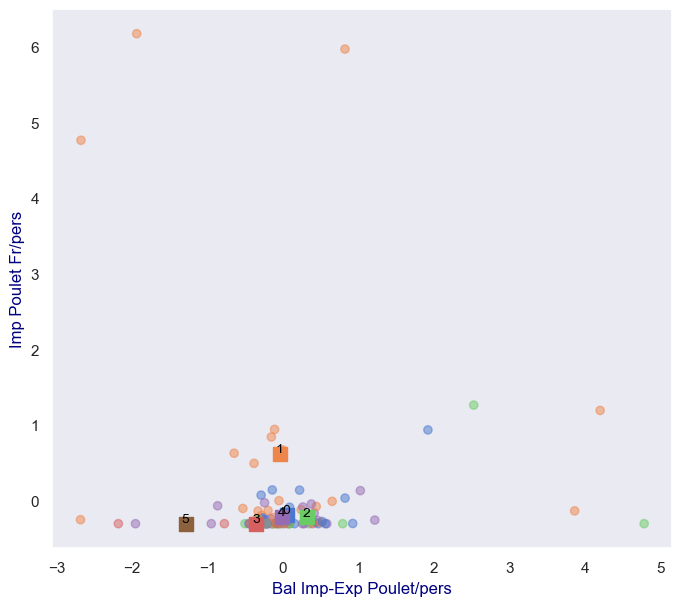

In [860]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
#3 # PIB/hab	

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


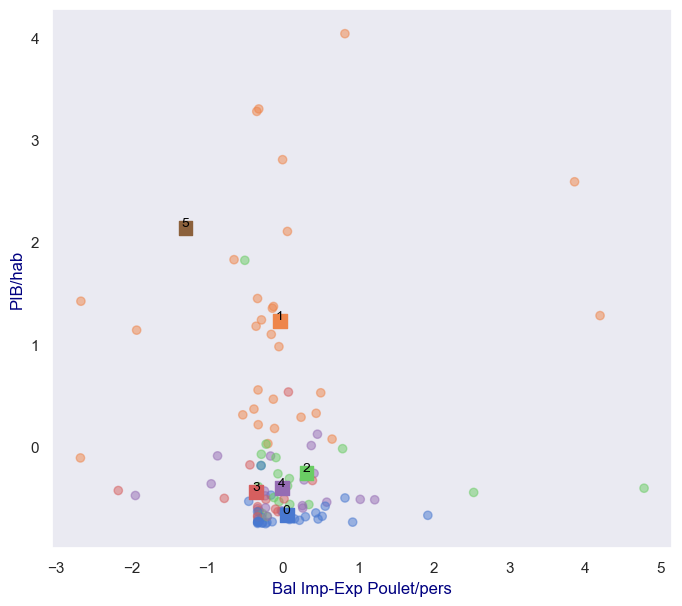

In [861]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 3 # PIB/hab
#6 # Imp Poulet Fr/pers

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :

In [862]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [863]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Orig.2one.6 - Visualisation des données projetées : </h4>
</div>

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.  

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

**Projetons X_Orig_scaled / df_X_Orig_scaled_AXH**

A l'identique du reste je pourrai projeter sur seulement 4 composantes :
#nb_components_Orig = 4

In [864]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_Orig = 9

#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_Orig = PCA(n_components= nb_components_Orig )

#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_Orig .fit(X_Orig_scaled)

#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_Orig_proj = pca_Orig.transform(X_Orig_scaled)

In [865]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_Orig_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_Orig
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279


In [866]:
df_X_Orig_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.335821,0.029122,0.437303,-0.649399,-0.635134,-1.762398,-0.286989,-1.214199,-0.589711,0
ALB,1.021431,-0.543240,1.025455,-0.516818,-0.164353,0.607044,0.132390,-0.352509,0.172570,4
ARE,-0.005647,-0.413886,4.200933,1.280155,1.796154,0.998002,1.192365,1.658099,0.897666,1
ARM,0.487093,-0.542311,0.823476,-0.502961,-0.367776,-1.079209,0.033562,-0.496124,-1.184662,0
AUS,-3.132481,-0.135465,-0.502803,1.820889,1.311017,0.962460,-0.304515,1.658099,1.269510,2


In [867]:
#Mappons df_X_tete_scaled avec nos labels
df_X_Orig_proj_KM_N_temp = df_temp.join(df_X_Orig_scaled_KM_N_temp["labels"])
df_X_Orig_proj_KM_N_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,0
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,4
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,0
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,2


In [868]:
X_proj_temp = df_X_Orig_proj_KM_N_temp.copy()
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,0
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,4
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,0
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,2


**Récupérons les centroïdes**

Etant donné la linéarité de la transformation, 
les barycentres sont conservés et donc je peux soit projetés les centroids soit récupérer les barycentres de df_X_Orig_proj_KM_N_temp

In [869]:
df_X_Orig_proj_KM_N_temp_grouped = (df_X_Orig_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Orig_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Orig_proj_KM_N_temp_grouped)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598
2,-0.276205,1.747765,0.282864,0.225993,0.615380,0.583733,-0.003603,0.076026,-0.090770
3,-1.008697,-0.227637,1.872887,0.400612,-0.381603,-0.286094,-0.224834,-0.222455,0.103299
4,-0.141324,-0.351502,-0.501265,-0.672324,-0.385370,0.379040,-0.514616,0.127065,0.051636
5,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480


In [870]:
centroids_proj_temp =df_X_Orig_proj_KM_N_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598
2,-0.276205,1.747765,0.282864,0.225993,0.615380,0.583733,-0.003603,0.076026,-0.090770
3,-1.008697,-0.227637,1.872887,0.400612,-0.381603,-0.286094,-0.224834,-0.222455,0.103299
4,-0.141324,-0.351502,-0.501265,-0.672324,-0.385370,0.379040,-0.514616,0.127065,0.051636
5,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480


Travaillons sur des copies :

In [871]:
df_temp = df_X_Orig_proj_KM_N_temp.copy()
df_temp_grouped = df_X_Orig_proj_KM_N_temp_grouped.copy()

In [872]:
df_temp.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,0
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,4


In [873]:
df_temp_grouped.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598


**Liste des pays**

In [874]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ARM  / BEN  / BFA  / BWA  / CAF  / CMR  / COD  / COG  / DJI  / GHA  / GIN  / GMB  / GNB  / HTI  / KGZ  / LAO  / LBR  / LKA  / MDG  / MLI  / MRT  / NAM  / PRY  / ROU  / RWA  / SDN  / TGO  / TJK 



cluster 1 :
ARE  / AUT  / BEL  / CAN  / CHE  / CZE  / DEU  / DNK  / ESP  / EST  / FIN  / GBR  / GRC  / IRL  / ISL  / ISR  / ITA  / KOR  / LTU  / LUX  / LVA  / MLT  / NLD  / NOR  / POL  / PRT  / QAT  / SVN  / SWE 



cluster 2 :
AUS  / BOL  / CHL  / CRI  / DOM  / FJI  / GAB  / GRD  / GTM  / GUY  / HND  / JAM  / MUS  / MYS  / NIC  / PAN  / PER  / TTO  / URY 



cluster 3 :
BGD  / BRA  / COL  / EGY  / IDN  / JPN  / MEX  / NGA  / PHL  / RUS  / THA  / VNM  / ZAF 



cluster 4 :
ALB  / BGR  / BIH  / BLR  / BTN  / CYP  / DZA  / HRV  / HUN  / IRN  / IRQ  / KAZ  / MDA  / MKD  / MNG  / SRB  / SVK  / TUR  / UZB 



cluster 5 :
USA 





**HEATMAP**

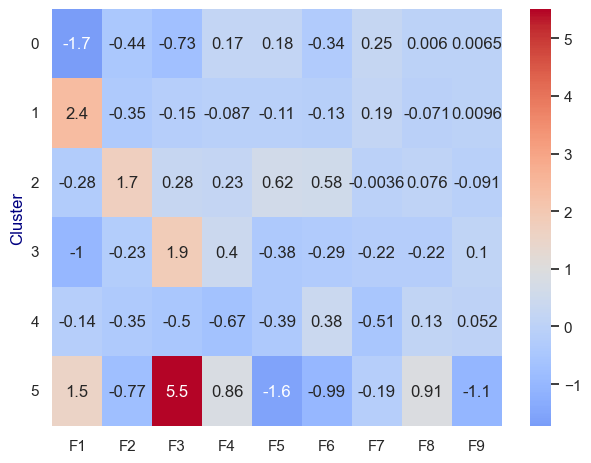

In [875]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  


**RADAR**

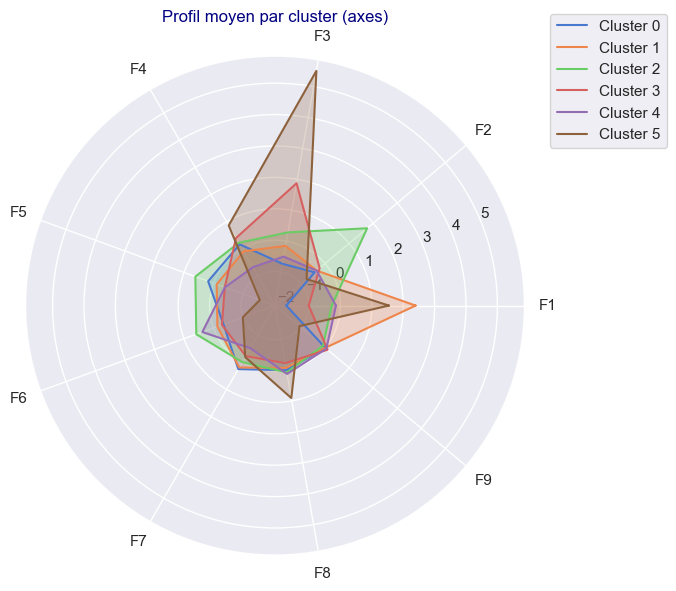

In [876]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

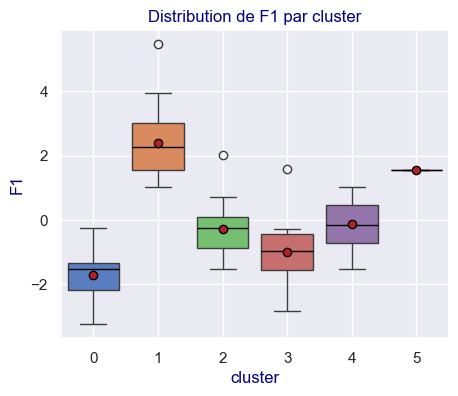

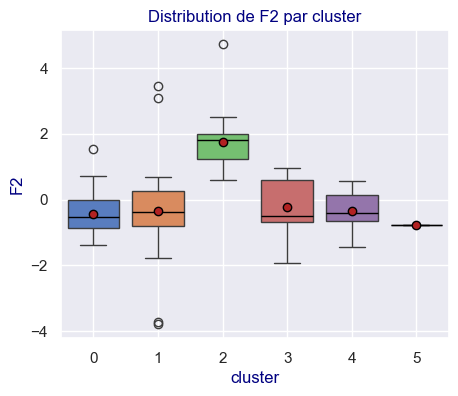

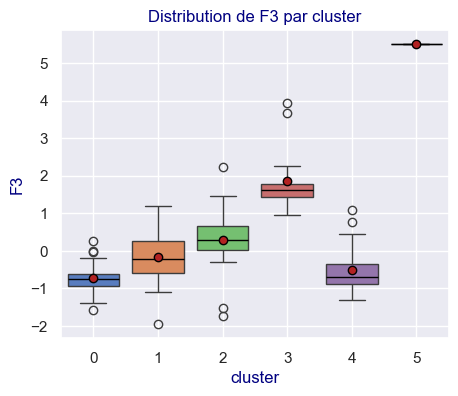

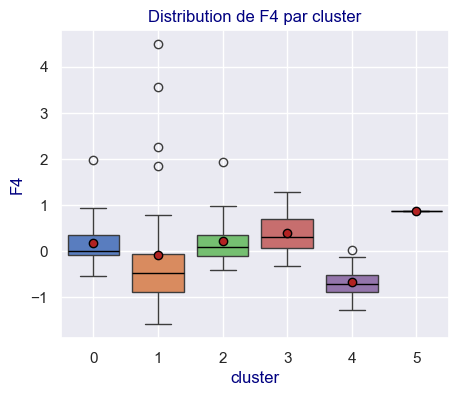

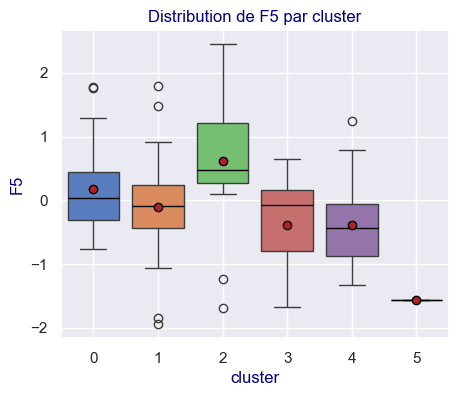

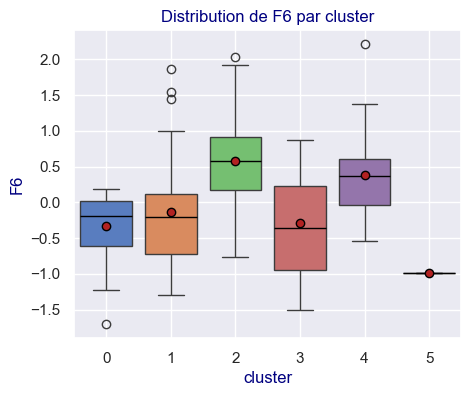

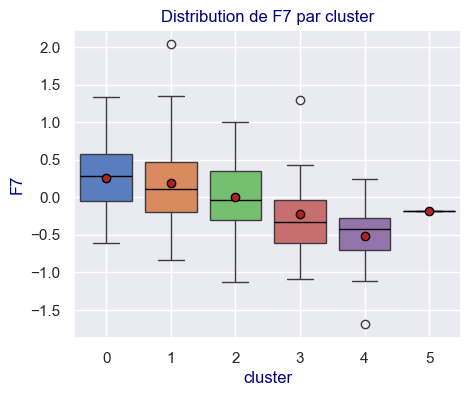

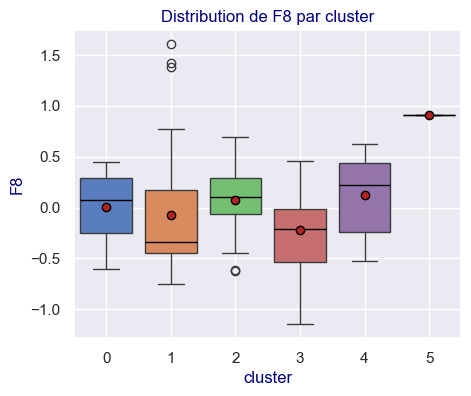

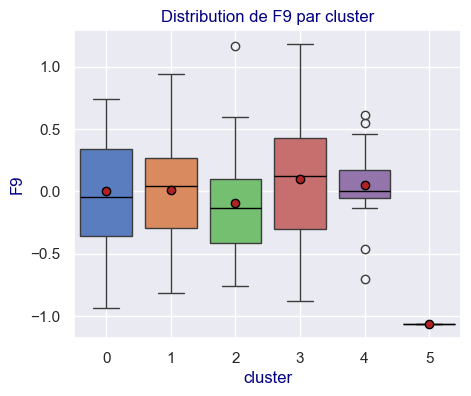

In [877]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [878]:
X_proj_temp = df_temp.copy()

In [879]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,0
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,4
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,0
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,2


In [880]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598
2,-0.276205,1.747765,0.282864,0.225993,0.615380,0.583733,-0.003603,0.076026,-0.090770
3,-1.008697,-0.227637,1.872887,0.400612,-0.381603,-0.286094,-0.224834,-0.222455,0.103299
4,-0.141324,-0.351502,-0.501265,-0.672324,-0.385370,0.379040,-0.514616,0.127065,0.051636
5,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480


In [881]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476,0
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598,1
2,-0.276205,1.747765,0.282864,0.225993,0.615380,0.583733,-0.003603,0.076026,-0.090770,2
3,-1.008697,-0.227637,1.872887,0.400612,-0.381603,-0.286094,-0.224834,-0.222455,0.103299,3
4,-0.141324,-0.351502,-0.501265,-0.672324,-0.385370,0.379040,-0.514616,0.127065,0.051636,4
5,1.544695,-0.769873,5.506464,0.864181,-1.568236,-0.993707,-0.187457,0.906575,-1.065480,5


Et on affiche pour F1 et F2

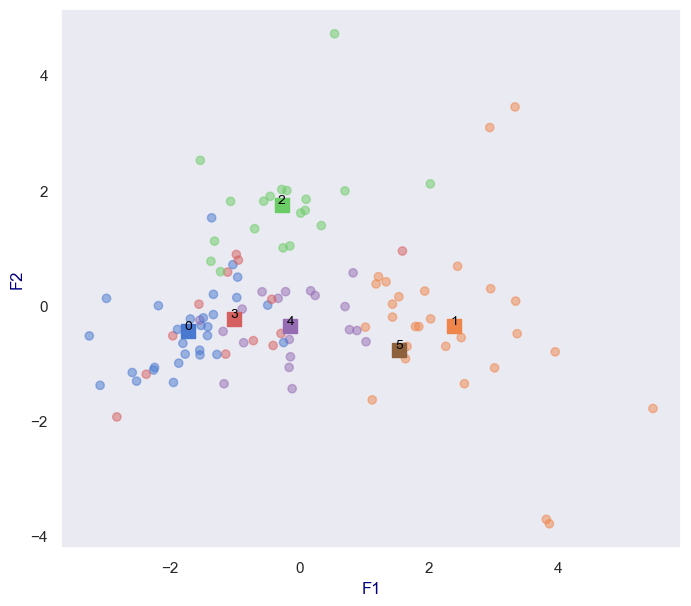

In [882]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


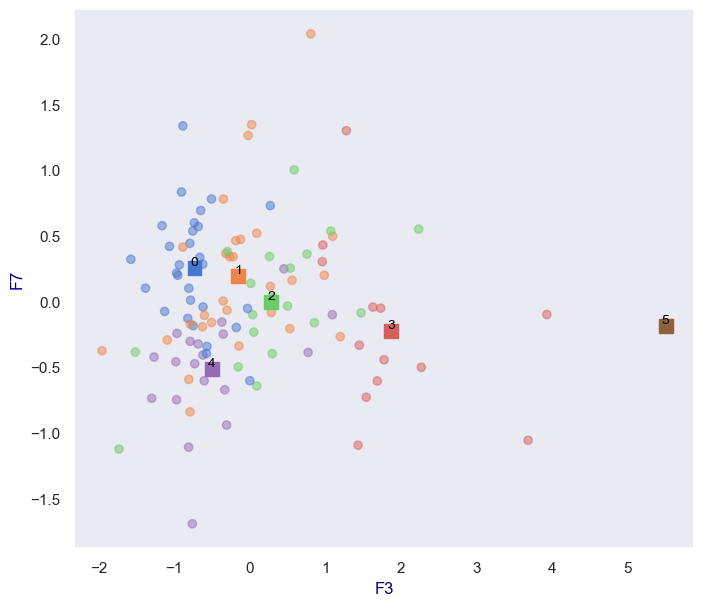

In [883]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 6], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 6], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 6] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[2])
ax.set_ylabel(X_proj_temp.columns[6])
plt.show()


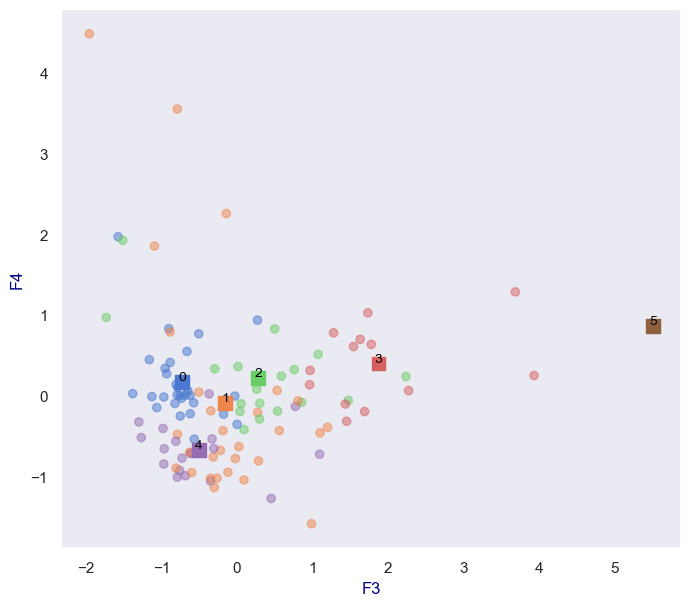

In [884]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

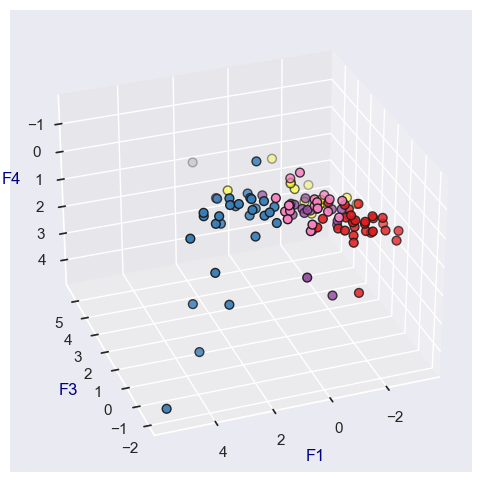

In [885]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

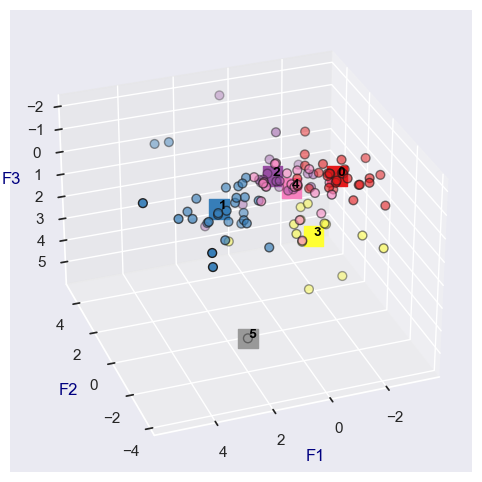

In [886]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [887]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-2.180047,-0.003078,-0.662289,0.551335,0.028689,-0.615018,0.335441,0.146231,-0.363639,0
ALB,0.242622,0.174124,-1.299509,-0.323342,-0.840044,0.186696,-0.737050,-0.236728,-0.043629,4
ARE,2.942311,3.091661,-1.093631,1.857214,-1.944903,-0.773999,-0.293018,-0.701225,0.914791,1
ARM,-1.330664,-0.157751,-1.161689,0.448735,-0.760268,0.014066,0.577114,-0.252586,0.302628,0
AUS,2.022319,2.112283,2.235469,0.239079,2.136884,-0.469813,0.550765,0.659139,1.169279,2


In [888]:
centroids_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.722360,-0.435793,-0.731836,0.170219,0.181796,-0.337166,0.252956,0.005958,0.006476,0
1,2.394823,-0.350408,-0.154522,-0.087180,-0.107352,-0.131102,0.193819,-0.070557,0.009598,1
2,-0.276205,1.747765,0.282864,0.225993,0.615380,0.583733,-0.003603,0.076026,-0.090770,2
3,-1.008697,-0.227637,1.872887,0.400612,-0.381603,-0.286094,-0.224834,-0.222455,0.103299,3
4,-0.141324,-0.351502,-0.501265,-0.672324,-0.385370,0.379040,-0.514616,0.127065,0.051636,4


In [889]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [890]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [891]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [892]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

In [893]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

117215

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape E -  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">E.1 -  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 4Rob -Clustering  sur données originales sans CHN et IND</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Rob.0- Préparation Data  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.1 - Data : </h4>
</div>

<font color='blue'>**DATA :**</font>  
Le jeu de données orginales :  
df_Etude_Marche_analyse_1_1

In [894]:
df_Etude_Marche_analyse_1_1.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.2 - Selection : </h4>
</div>

##### **SELECTION DE PAYS :**

Nosu avons déjà établi que la CHN et l'IND n'avaient pas des valeurs pertinentes  pour notre étude dans la partie 2-PCA.  
Et que ses valeurs pouvaient perturber la PCA et le clustering.

In [895]:
#CREATION d'un DF sans les outliers CHN et IND : (pour une nouvelle étude)
liste_iso3_temp = ['CHN','IND']
mask_temp = ~(df_Etude_Marche_analyse_1_1['iso3'].isin(liste_iso3_temp))

df_Etude_Marche_analyse_1_1_Rob_Pays_selec = df_Etude_Marche_analyse_1_1.loc[mask_temp,:]
df_Etude_Marche_analyse_1_1_Rob_Pays_selec.head()

,iso3,pays,continent,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
0,AGO,Angola,Africa,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,ALB,Albanie,Europe,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,ARE,UAE,Asia,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,ARM,Arménie,Asia,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,AUS,Australie,Pacific,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [896]:
df_Etude_Marche_analyse_1_1_Rob_Pays_selec.shape

(110, 12)

POINT SUR LES DONNEES :

In [897]:
Premieres_Analyses (df_Etude_Marche_analyse_1_1_Rob_Pays_selec )


---- SHAPE ----


(110, 12)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
Index: 110 entries, 0 to 111
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   iso3                     110 non-null    string 
 1   pays                     110 non-null    string 
 2   continent                110 non-null    string 
 3   Prox Geo Commerc. Fra    110 non-null    Float64
 4   Population               110 non-null    Int64  
 5   Bal Imp-Exp Poulet/pers  110 non-null    Float64
 6   PIB/hab                  110 non-null    Float64
 7   Part Volaille Alim       110 non-null    Float64
 8   Part Acces Alim Saine    110 non-null    Float64
 9   Imp Poulet Fr/pers       110 non-null    Float64
 10  Transport                110 non-null    Float64
 11  Stab Politique           110 non-null    Float64
dtypes: Float64(8), Int64(1), string(3)
memory usage: 12.1 KB

---- DESCRIBE ----


,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0,110.0
mean,-5150.644766,33965768.745455,3.735451,20187.846674,2.841348,72.428182,0.121102,2.945455,47.259802
std,3628.445949,57581642.758081,11.281307,26304.26403,1.92054,25.438309,0.399507,0.699493,25.607641
min,-16780.16,116913.0,-26.357484,429.395861,0.121814,6.4,0.0,1.8,0.473934
25%,-8079.743,3387239.5,0.04186,3491.884738,1.407101,53.2,0.0,2.4,24.881517
50%,-4536.2785,10327283.0,1.949559,8082.376833,2.442977,81.15,0.000626,2.75,49.526068
75%,-1743.15775,35461010.5,6.600689,25533.223319,4.025661,94.625,0.067048,3.6,69.905214
max,-378.6808,341534045.0,57.456143,125897.199853,7.655395,100.0,2.576017,4.4,95.260666



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
iso3,string[python],110,110,0,110,0.0
pays,string[python],110,110,0,110,0.0
continent,string[python],110,110,0,5,0.0
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN


In [898]:
df_Etude_Marche_analyse_1_1_Rob_Pays_selec.columns

Index(['iso3', 'pays', 'continent', 'Prox Geo Commerc. Fra', 'Population',
       'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim',
       'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport',
       'Stab Politique'],
      dtype='object')

In [899]:
df_Etude_Marche_analyse_1_1_Rob_Pays_selec.dtypes

iso3                       string[python]
pays                       string[python]
continent                  string[python]
Prox Geo Commerc. Fra             Float64
Population                          Int64
Bal Imp-Exp Poulet/pers           Float64
PIB/hab                           Float64
Part Volaille Alim                Float64
Part Acces Alim Saine             Float64
Imp Poulet Fr/pers                Float64
Transport                         Float64
Stab Politique                    Float64
dtype: object

##### **SELECTION DES COLONNES QUANTITATIVES :**

In [900]:
#Rappel :
# Liste des variables quantitatives
print(quant_vars) 

['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers', 'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine', 'Imp Poulet Fr/pers', 'Transport', 'Stab Politique']


In [901]:
df_Rob_quant = (df_Etude_Marche_analyse_1_1_Rob_Pays_selec.set_index(keys=['iso3'])[quant_vars] ).copy(deep=True)
df_Rob_quant.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
ALB,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
ARE,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
ARM,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
AUS,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


Notre dataframe a maintenant une dimension de : 

In [902]:
df_Rob_quant.shape

(110, 9)

In [903]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_Rob_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
Prox Geo Commerc. Fra,Float64,110,110,0,110,NaN
Population,Int64,110,110,0,110,NaN
Bal Imp-Exp Poulet/pers,Float64,110,110,0,110,NaN
PIB/hab,Float64,110,110,0,110,NaN
Part Volaille Alim,Float64,110,110,0,110,NaN
Part Acces Alim Saine,Float64,110,110,0,103,NaN
Imp Poulet Fr/pers,Float64,110,110,0,64,NaN
Transport,Float64,110,110,0,26,NaN
Stab Politique,Float64,110,110,0,110,NaN


##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.3 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_ter` la matrice des données : 

In [904]:
#X_ter récupère les valeurs de df_ter_quant dans un np.array
X_Rob = df_Rob_quant.values
#X_Rob[:5]
pd.DataFrame(X_Rob).head()

,0,1,2,3,4,5,6,7,8
0,-6363.6,35635029,8.646319,3183.699796,1.627105,27.8,0.00697,2.1,32.227489
1,-1461.321,2827608,15.251216,6655.258391,2.527139,87.8,0.173751,2.7,51.658768
2,-5171.043,10242086,50.911554,53707.980081,6.275218,97.7,0.595289,4.1,70.142181
3,-3391.306,2880874,12.983015,7018.113045,2.138236,45.1,0.134449,2.6,17.061611
4,-16464.9,26200984,-1.910985,67866.792484,5.347738,96.8,0.0,4.1,79.62085


In [905]:
X_Rob.shape

(110, 9)

Nous enregistrons les noms de nos pays-iso3 dans une variable `names_Rob` : 

In [906]:
names_Rob = df_Rob_quant.index
names_Rob

Index(['AGO', 'ALB', 'ARE', 'ARM', 'AUS', 'AUT', 'BEL', 'BEN', 'BFA', 'BGD',
       ...
       'TGO', 'THA', 'TJK', 'TTO', 'TUR', 'URY', 'USA', 'UZB', 'VNM', 'ZAF'],
      dtype='string', name='iso3', length=110)

In [907]:
names_Rob.shape

(110,)

et nos colonnes, nos features_base, dans une variable `features_Rob` : 

In [908]:
#DEJA FAIT DANS PCA_Bis_sans CHN_IND :
features_Rob = df_Rob_quant.columns
features_Rob

Index(['Prox Geo Commerc. Fra', 'Population', 'Bal Imp-Exp Poulet/pers',
       'PIB/hab', 'Part Volaille Alim', 'Part Acces Alim Saine',
       'Imp Poulet Fr/pers', 'Transport', 'Stab Politique'],
      dtype='object')

In [909]:
features_Rob.shape

(9,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.4 - Data Split : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données `X_Rob` :



In [910]:
from sklearn.preprocessing import RobustScaler

In [911]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_Rob = RobustScaler()
scaler_Rob

RobustScaler()

In [912]:
#préparation de la fonction pour s'adapter au format de nos données X_ter (Fitage) :
scaler_Rob.fit(X_Rob)

RobustScaler()

In [913]:
#Centrage -réduction de X_Rob dans le np.array X_Rob_scaled :
X_Rob_scaled = scaler_Rob.transform(X_Rob)
pd.DataFrame(X_Rob_scaled).head(5) #visualisation de X_Rob_scaled

,0,1,2,3,4,5,6,7,8
0,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
1,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
2,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
3,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
4,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


##### VISUALISATION de `X_Rob_scaled` :

In [914]:
type(X_Rob_scaled)

numpy.ndarray

In [915]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Rob_scaled).describe().round(2)

,0,1,2,3,4,5,6,7,8
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.10,0.74,0.27,0.55,0.15,-0.21,1.80,0.16,-0.05
std,0.57,1.80,1.72,1.19,0.73,0.61,5.96,0.58,0.57
min,-1.93,-0.32,-4.32,-0.35,-0.89,-1.80,-0.01,-0.79,-1.09
25%,-0.56,-0.22,-0.29,-0.21,-0.40,-0.67,-0.01,-0.29,-0.55
50%,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00
75%,0.44,0.78,0.71,0.79,0.60,0.33,0.99,0.71,0.45
max,0.66,10.33,8.46,5.35,1.99,0.46,38.41,1.38,1.02


In [916]:
#de manière plus explicite en récupérant le nom des colonnes : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Rob_scaled,columns=quant_vars).describe().round(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
count,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00,110.00
mean,-0.10,0.74,0.27,0.55,0.15,-0.21,1.80,0.16,-0.05
std,0.57,1.80,1.72,1.19,0.73,0.61,5.96,0.58,0.57
min,-1.93,-0.32,-4.32,-0.35,-0.89,-1.80,-0.01,-0.79,-1.09
25%,-0.56,-0.22,-0.29,-0.21,-0.40,-0.67,-0.01,-0.29,-0.55
50%,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00
75%,0.44,0.78,0.71,0.79,0.60,0.33,0.99,0.71,0.45
max,0.66,10.33,8.46,5.35,1.99,0.46,38.41,1.38,1.02


In [917]:
pd.DataFrame(X_Rob_scaled).mean().round(2)

0   -0.10
1    0.74
2    0.27
3    0.55
4    0.15
5   -0.21
6    1.80
7    0.16
8   -0.05
dtype: float64

In [918]:
pd.DataFrame(X_Rob_scaled).std(ddof=1).round(2)

0    0.57
1    1.80
2    1.72
3    1.19
4    0.73
5    0.61
6    5.96
7    0.58
8    0.57
dtype: float64

#Visualisation de X_Rob_scaled les données centrées réduites

In [919]:
#Visualisation de X_Rob_scaled les données centrées réduites
df_X_Rob_scaled = pd.DataFrame(X_Rob_scaled) #les données centrées réduites
df_X_Rob_scaled.columns = features_Rob
df_X_Rob_scaled.index = names_Rob
df_X_Rob_scaled.head() #les données centrées réduites

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.5 - Pas de PCA : </h4>
</div>

La PCA est utileis poure réduire la quantité d'information.  
Nous n'avons pas beaucoup de données. 
C'est pour ça que nous allons pouvoir tenter de faire un clustering sur les données originales centrées réduites.
Nous pourrons tester plusiseurs manières de centre réduire.  
Nous n'avons pas la contrainte de la PCA qui requiert un centrage sur la moyenne et une réduction sur la Variance à 1.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.0.5 - Pas de PCA : </h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Rob.1- classification hiérarchique ACH </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.1 - Préliminaires : </h4>
</div>

##### IMPORTS

##### DATA

Ici il n'y aura pas de projection, on considère que l'on est déjà pro

In [920]:
df_X_Rob_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


In [921]:
df_X_Rob_scaled_ACH=df_X_Rob_scaled.copy(deep=True)
df_X_Rob_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


In [922]:
df_X_Rob_scaled_ACH.shape

(110, 9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.2 - Dendrogramme -ACH : </h4>
</div>

Effectuons une classification hiérarchique ascendante.

##### **CALCUL DES DISTANCES :**

Nous allons calculer les distances en spécifiant la méthode à utiliser: méthode de Ward adaptée à l'ACH.

In [923]:
Z = linkage(df_X_Rob_scaled_ACH, method="ward")
pd.DataFrame(Z)

,0,1,2,3
0,21.0,74.0,0.345428,2.0
1,8.0,110.0,0.381347,3.0
2,5.0,99.0,0.449416,2.0
3,0.0,40.0,0.642528,2.0
4,35.0,69.0,0.696091,2.0
...,...,...,...,...
104,203.0,210.0,12.872358,80.0
105,200.0,214.0,15.549064,82.0
106,213.0,215.0,22.127479,99.0
107,212.0,216.0,26.787243,107.0


In [924]:
Z.shape

(109, 4)

In [925]:
type(Z)

numpy.ndarray

##### **2. Dendrogramme**

Nous pouvons désormais afficher le dendrogramme: 

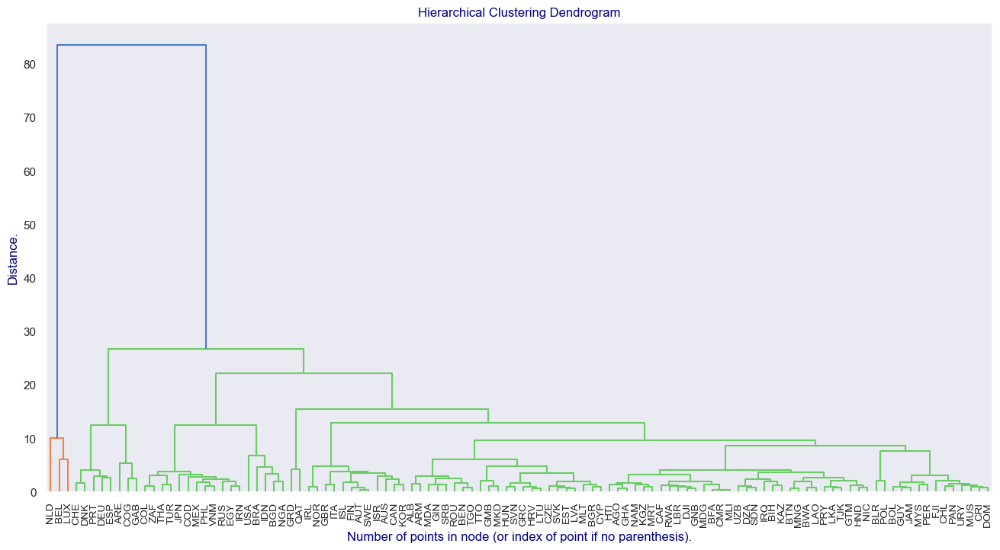

In [926]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_Rob_scaled_ACH.index)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
plt.show()

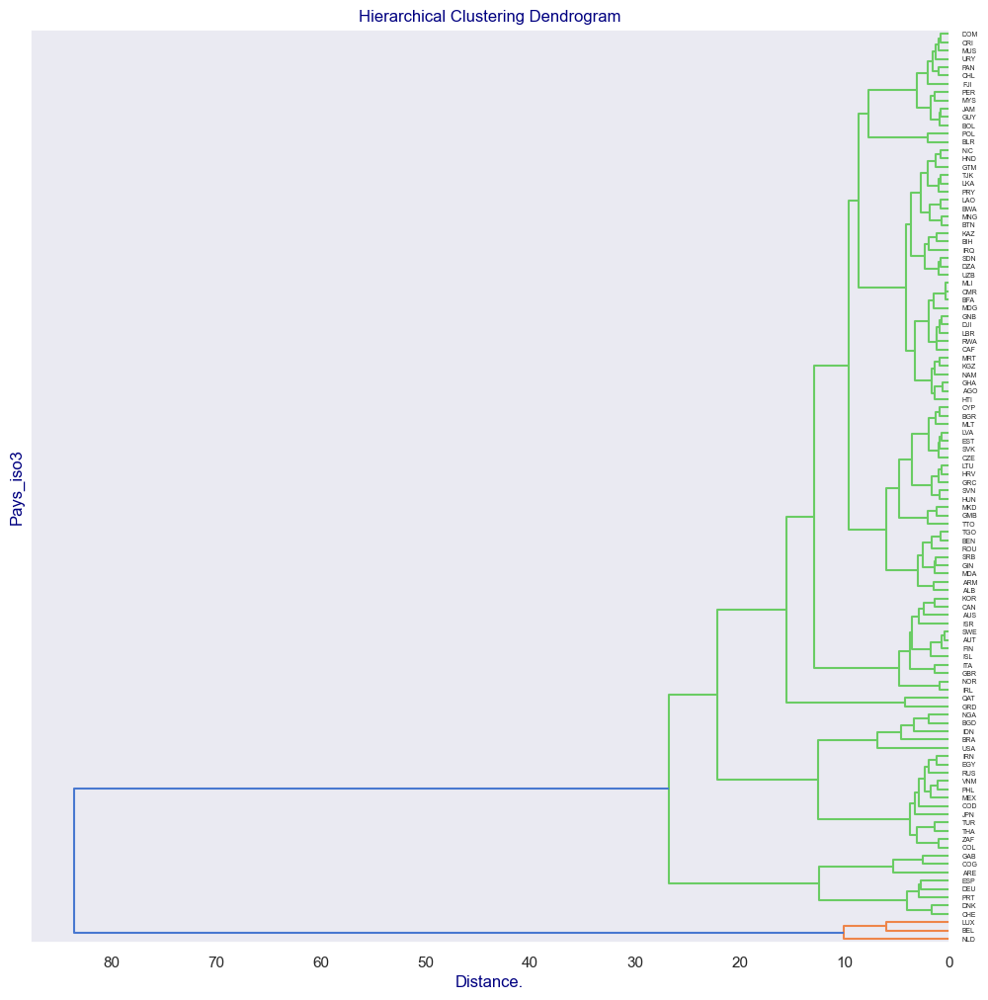

In [927]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

_ = dendrogram(Z, ax=ax,labels=df_X_Rob_scaled_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
plt.show()

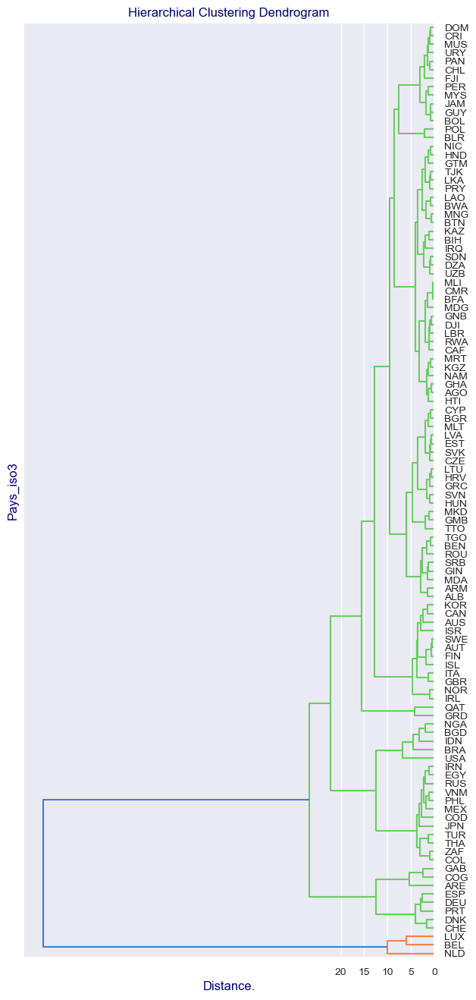

In [928]:
fig, ax = plt.subplots(1, 1, figsize=(7, 16))

_ = dendrogram(Z, ax=ax,labels=df_X_Rob_scaled_ACH.index, orientation = "left")

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

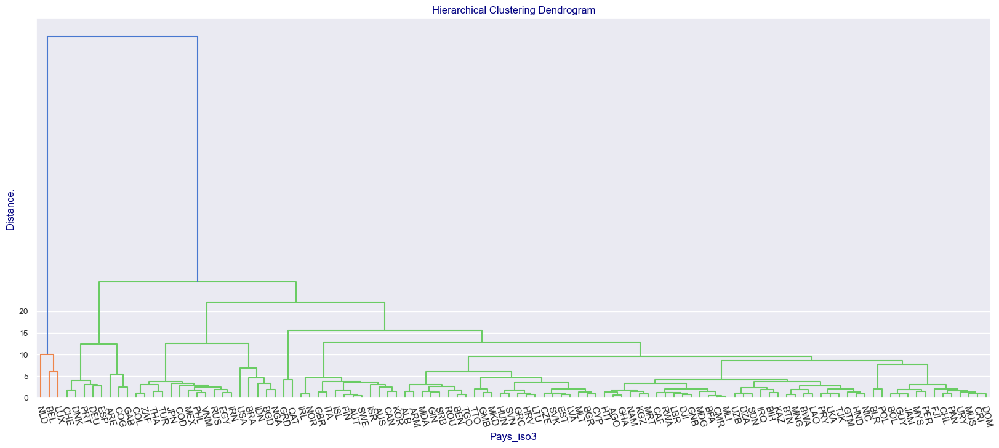

In [929]:
fig, ax = plt.subplots(1, 1, figsize=(20, 8))

_ = dendrogram(Z, ax=ax,labels=df_X_Rob_scaled_ACH.index, orientation = "top")

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Pays_iso3")
plt.ylabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=11,labelrotation =-75)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

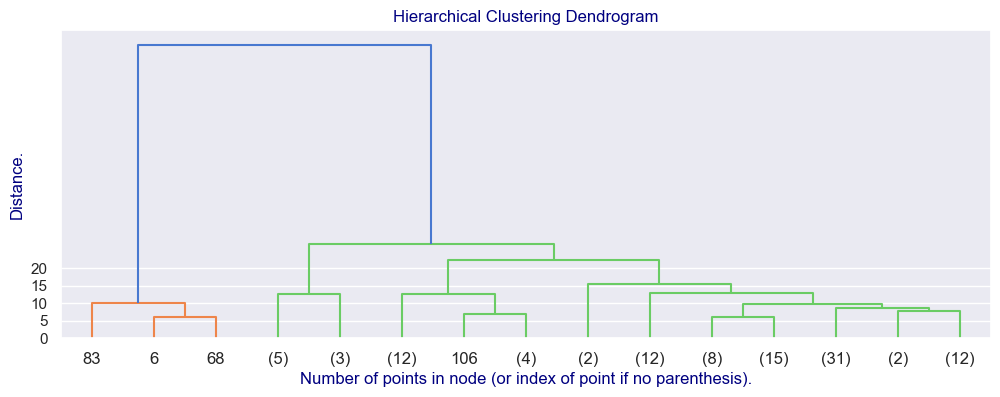

In [930]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=15, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=15 nombre au dessus duquel les distances intraclasse sont inférieur à 5

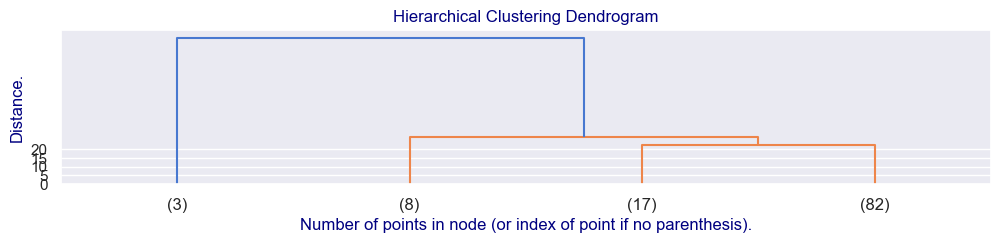

In [931]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 2))

_ = dendrogram(Z, p=4, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=4 nombre de clusters minimum pour voir apparaitre le groupe de 3 : BEL, NLD(Pays-Bas), LUX (Niveau de vie elevé/Commerce avec Fr)  
Emergence rapide de ce groupe témoignant de sa distinction des autes pays.

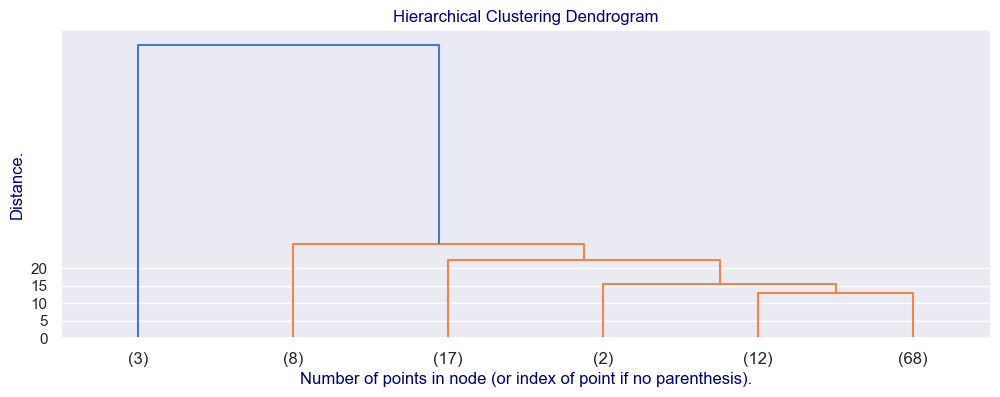

In [932]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=6, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de 3 : QAT, ARE, GRD(Grenade)  

**OBSERVATIONS :**  
p=6 nombre de clusters minimum pour voir apparaitre le groupe de  : IDN(Indonésie), BRA, USA (poids de la population) +NGA et BGD

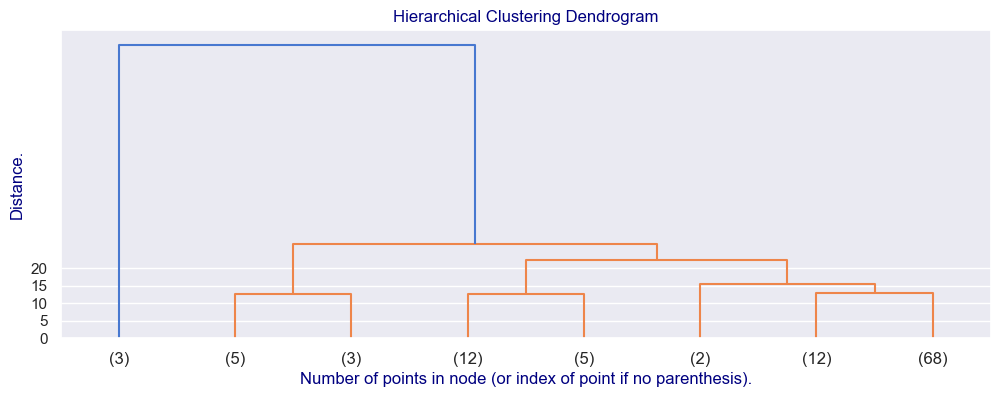

In [933]:
# les arguments p=8, truncate_mode="lastp" signifient que l'on ne va afficher que 8 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=8, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**AUTRE METHODE DE VISUALISATION (par le Nombre de noeuds) :**  
Ici j'ai des clusters qui ne sont issus que d'un noeud et d'autres de 2 noeuds.  
Je peux voir ce que ça peut donner si je prends ceux issu de 2 noeuds

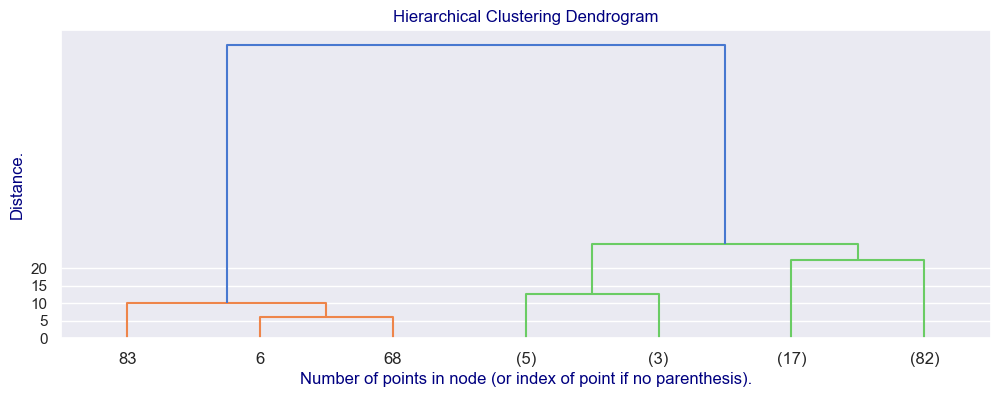

In [934]:
#  les arguments p=2, truncate_mode="level"signifient que l'on ne va afficher que les clusters issus de 2 noeuds.

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=2, truncate_mode="level", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

**CHOIX DE NBRE DE CLUSTERS**  
A la lecture des Dendrogrammes, un nombre de clusters entre 6 et 8 semble pertinent.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.3 - Evaluation du nbre de cluster pertinent : Méthode de la silhouette : </h4>
</div>

Méthode du coude
Pertinent avec ACH ? ➤ ❌NON Pas directement.

Pourquoi ?

Le coude est basé sur l’inertie intra-cluster (minimisée dans K-means).

L’ACH ne repose pas sur l’inertie mais sur une distance de fusion (liaison simple, complète, moyenne…).

Le "coude" peut parfois être utilisé sur un graphe des distances de fusion (dans le dendrogramme), mais ce n’est pas la méthode standard.

Nombre de clusters : 2 — Score silhouette moyen : 0.87


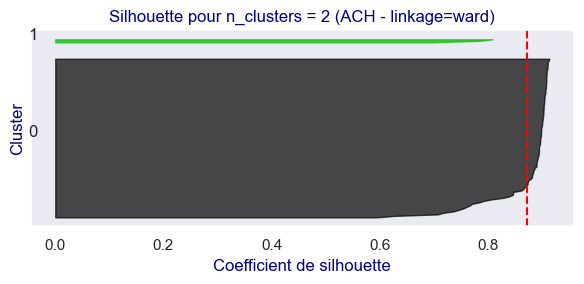

Nombre de clusters : 3 — Score silhouette moyen : 0.54


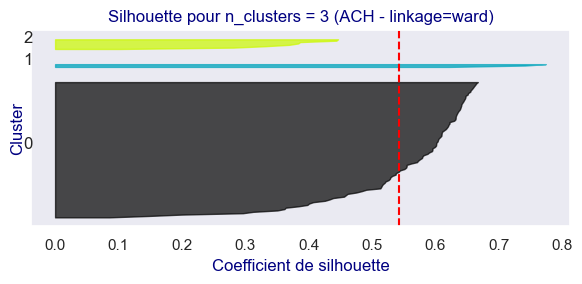

Nombre de clusters : 4 — Score silhouette moyen : 0.38


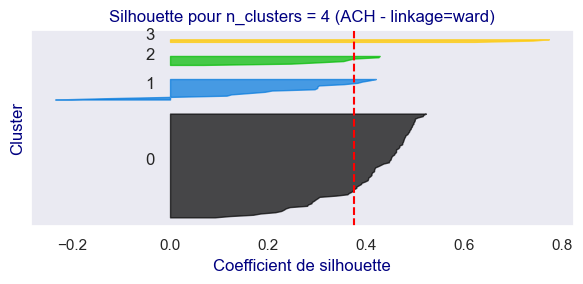

Nombre de clusters : 5 — Score silhouette moyen : 0.40


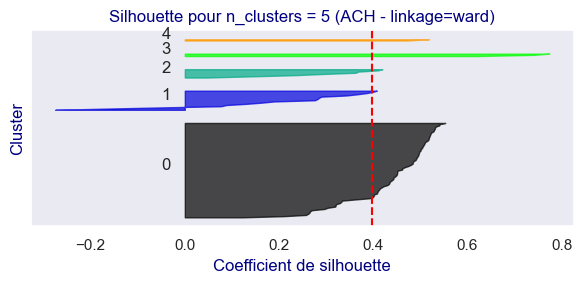

Nombre de clusters : 6 — Score silhouette moyen : 0.30


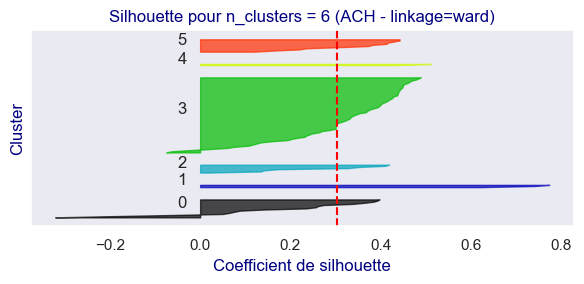

Nombre de clusters : 7 — Score silhouette moyen : 0.29


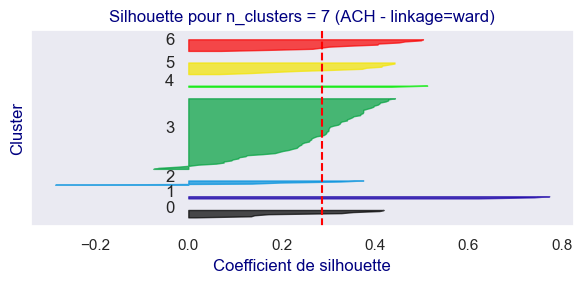

Nombre de clusters : 8 — Score silhouette moyen : 0.30


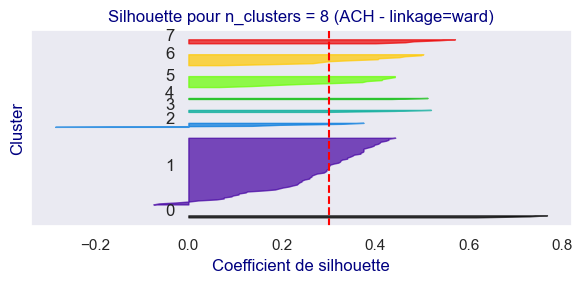

Nombre de clusters : 9 — Score silhouette moyen : 0.29


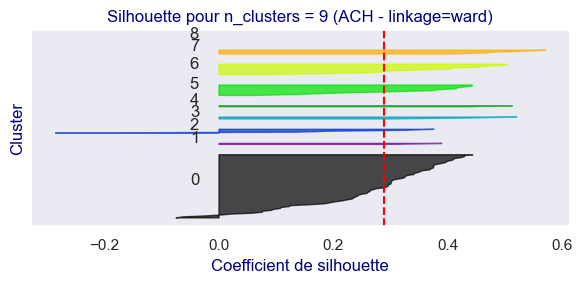

Nombre de clusters : 10 — Score silhouette moyen : 0.24


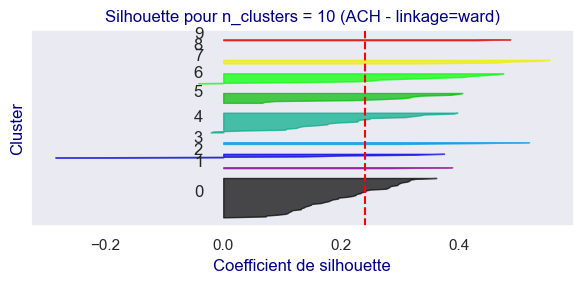

Nombre de clusters : 11 — Score silhouette moyen : 0.26


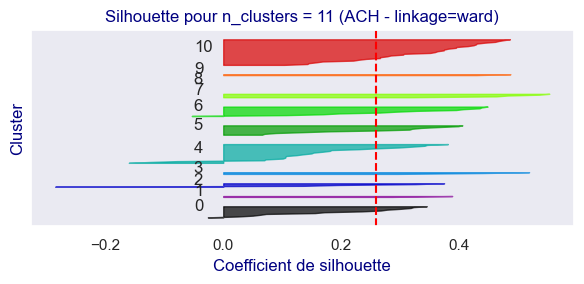

In [935]:
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import AgglomerativeClustering
#import matplotlib.pyplot as plt
#import numpy as np

X_temp = df_X_Rob_scaled.copy()
range_nb_clust = range(2, 12)  # Par exemple de 2 à 14 clusters

for nb_clust in range_nb_clust:
    fig, ax = plt.subplots(figsize=(6, 3))

    # ✅ Utilisation de l'ACH (et non KMeans)
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    cluster_labels = cah.fit_predict(X_temp)

    # Score de silhouette moyen
    silhouette_avg = silhouette_score(X_temp, cluster_labels)
    print(f"Nombre de clusters : {nb_clust} — Score silhouette moyen : {silhouette_avg:.2f}")

    # Score silhouette par point
    sample_silhouette_values = silhouette_samples(X_temp, cluster_labels)

    y_lower = 10
    for i in range(nb_clust):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / nb_clust)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax.set_title(f"Silhouette pour n_clusters = {nb_clust} (ACH - linkage=ward)")
    ax.set_xlabel("Coefficient de silhouette")
    ax.set_ylabel("Cluster")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax.set_yticks([])
    plt.tight_layout()
    plt.show()


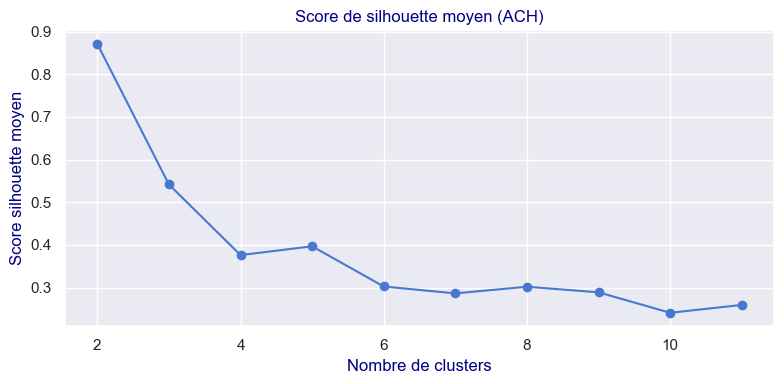

In [936]:
#graph de silhouette scores selon nombre de cluster

silhouette_scores = []

for nb_clust in range_nb_clust:
    cah = AgglomerativeClustering(n_clusters=nb_clust, linkage="ward")
    labels = cah.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (ACH)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


<u>**CHOIX DU NOMBRE DE CLUSTER :** </u>  
Score de silhouette : 
Ici c'est clairement 2 ou 3 ou 5 si on veut avroi un peu plus de variétés)


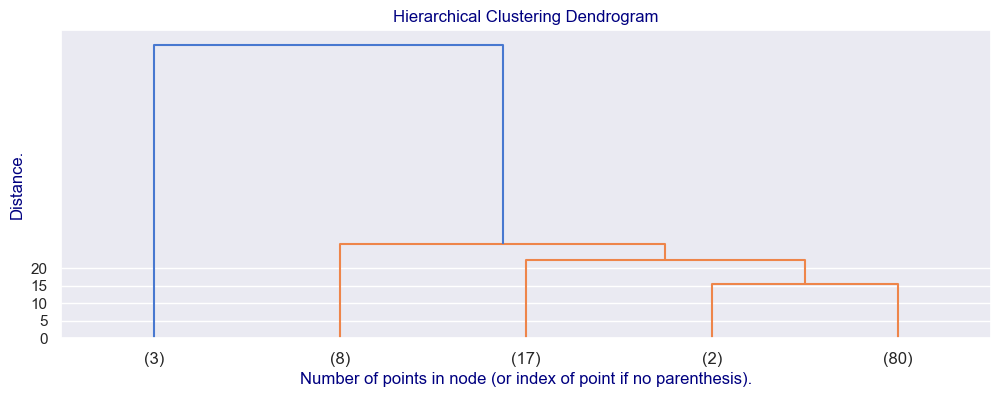

In [937]:
# les arguments p=6, truncate_mode="lastp" signifient que l'on ne va afficher que 6 clusters

fig, ax = plt.subplots(1, 1, figsize=(12, 4))

_ = dendrogram(Z, p=5, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.yticks(range(0,22,5))
plt.grid(axis='y')
plt.show()

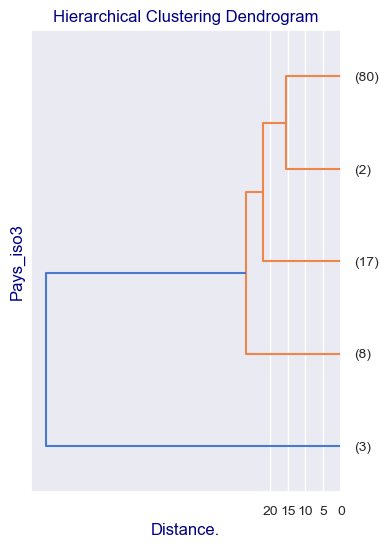

In [938]:
fig, ax = plt.subplots(1, 1, figsize=(4,6))

_ = dendrogram(Z, ax=ax,labels=df_X_Rob_scaled_ACH.index, orientation = "left", p=5, truncate_mode="lastp" )

plt.title("Hierarchical Clustering Dendrogram")
plt.ylabel("Pays_iso3")
plt.xlabel("Distance.")
ax.tick_params(axis='x', which='major', labelsize=10)
ax.tick_params(axis='y', which='major', labelsize=10)
plt.xticks(range(0,22,5))
plt.grid(axis='x')
plt.show()

##### **CLUSTERS CAH**

Pour définir les clusters, on peut utiliser `scipy` ou `scikit-learn`.

<u>Scikit-Learn</u>

On instancie un estimateur : 

In [939]:
n_clusters =5

In [940]:
cah = AgglomerativeClustering(n_clusters=n_clusters, linkage="ward")

On entraine l'estimateur : 

In [941]:
df_X_Rob_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


In [942]:
cah.fit(df_X_Rob_scaled_ACH)

AgglomerativeClustering(n_clusters=5)

Regardons nos clusters : 

In [943]:
cah.labels_

array([0, 0, 2, 0, 0, 0, 3, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0,
       1, 2, 1, 0, 0, 0, 2, 0, 2, 0, 0, 1, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0,
       0, 4, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 3, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 1,
       0, 2, 0, 4, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1],
      dtype=int64)

Ajoutons nos labels à `df_X_Rob_scaled_ACH`

In [944]:
df_X_Rob_scaled_ACH["labels"] = cah.labels_
df_X_Rob_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,0
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,0
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,0
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,0


Observons nos clusters: 

In [945]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Rob_scaled_ACH["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

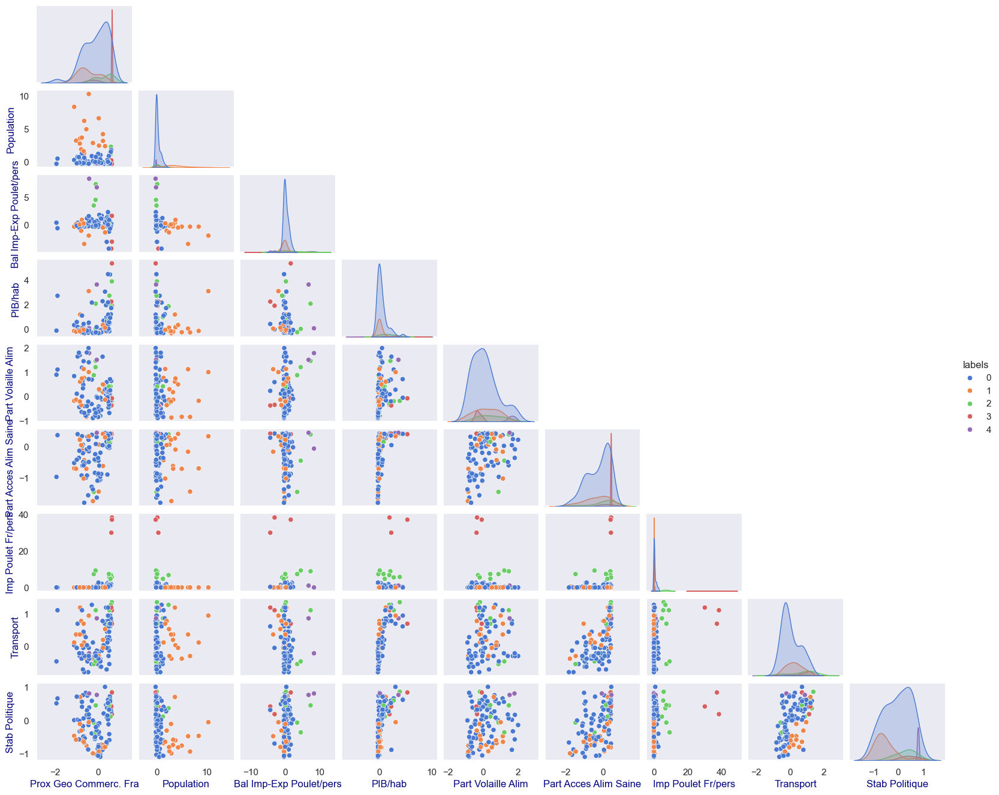

In [946]:
sns.pairplot(df_X_Rob_scaled_ACH, 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait 3 pouces de haut
             aspect=1.2
            )

In [947]:
#le Dataframe des cluster calculé par la moyenne
df_X_Rob_scaled_ACH_grouped = (df_X_Rob_scaled_ACH.groupby(by=['labels'])).mean()
df_X_Rob_scaled_ACH_grouped.index.name = 'cluster'
display(df_X_Rob_scaled_ACH_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.088482,0.112092,0.167822,0.402900,0.096410,-0.238684,0.437299,0.053125,-0.025132
1,-0.444695,4.104377,-0.466531,0.175128,0.164883,-0.347829,0.019971,0.262255,-0.533437
2,0.311498,0.362899,1.846642,1.503980,0.464110,0.021424,6.959746,0.687500,0.310526
3,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
4,-0.229068,-0.275072,7.675034,1.844685,1.646031,0.200362,0.492120,0.333333,0.794737


In [948]:
df_temp =df_X_Rob_scaled_ACH.copy()
df_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,0
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,0
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,0
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,0


In [949]:
df_temp_grouped = df_X_Rob_scaled_ACH_grouped.copy()
df_temp_grouped.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.088482,0.112092,0.167822,0.402900,0.096410,-0.238684,0.437299,0.053125,-0.025132
1,-0.444695,4.104377,-0.466531,0.175128,0.164883,-0.347829,0.019971,0.262255,-0.533437
2,0.311498,0.362899,1.846642,1.503980,0.464110,0.021424,6.959746,0.687500,0.310526
3,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
4,-0.229068,-0.275072,7.675034,1.844685,1.646031,0.200362,0.492120,0.333333,0.794737


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.5 - Interprétations  des données (centrées réduites) : </h4>
</div>

In [950]:
df_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,0
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,0


In [951]:
df_temp_grouped.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.088482,0.112092,0.167822,0.402900,0.096410,-0.238684,0.437299,0.053125,-0.025132
1,-0.444695,4.104377,-0.466531,0.175128,0.164883,-0.347829,0.019971,0.262255,-0.533437


In [952]:
#CA fait doublon
# df pour la visualisation
#df = df_temp
#df_means = df_temp_grouped #le df à utiliser pour les visualisations

**Liste des pays**

In [953]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ALB  / ARM  / AUS  / AUT  / BEN  / BFA  / BGR  / BIH  / BLR  / BOL  / BTN  / BWA  / CAF  / CAN  / CHL  / CMR  / CRI  / CYP  / CZE  / DJI  / DOM  / DZA  / EST  / FIN  / FJI  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IRL  / IRQ  / ISL  / ISR  / ITA  / JAM  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NIC  / NOR  / PAN  / PER  / POL  / PRY  / ROU  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / TJK  / TTO  / URY  / UZB 



cluster 1 :
BGD  / BRA  / COD  / COL  / EGY  / IDN  / IRN  / JPN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / USA  / VNM  / ZAF 



cluster 2 :
ARE  / CHE  / COG  / DEU  / DNK  / ESP  / GAB  / PRT 



cluster 3 :
BEL  / LUX  / NLD 



cluster 4 :
GRD  / QAT 





**HEATMAP**

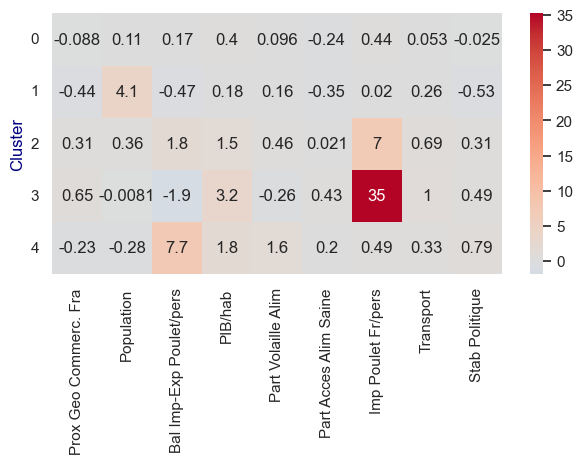

In [954]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            center =0,
            cmap='coolwarm'#pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  

Cluster 2 intéressant :  
Import de poulet Fr élevé et bon niveau de vie
Cluster 5 intéressant :  
BonNiveau de vie  et Bonne consommation de Poulet international et un peu français

**RADAR**

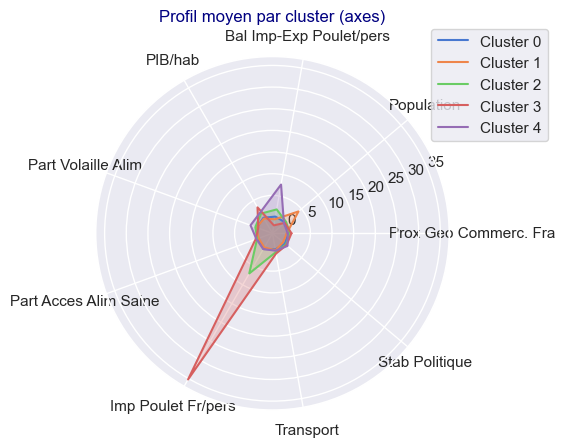

In [955]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


On a bien les Clusters 2 et 5 qui ressortent .

cluster 2 : 
BEL  / LUX  / NLD

cluster 5 : 
ARE  / GRD  / QAT  

##### Boxplot

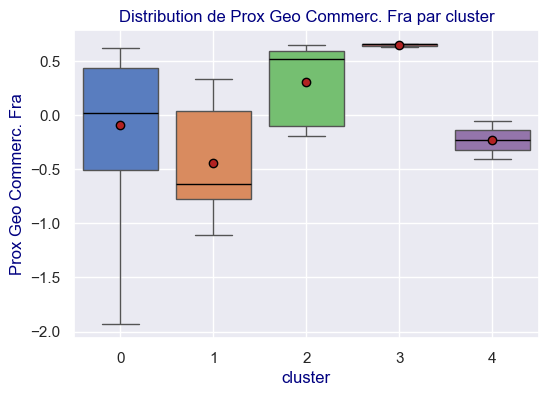

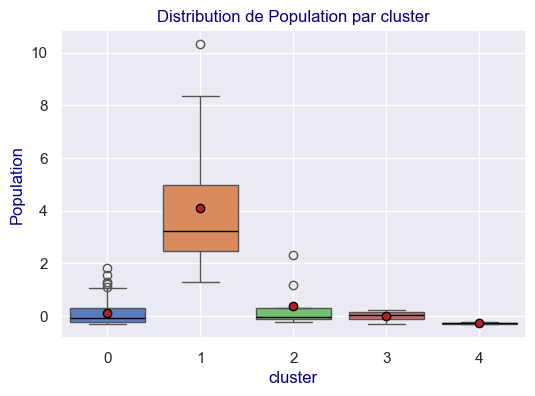

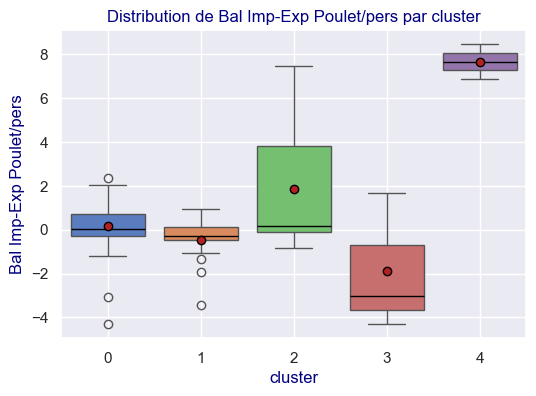

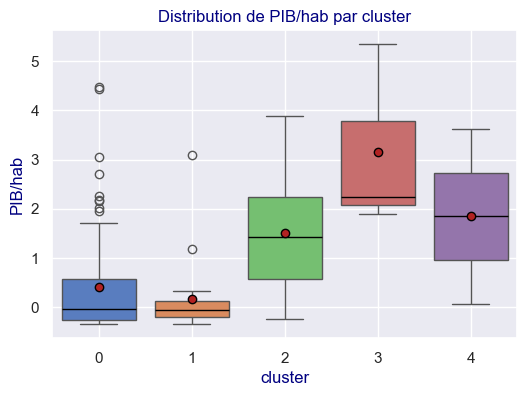

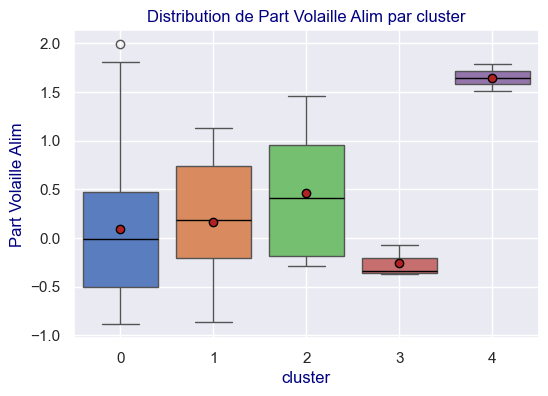

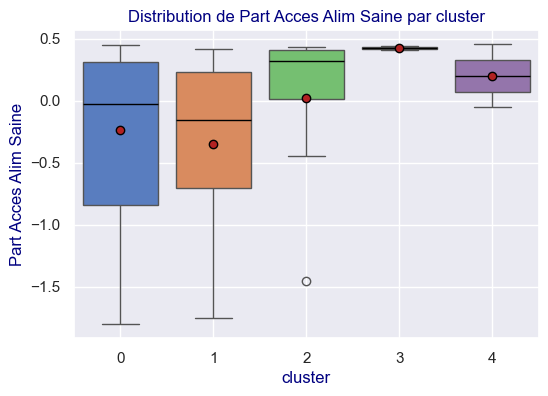

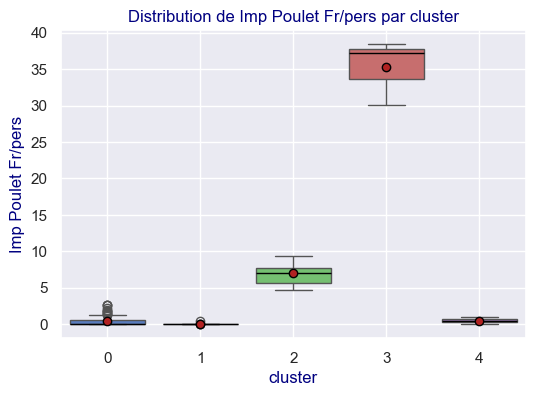

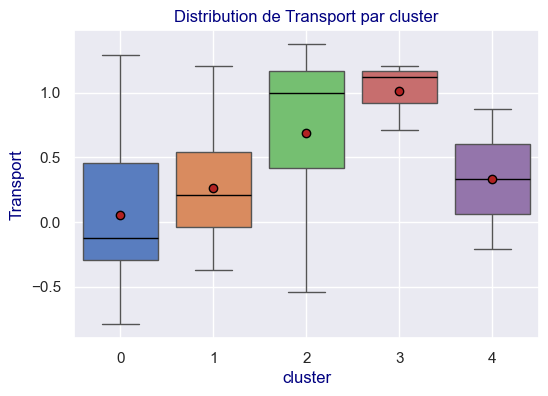

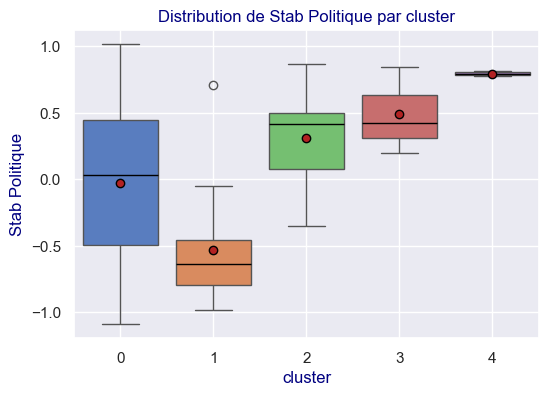

In [956]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.5 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

In [957]:
X_proj_temp = df_temp.copy()

In [958]:
X_proj_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,0
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,0
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,0
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,0


In [959]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.088482,0.112092,0.167822,0.402900,0.096410,-0.238684,0.437299,0.053125,-0.025132
1,-0.444695,4.104377,-0.466531,0.175128,0.164883,-0.347829,0.019971,0.262255,-0.533437
2,0.311498,0.362899,1.846642,1.503980,0.464110,0.021424,6.959746,0.687500,0.310526
3,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
4,-0.229068,-0.275072,7.675034,1.844685,1.646031,0.200362,0.492120,0.333333,0.794737


In [960]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
cluster,,,,,,,,,,
0,-0.088482,0.112092,0.167822,0.402900,0.096410,-0.238684,0.437299,0.053125,-0.025132,0
1,-0.444695,4.104377,-0.466531,0.175128,0.164883,-0.347829,0.019971,0.262255,-0.533437,1
2,0.311498,0.362899,1.846642,1.503980,0.464110,0.021424,6.959746,0.687500,0.310526,2
3,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474,3
4,-0.229068,-0.275072,7.675034,1.844685,1.646031,0.200362,0.492120,0.333333,0.794737,4


Les axes intéressants sont  poulet International(2)  Poulet FR(6) et PIB(3) (éventuellement la population en (1)

2 # Bal Imp-Exp Poulet/pers  
3 # PIB/hab	  
6 # Imp Poulet Fr/pers

Et on affiche le graphique pour poulet International(2)  Poulet FR(6) :

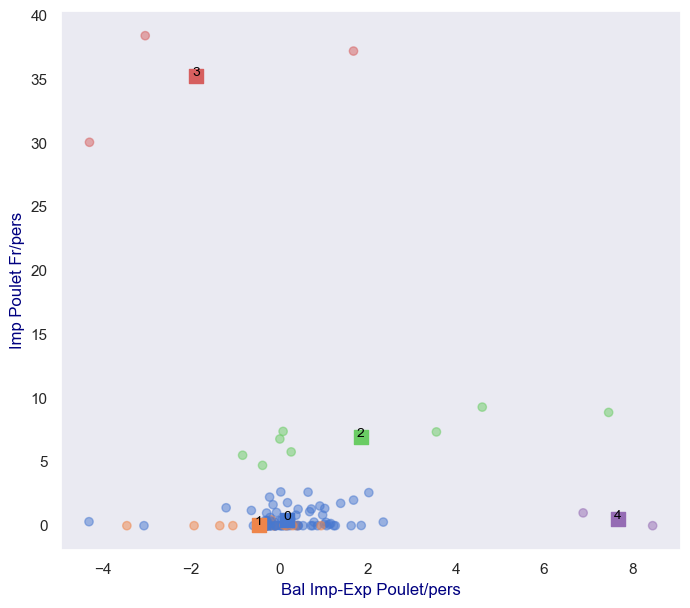

In [961]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
#3 # PIB/hab	

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


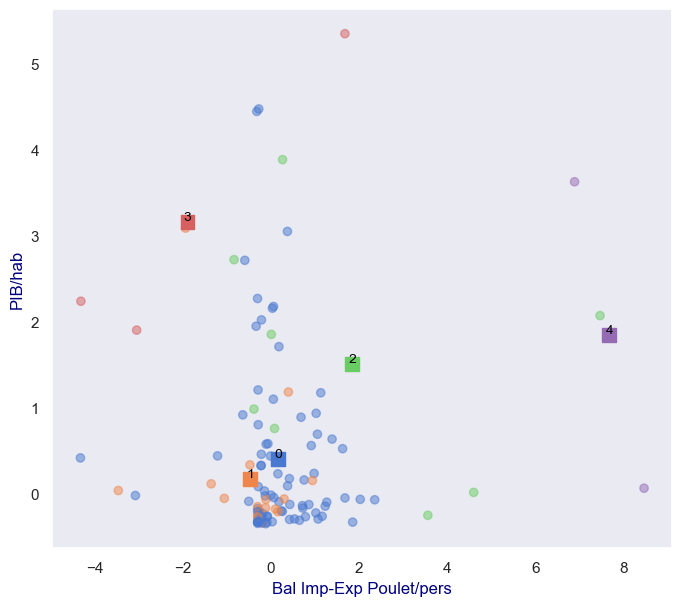

In [962]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 3 # PIB/hab
#6 # Imp Poulet Fr/pers

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :

In [963]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [964]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.1.6 - Visualisation des données projetées (NE PAS PRENDRE EN COMPTE => INEXACTE car données cetrées sur la médiane au lieu de la moyenne donc pas de PCA) : </h4>
</div>

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.  

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

**Projetons X_Rob_scaled / df_X_Rob_scaled_AXH**

A l'identique du reste je pourrai projeter sur seulement 4 composantes :
#nb_components_Rob = 4

In [965]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_Rob = 9

#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_Rob = PCA(n_components= nb_components_Rob )

#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_Rob .fit(X_Rob_scaled)

#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_Rob_proj = pca_Rob.transform(X_Rob_scaled)

In [966]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_Rob_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_Rob
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321


In [967]:
df_X_Rob_scaled_ACH.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,0
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,0
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,0
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,0


In [968]:
#Mappons df_X_tete_scaled avec nos labels
df_X_Rob_proj_ACH = df_temp.join(df_X_Rob_scaled_ACH["labels"])
df_X_Rob_proj_ACH.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,0
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,0
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,0
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,0


In [969]:
X_proj_temp = df_X_Rob_proj_ACH.copy()
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,0
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,0
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,0
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,0


**Récupérons les centroïdes**

Etant donné la linéarité de la transformation, 
les barycentres sont conservés et donc je peux soit projetés les centroids soit récupérer les barycentres de df_X_Rob_proj_ACH

In [970]:
df_X_Rob_proj_ACH_grouped = (df_X_Rob_proj_ACH.groupby(by=['labels'])).mean()
df_X_Rob_proj_ACH_grouped.index.name = 'cluster'
display(df_X_Rob_proj_ACH_grouped)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073
2,5.232017,-1.304359,1.233971,0.449322,-0.138736,-0.159506,0.002188,0.253402,-0.010720
3,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
4,-1.294535,-5.837432,5.109769,0.682037,0.125815,-0.092621,-0.081598,-0.059913,-0.075807


In [971]:
centroids_proj_temp =df_X_Rob_proj_ACH_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073
2,5.232017,-1.304359,1.233971,0.449322,-0.138736,-0.159506,0.002188,0.253402,-0.010720
3,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
4,-1.294535,-5.837432,5.109769,0.682037,0.125815,-0.092621,-0.081598,-0.059913,-0.075807


Travaillons sur des copies :

In [972]:
df_temp = df_X_Rob_proj_ACH.copy()
df_temp_grouped = df_X_Rob_proj_ACH_grouped.copy()

In [973]:
df_temp.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,0
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,0


In [974]:
df_temp_grouped.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073


**Liste des pays**

In [975]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
AGO  / ALB  / ARM  / AUS  / AUT  / BEN  / BFA  / BGR  / BIH  / BLR  / BOL  / BTN  / BWA  / CAF  / CAN  / CHL  / CMR  / CRI  / CYP  / CZE  / DJI  / DOM  / DZA  / EST  / FIN  / FJI  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IRL  / IRQ  / ISL  / ISR  / ITA  / JAM  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NIC  / NOR  / PAN  / PER  / POL  / PRY  / ROU  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / TJK  / TTO  / URY  / UZB 



cluster 1 :
BGD  / BRA  / COD  / COL  / EGY  / IDN  / IRN  / JPN  / MEX  / NGA  / PHL  / RUS  / THA  / TUR  / USA  / VNM  / ZAF 



cluster 2 :
ARE  / CHE  / COG  / DEU  / DNK  / ESP  / GAB  / PRT 



cluster 3 :
BEL  / LUX  / NLD 



cluster 4 :
GRD  / QAT 





**HEATMAP**

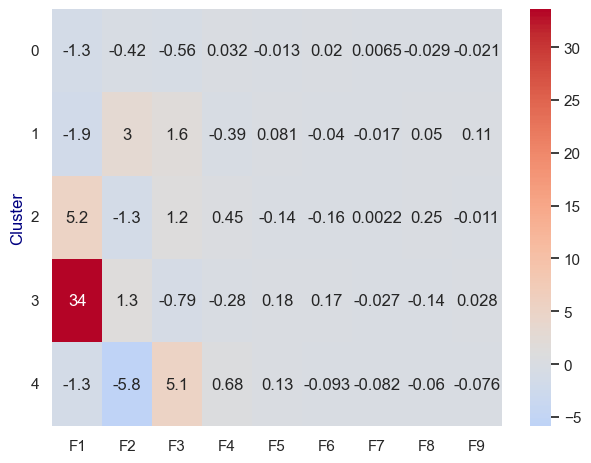

In [976]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  


**RADAR**

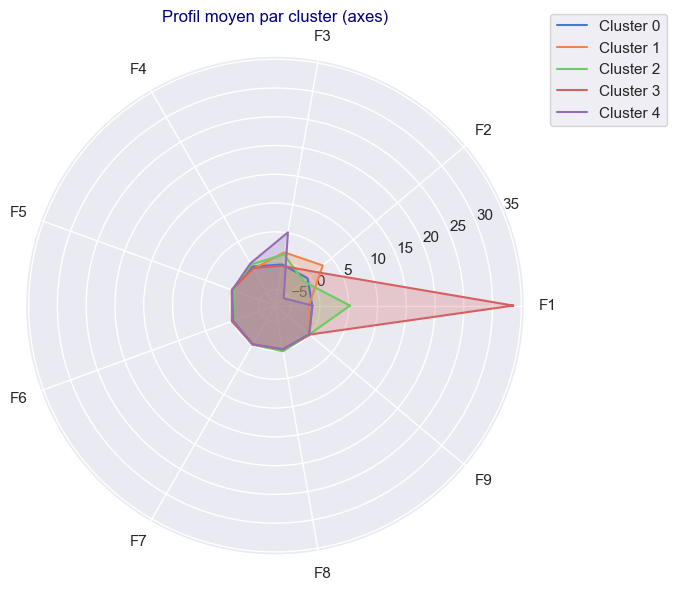

In [977]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

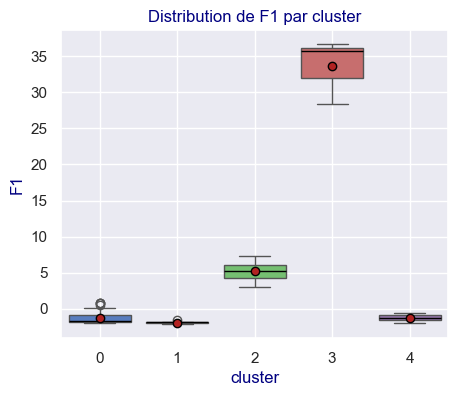

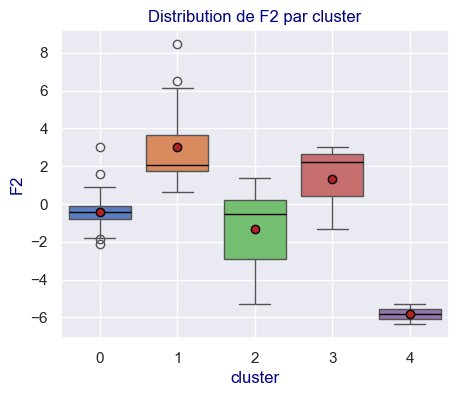

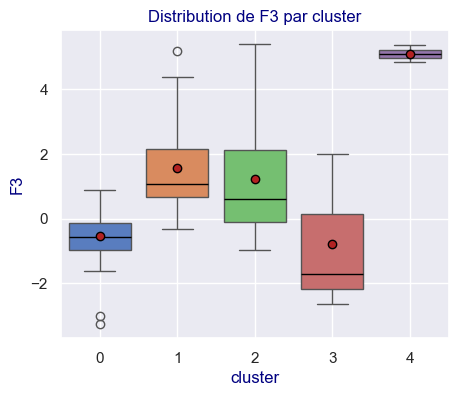

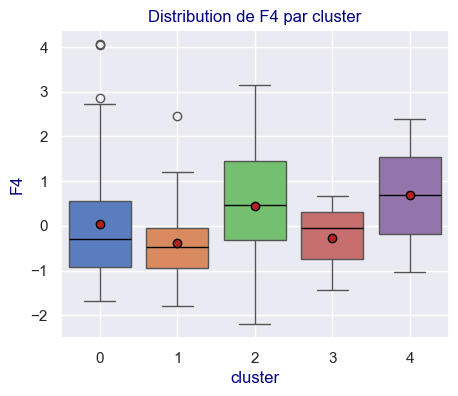

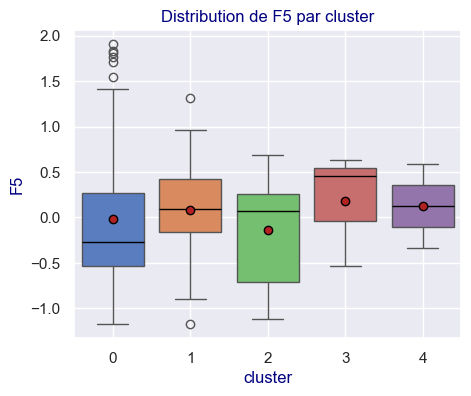

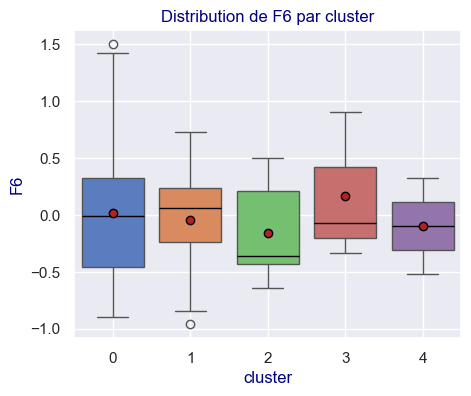

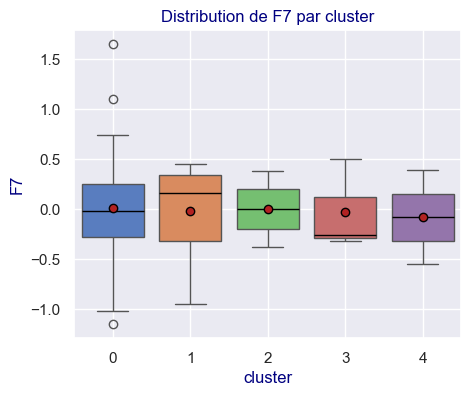

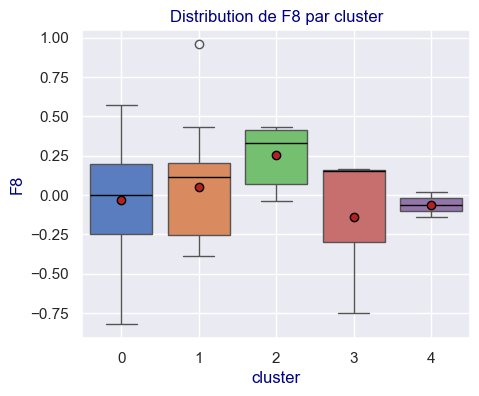

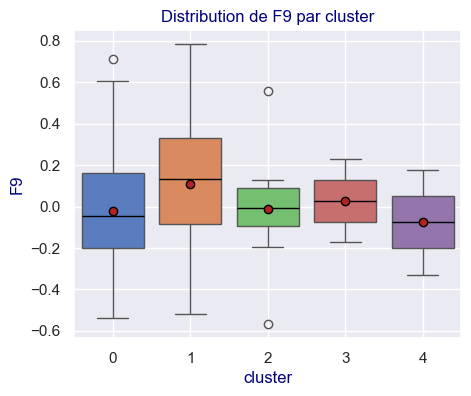

In [978]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [979]:
X_proj_temp = df_temp.copy()

In [980]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,0
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,0
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,0
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,0


In [981]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073
2,5.232017,-1.304359,1.233971,0.449322,-0.138736,-0.159506,0.002188,0.253402,-0.010720
3,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
4,-1.294535,-5.837432,5.109769,0.682037,0.125815,-0.092621,-0.081598,-0.059913,-0.075807


In [982]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832,0
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073,1
2,5.232017,-1.304359,1.233971,0.449322,-0.138736,-0.159506,0.002188,0.253402,-0.010720,2
3,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,3
4,-1.294535,-5.837432,5.109769,0.682037,0.125815,-0.092621,-0.081598,-0.059913,-0.075807,4


Et on affiche pour F1 et F2

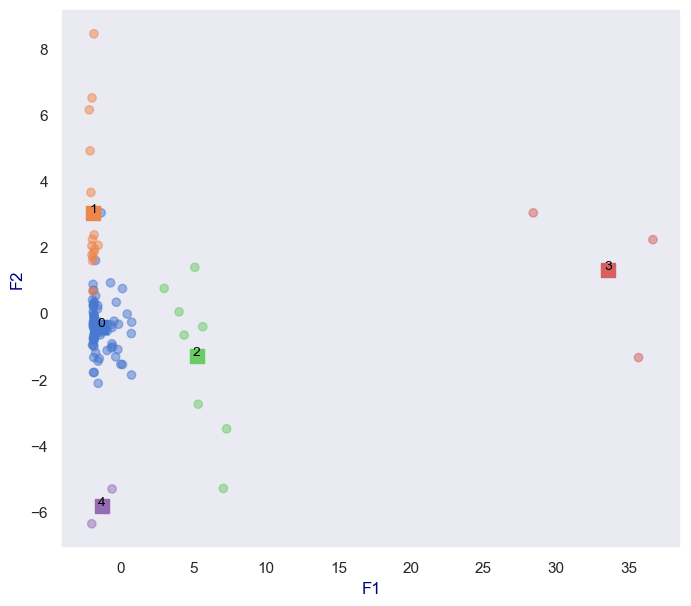

In [983]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


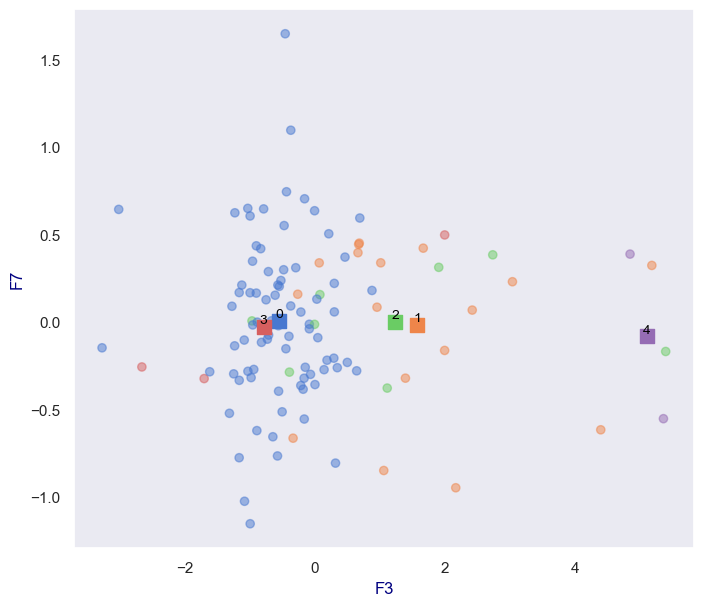

In [984]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 6], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 6], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 6] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[2])
ax.set_ylabel(X_proj_temp.columns[6])
plt.show()


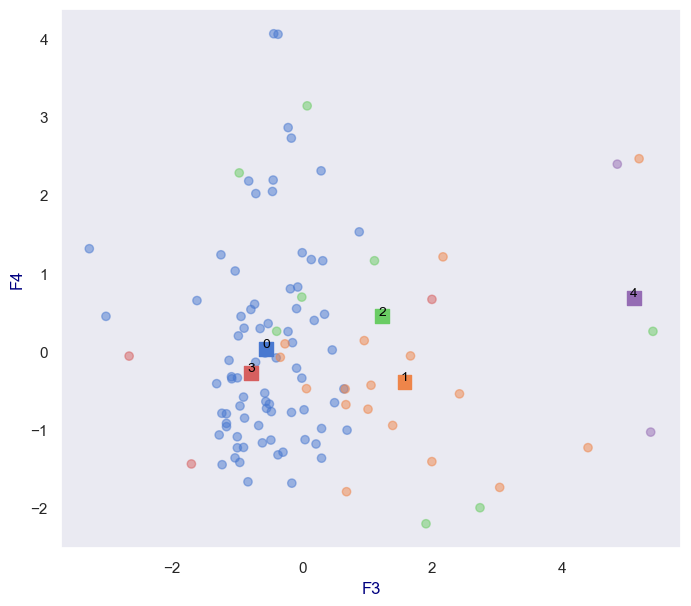

In [985]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

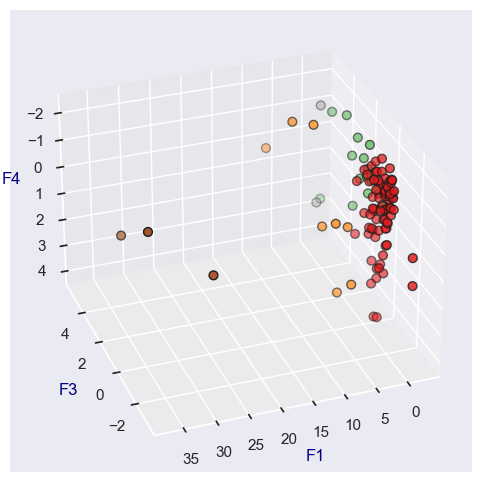

In [986]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

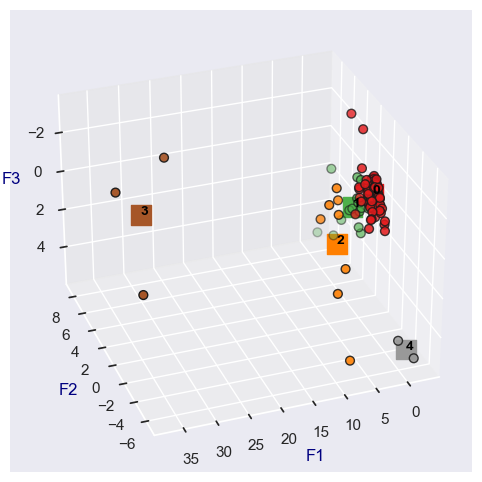

In [987]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [988]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,0
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,0
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,0
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,0


In [989]:
centroids_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.342080,-0.417213,-0.556515,0.031819,-0.013306,0.020334,0.006536,-0.029153,-0.020832,0
1,-1.923678,3.033645,1.576538,-0.392615,0.080687,-0.039756,-0.017423,0.050043,0.107073,1
2,5.232017,-1.304359,1.233971,0.449322,-0.138736,-0.159506,0.002188,0.253402,-0.010720,2
3,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,3
4,-1.294535,-5.837432,5.109769,0.682037,0.125815,-0.092621,-0.081598,-0.059913,-0.075807,4


In [990]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [991]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [992]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [993]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Rob.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

In [994]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import KMeans

##### DATA :

In [995]:
df_X_Rob_scaled.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


In [996]:
df_X_Rob_scaled_KM=df_X_Rob_scaled.copy(deep=True)
df_X_Rob_scaled_KM.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
iso3,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421


In [997]:
df_X_Rob_scaled_KM.shape

(110, 9)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [998]:
n_clusters=6

In [999]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [1000]:
kmeans.fit(df_X_Rob_scaled_KM)

KMeans(n_clusters=6)

On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [1001]:
kmeans.inertia_

649.0889926299354

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

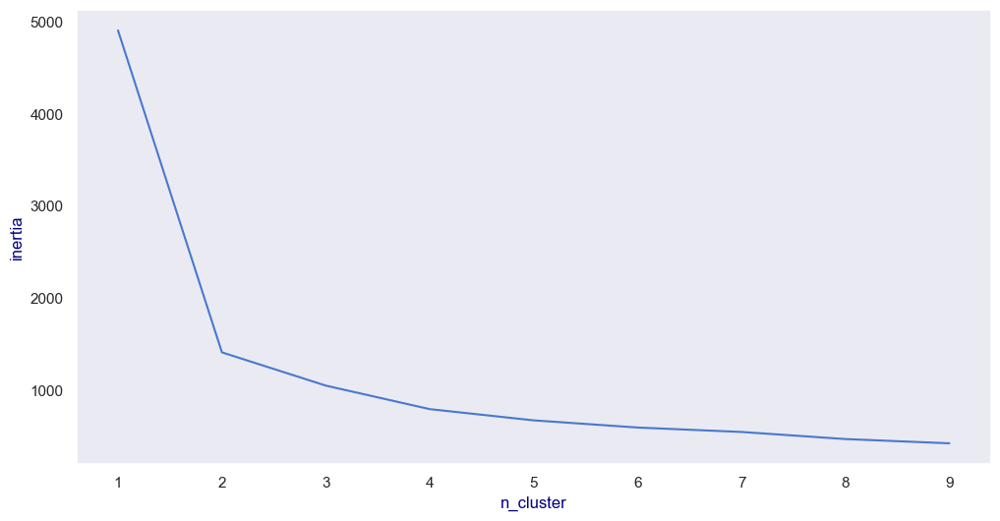

In [1002]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 10)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_Rob_scaled_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(12,6))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
2 et 4

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2.3bis - Methode de la silhouette sur le K-means </h4>
</div>

##### JOLI Mais pas très pratique :

##### FIN JOLI Mais pas très pratique :

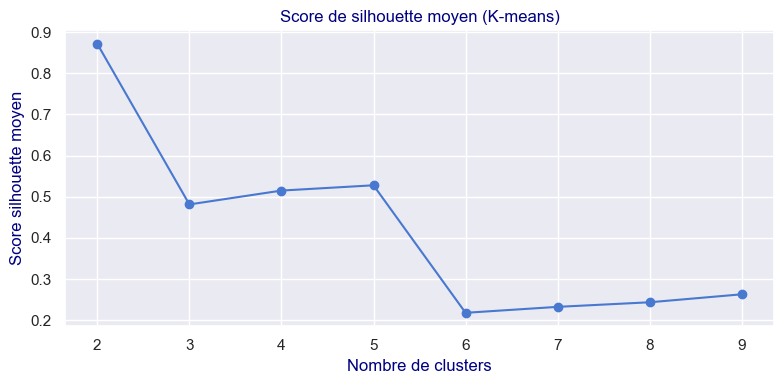

In [1003]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_Rob_scaled_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 10)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Choix à 2 ou 5 groupes

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Rob.2one - K-means Test à 2 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [1004]:
n_clusters=2

In [1005]:
df_X_Rob_scaled_KM_N_temp =df_X_Rob_scaled_KM.copy()

In [1006]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_Rob_scaled_KM_N_temp  )

KMeans(n_clusters=2)

Voici les clusters : 

In [1007]:
kmeans.labels_

array([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [1008]:
pd.Series(kmeans.labels_).value_counts()

1    107
0      3
Name: count, dtype: int64

Ajoutons nos labels à `df_X_Rob_scaled_KM_N_temp  `

In [1009]:
df_X_Rob_scaled_KM_N_temp  ["labels"] = kmeans.labels_
df_X_Rob_scaled_KM_N_temp  

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,1
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,1
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,1
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,1
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,1
...,...,...,...,...,...,...,...,...,...,...
URY,-0.984059,-0.216263,-0.106145,0.576685,0.113063,-0.416415,-0.009343,-0.041667,0.721053,1
USA,-0.424640,10.326405,-1.933429,3.085944,1.002174,0.341581,-0.009287,0.958333,-0.047368,1
UZB,-0.093523,0.767346,-0.077343,-0.261362,-0.675358,0.092939,-0.009343,-0.291667,-0.194737,1


Affichons cela de façon graphique :

In [1010]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Rob_scaled_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

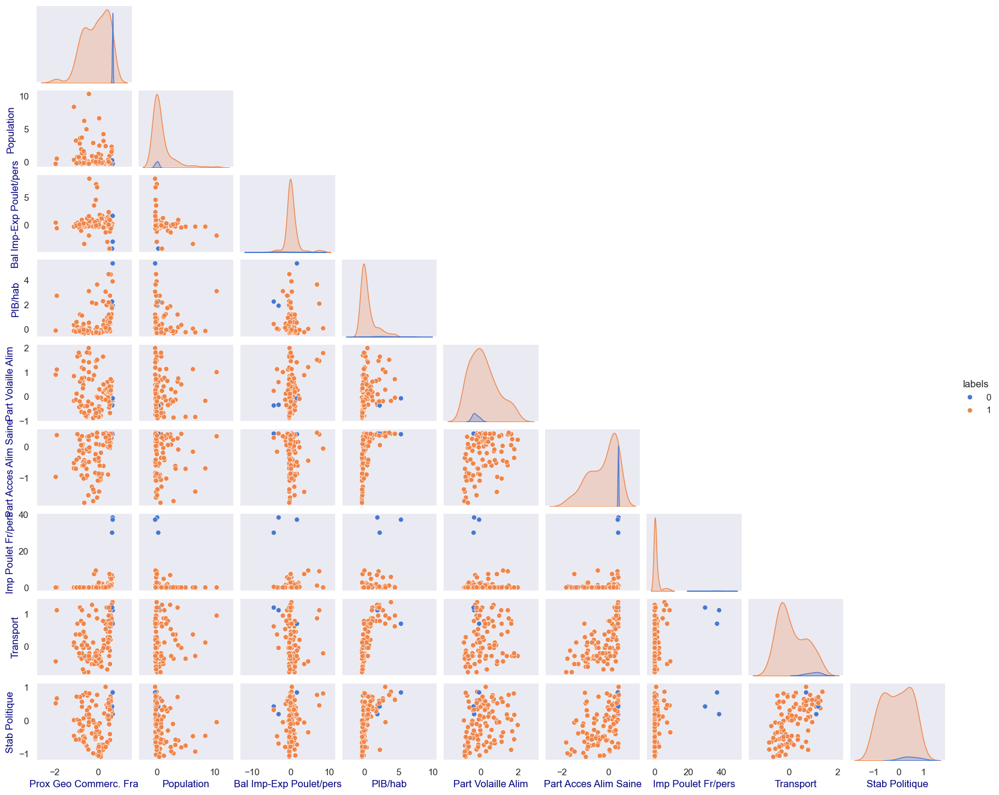

In [1011]:
sns.pairplot(df_X_Rob_scaled_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait x pouces de haut
             aspect=1.2)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2one.2 - Interprétation: </h4>
</div>

In [1012]:
df_X_Rob_scaled_KM_N_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,1
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,1


CENTRE DE GRAVITE :

In [1013]:
df_X_Rob_scaled_KM_N_temp_grouped = (df_X_Rob_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Rob_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Rob_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
1,-0.117800,0.757895,0.332878,0.475985,0.163745,-0.228371,0.859679,0.139019,-0.065470


LES CENTROIDES :

In [1014]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[ 6.46484503e-01, -8.13016343e-03, -1.88873726e+00,
         3.16115915e+00, -2.62015942e-01,  4.25266546e-01,
         3.52228739e+01,  1.01388889e+00,  4.89473682e-01],
       [-1.17799527e-01,  7.57895235e-01,  3.32877708e-01,
         4.75984603e-01,  1.63745301e-01, -2.28371282e-01,
         8.59679097e-01,  1.39018692e-01, -6.54697786e-02]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [1015]:
df_temp = df_X_Rob_scaled_KM_N_temp  .copy()
df_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,1
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,1
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,1
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,1
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,1


In [1016]:
df_temp_grouped =df_X_Rob_scaled_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
1,-0.117800,0.757895,0.332878,0.475985,0.163745,-0.228371,0.859679,0.139019,-0.065470


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2one.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [1017]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BEL  / LUX  / NLD 



cluster 1 :
AGO  / ALB  / ARE  / ARM  / AUS  / AUT  / BEN  / BFA  / BGD  / BGR  / BIH  / BLR  / BOL  / BRA  / BTN  / BWA  / CAF  / CAN  / CHE  / CHL  / CMR  / COD  / COG  / COL  / CRI  / CYP  / CZE  / DEU  / DJI  / DNK  / DOM  / DZA  / EGY  / ESP  / EST  / FIN  / FJI  / GAB  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GRD  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IDN  / IRL  / IRN  / IRQ  / ISL  / ISR  / ITA  / JAM  / JPN  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MEX  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NGA  / NIC  / NOR  / PAN  / PER  / PHL  / POL  / PRT  / PRY  / QAT  / ROU  / RUS  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / USA  / UZB  / VNM  / ZAF 





**HEATMAP**

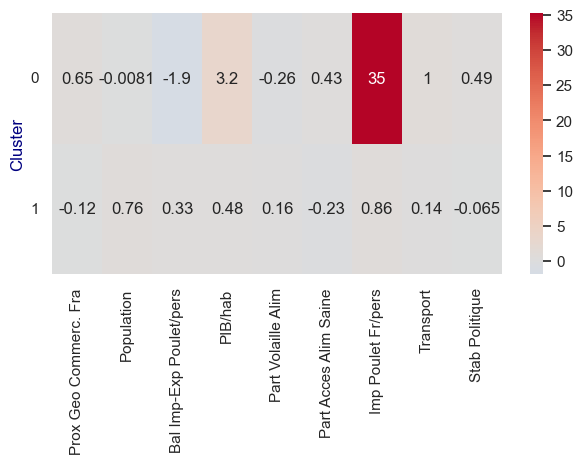

In [1018]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

La distinction se fait uniquement sur le niveau de vie... pas très intéressant !!!

**RADAR**

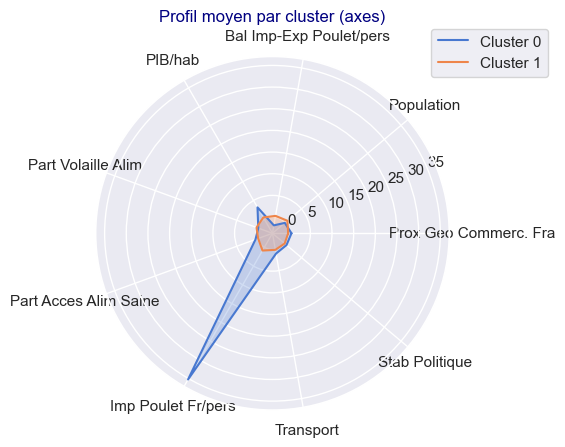

In [1019]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

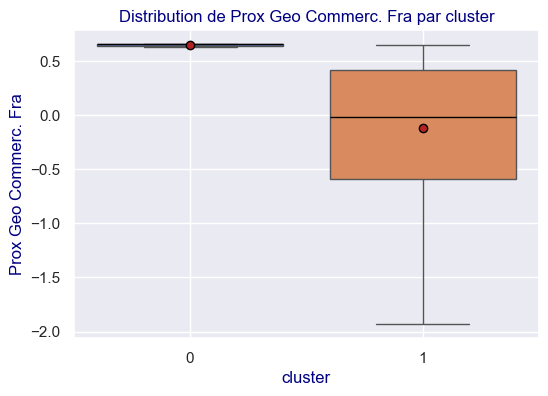

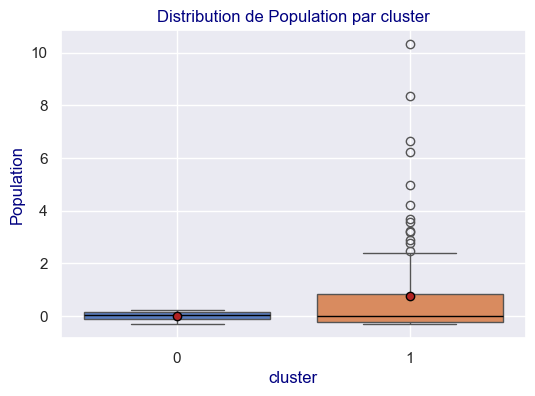

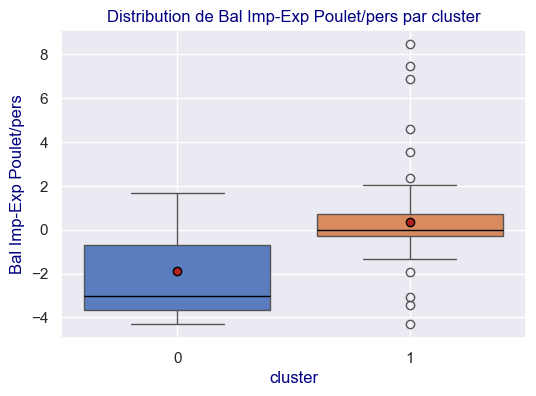

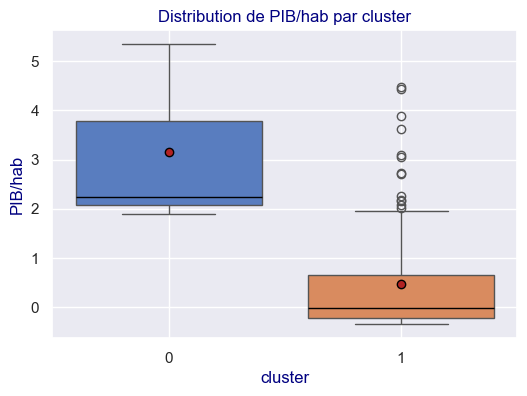

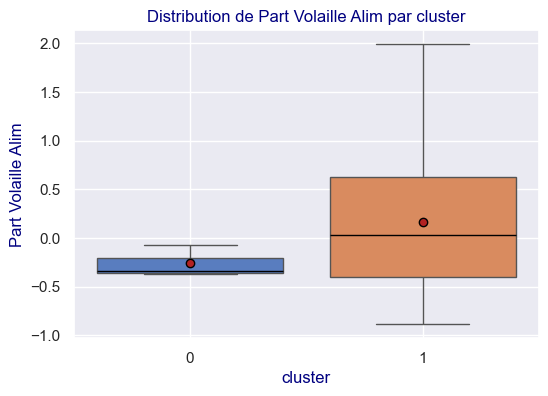

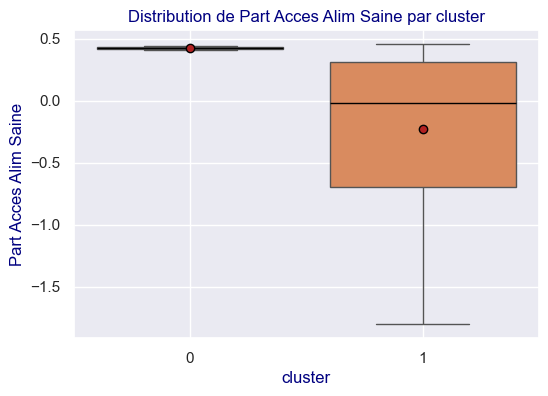

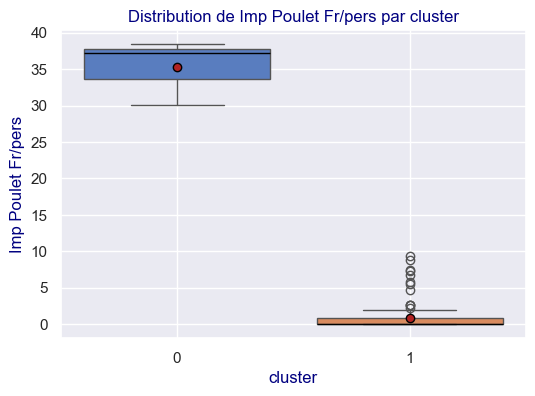

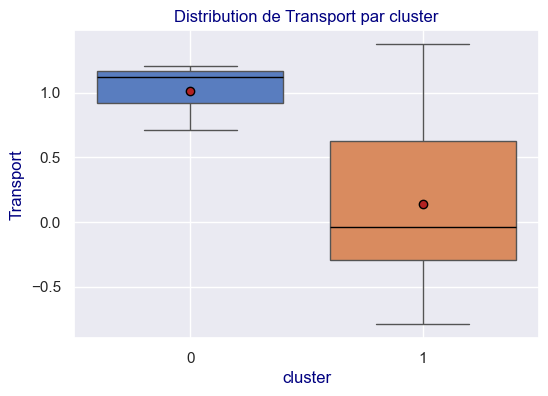

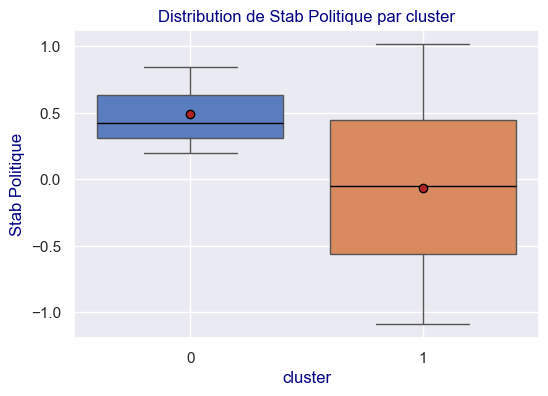

In [1020]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2one.4 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

In [1021]:
X_proj_temp = df_temp.copy()

In [1022]:
X_proj_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,1
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,1
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,1
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,1
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,1


In [1023]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
1,-0.117800,0.757895,0.332878,0.475985,0.163745,-0.228371,0.859679,0.139019,-0.065470


In [1024]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
cluster,,,,,,,,,,
0,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474,0
1,-0.117800,0.757895,0.332878,0.475985,0.163745,-0.228371,0.859679,0.139019,-0.065470,1


Les axes intéressants sont  poulet International(2)  Poulet FR(6) et PIB(3) (éventuellement la population en (1)

2 # Bal Imp-Exp Poulet/pers  
3 # PIB/hab	  
6 # Imp Poulet Fr/pers

Et on affiche le graphique pour poulet International(2)  Poulet FR(6) :

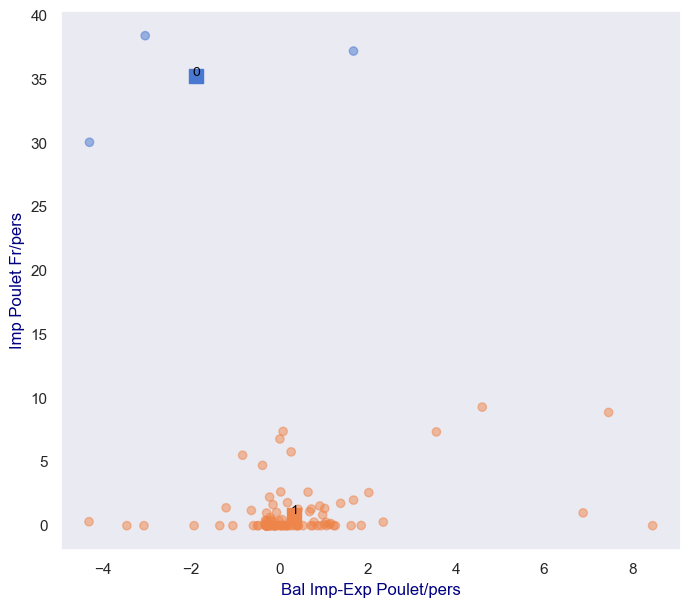

In [1025]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
#3 # PIB/hab	

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


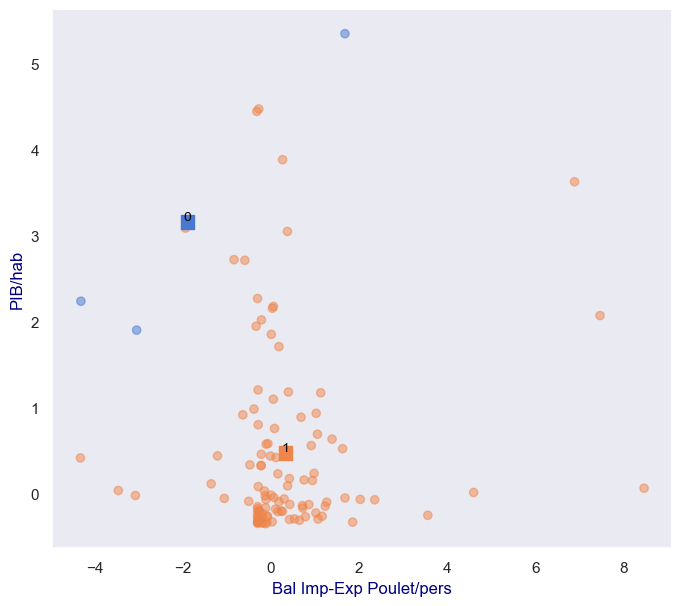

In [1026]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 3 # PIB/hab
#6 # Imp Poulet Fr/pers

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :

In [1027]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1028]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2one.6 - Visualisation des données projetées : </h4>
</div>

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.  

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

**Projetons X_Rob_scaled / df_X_Rob_scaled_AXH**

A l'identique du reste je pourrai projeter sur seulement 4 composantes :
#nb_components_Rob = 4

In [1029]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_Rob = 9

#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_Rob = PCA(n_components= nb_components_Rob )

#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_Rob .fit(X_Rob_scaled)

#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_Rob_proj = pca_Rob.transform(X_Rob_scaled)

In [1030]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_Rob_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_Rob
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321


In [1031]:
df_X_Rob_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,1
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,1
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,1
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,1
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,1


In [1032]:
#Mappons df_X_tete_scaled avec nos labels
df_X_Rob_proj_KM_N_temp = df_temp.join(df_X_Rob_scaled_KM_N_temp["labels"])
df_X_Rob_proj_KM_N_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,1
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,1
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,1
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,1
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,1


In [1033]:
X_proj_temp = df_X_Rob_proj_KM_N_temp.copy()
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,1
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,1
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,1
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,1
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,1


**Récupérons les centroïdes**

Etant donné la linéarité de la transformation, 
les barycentres sont conservés et donc je peux soit projetés les centroids soit récupérer les barycentres de df_X_Rob_proj_KM_N_temp

In [1034]:
df_X_Rob_proj_KM_N_temp_grouped = (df_X_Rob_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Rob_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Rob_proj_KM_N_temp_grouped)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782


In [1035]:
centroids_proj_temp =df_X_Rob_proj_KM_N_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782


Travaillons sur des copies :

In [1036]:
df_temp = df_X_Rob_proj_KM_N_temp.copy()
df_temp_grouped = df_X_Rob_proj_KM_N_temp_grouped.copy()

In [1037]:
df_temp.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,1
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,1


In [1038]:
df_temp_grouped.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782


**Liste des pays**

In [1039]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BEL  / LUX  / NLD 



cluster 1 :
AGO  / ALB  / ARE  / ARM  / AUS  / AUT  / BEN  / BFA  / BGD  / BGR  / BIH  / BLR  / BOL  / BRA  / BTN  / BWA  / CAF  / CAN  / CHE  / CHL  / CMR  / COD  / COG  / COL  / CRI  / CYP  / CZE  / DEU  / DJI  / DNK  / DOM  / DZA  / EGY  / ESP  / EST  / FIN  / FJI  / GAB  / GBR  / GHA  / GIN  / GMB  / GNB  / GRC  / GRD  / GTM  / GUY  / HND  / HRV  / HTI  / HUN  / IDN  / IRL  / IRN  / IRQ  / ISL  / ISR  / ITA  / JAM  / JPN  / KAZ  / KGZ  / KOR  / LAO  / LBR  / LKA  / LTU  / LVA  / MDA  / MDG  / MEX  / MKD  / MLI  / MLT  / MNG  / MRT  / MUS  / MYS  / NAM  / NGA  / NIC  / NOR  / PAN  / PER  / PHL  / POL  / PRT  / PRY  / QAT  / ROU  / RUS  / RWA  / SDN  / SRB  / SVK  / SVN  / SWE  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / USA  / UZB  / VNM  / ZAF 





**HEATMAP**

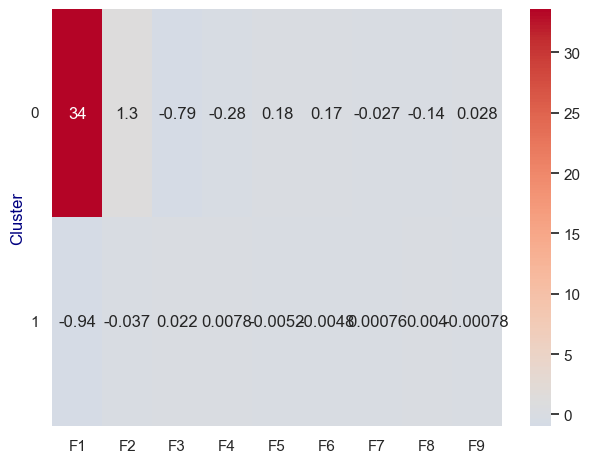

In [1040]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  


**RADAR**

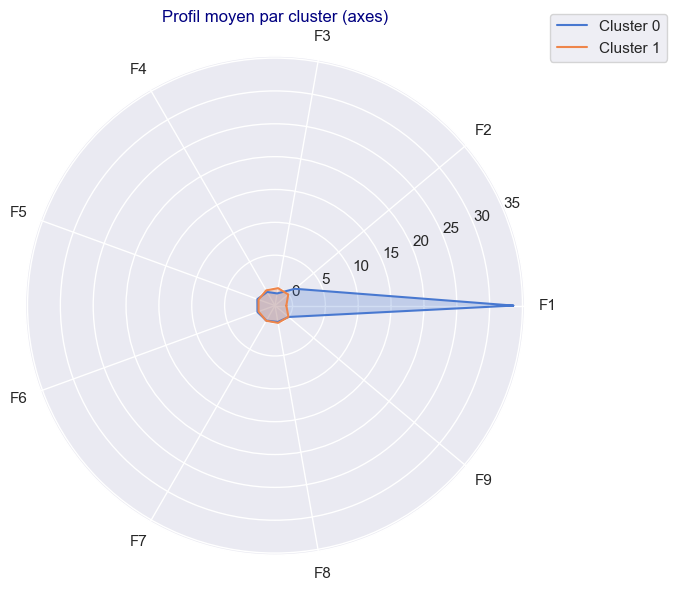

In [1041]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

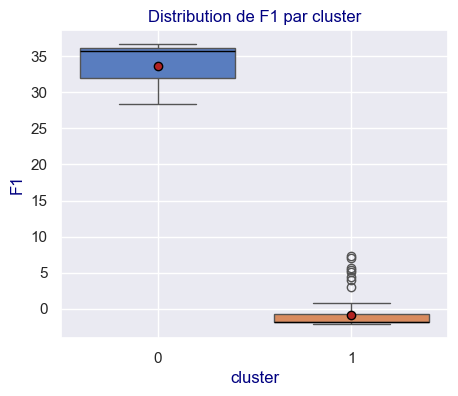

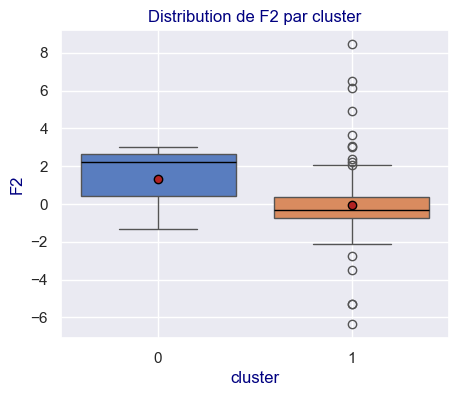

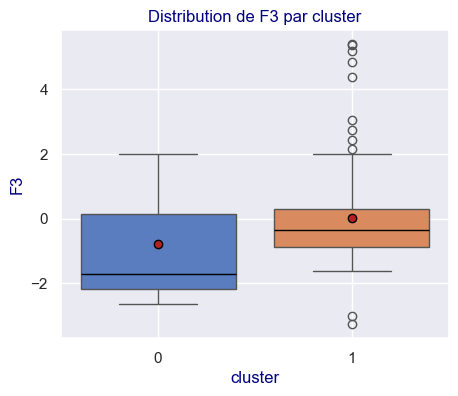

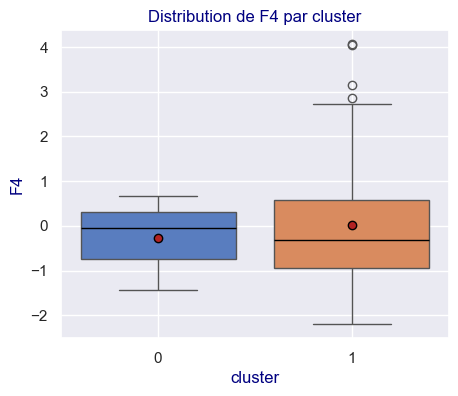

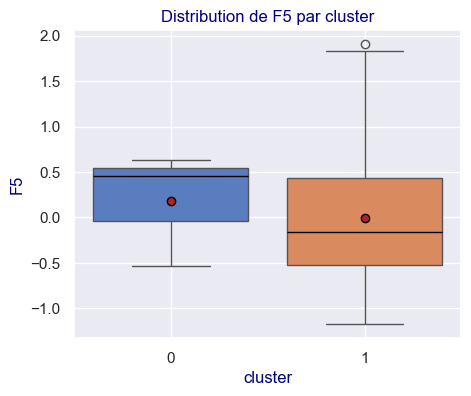

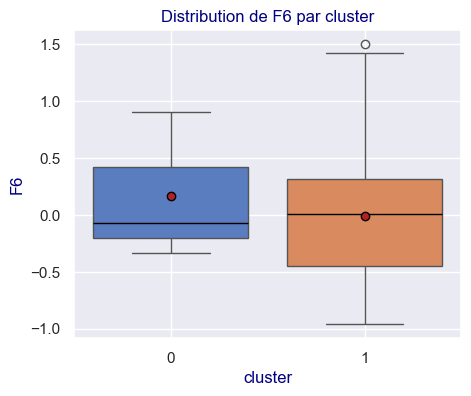

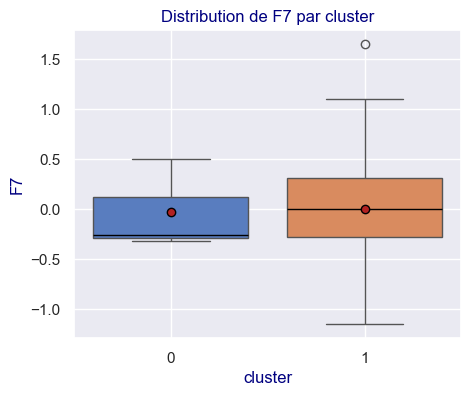

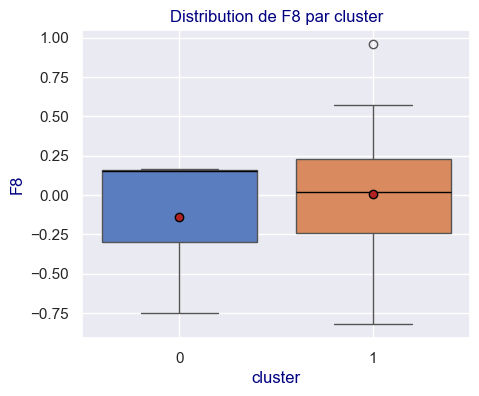

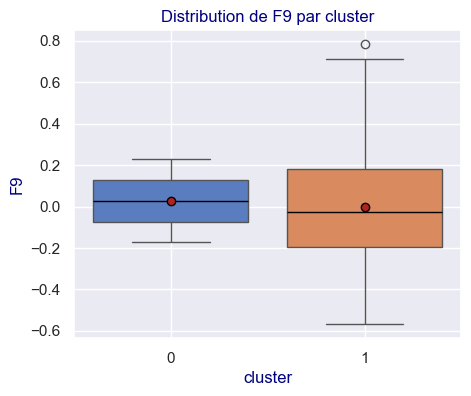

In [1042]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [1043]:
X_proj_temp = df_temp.copy()

In [1044]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,1
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,1
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,1
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,1
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,1


In [1045]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782


In [1046]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,0
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782,1


Et on affiche pour F1 et F2

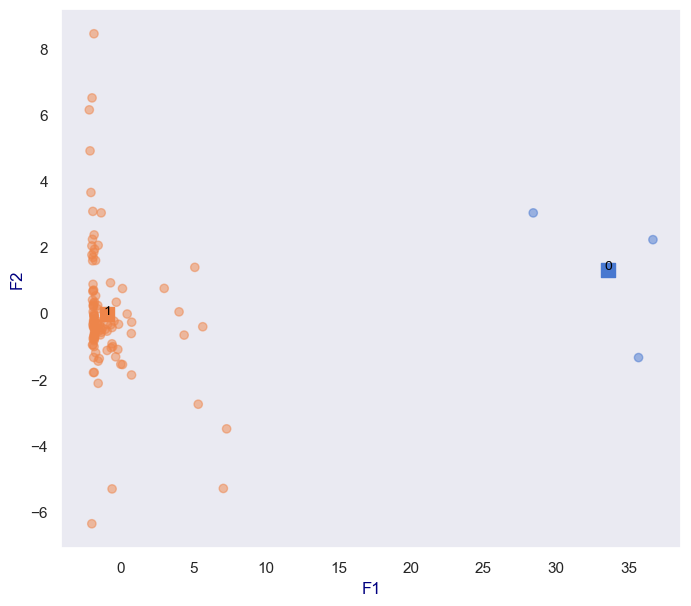

In [1047]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


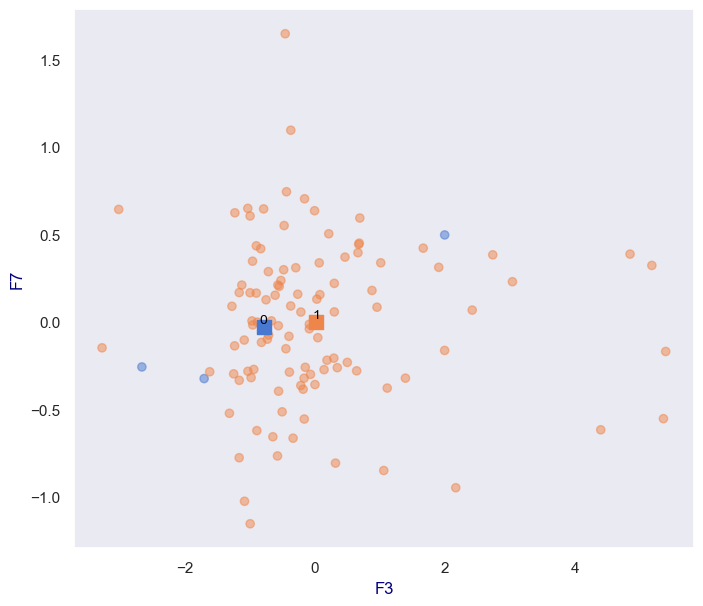

In [1048]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 6], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 6], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 6] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[2])
ax.set_ylabel(X_proj_temp.columns[6])
plt.show()


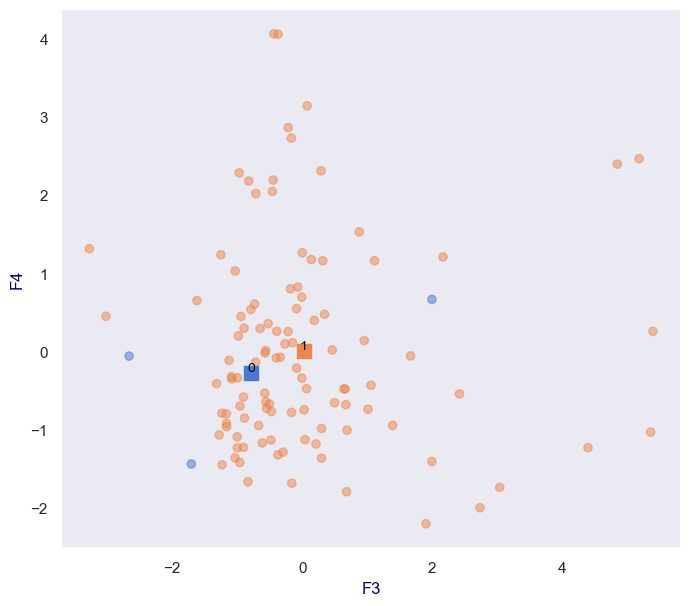

In [1049]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

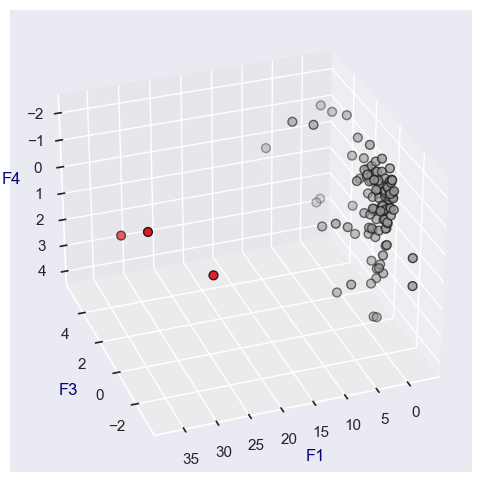

In [1050]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

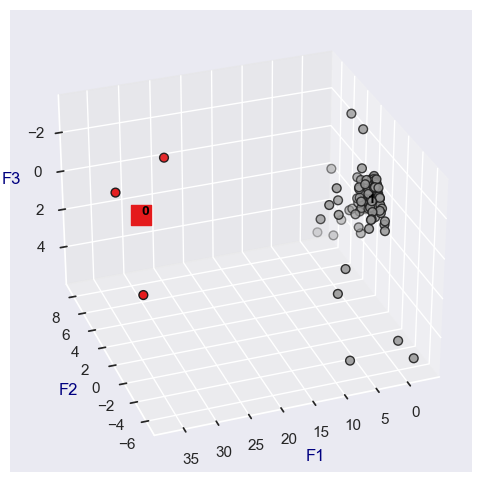

In [1051]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [1052]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,1
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,1
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,1
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,1
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,1


In [1053]:
centroids_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,0
1,-0.942073,-0.036587,0.022162,0.007755,-0.005150,-0.004770,0.000757,0.003981,-0.000782,1


In [1054]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1055]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1056]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [1057]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4Rob.2bis - K-means Test à 5 clusters  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2bis.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [1058]:
n_clusters=5

In [1059]:
df_X_Rob_scaled_KM_N_temp =df_X_Rob_scaled_KM.copy()

In [1060]:
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(df_X_Rob_scaled_KM_N_temp  )

KMeans(n_clusters=5)

Voici les clusters : 

In [1061]:
kmeans.labels_

array([4, 4, 2, 4, 3, 3, 1, 4, 4, 0, 4, 4, 4, 4, 0, 4, 4, 4, 3, 2, 4, 4,
       4, 2, 4, 4, 4, 3, 2, 4, 2, 4, 4, 0, 2, 3, 3, 4, 2, 3, 4, 4, 4, 4,
       3, 2, 4, 4, 4, 4, 4, 3, 0, 3, 4, 4, 3, 3, 3, 4, 0, 4, 4, 3, 4, 4,
       4, 3, 1, 3, 4, 4, 0, 4, 4, 3, 4, 4, 4, 4, 4, 0, 4, 1, 3, 4, 4, 0,
       3, 2, 4, 2, 4, 0, 4, 4, 4, 3, 3, 3, 4, 4, 4, 4, 4, 4, 0, 4, 4, 4])

In [1062]:
pd.Series(kmeans.labels_).value_counts()

4    65
3    22
2    10
0    10
1     3
Name: count, dtype: int64

Ajoutons nos labels à `df_X_Rob_scaled_KM_N_temp  `

In [1063]:
df_X_Rob_scaled_KM_N_temp  ["labels"] = kmeans.labels_
df_X_Rob_scaled_KM_N_temp  

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,4
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,4
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,4
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,3
...,...,...,...,...,...,...,...,...,...,...
URY,-0.984059,-0.216263,-0.106145,0.576685,0.113063,-0.416415,-0.009343,-0.041667,0.721053,4
USA,-0.424640,10.326405,-1.933429,3.085944,1.002174,0.341581,-0.009287,0.958333,-0.047368,0
UZB,-0.093523,0.767346,-0.077343,-0.261362,-0.675358,0.092939,-0.009343,-0.291667,-0.194737,4


Affichons cela de façon graphique :

In [1064]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Rob_scaled_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("muted", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

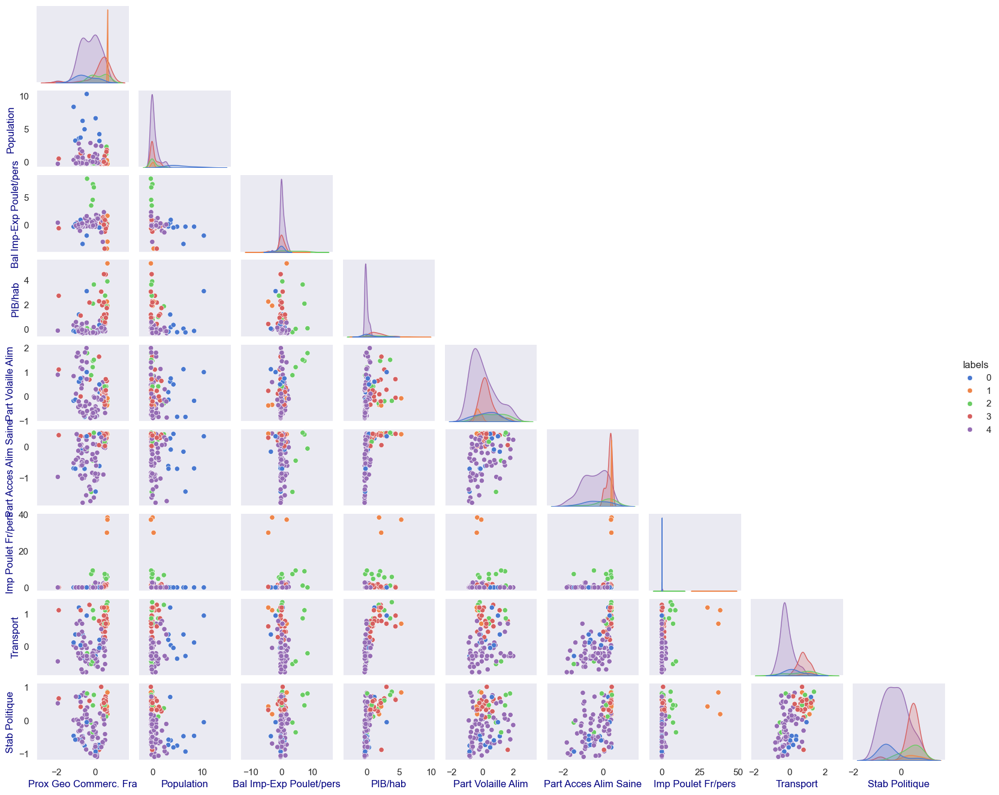

In [1065]:
sns.pairplot(df_X_Rob_scaled_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels,
             height=1.5,         # chaque graphique fait x pouces de haut
             aspect=1.2)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2bis.2 - Interprétation: </h4>
</div>

In [1066]:
df_X_Rob_scaled_KM_N_temp.head(2)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,4
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,4


CENTRE DE GRAVITE :

In [1067]:
df_X_Rob_scaled_KM_N_temp_grouped = (df_X_Rob_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Rob_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Rob_scaled_KM_N_temp_grouped)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.478809,5.442787,-0.552270,0.371903,0.216749,-0.337960,-0.008292,0.258333,-0.465263
1,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
2,0.203385,0.235305,3.012321,1.572121,0.700495,0.057212,5.666220,0.616667,0.407368
3,0.280869,0.206761,-0.134008,1.663971,0.270937,0.307566,0.694491,0.784091,0.442105
4,-0.246607,0.304079,0.214855,-0.078727,0.036734,-0.436841,0.309655,-0.171154,-0.248502


LES CENTROIDES :

In [1068]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-4.78809371e-01,  5.44278730e+00, -5.52269863e-01,
         3.71903066e-01,  2.16748841e-01, -3.37960169e-01,
        -8.29243474e-03,  2.58333333e-01, -4.65263187e-01],
       [ 6.46484503e-01, -8.13016343e-03, -1.88873726e+00,
         3.16115915e+00, -2.62015942e-01,  4.25266546e-01,
         3.52228739e+01,  1.01388889e+00,  4.89473682e-01],
       [ 2.03385120e-01,  2.35305175e-01,  3.01232054e+00,
         1.57212082e+00,  7.00494535e-01,  5.72118286e-02,
         5.66622045e+00,  6.16666667e-01,  4.07368374e-01],
       [ 2.80868908e-01,  2.06760597e-01, -1.34008413e-01,
         1.66397060e+00,  2.70936726e-01,  3.07565699e-01,
         6.94491483e-01,  7.84090909e-01,  4.42105229e-01],
       [-2.46606506e-01,  3.04078957e-01,  2.14855278e-01,
        -7.87267619e-02,  3.67339306e-02, -4.36841372e-01,
         3.09654932e-01, -1.71153846e-01, -2.48502050e-01]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [1069]:
df_temp = df_X_Rob_scaled_KM_N_temp  .copy()
df_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,4
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,4
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,4
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,3


In [1070]:
df_temp_grouped =df_X_Rob_scaled_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.478809,5.442787,-0.552270,0.371903,0.216749,-0.337960,-0.008292,0.258333,-0.465263
1,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
2,0.203385,0.235305,3.012321,1.572121,0.700495,0.057212,5.666220,0.616667,0.407368
3,0.280869,0.206761,-0.134008,1.663971,0.270937,0.307566,0.694491,0.784091,0.442105
4,-0.246607,0.304079,0.214855,-0.078727,0.036734,-0.436841,0.309655,-0.171154,-0.248502


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2bis.3- Visualisation  : </h4>
</div>

**Liste des pays**

In [1071]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGD  / BRA  / EGY  / IDN  / JPN  / MEX  / NGA  / PHL  / RUS  / USA 



cluster 1 :
BEL  / LUX  / NLD 



cluster 2 :
ARE  / CHE  / COG  / DEU  / DNK  / ESP  / GAB  / GRD  / PRT  / QAT 



cluster 3 :
AUS  / AUT  / CAN  / CZE  / EST  / FIN  / GBR  / GRC  / HUN  / IRL  / ISL  / ISR  / ITA  / KOR  / LTU  / LVA  / MLT  / NOR  / POL  / SVK  / SVN  / SWE 



cluster 4 :
AGO  / ALB  / ARM  / BEN  / BFA  / BGR  / BIH  / BLR  / BOL  / BTN  / BWA  / CAF  / CHL  / CMR  / COD  / COL  / CRI  / CYP  / DJI  / DOM  / DZA  / FJI  / GHA  / GIN  / GMB  / GNB  / GTM  / GUY  / HND  / HRV  / HTI  / IRN  / IRQ  / JAM  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MKD  / MLI  / MNG  / MRT  / MUS  / MYS  / NAM  / NIC  / PAN  / PER  / PRY  / ROU  / RWA  / SDN  / SRB  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / UZB  / VNM  / ZAF 





**HEATMAP**

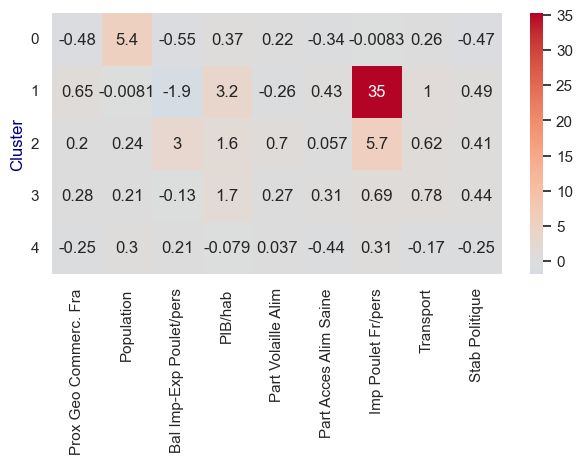

In [1072]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS :**</font>   

La distinction se fait uniquement sur le niveau de vie... pas très intéressant !!!

**RADAR**

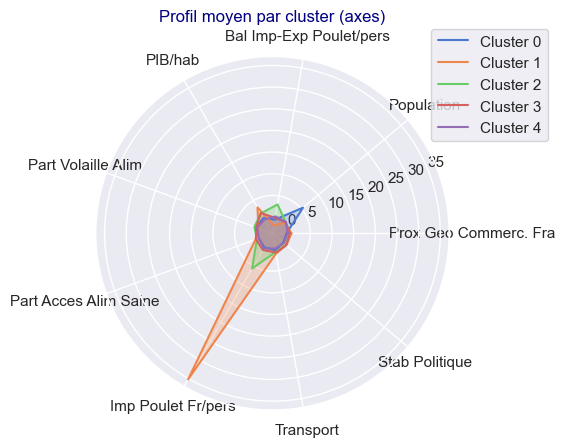

In [1073]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

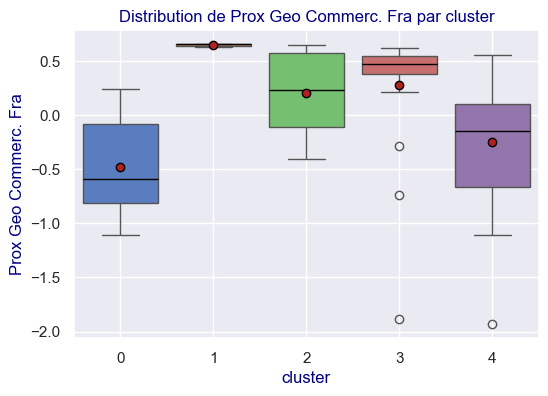

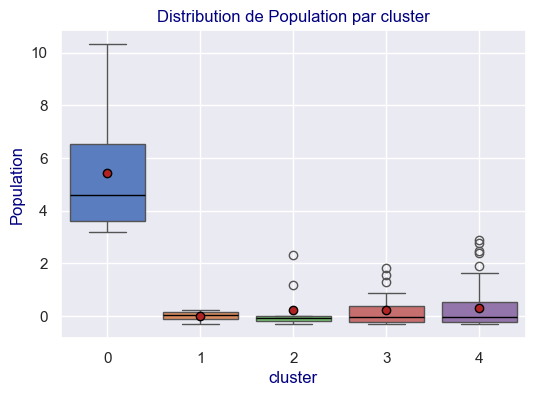

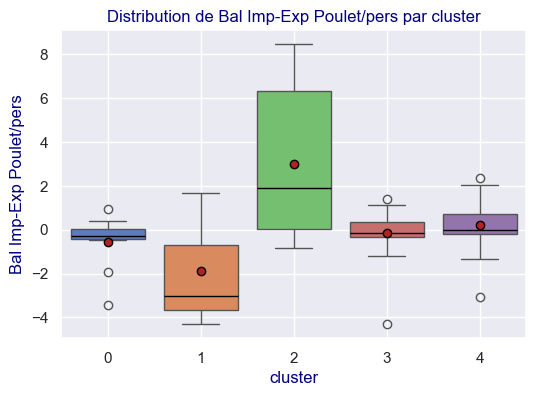

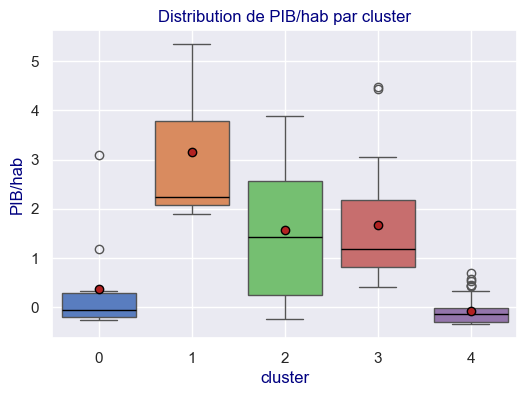

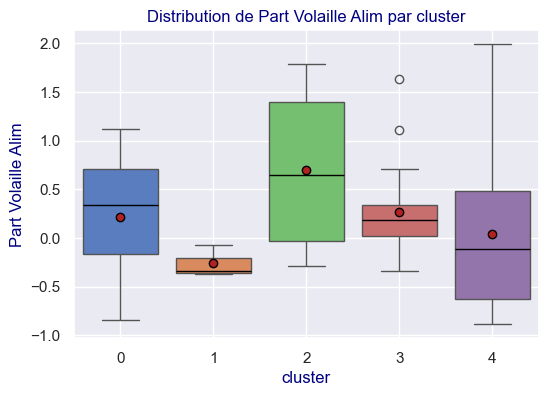

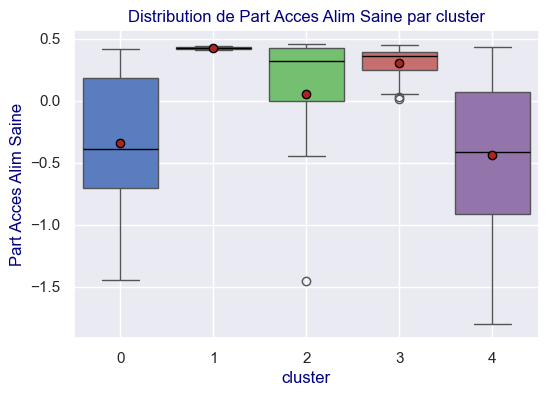

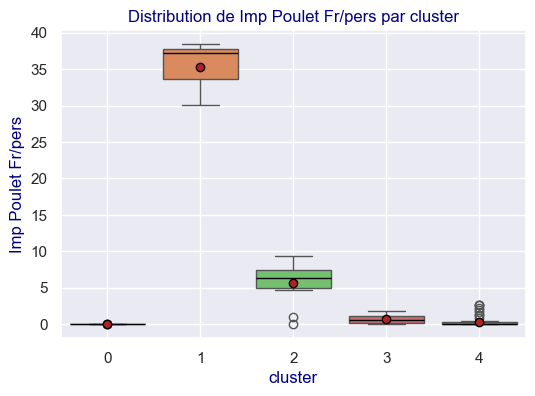

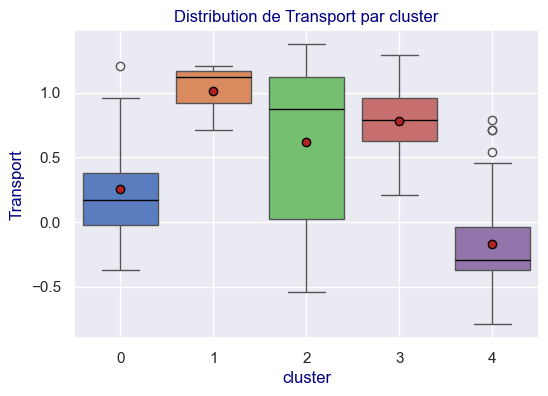

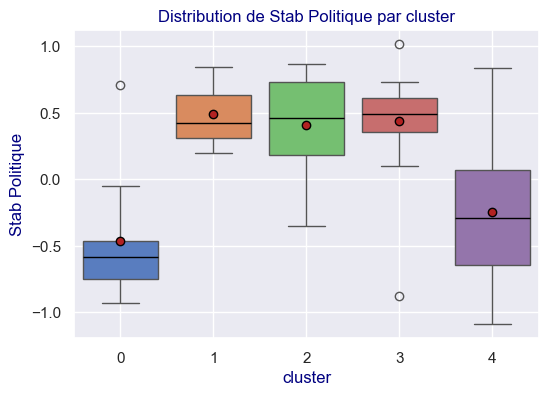

In [1074]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2bis.4 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

In [1075]:
X_proj_temp = df_temp.copy()

In [1076]:
X_proj_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,4
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,4
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,4
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,3


In [1077]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique
cluster,,,,,,,,,
0,-0.478809,5.442787,-0.552270,0.371903,0.216749,-0.337960,-0.008292,0.258333,-0.465263
1,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474
2,0.203385,0.235305,3.012321,1.572121,0.700495,0.057212,5.666220,0.616667,0.407368
3,0.280869,0.206761,-0.134008,1.663971,0.270937,0.307566,0.694491,0.784091,0.442105
4,-0.246607,0.304079,0.214855,-0.078727,0.036734,-0.436841,0.309655,-0.171154,-0.248502


In [1078]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
cluster,,,,,,,,,,
0,-0.478809,5.442787,-0.552270,0.371903,0.216749,-0.337960,-0.008292,0.258333,-0.465263,0
1,0.646485,-0.008130,-1.888737,3.161159,-0.262016,0.425267,35.222874,1.013889,0.489474,1
2,0.203385,0.235305,3.012321,1.572121,0.700495,0.057212,5.666220,0.616667,0.407368,2
3,0.280869,0.206761,-0.134008,1.663971,0.270937,0.307566,0.694491,0.784091,0.442105,3
4,-0.246607,0.304079,0.214855,-0.078727,0.036734,-0.436841,0.309655,-0.171154,-0.248502,4


Les axes intéressants sont  poulet International(2)  Poulet FR(6) et PIB(3) (éventuellement la population en (1)

2 # Bal Imp-Exp Poulet/pers  
3 # PIB/hab	  
6 # Imp Poulet Fr/pers

Et on affiche le graphique pour poulet International(2)  Poulet FR(6) :

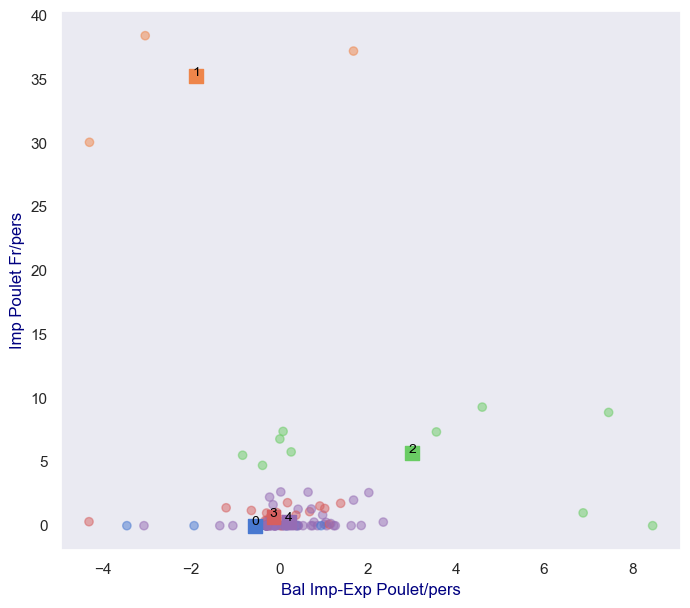

In [1079]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
#3 # PIB/hab	

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


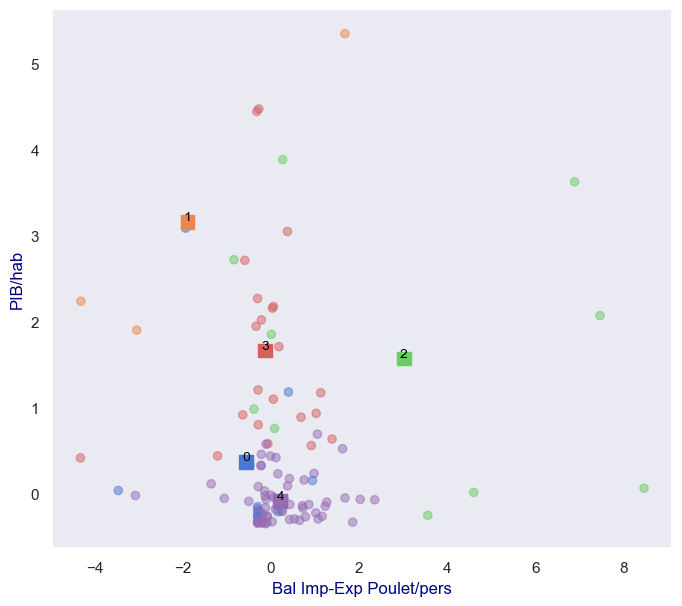

In [1080]:
Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 3 # PIB/hab
#6 # Imp Poulet Fr/pers

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :

In [1081]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1082]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

Axe_X = 2 # Bal Imp-Exp Poulet/pers  
Axe_Y = 6 # Imp Poulet Fr/pers
Axe_Z = 3 # PIB/hab

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp.iloc[:, Axe_X],
    y=X_proj_temp.iloc[:, Axe_Y],
    z=X_proj_temp.iloc[:, Axe_Z],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp.iloc[:, Axe_X], 
    y=centroids_proj_temp.iloc[:, Axe_Y], 
    z=centroids_proj_temp.iloc[:, Axe_Z], 
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title=X_proj_temp.columns[Axe_X]),
        yaxis=dict(title=X_proj_temp.columns[Axe_Y]),
        zaxis=dict(title=X_proj_temp.columns[Axe_Z]),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4Rob.2bis.6 - Visualisation des données projetées : </h4>
</div>

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.  

pour le moment je fais le choix de ne pas faire une PCA jsute pour de la visualisation, sinon je peux récupérer la pca que j'ai faite pour les pays sans CHN et IND avec Standard Scaler, mais si j'essaye avec un autre scaler de toute façon ma PCA ne sera plus valable.

**Projetons X_Rob_scaled / df_X_Rob_scaled_AXH**

A l'identique du reste je pourrai projeter sur seulement 4 composantes :
#nb_components_Rob = 4

In [1083]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_Rob = 9

#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_Rob = PCA(n_components= nb_components_Rob )

#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_Rob .fit(X_Rob_scaled)

#maintenant qu'on a fitté notre méthode pca_bis avec 9 axes pricnipaux
#on projette nos données centrés réduites X_bis_scaled sur nos 9 axes principaux
X_Rob_proj = pca_Rob.transform(X_Rob_scaled)

In [1084]:
#Visualisation de X_bis_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_Rob_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_Rob
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6,F7,F8,F9
iso3,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321


In [1085]:
df_X_Rob_scaled_KM_N_temp.head()

,Prox Geo Commerc. Fra,Population,Bal Imp-Exp Poulet/pers,PIB/hab,Part Volaille Alim,Part Acces Alim Saine,Imp Poulet Fr/pers,Transport,Stab Politique,labels
iso3,,,,,,,,,,
AGO,-0.288376,0.789048,1.021030,-0.222250,-0.311573,-1.287870,0.094610,-0.541667,-0.384211,4
ALB,0.485270,-0.233826,2.028054,-0.064747,0.032141,0.160531,2.582113,-0.041667,0.047368,4
ARE,-0.100175,-0.002656,7.465051,2.070001,1.463492,0.399517,8.869250,1.125000,0.457895,2
ARM,0.180692,-0.232165,1.682230,-0.048285,-0.116377,-0.870247,1.995928,-0.125000,-0.721053,4
AUS,-1.882500,0.494912,-0.588603,2.712377,1.109297,0.377791,-0.009343,1.125000,0.668421,3


In [1086]:
#Mappons df_X_tete_scaled avec nos labels
df_X_Rob_proj_KM_N_temp = df_temp.join(df_X_Rob_scaled_KM_N_temp["labels"])
df_X_Rob_proj_KM_N_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,4
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,4
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,4
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,3


In [1087]:
X_proj_temp = df_X_Rob_proj_KM_N_temp.copy()
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,4
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,4
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,4
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,3


**Récupérons les centroïdes**

Etant donné la linéarité de la transformation, 
les barycentres sont conservés et donc je peux soit projetés les centroids soit récupérer les barycentres de df_X_Rob_proj_KM_N_temp

In [1088]:
df_X_Rob_proj_KM_N_temp_grouped = (df_X_Rob_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Rob_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Rob_proj_KM_N_temp_grouped)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
2,3.926707,-2.210974,2.009131,0.495865,-0.085826,-0.146129,-0.014569,0.190739,-0.023737
3,-0.917948,-0.228621,-0.463134,1.667427,-0.208602,-0.094453,-0.042897,0.116566,-0.016128
4,-1.539544,-0.268906,-0.488993,-0.584163,0.069050,0.048694,0.026843,-0.059605,0.017201


In [1089]:
centroids_proj_temp =df_X_Rob_proj_KM_N_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
2,3.926707,-2.210974,2.009131,0.495865,-0.085826,-0.146129,-0.014569,0.190739,-0.023737
3,-0.917948,-0.228621,-0.463134,1.667427,-0.208602,-0.094453,-0.042897,0.116566,-0.016128
4,-1.539544,-0.268906,-0.488993,-0.584163,0.069050,0.048694,0.026843,-0.059605,0.017201


Travaillons sur des copies :

In [1090]:
df_temp = df_X_Rob_proj_KM_N_temp.copy()
df_temp_grouped = df_X_Rob_proj_KM_N_temp_grouped.copy()

In [1091]:
df_temp.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,4
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,4


In [1092]:
df_temp_grouped.head(2)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898


**Liste des pays**

In [1093]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
BGD  / BRA  / EGY  / IDN  / JPN  / MEX  / NGA  / PHL  / RUS  / USA 



cluster 1 :
BEL  / LUX  / NLD 



cluster 2 :
ARE  / CHE  / COG  / DEU  / DNK  / ESP  / GAB  / GRD  / PRT  / QAT 



cluster 3 :
AUS  / AUT  / CAN  / CZE  / EST  / FIN  / GBR  / GRC  / HUN  / IRL  / ISL  / ISR  / ITA  / KOR  / LTU  / LVA  / MLT  / NOR  / POL  / SVK  / SVN  / SWE 



cluster 4 :
AGO  / ALB  / ARM  / BEN  / BFA  / BGR  / BIH  / BLR  / BOL  / BTN  / BWA  / CAF  / CHL  / CMR  / COD  / COL  / CRI  / CYP  / DJI  / DOM  / DZA  / FJI  / GHA  / GIN  / GMB  / GNB  / GTM  / GUY  / HND  / HRV  / HTI  / IRN  / IRQ  / JAM  / KAZ  / KGZ  / LAO  / LBR  / LKA  / MDA  / MDG  / MKD  / MLI  / MNG  / MRT  / MUS  / MYS  / NAM  / NIC  / PAN  / PER  / PRY  / ROU  / RWA  / SDN  / SRB  / TGO  / THA  / TJK  / TTO  / TUR  / URY  / UZB  / VNM  / ZAF 





**HEATMAP**

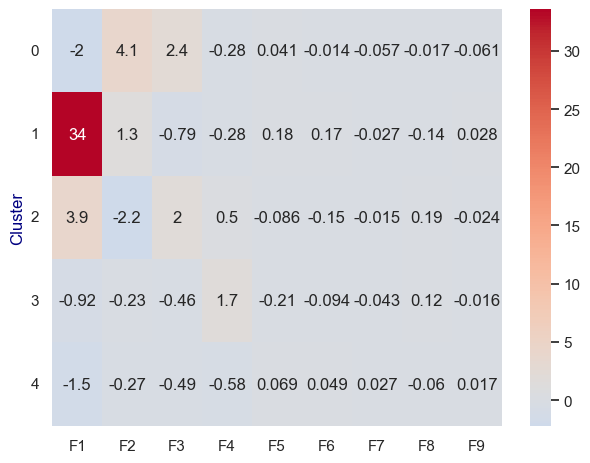

In [1094]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

<font color ='green'>**CHOIX DE CLUSTER INTERESSANTS**</font> :  


**RADAR**

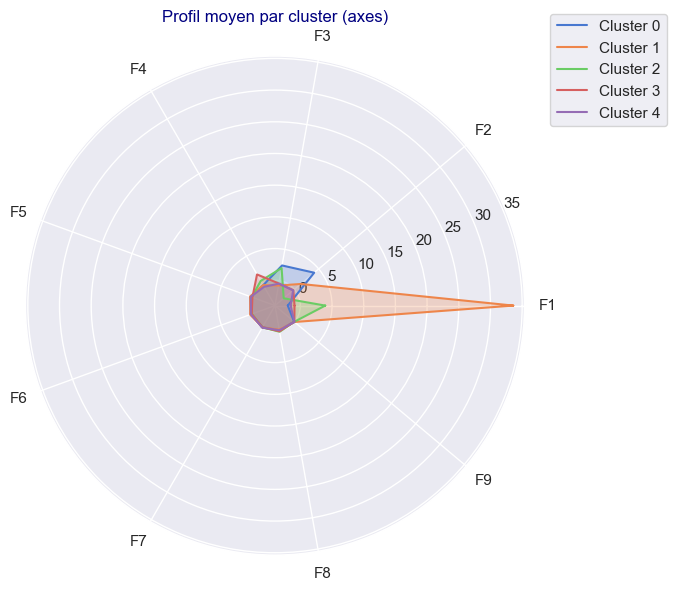

In [1095]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

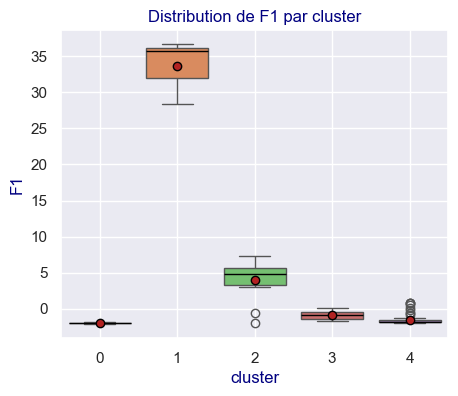

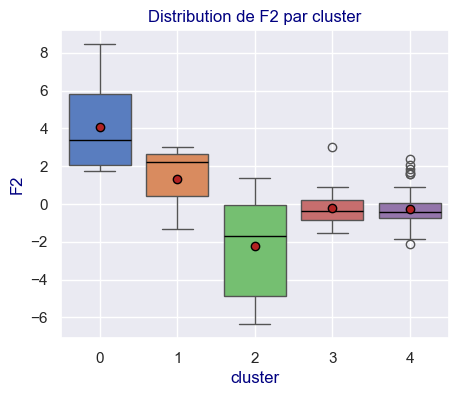

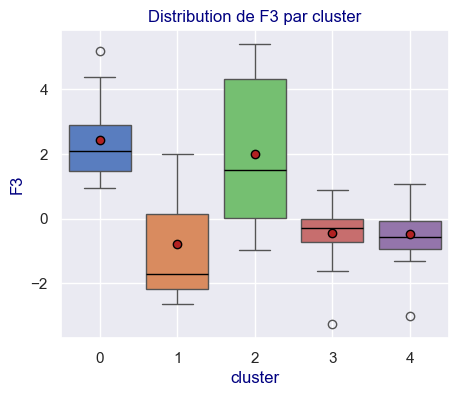

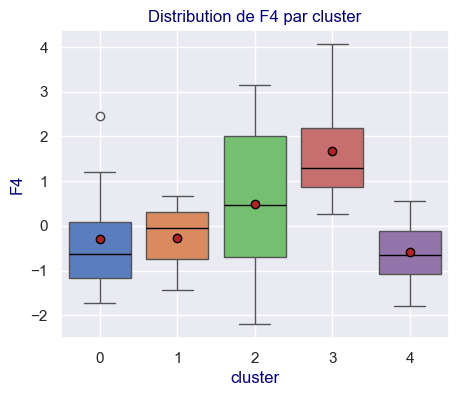

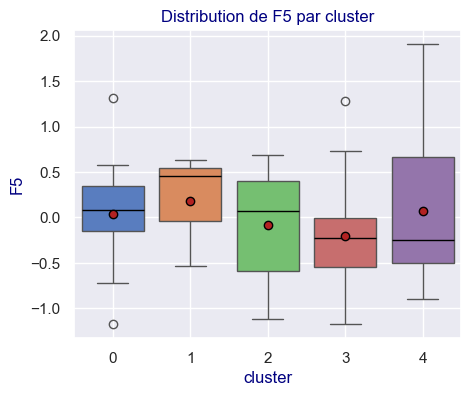

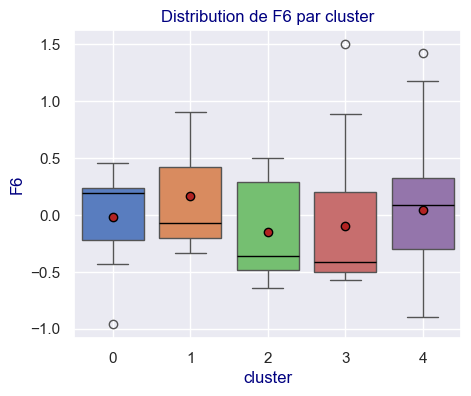

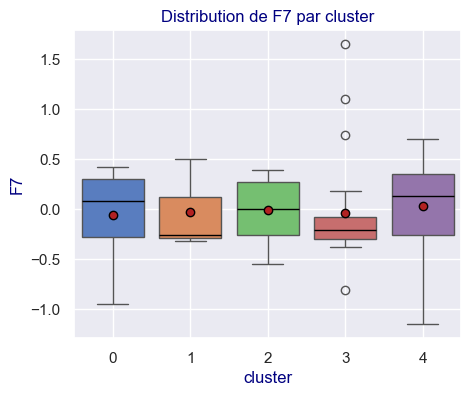

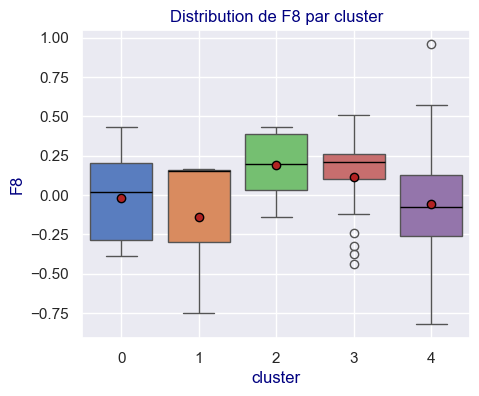

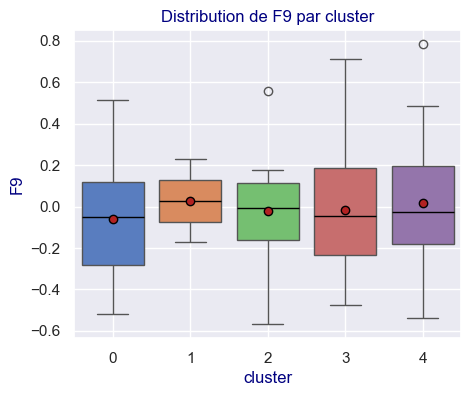

In [1096]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(5, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

##### **PROJECTIONS**

In [1097]:
X_proj_temp = df_temp.copy()

In [1098]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,4
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,4
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,4
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,3


In [1099]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9
cluster,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898
2,3.926707,-2.210974,2.009131,0.495865,-0.085826,-0.146129,-0.014569,0.190739,-0.023737
3,-0.917948,-0.228621,-0.463134,1.667427,-0.208602,-0.094453,-0.042897,0.116566,-0.016128
4,-1.539544,-0.268906,-0.488993,-0.584163,0.069050,0.048694,0.026843,-0.059605,0.017201


In [1100]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958,0
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,1
2,3.926707,-2.210974,2.009131,0.495865,-0.085826,-0.146129,-0.014569,0.190739,-0.023737,2
3,-0.917948,-0.228621,-0.463134,1.667427,-0.208602,-0.094453,-0.042897,0.116566,-0.016128,3
4,-1.539544,-0.268906,-0.488993,-0.584163,0.069050,0.048694,0.026843,-0.059605,0.017201,4


Et on affiche pour F1 et F2

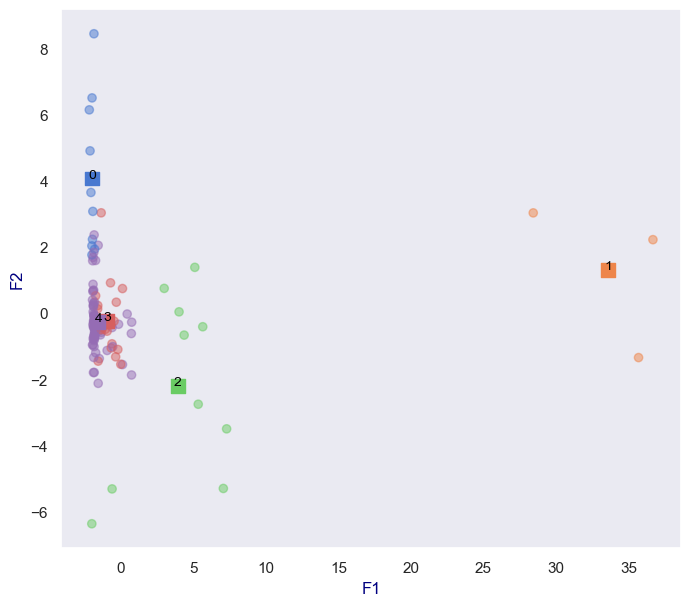

In [1101]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


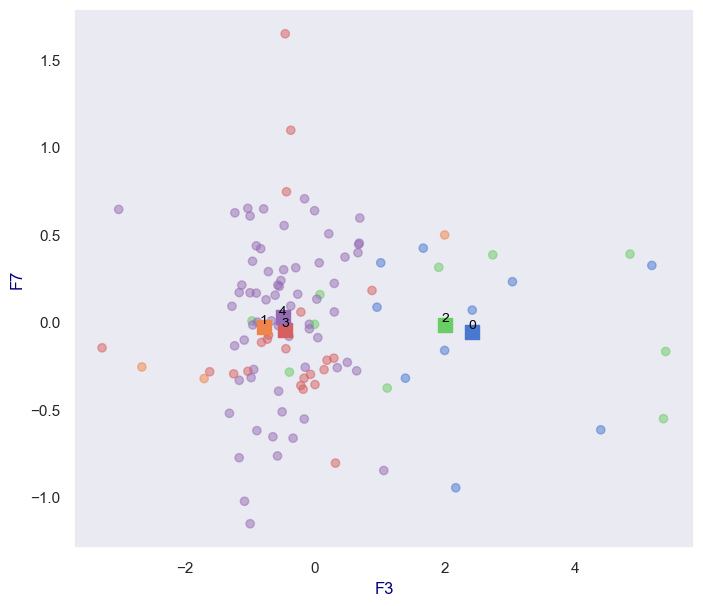

In [1102]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 6], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 6], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 6] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[2])
ax.set_ylabel(X_proj_temp.columns[6])
plt.show()


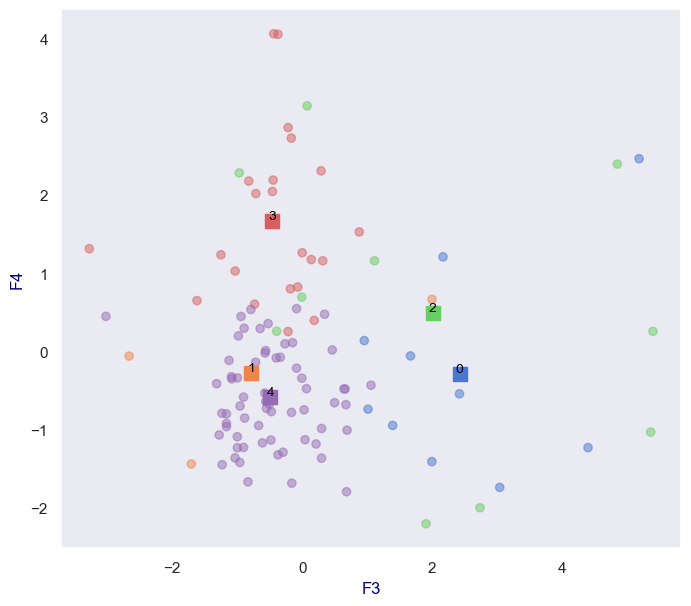

In [1103]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 2], 
    X_proj_temp.iloc[:, 3], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 2], 
    centroids_proj_temp.iloc[:, 3], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 2], 
        centroids_proj_temp.iloc[i, 3] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F3")
ax.set_ylabel("F4")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F4')

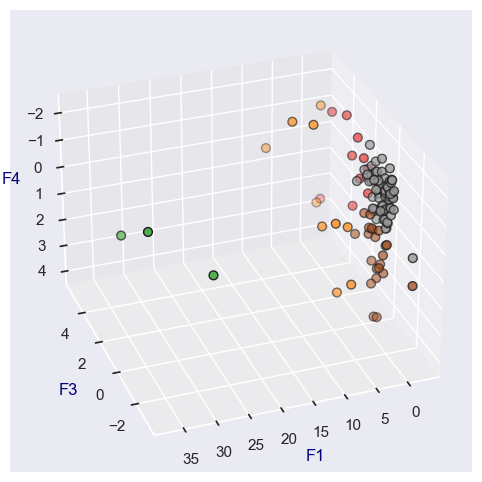

In [1104]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 2],
    X_proj_temp.iloc[:, 3],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F3")
ax.set_zlabel("F4")

Text(0.5, 0, 'F3')

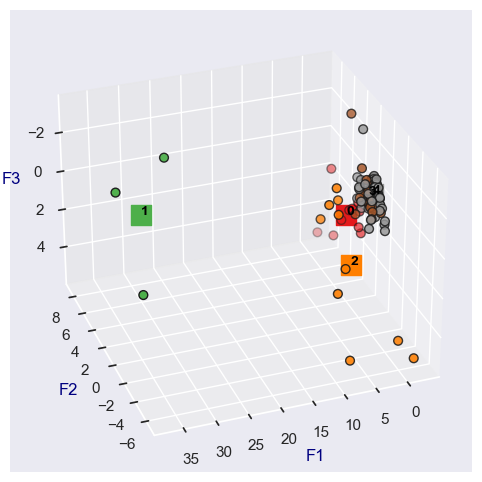

In [1105]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Set1", edgecolor="k", s=40)

# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Set1", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [1106]:
X_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
iso3,,,,,,,,,,
AGO,-1.833419,-0.400501,0.298586,-1.363372,-0.412144,0.569149,0.221050,0.063535,-0.244596,4
ALB,0.744229,-1.867460,0.499069,-0.654408,-0.331149,-0.818452,-0.230145,-0.072609,-0.070025,4
ARE,7.072173,-5.297019,5.401560,0.257290,0.130341,-0.331851,-0.167797,0.330099,0.555846,2
ARM,0.120843,-1.551784,0.213754,-1.182072,-0.456109,-0.015230,0.504349,0.274133,0.193865,4
AUS,-1.579515,0.232814,-0.166253,2.727172,1.284227,1.502189,-0.320470,-0.320323,0.713321,3


In [1107]:
centroids_proj_temp.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,labels
cluster,,,,,,,,,,
0,-1.980369,4.070345,2.425349,-0.284167,0.040818,-0.013623,-0.057440,-0.017159,-0.060958,0
1,33.600620,1.304943,-0.790428,-0.276584,0.183685,0.170131,-0.026999,-0.141973,0.027898,1
2,3.926707,-2.210974,2.009131,0.495865,-0.085826,-0.146129,-0.014569,0.190739,-0.023737,2
3,-0.917948,-0.228621,-0.463134,1.667427,-0.208602,-0.094453,-0.042897,0.116566,-0.016128,3
4,-1.539544,-0.268906,-0.488993,-0.584163,0.069050,0.048694,0.026843,-0.059605,0.017201,4


In [1108]:
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis',symbol='square'),
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1109]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


In [1110]:
#avec le text au survol
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F3"],
    z=X_proj_temp["F4"],
    mode='markers',  # Seulement les points visibles
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    text=X_proj_temp.index,  # Texte au survol
    hoverinfo='text',   # Affiche uniquement ce texte au survol
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F3"],
    z=centroids_proj_temp["F4"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F3'),
        zaxis=dict(title='F4'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


AVEC F1, F2, F3

In [1111]:
#avec le text visible
import plotly.graph_objects as go
import pandas as pd

# Supposons que X_proj_temp et centroids_proj_temp sont tous deux des DataFrames avec 3 colonnes
# Exemple : colonnes ["F1", "F2", "F3"]
# Si ce n’est pas le cas, adapte les noms des colonnes

fig = go.Figure()

# Trace des points (données projetées)
fig.add_trace(go.Scatter3d(
    x=X_proj_temp["F1"],
    y=X_proj_temp["F2"],
    z=X_proj_temp["F3"],
    mode='markers+text',  # Ajoute le texte visible
    text=X_proj_temp.index,    # Codes ISO dans l'index
    textposition='top center',  # Position du texte
    marker=dict(size=4, color=X_proj_temp['labels'], colorscale='Cividis', opacity=0.6),
    name='Pays',
    showlegend=True
))

# Trace des centroides
fig.add_trace(go.Scatter3d(
    x=centroids_proj_temp["F1"],
    y=centroids_proj_temp["F2"],
    z=centroids_proj_temp["F3"],
    mode='markers+text',
    marker=dict(size=10, color=centroids_proj_temp['labels'], colorscale='Cividis', symbol='square'),
    text=centroids_proj_temp['labels'].astype(str),  
    textposition='top center',
    name='Centroïdes',
    showlegend=True
))

# Mise à l’échelle égale pour les axes (approximation)
fig.update_layout(
    width=1000,   # Largeur en pixels
    height=800,   # Hauteur en pixels
    scene=dict(
        xaxis=dict(title='F1'),
        yaxis=dict(title='F2'),
        zaxis=dict(title='F3'),
        aspectmode='cube'  # pour forcer les axes à avoir les mêmes proportions
    ),
    title="Projection 3D des pays et des centroïdes",
    legend=dict(x=0, y=1)
)

fig.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape E -  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">E.1 -  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 -  : </h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; "> Etape Y - COMPLEMENTS </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Y.1 EXPORTS UTILES:</h3>
</div>

In [1112]:
#EXPORT UTILE :
#EXPORT de ---df_A_extraire---

#df_A_extraire = 
#df_A_extraire.to_csv("Nom_Fichier_Sortie.csv",index=False)
#df_A_extraire.to_excel("Nom_Fichier_Sortie.xlsx",index=False)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Y.2 - NETTOYAGE PYTHON:</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Y.2.1 - REMETTRE EN PLACE LES WARNINGS, SI WARNINGS DESACTIVE:</h4>
</div>

In [1113]:
#Restore the warning behaviour to default : Show all warnings (even those ignored by default)
#warnings.filterwarnings('ignore')

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Y.2.2 - RAMASSE MIETTE PYTHON :</h4>
</div>

In [1114]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

98323

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Y.3 -SOURCES DES DONNEES :</h3>
</div>

##### <u>**SOURCES**</u>  

<u>**FAO :**</u>  
https://www.fao.org/faostat/fr/#data  

<u>**Banque Mondiale :**</u>  
https://donnees.banquemondiale.org/  

<u>**Données mondiales :**</u>  
https://www.donneesmondiales.com/  

<u>**CEPII :**</u>  
https://www.cepii.fr/CEPII/fr/bdd_modele/bdd_modele.asp  

<u>**ISO  :**</u>  
(pour les données manquantes ou à mettre à jour)  
https://www.iso.org/obp/ui/#home  

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; "> Etape Z - COMPLEMENTS PERSOS </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Z.1 - RECHERCHES PYTHON </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.1 - COPY </h4>
</div>

**ATTENTION AUX SHALLOW COPY et DEEP COPY :  
Une shallow copy crée un nouvel objet mais qui poionte vers les même données que le premier=> une modification sur l'une modifie l'autre.
Il faut faire un DEEP COPY si on veut que les données soient indépendantes également**  

source : https://medium.com/@mathieuvdp/attention-au-deep-copy-de-pandas-8ebbdd5b0b92  

Bien_2 = Bien_1.copy(deep=False) =>shallow copy  
Bien_2 = Bien_1.copy(deep=True) => deep_copy

**Faire attention aux copy(deep=True)**  
**NE PAS EN ABUSER**, surtout sur des fichiers lourds.  
Au pire daire des copy(deep=True) dans le travail d'exploration.  
Puis les remplacer par des cop(deep=False), une fois que le travail est validé.  
Ou travailler sur le fichier en cours de modif quitte à relancer le Kernel si erreur.

<u>Remarque : Source utile pours la réalisation des tests statistique :</u>  
 le tableau récapitulatif d’XLSTA :  
https://help.xlstat.com/fr/6443-which-statistical-test-should-you-use 


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.2 SUPPRESSION DE LIGNES VIDES / source Nettoyage CNAM : </h4>
</div>

<u>**SUPPRESSION DE LIGNES VIDES / source Nettoyage CNAM :**</u>  

https://jhub.cnam.fr/doc/notebooks/Nettoyage_de_donnees_Python_Pandas.html  

Dans un premier temps, il peut être souhaitable de filtrer/retirer les valeurs manquantes dans le dataframe.  

Pour cela on utilise la fonction dropna().  
Cette fonction possède plusieurs arguments, permettant de moduler le niveau de filtrage des valeurs manquantes :  

axis= (0 ou 1) : filtrage des valeurs manquantes selon les lignes (axis = 0) ou les colonnes (axis=1). Valeur par défaut : axis=0.
how=all : argument permettant de ne retirer que les lignes (pour axis=0) ou toutes les colonnes (pour axis=1) du dataframe pour lequelles toutes les valeurs sont manquantes.  

Attention : si cet argument n'est pas spécifié, chaque ligne (resp. chaque colonne) contenant au moins une donnée manquante sera supprimée !  

inplace=True : applique directement la modification dans le dataframe (sans créer un autre dataframe).  
thresh= (nombre entier n) : permet de ne conserver que les lignes (resp. les colonnes) contenant au moins n valeurs non manquantes.


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.3 Reordonner des colonnes : </h4>
</div>

**CNAM (même source que pour les lignes vides) :**  


pour REORDONNER DES COLONNES, on peut utiliser df_exemple.reindex :  

ordre_colonnes = ["country", "year", "sex", "age", "cases"]  
tub = tub.reindex(columns=ordre_colonnes    


Après Lecture de la documentation, et essais,  
Cela n'a pas l'air d'être mieux que mon classique :
tub = tub[['D','B','C','A']]  
(ou A, B C D sont les colonnes d'origines).  

En effet il semble que reindex fait également un nouvel objet.)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.4 Travail sur les séries temporelles : </h4>
</div>

<u>Source intéressante :</u>    
https://moncoachdata.com/blog/methodes-de-series-temporelles-avec-pandas/

<u>Comprendre l'utilité des séries temporelles :</u>  
- Facilité d'usage des données de type datetime et timestamp.
- Prioriser l'utilisation de la Série en Index, donne un type Datetimeindex (qui donne plsu de fonctiosn sur le traitement temporel)
- Maitriser les fonctionnalités :
. resample : un équivalent de groupby spécifique qui ne s'applique qu'aux datetime
  pd.Grouper : permet de donner des instructions particulières d'aggrégation pour une série temporelle incluse dans un groupby classique, avec d'autres colonnes.

<u>Remarque :</u>  
Le .resample qu'à un datetime ; mais on ne peut pas faire un resample sur date+col_non_date (p ex ici date+categ)  
Pour faire un groupby sur date+categ, en gardant les caractéristiques de la date (comme sur un resample), on utilise :  
groupby(pd.grouper(conditions de resample sur date),categ).  

Exemples :  

df_Complet_daily_par_categ_Grouper = (df_analyse_O1_O2_transactions_1_1.groupby([pd.Grouper(key='day',freq='D'), 'categ'])
    .agg(nb_transactions=pd.NamedAgg(column='transaction_id',aggfunc='count'),
         nb_produits_distincts=pd.NamedAgg(column='id_prod',aggfunc='nunique'),
         nb_clients_distincts=pd.NamedAgg(column='client_id',aggfunc='nunique'))
    .reset_index()
)

df_Complet_daily_par_categ_Grouper.set_index(keys='day',inplace=True)
df_Complet_daily_par_categ_Grouper

df_Complet_monthly_Grouper = (df_analyse_O1_O2_transactions_1_1.groupby([pd.Grouper(key='day',freq='ME')])
    .agg(nb_transactions=pd.NamedAgg(column='transaction_id',aggfunc='count'),
         nb_produits_distincts=pd.NamedAgg(column='id_prod',aggfunc='nunique'),
         nb_clients_distincts=pd.NamedAgg(column='client_id',aggfunc='nunique'))
    .reset_index()
)

df_Complet_monthly_Grouper.set_index(keys='day',inplace=True)
df_Complet_monthly_Grouper

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.5 Travail sur la saisonnalité :</h4>
</div>

Source STATOSCOP :  
https://blog.statoscop.fr/timeseries-4.html 

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.6 Division par zéro :</h4>
</div>

**Lors d'une division avec pandas (/),**  
aucun bug ne sera levé automatiquement si le dénominateur contient des zéros.  
Pandas renverra :  
. `NaN` si l’un des deux opérandes est `NaN`  
. `inf` ou `-inf` si le numérateur est non nul et le dénominateur est zéro  
. `NaN` si le numérateur et le dénominateur sont tous les deux zéro  
  
**Il n'y aura pas d’erreur Python levée,  
mais il pourrait y avoir des valeurs inf ou -inf,  
ce qui peut poser problème plus tard (dans des calculs ou exports).**

##### Option 1 : Remplacer les zéros par NaN avant la division

##### Option 2 : Utiliser np.where pour contrôler explicitement le résultat

##### Vérification après calcul :

##### **Résumé :**
- Pas de crash avec / dans pandas, mais attention aux inf
- Préférer replace(0, np.nan) ou np.where(...)
- Nettoyer ensuite les valeurs infinies si besoin

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Z.3 - DOCUMENTATIONS DU THEME</h3>
</div>